In [1]:
import torch as tr

if tr.backends.mps.is_available():
    device = tr.device("mps")
    x = tr.ones(1, device=device)
    print (x)
elif tr.cuda.is_available():
    device = tr.device("cuda")
    x = tr.ones(1, device=device)
    print (x)
else:
    print ("MPS or cuda device not found.")
ITD="Im"
if ITD=="Im":
    number=15
else:
    number=15

from GP import *
import torch as tr
import numpy as np
import matplotlib.pyplot as plt
import statistics as st

import scipy.integrate as integrate
from torch.special import gammaln
#from orthogonal_poly import legendre_01

from torch.autograd.functional import hessian

import scipy.integrate as integrate

import h5py as h5

# import all packages and set plots to be embedded inline
import numpy as np 
import datetime
from scipy.optimize import minimize 
from scipy import special 
from scipy.optimize import Bounds 
from scipy.linalg import cho_solve 
#from pyDOE import lhs 
import time
#load all the Models and Kernels
from functions import *

Np = 6
Nz = 12
Nj = 349
rMj = np.empty([Nj,Np,Nz])
nu = np.empty([Np,Nz])
for p in range(1,Np+1):
    for z in range (1,Nz+1):
        nu[p-1,z-1] = 2.0*np.pi/32.0 *p *z
        #print(p,z,nu[p-1,z-1])
        m_4 = get_dist_matelem(z,p,4,ITD)
        m_6 = get_dist_matelem(z,p,6,ITD)
        m_8 = get_dist_matelem(z,p,8,ITD)
        #expo fit
        m = (m_4*m_8 - m_6**2)/(m_4 + m_8 - 2 * m_6)
        # this fails for certain cases where the denomenator goes too close to zero
        # use the m_6 as default
        rMj[:,p-1,z-1] = m_6
        #Nj=m.shape[0]
        #print(z,p,np.mean(m_4),np.mean(m_6),np.mean(m_8), np.mean(m),np.std(m)*np.sqrt(Nj-1))
rM = np.mean(rMj,axis=0)
rMe = np.std(rMj,axis=0)*np.sqrt(Nj) 
#plot the data
#for i in range(0,6):
#    plt.errorbar(nu[i],rM[i],yerr=rMe[i],fmt='.',alpha=0.5,label='p='+str(i+1))
#plt.legend()
#plt.show()


#plot the trace1
def plothist(trace,mygp1,disc,params="model+kernel+noise",prior=False,burn=100,kernel='jacobi'):
    fig, ax = plt.subplots(trace.shape[1], 1, figsize=(10, 10), sharex=False, sharey=False)

    mygp=mygp1

    i0 = 100
    iF=10000
    if kernel=='jacobi':
        lab=['α', 'β', 'N','s', 't', 'a', 'b','σerror']
        labprior=['α-prior', 'β-prior', 's-prior', 't-prior', 'a-prior', 'b-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass

    elif kernel=='combinedRBF':
        lab=['α','β','N','σ1','w1','σ2','w2','s','σnoise']
        labprior=['α-prior','β-prior','σ1-prior','w1-prior','σ2-prior','w2-prior','s-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass
        
    elif kernel=='RBF':
        lab=['α','β','N','σ','w','σnoise']
        labprior=['α-prior','β-prior','σ-prior','w-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass
    elif kernel=='model':
        lab=['α','β']
        labprior=['α-prior','β-prior']
    else:
        #parameters in greek
        lab=['α','β','γ','δ','ε','ζ','η','θ','ι','κ','λ','μ','ν','ξ','ο','π','ρ','σ','τ','υ','φ','χ','ψ','ω']
        labprior=['α-prior','β-prior','γ-prior','δ-prior','ε-prior','ζ-prior','η-prior','θ-prior','ι-prior','κ-prior','λ-prior','μ-prior','ν-prior','ξ-prior','ο-prior','π-prior','ρ-prior','σ-prior','τ-prior','υ-prior','φ-prior','χ-prior','ψ-prior','ω-prior']

    col=['red','blue','green','pink','black','orange','purple','brown','yellow','cyan','magenta','grey',"lightblue","lightgreen","lightcoral","lightpink","lightyellow","lightcyan","lightmagenta","lightgrey","darkblue","darkgreen","darkcoral","darkpink","darkyellow","darkcyan","darkmagenta","darkgrey"]
    for i in range(trace.shape[1]):
        ax[i].hist(trace[i0:iF,i],bins=disc,label=lab[i],color=col[i],density=True)
        if prior:
            initial=mygp.prior_dist[i].shift
            final=mygp.prior_dist[i].shift+mygp.prior_dist[i].scale
            xxx = tr.linspace(initial,final,1000)
            distexp=mygp.prior_dist[i]
            pdfs=tr.zeros(xxx.shape[0])
            for k in range(xxx.shape[0]):
                pdfs[k]=distexp.pdf(xxx[k])
            ax[i].plot(xxx,pdfs.detach().numpy())
            ax[i].set_xlim([initial-0.5,final+0.5])
        ax[i].legend()
    plt.show()

#plot the trace1
def plothist1(trace,mygp1,disc,params="model+kernel+noise",prior=False,burn=100,kernel='jacobi'):
    fig, ax = plt.subplots(trace.shape[1], 1, figsize=(10, 10), sharex=False, sharey=False)

    mygp=mygp1

    i0 = 100
    iF=10000
    if kernel=='jacobi':
        lab=['α', 'β', 'N','s', 't', 'a', 'b','σerror']
        labprior=['α-prior', 'β-prior', 's-prior', 't-prior', 'a-prior', 'b-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass

    elif kernel=='combinedRBF':
        lab=['α','β','N','σ1','w1','σ2','w2','s','σnoise']
        labprior=['α-prior','β-prior','σ1-prior','w1-prior','σ2-prior','w2-prior','s-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass
        
    elif kernel=='RBF':
        lab=['α','β','N','σ','w','σnoise']
        labprior=['α-prior','β-prior','σ-prior','w-prior','σerror-prior']
        if params=="kernel":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        elif params=="kernel+noise":
            lab=lab[mygp.Npd_args:]
            mygp.prior_dist=mygp.prior_dist[mygp.Npd_args:]
        else:
            pass
    elif kernel=='model':
        lab=['α','β']
        labprior=['α-prior','β-prior']
    else:
        #parameters in greek
        lab=['α','β','γ','δ','ε','ζ','η','θ','ι','κ','λ','μ','ν','ξ','ο','π','ρ','σ','τ','υ','φ','χ','ψ','ω']
        labprior=['α-prior','β-prior','γ-prior','δ-prior','ε-prior','ζ-prior','η-prior','θ-prior','ι-prior','κ-prior','λ-prior','μ-prior','ν-prior','ξ-prior','ο-prior','π-prior','ρ-prior','σ-prior','τ-prior','υ-prior','φ-prior','χ-prior','ψ-prior','ω-prior']

    col=['red','blue','green','pink','black','orange','purple','brown','yellow','cyan','magenta','grey',"lightblue","lightgreen","lightcoral","lightpink","lightyellow","lightcyan","lightmagenta","lightgrey","darkblue","darkgreen","darkcoral","darkpink","darkyellow","darkcyan","darkmagenta","darkgrey"]
    for i in range(trace.shape[1]):
        ax[i].hist(trace[i0:iF,i],bins=disc,label=lab[i],color=col[i],density=True)
        if prior:
            initial=mygp.prior_dist[i].shift
            final=mygp.prior_dist[i].shift+mygp.prior_dist[i].scale
            xxx = tr.linspace(initial,final,1000)
            distexp=mygp.prior_dist[i]
            pdfs=tr.zeros(xxx.shape[0])
            for k in range(xxx.shape[0]):
                pdfs[k]=distexp.pdf(xxx[k])
            ax[i].plot(xxx,pdfs.detach().numpy())
            ax[i].set_xlim([initial-0.5,final+0.5])
        ax[i].legend()
    plt.show()
def plotrace(trace,burn=100,kernel='jacobi'):
    fig, ax = plt.subplots(trace.shape[1],figsize=(20, 8))
    i0 = burn
    iF=trace.shape[0]
    if kernel=='jacobifull':
        lab=['α','β','N','s','t','a','b']
    elif kernel=='rbf':
        lab=['α','β','N','σ','w','σnoise']
    else:
        lab=['α', 'β','N','σ1','w1','σ2','w2','s','σnoise']
    col=['red','blue','green','pink','black','orange','purple','brown','grey',"lightblue","lightgreen","lightcoral","lightpink","lightyellow","lightcyan","lightmagenta","lightgrey","darkblue","darkgreen","darkcoral","darkpink","darkyellow","darkcyan","darkmagenta","darkgrey"]
    for i in range(trace.shape[1]):
        ax[i].plot(trace[i0:iF,i],label=lab[i],color=col[i])
        ax[i].legend()
    plt.show()
#from tensor to list
def tensor2list(tensor):
    return [tensor[i].item() for i in range(tensor.shape[0])]

#Nx=256
#x_grid = np.concatenate((np.logspace(-12,-1,np.int32(Nx/2)),np.linspace(0.1+1e-4,1-1e-12,np.int32(Nx/2))))

tensor([1.], device='cuda:0')


# Working with $Re(\mathcal{M})$ or $Im(\mathcal{M})$

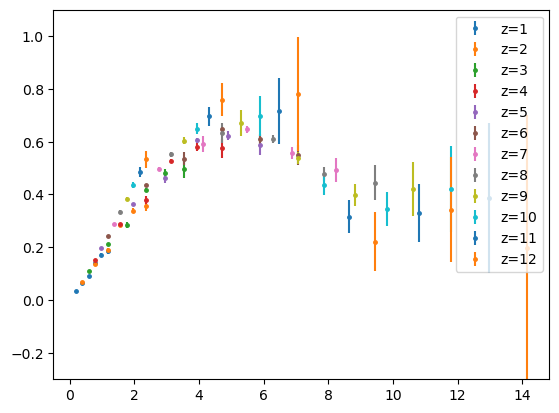

In [2]:
nu,rMj,rMe,rM = get_data(ITD)
#plot the data
"""for i in range(0,6):
    plt.errorbar(nu[i],rM[i],yerr=rMe[i],fmt='.',alpha=0.5,label='p='+str(i+1))
plt.legend()
plt.show()"""
for z in range(0,12):
    plt.errorbar(nu[:,z],rM[:,z],rMe[:,z],marker='.',ms=5,ls='',label='z='+str(z+1),)
plt.ylim([-0.3,1.1])
plt.legend()

plt.show()

# Models 

In [3]:
modelname=ModelC.__name__
kernelname=Krbflog.__name__
#kernelname="Krbflog"
nugget="no" #only if you want to do another regularization for our GP
device="cpu"
mode="all"
ID=12
Nx=128*2
test="NNPDF"#"mock" #Depending of the test you want to do 
fits_comb_Re=[]
fits_comb_Im=[]

#select the model 
def Modeldef(fits_comb,ITD,nu,rMj,rMe,rM,modelname,kernelname,nugget,device,mode,ID,test,Nx):

    mean,sigma,config,mod,ker,modfunc,kerfunc,device,mode,ID= arguments(modelname,kernelname,nugget,device,mode,ID)
    nu,rMj,rMe,rM = get_data(ITD)
    now = datetime.datetime.now()
    print ("Current date and time :", now.strftime("%Y-%m-%d %H:%M:%S"))
    print("GP specifications \n Sampling or training: "+mode+"\n model: "+modelname+"\n kernel: "+kernelname+" nugget: "+ nugget+"\n Ioffe time Distribution: "+ITD+"(M)","\n mean =",mean,"\n sigma =",sigma,"\n prior dist =",config,"\n model init =",mod,"\n kernel init =",ker,"\n device =",device,"\n mode =",mode,"\n ID =",ID)

    print("#################Define the model###########################")
    print("0=gaussian, 1=lognormal, 2=expbeta")
    for i in range(0,12):
        x_gri0,V0,Y0,Gamma0 = preparedata(i,nu,rMj,rMe,rM,scale="log",ITD=ITD,Nx=Nx)
        myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z={i+1}a",nugget=nugget,device=device,ITD=ITD,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
        myGP0.prior2ndlevel("all",1000,mean=mean,sigma=sigma,prior_mode=config)
        fits_comb.append(myGP0)
        print(fits_comb[i].name, "done")
    if ITD=="Re" and test=="mock":
        numax=[4,10,25]
        for j in range(0,3):
            x_gri0,V0,Y0,Gamma0 = preparemockdata1(numax[j]+1,numax[j],ITD,Nx=Nx)
            myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z=mock({numax[j]})",nugget=nugget,device=device,ITD=ITD,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
            myGP0.prior2ndlevel("all",1000,mean=mean,sigma=sigma,prior_mode=config)
            fits_comb.append(myGP0)
            print(fits_comb[-1].name, "done")
    elif test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        for i in [4,10,25]:
            datanu4 = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax'+str(i)+'.dat',dtype=np.float64)
            x_gri0,V0,Y0,Gamma0 = NNPDFdata(datanu4,Nx,ITD)
            myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z=NNPDF({i})",nugget=nugget,device=device,ITD=ITD,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
            myGP0.prior2ndlevel("all",1000,mean=mean,sigma=sigma,prior_mode=config)
            fits_comb.append(myGP0)
            print(fits_comb[-1].name, "done")
        return fits_comb
x_gri0=np.concatenate((np.logspace(-12,-1,np.int32(Nx/2)),np.linspace(0.1+1e-4,1-1e-12,np.int32(Nx/2))))
numax=[4,10,25]


In [5]:
ModelC_Krbflog_Re=[]
ModelC_Krbflog_Im=[]
PDF_Krbflog_Re=[]
PDF_Krbflog_Im=[]
ModelC_Krbflog_Re=Modeldef(ModelC_Krbflog_Re,"Re",nu,rMj,rMe,rM,'ModelC','Krbflog',nugget,device,mode,ID,test,Nx)
ModelC_Krbflog_Im=Modeldef(ModelC_Krbflog_Im,"Im",nu,rMj,rMe,rM,'ModelC','Krbflog',nugget,device,mode,ID,test,Nx)
PDF_Krbflog_Re=Modeldef(PDF_Krbflog_Re,"Re",nu,rMj,rMe,rM,'PDF','Krbflog',nugget,device,mode,ID,test,Nx)
PDF_Krbflog_Im=Modeldef(PDF_Krbflog_Im,"Im",nu,rMj,rMe,rM,'PDF','Krbflog',nugget,device,mode,ID,test,Nx)
ModelC_Kdebbioxa_Re=[]
ModelC_Kdebbioxa_Im=[]
PDF_Kdebbioxa_Re=[]
PDF_Kdebbioxa_Im=[]
ModelC_Kdebbioxa_Re=Modeldef(ModelC_Kdebbioxa_Re,"Re",nu,rMj,rMe,rM,'ModelC','Kdebbioxa',nugget,device,mode,ID,test,Nx)
ModelC_Kdebbioxa_Im=Modeldef(ModelC_Kdebbioxa_Im,"Im",nu,rMj,rMe,rM,'ModelC','Kdebbioxa',nugget,device,mode,ID,test,Nx)
PDF_Kdebbioxa_Re=Modeldef(PDF_Kdebbioxa_Re,"Re",nu,rMj,rMe,rM,'PDF','Kdebbioxa',nugget,device,mode,ID,test,Nx)
PDF_Kdebbioxa_Im=Modeldef(PDF_Kdebbioxa_Im,"Im",nu,rMj,rMe,rM,'PDF','Kdebbioxa',nugget,device,mode,ID,test,Nx)
PDF_Krbflog_no_s_Re=[]
PDF_Krbflog_no_s_Im=[]
ModelC_Krbflog_no_s_Re=[]
ModelC_Krbflog_no_s_Im=[]
ModelC_Krbflog_no_s_Re=Modeldef(ModelC_Krbflog_no_s_Re,"Re",nu,rMj,rMe,rM,'ModelC','Krbflog_no_s','no',device,mode,ID,test,Nx)
ModelC_Krbflog_no_s_Im=Modeldef(ModelC_Krbflog_no_s_Im,"Im",nu,rMj,rMe,rM,'ModelC','Krbflog_no_s','no',device,mode,ID,test,Nx)
PDF_Krbflog_no_s_Re=Modeldef(PDF_Krbflog_no_s_Re,"Re",nu,rMj,rMe,rM,'PDF','Krbflog_no_s','no',device,mode,ID,test,Nx)
PDF_Krbflog_no_s_Im=Modeldef(PDF_Krbflog_no_s_Im,"Im",nu,rMj,rMe,rM,'PDF','Krbflog_no_s','no',device,mode,ID,test,Nx)
PDF_rbf_logrbf_Re=[]
PDF_rbf_logrbf_Im=[]
ModelC_rbf_logrbf_Re=[]
ModelC_rbf_logrbf_Im=[]
ModelC_rbf_logrbf_Re=Modeldef(ModelC_rbf_logrbf_Re,"Re",nu,rMj,rMe,rM,'ModelC','rbf_logrbf','no',device,mode,ID,test,Nx)
ModelC_rbf_logrbf_Im=Modeldef(ModelC_rbf_logrbf_Im,"Im",nu,rMj,rMe,rM,'ModelC','rbf_logrbf','no',device,mode,ID,test,Nx)
PDF_rbf_logrbf_Re=Modeldef(PDF_rbf_logrbf_Re,"Re",nu,rMj,rMe,rM,'PDF','rbf_logrbf','no',device,mode,ID,test,Nx)
PDF_rbf_logrbf_Im=Modeldef(PDF_rbf_logrbf_Im,"Im",nu,rMj,rMe,rM,'PDF','rbf_logrbf','no',device,mode,ID,test,Nx)

Current date and time : 2025-01-28 15:06:53
GP specifications 
 Sampling or training: all
 model: ModelC
 kernel: Krbflog nugget: no
 Ioffe time Distribution: Re(M) 
 mean = tensor([0.1000, 0.0000, 0.0000]) 
 sigma = tensor([20., 10., 10.]) 
 prior dist = tensor([2, 2, 2]) 
 model init = (1.0,) 
 kernel init = (4.0, 1.0) 
 device = cpu 
 mode = all 
 ID = 12
#################Define the model###########################
0=gaussian, 1=lognormal, 2=expbeta
z=1a done
z=2a done
z=3a done
z=4a done
z=5a done
z=6a done
z=7a done
z=8a done
z=9a done
z=10a done
z=11a done
z=12a done
z=NNPDF(4) done
z=NNPDF(10) done
z=NNPDF(25) done
Current date and time : 2025-01-28 15:07:19
GP specifications 
 Sampling or training: all
 model: ModelC
 kernel: Krbflog nugget: no
 Ioffe time Distribution: Im(M) 
 mean = tensor([0.1000, 0.0000, 0.0000]) 
 sigma = tensor([20., 10., 10.]) 
 prior dist = tensor([2, 2, 2]) 
 model init = (1.0,) 
 kernel init = (4.0, 1.0) 
 device = cpu 
 mode = all 
 ID = 12
#########

## Testing

In [50]:
Nnupoints=7
numock = np.linspace(0,13,Nnupoints)
jM = pseudo_data(numock,-0.3,2.9,1.0,0.2,0.5,0.2,1000,ITD=ITD)
eM = np.std(jM,axis=0)
CovD= np.cov(jM.T)
CovD=(CovD+CovD.T)/2
print(CovD,eM**2)

[[9.97421748e-05 2.02151439e-05 7.03164670e-05 8.36594587e-05
  8.20044294e-05 7.67908580e-05 7.87527390e-05]
 [2.02151439e-05 1.91839071e-03 5.12653764e-03 6.70907542e-03
  6.48337963e-03 5.92222507e-03 5.52105235e-03]
 [7.03164670e-05 5.12653764e-03 1.46723409e-02 1.93204813e-02
  1.89181486e-02 1.73690197e-02 1.62506623e-02]
 [8.36594587e-05 6.70907542e-03 1.93204813e-02 2.62899548e-02
  2.62099347e-02 2.43380639e-02 2.29034367e-02]
 [8.20044294e-05 6.48337963e-03 1.89181486e-02 2.62099347e-02
  2.69033222e-02 2.52070499e-02 2.38607398e-02]
 [7.67908580e-05 5.92222507e-03 1.73690197e-02 2.43380639e-02
  2.52070499e-02 2.40087932e-02 2.27333293e-02]
 [7.87527390e-05 5.52105235e-03 1.62506623e-02 2.29034367e-02
  2.38607398e-02 2.27333293e-02 2.17810843e-02]] [9.96424326e-05 1.91647232e-03 1.46576686e-02 2.62636649e-02
 2.68764189e-02 2.39847844e-02 2.17593032e-02]


z=a 0
[[3.67367807e-09 4.49622893e-09 4.25628252e-09 2.20659126e-09
  7.94409040e-10 6.11146155e-09]
 [4.49622893e-09 1.12972038e-08 2.35047797e-08 8.65786432e-09
  3.87779148e-09 1.22394588e-08]
 [4.25628252e-09 2.35047797e-08 1.76925070e-07 4.36964382e-08
  7.40558837e-08 1.28959137e-07]
 [2.20659126e-09 8.65786432e-09 4.36964382e-08 1.06363564e-07
  1.79524455e-07 2.10217351e-07]
 [7.94409040e-10 3.87779148e-09 7.40558837e-08 1.79524455e-07
  7.15517270e-07 1.25685565e-06]
 [6.11146155e-09 1.22394588e-08 1.28959137e-07 2.10217351e-07
  1.25685565e-06 5.34448762e-06]] [3.67367807e-09 1.12972038e-08 1.76925070e-07 1.06363564e-07
 7.15517270e-07 5.34448762e-06]


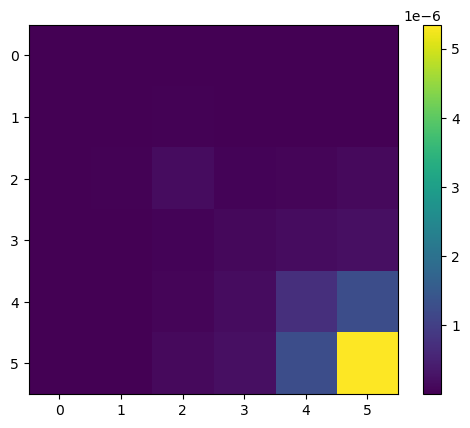

z=a 1
[[4.78118316e-08 5.78641674e-08 5.88393999e-08 2.39787053e-08
  1.16694331e-08 8.40389609e-08]
 [5.78641674e-08 1.52441420e-07 3.41305909e-07 1.15054531e-07
  7.04417044e-08 1.77480912e-07]
 [5.88393999e-08 3.41305909e-07 2.60270253e-06 6.56544902e-07
  1.15339635e-06 1.97352849e-06]
 [2.39787053e-08 1.15054531e-07 6.56544902e-07 1.62865675e-06
  2.77960689e-06 3.34059382e-06]
 [1.16694331e-08 7.04417044e-08 1.15339635e-06 2.77960689e-06
  1.11933825e-05 1.99120741e-05]
 [8.40389609e-08 1.77480912e-07 1.97352849e-06 3.34059382e-06
  1.99120741e-05 8.51526542e-05]] [4.78118316e-08 1.52441420e-07 2.60270253e-06 1.62865675e-06
 1.11933825e-05 8.51526542e-05]


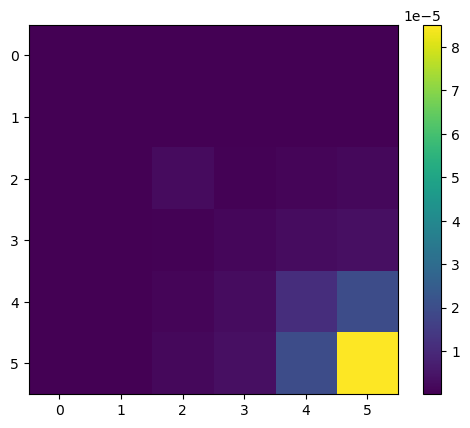

z=a 2
[[2.27060311e-07 2.71892059e-07 2.63492577e-07 9.89359211e-08
  2.56572267e-08 3.36833586e-07]
 [2.71892059e-07 7.33259549e-07 1.65810212e-06 5.17677309e-07
  3.14986485e-07 7.66616595e-07]
 [2.63492577e-07 1.65810212e-06 1.33736183e-05 3.36265183e-06
  5.94267117e-06 1.04871386e-05]
 [9.89359211e-08 5.17677309e-07 3.36265183e-06 8.16381351e-06
  1.38333801e-05 1.68649093e-05]
 [2.56572267e-08 3.14986485e-07 5.94267117e-06 1.38333801e-05
  5.50533628e-05 9.75320254e-05]
 [3.36833586e-07 7.66616595e-07 1.04871386e-05 1.68649093e-05
  9.75320254e-05 4.13324497e-04]] [2.27060311e-07 7.33259549e-07 1.33736183e-05 8.16381351e-06
 5.50533628e-05 4.13324497e-04]


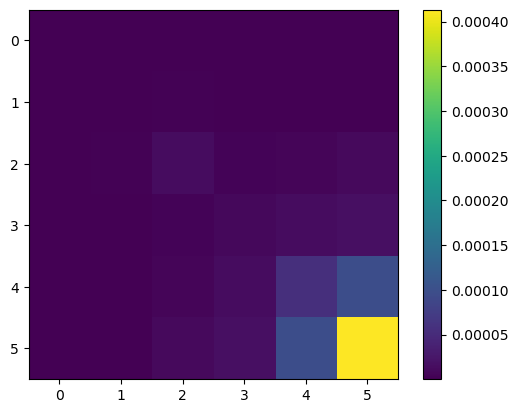

z=a 3
[[6.81874252e-07 8.02253430e-07 7.17091444e-07 2.82059332e-07
  1.11737168e-08 1.27818916e-06]
 [8.02253430e-07 2.26679185e-06 5.15412949e-06 1.58406430e-06
  9.87190698e-07 2.65022319e-06]
 [7.17091444e-07 5.15412949e-06 4.36619044e-05 1.09647755e-05
  1.86733130e-05 3.27883554e-05]
 [2.82059332e-07 1.58406430e-06 1.09647755e-05 2.55681111e-05
  4.20048446e-05 4.92454274e-05]
 [1.11737168e-08 9.87190698e-07 1.86733130e-05 4.20048446e-05
  1.62066526e-04 2.78618001e-04]
 [1.27818916e-06 2.65022319e-06 3.27883554e-05 4.92454274e-05
  2.78618001e-04 1.15935661e-03]] [6.81874252e-07 2.26679185e-06 4.36619044e-05 2.55681111e-05
 1.62066526e-04 1.15935661e-03]


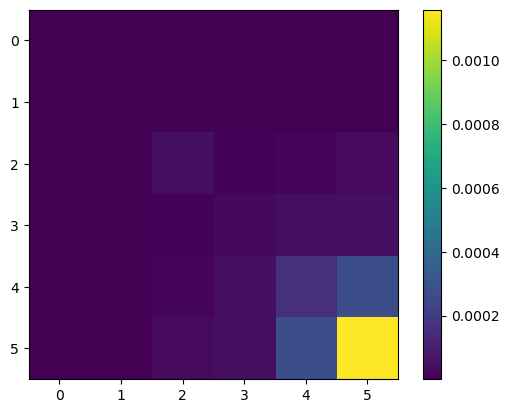

z=a 4
[[ 1.71611854e-06  1.97419829e-06  1.54567374e-06  5.82684574e-07
  -2.53237871e-07  2.71345940e-06]
 [ 1.97419829e-06  5.74777734e-06  1.26103793e-05  3.73875842e-06
   2.09101970e-06  5.10648649e-06]
 [ 1.54567374e-06  1.26103793e-05  1.09650574e-04  2.67069483e-05
   4.35231906e-05  7.38254278e-05]
 [ 5.82684574e-07  3.73875842e-06  2.67069483e-05  6.08603482e-05
   9.50016334e-05  1.02052294e-04]
 [-2.53237871e-07  2.09101970e-06  4.35231906e-05  9.50016334e-05
   3.51461230e-04  5.74162562e-04]
 [ 2.71345940e-06  5.10648649e-06  7.38254278e-05  1.02052294e-04
   5.74162562e-04  2.34105956e-03]] [1.71611854e-06 5.74777734e-06 1.09650574e-04 6.08603482e-05
 3.51461230e-04 2.34105956e-03]


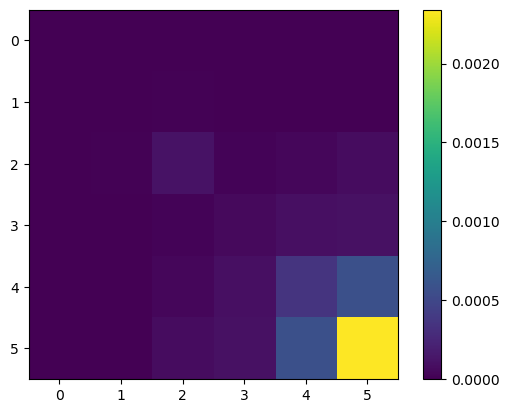

z=a 5
[[ 3.86127996e-06  4.16096381e-06  2.31859541e-06  1.20896193e-06
  -8.08521592e-07  1.75569822e-06]
 [ 4.16096381e-06  1.27376459e-05  2.67954875e-05  8.07791620e-06
   4.75975316e-06  5.54990966e-06]
 [ 2.31859541e-06  2.67954875e-05  2.38396607e-04  5.61637905e-05
   8.84781123e-05  1.43254938e-04]
 [ 1.20896193e-06  8.07791620e-06  5.61637905e-05  1.24016954e-04
   1.78869204e-04  1.73333707e-04]
 [-8.08521592e-07  4.75975316e-06  8.84781123e-05  1.78869204e-04
   6.25437749e-04  9.53569384e-04]
 [ 1.75569822e-06  5.54990966e-06  1.43254938e-04  1.73333707e-04
   9.53569384e-04  3.81566148e-03]] [3.86127996e-06 1.27376459e-05 2.38396607e-04 1.24016954e-04
 6.25437749e-04 3.81566148e-03]


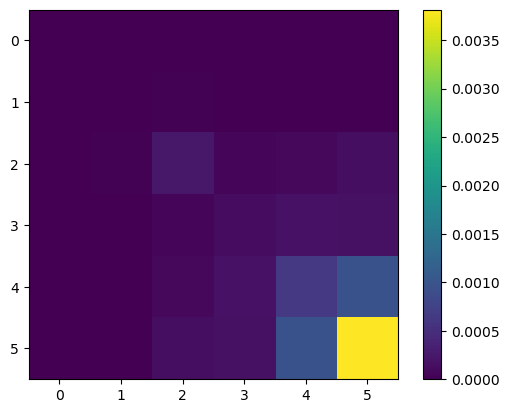

z=a 6
[[ 8.44838635e-06  8.62505952e-06  2.74133220e-06  2.19511734e-06
  -1.16675761e-06 -1.46398152e-06]
 [ 8.62505952e-06  2.77957451e-05  5.39529026e-05  1.60081102e-05
   1.07287069e-05  8.38226017e-06]
 [ 2.74133220e-06  5.39529026e-05  4.84476301e-04  1.06590914e-04
   1.62009258e-04  2.54047895e-04]
 [ 2.19511734e-06  1.60081102e-05  1.06590914e-04  2.33316265e-04
   2.99924778e-04  2.65213368e-04]
 [-1.16675761e-06  1.07287069e-05  1.62009258e-04  2.99924778e-04
   9.76819118e-04  1.38060428e-03]
 [-1.46398152e-06  8.38226017e-06  2.54047895e-04  2.65213368e-04
   1.38060428e-03  5.49792655e-03]] [8.44838635e-06 2.77957451e-05 4.84476301e-04 2.33316265e-04
 9.76819118e-04 5.49792655e-03]


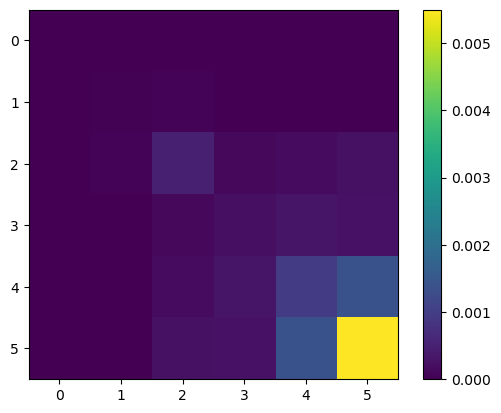

z=a 7
[[ 1.92901525e-05  1.98356731e-05  7.27512675e-06  2.68806456e-06
  -1.50598366e-06 -8.61243969e-06]
 [ 1.98356731e-05  6.50069576e-05  1.13237699e-04  2.44992946e-05
   1.74814806e-05  2.20250566e-05]
 [ 7.27512675e-06  1.13237699e-04  9.97205791e-04  1.83588650e-04
   2.71749266e-04  4.35770311e-04]
 [ 2.68806456e-06  2.44992946e-05  1.83588650e-04  4.36590440e-04
   4.71447330e-04  3.42013638e-04]
 [-1.50598366e-06  1.74814806e-05  2.71749266e-04  4.71447330e-04
   1.45978693e-03  1.83046552e-03]
 [-8.61243969e-06  2.20250566e-05  4.35770311e-04  3.42013638e-04
   1.83046552e-03  7.68085365e-03]] [1.92901525e-05 6.50069576e-05 9.97205791e-04 4.36590440e-04
 1.45978693e-03 7.68085365e-03]


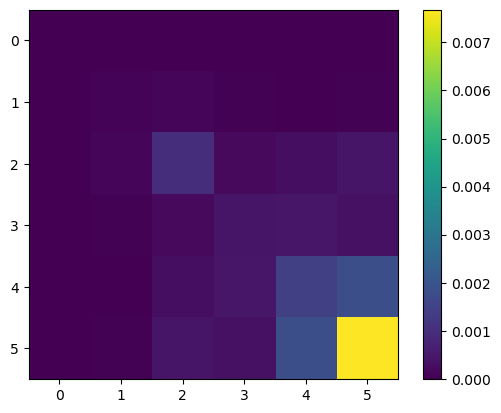

z=a 8
[[ 4.71021931e-05  4.97175030e-05  3.23885656e-05 -2.75768951e-06
  -1.04139047e-05 -7.16735271e-06]
 [ 4.97175030e-05  1.67362633e-04  2.61496327e-04  2.21800242e-05
   7.82376205e-06  5.63170215e-05]
 [ 3.23885656e-05  2.61496327e-04  2.26453994e-03  3.06592443e-04
   4.19906643e-04  7.11227319e-04]
 [-2.75768951e-06  2.21800242e-05  3.06592443e-04  8.45803608e-04
   7.81664852e-04  3.56686129e-04]
 [-1.04139047e-05  7.82376205e-06  4.19906643e-04  7.81664852e-04
   2.48388061e-03  2.58732341e-03]
 [-7.16735271e-06  5.63170215e-05  7.11227319e-04  3.56686129e-04
   2.58732341e-03  1.26772367e-02]] [4.71021931e-05 1.67362633e-04 2.26453994e-03 8.45803608e-04
 2.48388061e-03 1.26772367e-02]


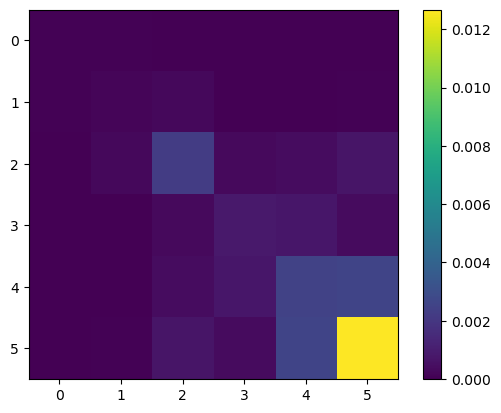

z=a 9
[[ 1.23687612e-04  1.37385613e-04  1.22271614e-04 -3.10178425e-05
  -3.27509204e-05  2.36742643e-05]
 [ 1.37385613e-04  4.75790521e-04  6.37714575e-04 -1.31707018e-05
  -4.78837078e-05  4.34744442e-05]
 [ 1.22271614e-04  6.37714575e-04  5.58831856e-03  5.18586945e-04
   4.69812564e-04  8.48497322e-04]
 [-3.10178425e-05 -1.31707018e-05  5.18586945e-04  1.81529403e-03
   1.52192200e-03  3.11951094e-04]
 [-3.27509204e-05 -4.78837078e-05  4.69812564e-04  1.52192200e-03
   5.37602383e-03  4.77905845e-03]
 [ 2.36742643e-05  4.34744442e-05  8.48497322e-04  3.11951094e-04
   4.77905845e-03  2.78531672e-02]] [0.00012369 0.00047579 0.00558832 0.00181529 0.00537602 0.02785317]


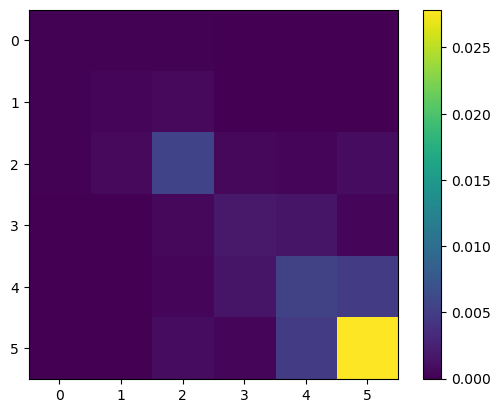

z=a 10
[[ 3.47994315e-04  4.05173040e-04  3.90181815e-04 -9.79589776e-05
  -2.45696713e-05  9.52235604e-05]
 [ 4.05173040e-04  1.43926762e-03  1.67400821e-03 -1.80179918e-04
  -2.57801126e-04  8.44982178e-05]
 [ 3.90181815e-04  1.67400821e-03  1.51913975e-02  8.83436309e-04
   5.06486097e-04  1.52336708e-03]
 [-9.79589776e-05 -1.80179918e-04  8.83436309e-04  4.46669618e-03
   3.44783692e-03 -2.70454570e-04]
 [-2.45696713e-05 -2.57801126e-04  5.06486097e-04  3.44783692e-03
   1.41476444e-02  1.10830382e-02]
 [ 9.52235604e-05  8.44982178e-05  1.52336708e-03 -2.70454570e-04
   1.10830382e-02  7.56490963e-02]] [0.00034799 0.00143927 0.0151914  0.0044667  0.01414764 0.0756491 ]


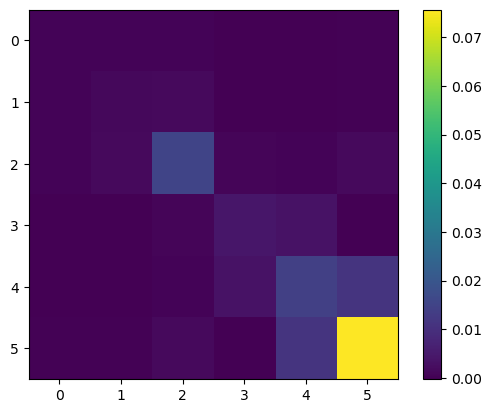

z=a 11
[[ 9.83927250e-04  1.11783483e-03  1.07555427e-03 -3.60763933e-04
  -1.22569028e-04  3.90217772e-04]
 [ 1.11783483e-03  4.17751387e-03  4.59248817e-03 -7.66967050e-04
  -1.02092937e-03  1.42476962e-03]
 [ 1.07555427e-03  4.59248817e-03  4.33699555e-02  1.65808267e-03
   1.42582916e-03  6.05280764e-03]
 [-3.60763933e-04 -7.66967050e-04  1.65808267e-03  1.26803635e-02
   9.45533608e-03 -2.39684997e-03]
 [-1.22569028e-04 -1.02092937e-03  1.42582916e-03  9.45533608e-03
   4.18152644e-02  3.15369016e-02]
 [ 3.90217772e-04  1.42476962e-03  6.05280764e-03 -2.39684997e-03
   3.15369016e-02  2.38189706e-01]] [0.00098393 0.00417751 0.04336996 0.01268036 0.04181526 0.23818971]


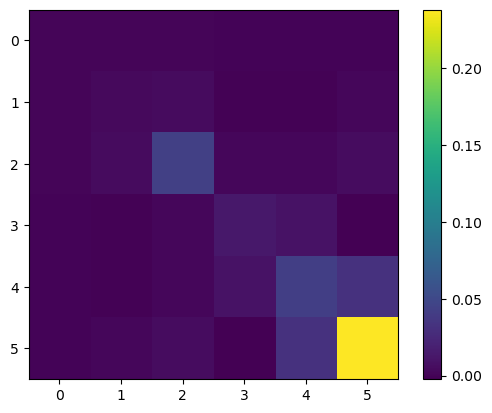

In [10]:
CovDs=[]
for i in range(0,12):
    print("z=a",i)
    CovD= np.cov(rMj[:,:,i].T*np.sqrt((Nj-1)))
    #CovD=(CovD+CovD.T)/2
    eM = rMe.T[i]
    #CovD=np.sqrt(CovD)
    print(CovD,eM**2)
    #change nans by 0
    #CovD[np.isnan(CovD)]=0
    CovDs.append(CovD)
    #plot the covariance matrix 
    plt.imshow(CovD)
    plt.colorbar()
    plt.show()

In [5]:
#Print Gamma 
for i in range(0,12):
    print(fits_comb[i].name, "Gamma=",fits_comb[i].Gamma)

z=1a Gamma= tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.6737e-09, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1297e-08, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7693e-07, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0636e-07,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         7.1552e-07, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 5.3445e-06]])
z=2a Gamma= tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00

In [5]:
def Modeldef(modelname,kernelname,nugget,device,mode,ID):
    #select the model 
    if modelname==PDF_N.__name__:
        meanf=tr.tensor([-1.0,0.0,0.0])
        sigmaf=tr.tensor([2.0,6.0,3.0])
        configf=tr.tensor([2,2,2])
        mod=(-0.0,1.0,1.0)
        modfunc=PDF_N
    elif modelname==ModelC.__name__:#Constant model
        meanf=tr.tensor([0.5])
        sigmaf=tr.tensor([10.0])
        configf=tr.tensor([2])
        mod=(1.0,)
        modfunc=ModelC
    elif modelname==PDFnormed.__name__:
        meanf=tr.tensor([-1.0,0.0])
        sigmaf=tr.tensor([2.0,6.0])
        configf=tr.tensor([2,2])
        mod=(-0.0,1.0)
        modfunc=PDFnormed
    elif modelname==PDF.__name__:
        meanf=tr.tensor([-1.1,0.0,0.5])
        sigmaf=tr.tensor([2.1,6.0,6.0])
        configf=tr.tensor([2,2,2])
        mod=(-0.0,1.0,3.0)
        modfunc=PDF


    #select the kernel
    if kernelname==rbf_logrbf.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([20.,  6., 20.,  6.,  2.]) #ModelC
        #sigmak=tr.tensor([11.0,6.0,11.0,6.0,2.0])
        configk=tr.tensor([2,2,2,2,2,2])
        #ker=(50.0,1.1,50.0,1.0,1.0)
        ker=(5.0,0.1,5.0,1.0,1.0)
        kerfunc=rbf_logrbf

    if kernelname==rbf_logrbf_s_w.__name__:
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([20.0,20.0])
        configk=tr.tensor([2,2])
        ker=(2.0,2.0)
        kerfunc=rbf_logrbf_s_w

    elif kernelname==rbf_deb.__name__: 
        meank=tr.tensor([0.0,0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([11.0,6.0,11.0,11.0,2.0])
        configk=tr.tensor([2,2,2,2,2,2])
        ker=(5.0,5.0,10.0,10.0,0.1)
        kerfunc=rbf_deb

    elif kernelname==rbf_deb_s_w.__name__: 
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([11.0,6.0])
        configk=tr.tensor([2,2])
        ker=(5.0,5.1)
        kerfunc=rbf_deb_s_w


    elif kernelname==rbf_logrbf_no_s.__name__:
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([10.0,10.0])
        configk=tr.tensor([2,2])
        ker=(0.1,0.1)
        kerfunc=rbf_logrbf_no_s

    elif kernelname==KrbfMat.__name__: 
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([11.0,2.0])
        configk=tr.tensor([2,2])
        ker=(10.1,0.1)
        kerfunc=KrbfMat

    elif kernelname==Krbflog.__name__:
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([10.0,10.0])
        configk=tr.tensor([2,2])
        ker=(10.1,0.1)
        kerfunc=Krbflog

    elif kernelname==Krbflog_no_s.__name__:
        meank=tr.tensor([0.0])
        sigmak=tr.tensor([10.0])
        configk=tr.tensor([2])
        ker=(0.1,)
        kerfunc=Krbflog_no_s
        
    elif kernelname==Krbf_no_s.__name__:
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([10.0,10.0])
        configk=tr.tensor([2,2])
        ker=(0.1,0.1)
        kerfunc=Krbf_no_s

    elif kernelname==Krbf_fast.__name__:
        meank=tr.tensor([-6.0,6.0])
        sigmak=tr.tensor([12.0,12.0])
        configk=tr.tensor([2,2])
        ker=(0.0,0.0)
        kerfunc=Krbf_fast

    elif kernelname==Kdebbio.__name__:
        meank=tr.tensor([0.0,0.0])
        sigmak=tr.tensor([10.0,10.0])
        configk=tr.tensor([2,2])
        ker=(10.0,9.1)
        kerfunc=Kdebbio

    elif kernelname==Kdebbioxa.__name__:
        meank=tr.tensor([0.0,0.0,-1.0])
        sigmak=tr.tensor([11.0,10.0,1.0])
        configk=tr.tensor([2,2,2])
        ker=(10.0,9.1,-0.5)
        kerfunc=Kdebbioxa

    elif kernelname==Kdebbioxb.__name__:
        meank=tr.tensor([0.0,0.0,0.0])
        sigmak=tr.tensor([10.0,10.0,5.0])
        configk=tr.tensor([2,2,2])
        ker=(10.0,9.1,3.0)
        kerfunc=Kdebbioxb

    elif kernelname==KSM.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([10.0,5.0,10.0,10.0,5.0,10.0])
        configk=tr.tensor([2,2,2,2,2,2])
        ker=(10.0,0.5,4.0,10.0,1.5,3.0)
        kerfunc=KSM
    elif kernelname==Kpoly.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([11.0,1.0,10.0,10.0])
        configk=tr.tensor([2,2,2,2])
        ker=(10.0,0.5,1.0,5.0)
        kerfunc=Kpoly
    elif kernelname==Kpoly2.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([10.0,10.0,10.0])
        configk=tr.tensor([2,2,2])
        ker=(9.0,1.0,5.0)
        kerfunc=Kpoly

    elif kernelname==log_jac.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([11.0,1.0,10.0,10.0,10.0,10.0,2.0])
        configk=tr.tensor([2,2,2,2,2,2,2])
        ker=(10.0,0.5,2.0,1.0,9.0,1.0,1.0)
        kerfunc=log_jac
    elif kernelname==jacobi.__name__:
        meank=tr.tensor([0.0,0.0,0.0,0.0])
        sigmak=tr.tensor([11.0,1.0,10.0,10.0])
        configk=tr.tensor([2,2,2,2])
        ker=(10.0,0.5,1.0,1.0)
        kerfunc=jacobi

    if nugget=="yes":
        meank=tr.cat((meank,tr.tensor([0.0])))
        sigmak=tr.cat((sigmak,tr.tensor([2.0])))
        configk=tr.cat((configk,tr.tensor([2])))
        ker=ker+(0.01,)

    #stack the spec model and kernel
    if mode=="mean":
        mean=meanf
        sigma=sigmaf
        config=configf
    elif mode=="kernel":
        mean=meank
        sigma=sigmak
        config=configk
    else:
        mean=tr.cat((meanf,meank))
        sigma=tr.cat((sigmaf,sigmak))
        config=tr.cat((configf,configk))

    now = datetime.datetime.now()
    print ("Current date and time :", now.strftime("%Y-%m-%d %H:%M:%S"))
    print("GP specifications \n Sampling or training: "+mode+"\n model: "+modelname+"\n kernel: "+kernelname+" nugget: "+ nugget+"\n Ioffe time Distribution: "+ITD+"(M)","\n mean =",mean,"\n sigma =",sigma,"\n prior dist =",config,"\n model init =",mod,"\n kernel init =",ker,"\n device =",device,"\n mode =",mode,"\n ID =",ID)
    print("#################Define the model###########################")
    fits_comb=[]
    print("0=gaussian, 1=lognormal, 2=expbeta")
    for i in range(0,12):
        x_gri0,V0,Y0,Gamma0 = preparedata(i,nu,rMj,rMe,rM,scale="log",ITD=ITD)
        myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z={i+1}a",nugget=nugget,device=device,ITD=ITD,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
        myGP0.prior2ndlevel("all",1000,mean=mean,sigma=sigma,prior_mode=config)
        fits_comb.append(myGP0)
        print(fits_comb[i].name, "done")
    if ITD=="Re":
        x_gri0,V0,Y0,Gamma0 = preparemockdata(7,ITD)
        myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z=mock",nugget=nugget,device=device,ITD=ITD,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
        myGP0.prior2ndlevel("all",1000,mean=mean,sigma=sigma,prior_mode=config)
        fits_comb.append(myGP0)
        print(fits_comb[-1].name, "done")
    return fits_comb

fits_PDF_Krbflog_no_s=Modeldef("PDF","Krbflog_no_s","no","cpu","all",12)

Current date and time : 2025-01-04 16:45:36
GP specifications 
 Sampling or training: all
 model: PDF
 kernel: Krbflog_no_s nugget: no
 Ioffe time Distribution: Re(M) 
 mean = tensor([-1.0000,  0.0000,  0.5000,  0.0000]) 
 sigma = tensor([ 2.,  6.,  6., 10.]) 
 prior dist = tensor([2, 2, 2, 2]) 
 model init = (-0.0, 1.0, 3.0) 
 kernel init = (0.1,) 
 device = cpu 
 mode = all 
 ID = 12
#################Define the model###########################
0=gaussian, 1=lognormal, 2=expbeta


/sciclone/pscr/yacahuanamedra/GP.py:744: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.shift=tr.tensor(shift).to(device)
/sciclone/pscr/yacahuanamedra/GP.py:745: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.scale=tr.tensor(scale).to(device)


z=1a done
z=2a done
z=3a done
z=4a done


/sciclone/pscr/yacahuanamedra/functions.py:570: RuntimeWarning: invalid value encountered in sqrt
  CovD=CovD**0.5


z=5a done
z=6a done
z=7a done
z=8a done
z=9a done
z=10a done
z=11a done
z=12a done
z=mock done


## Training or optimizing Hyperparameters

In [9]:
for i in range(0,number):
    fits_comb[i].hyperparametersvalues()

In [15]:
start=time.time()
mode="all"
Ntrain=1000
function="nlp"
for i in range(0,number):
    if i in [0,1,2,3,4,5,6,7]:
        fits_comb[i].train(Ntrain,lr=1e-2,mode=mode,function=function)
    elif i in [19]:
        fits_comb[i].train(Ntrain,lr=1e-2,mode=mode,function=function)
    else:
        fits_comb[i].train(Ntrain,lr=1e-2,mode=mode,function=function)
    print(tr.tensor(fits_comb[i].pd_args +fits_comb[i].ker_args  + (fits_comb[i].sig,)))
end=time.time()
print("time",end-start)

Training everything z=1a
tensor([-0.0843,  3.0908,  3.4080,  0.0541,  4.9722,  7.2756,  0.0381,  0.3880,
         1.0000])
Training everything z=2a
tensor([-0.2035,  2.5454,  2.2942,  0.0541,  4.9719,  7.2984,  0.0380,  0.3879,
         1.0000])
Training everything z=3a
tensor([-0.0657,  2.8487,  3.3533,  0.0544,  4.9664,  7.3140,  0.0385,  0.3902,
         1.0000])
Training everything z=4a
tensor([0.2044, 3.5510, 6.9407, 0.0548, 4.9577, 7.3186, 0.0392, 0.3947, 1.0000])
Training everything z=5a
tensor([0.3175, 3.7504, 9.0773, 0.0537, 4.2525, 7.2164, 0.0409, 0.4458, 1.0000])
Training everything z=6a
tensor([ 0.3831,  3.8198, 10.4436,  0.0509,  3.8647,  7.1836,  0.0443,  0.7707,
         1.0000])
Training everything z=7a
tensor([ 0.4142,  3.8050, 11.0014,  0.0565,  4.9176,  7.1940,  0.0426,  0.4133,
         1.0000])
Training everything z=8a
tensor([ 0.4303,  3.7609, 11.1786,  0.0571,  4.9071,  7.1705,  0.0438,  0.4203,
         1.0000])
Training everything z=9a
tensor([ 0.4419,  3.7167,

If your input is outside the limits of integration given by (shift, shift+scale) where mean=shift and sigma=scale this optimization runs into nans or inf

In [ ]:
x_gri0=np.concatenate((np.logspace(-12,-1,np.int32(Nx/2)),np.linspace(0.1+1e-4,1-1e-12,np.int32(Nx/2))))
fe = FE2_Integrator(x_gri0)
Nx=x_gri0.shape[0]
nn = np.linspace(0,26,128)
iB = np.zeros((nn.shape[0],Nx))
for k in range(nn.shape[0]):
    if ITD=="Re":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    elif ITD=="Im":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.sin(nn[k]*x))
print(ITD)

Im


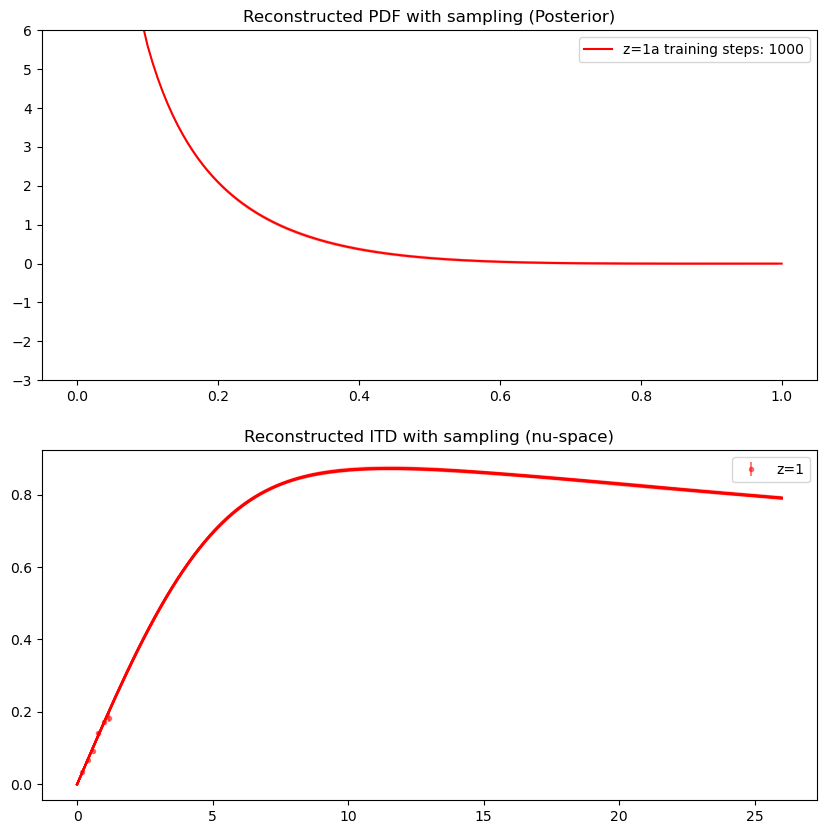

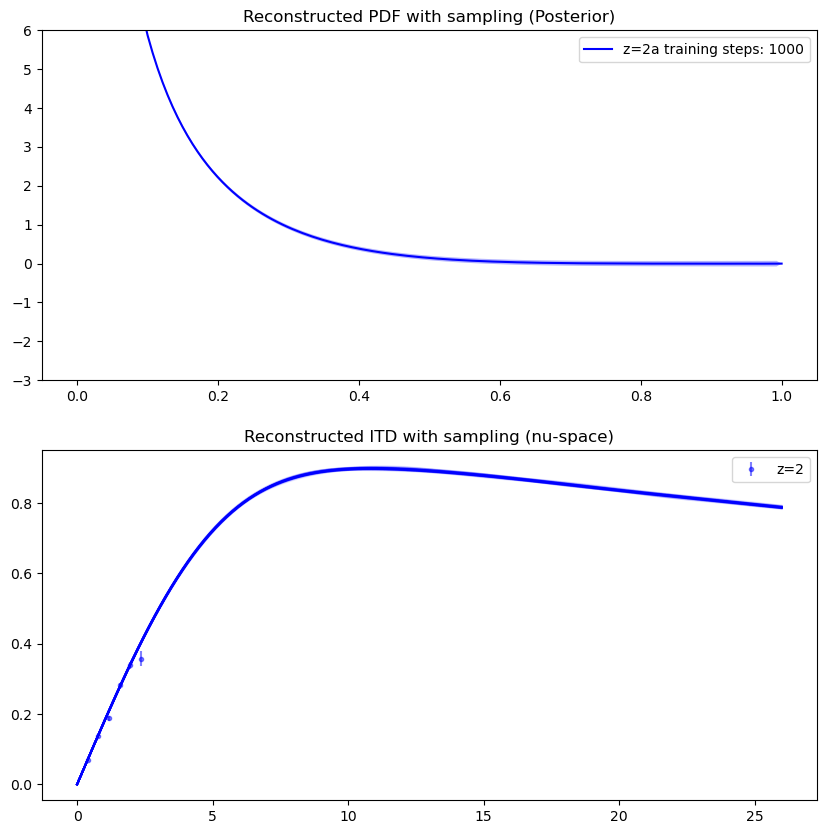

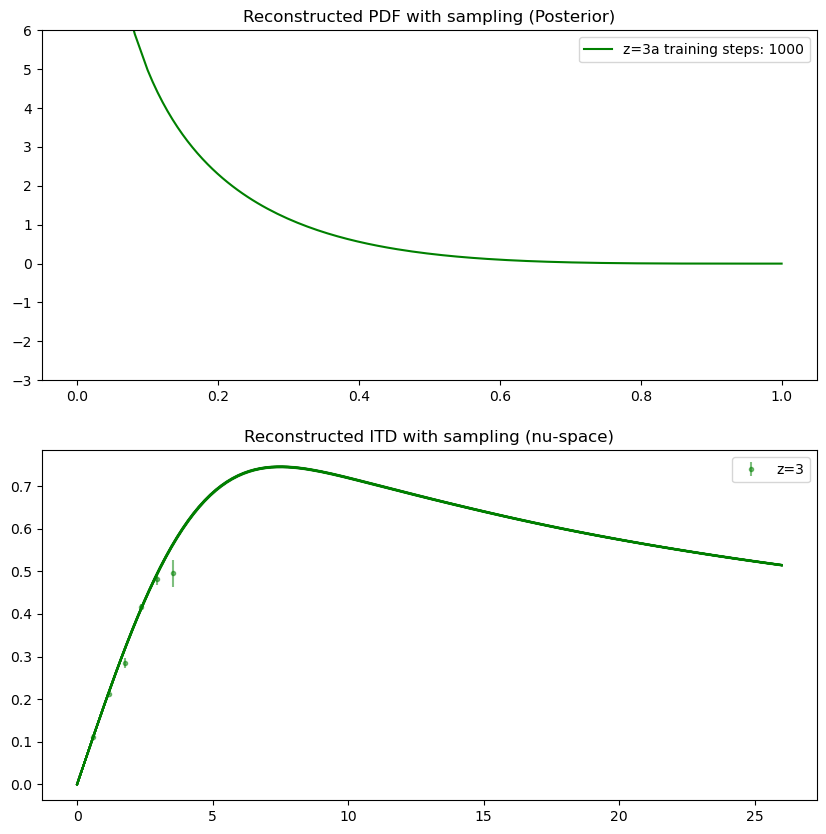

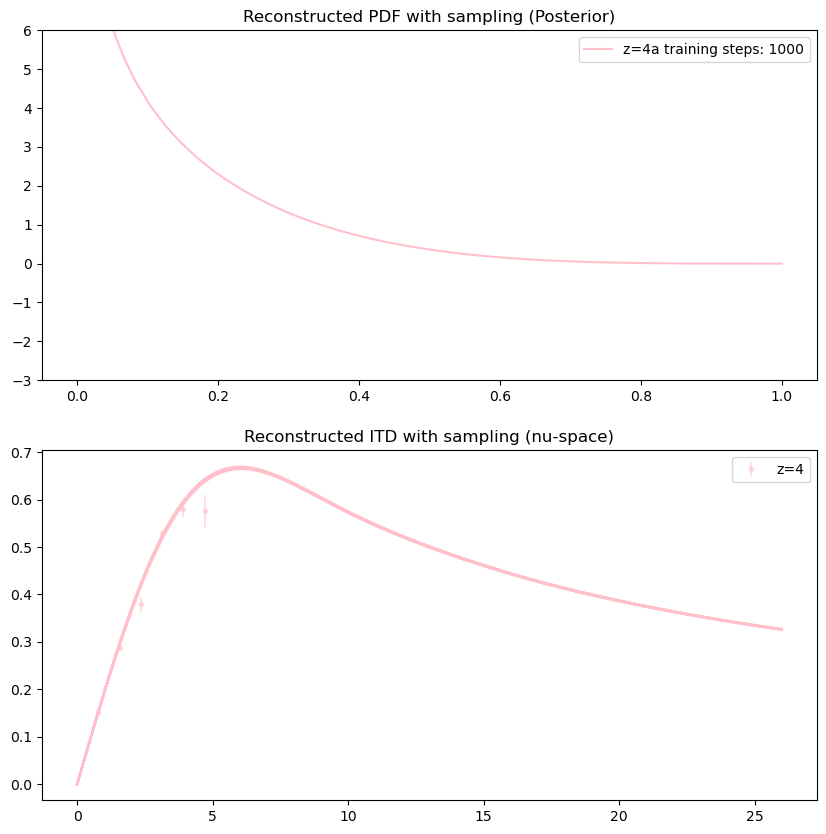

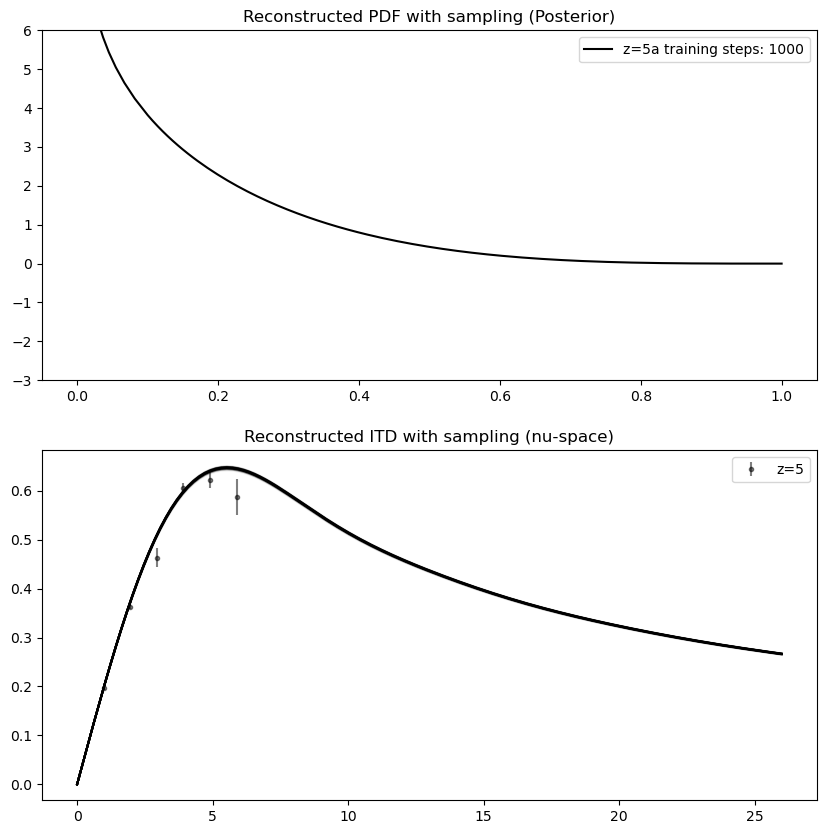

...

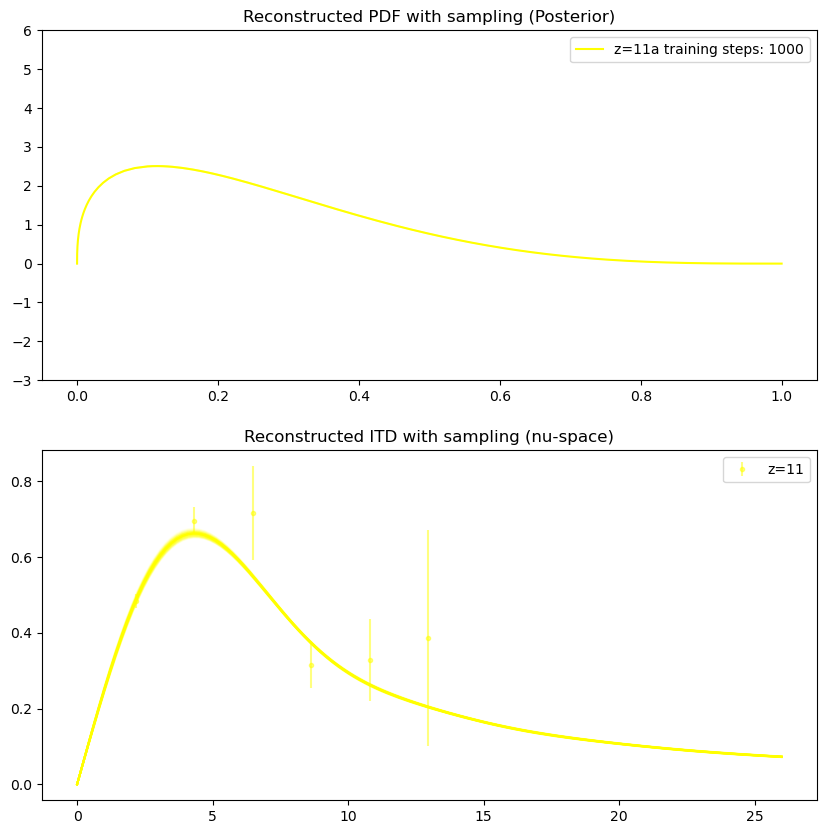

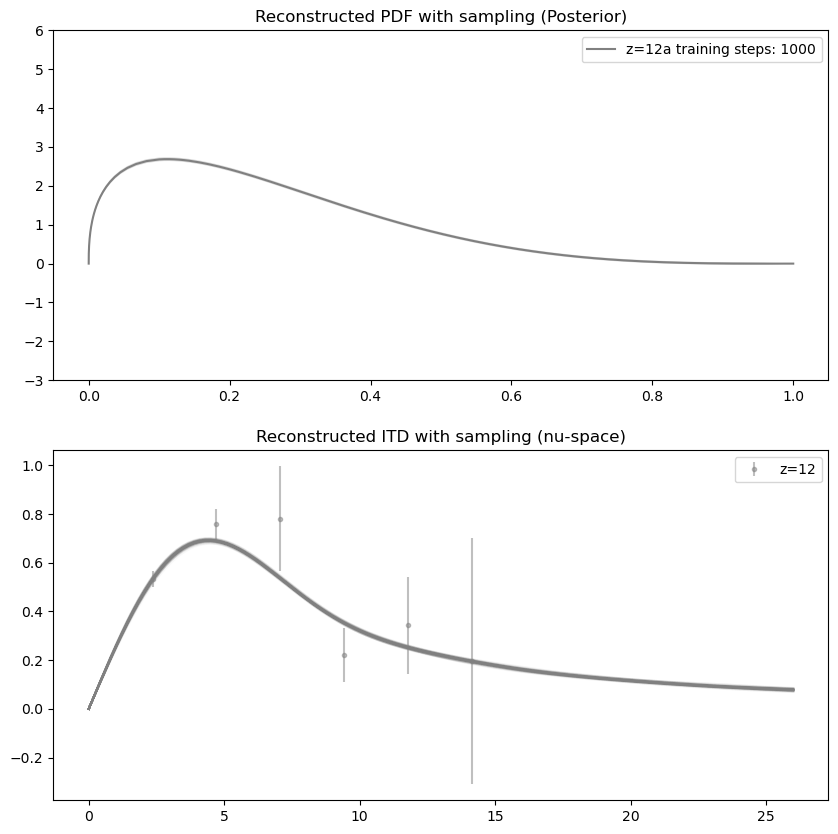

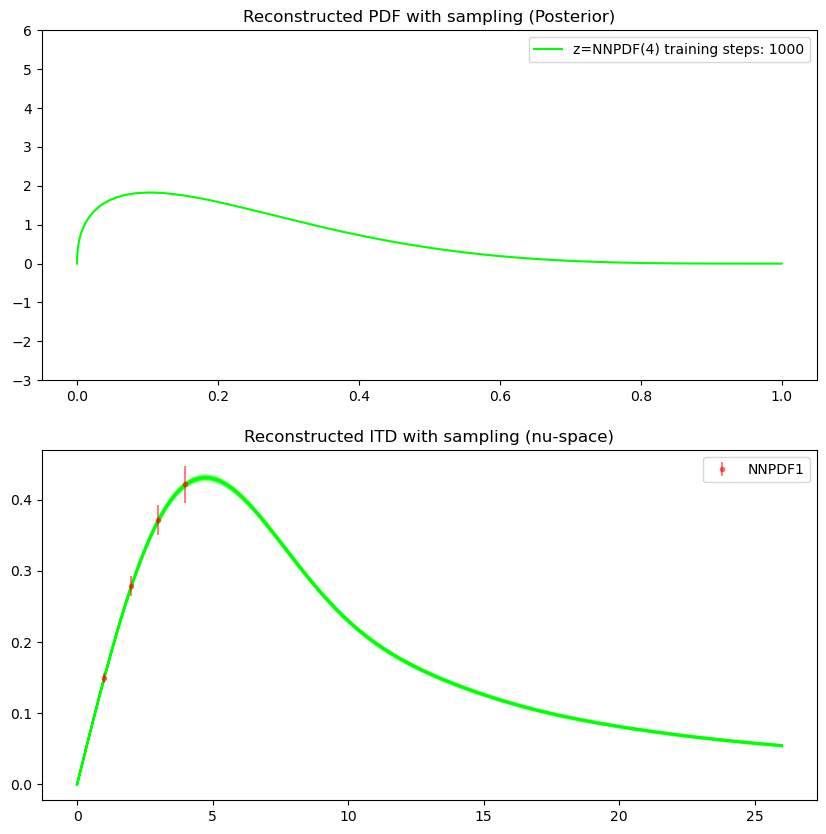

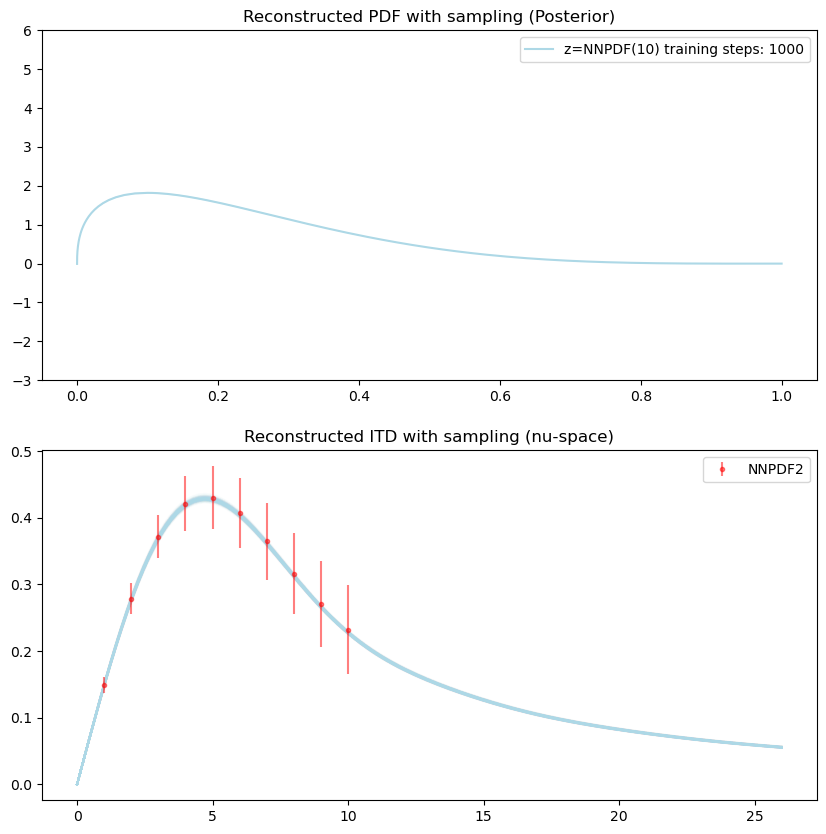

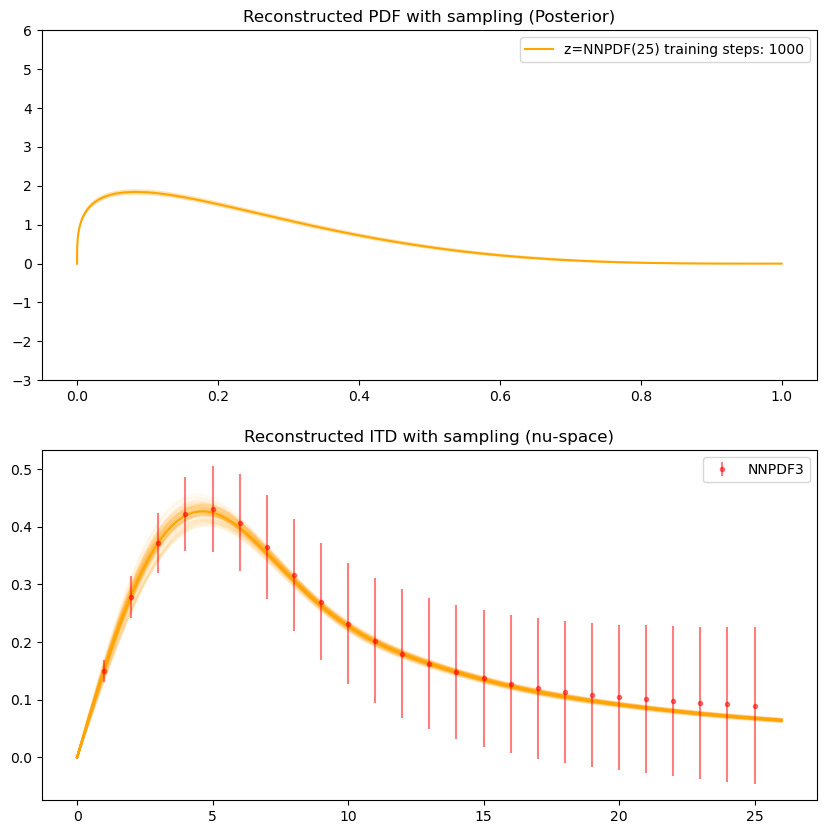

In [8]:
col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
j=0
for i in range(0,number):
    if i in [23]:
        continue
    else:
        fig, ax= plt.subplots(2,figsize=(10, 10))
        ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
        ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
        p,Cp = fits_comb[i].ComputePosterior()
        p,Cp = p.to("cpu"),Cp.to("cpu")
        Cp = 0.5*(Cp+Cp.T) +1e-10*tr.eye(Cp.shape[0])
        #Mc=tr.distributions.MultivariateNormal(p,covariance_matrix=Cp)
        pdfMc= np.random.multivariate_normal(p,Cp,(100,))
        #plot the data
        #pdfMc = Mc.sample((100,))
        #ax[0].plot(x_grid,pdfMc.T,alpha=0.1,color=col[i])
        ax[0].plot(x_gri0,p,label=fits_comb[i].name+' training steps: '+str(fits_comb[i].trainingcount),color=col[i])
        perror=1.96*np.diag(Cp)**(0.5)
        #p=fits_comb[i].Pd(fits_comb[i].x_grid.cpu(),*fits_comb[i].pd_args).numpy()
        ax[0].fill_between(x_gri0, p - perror, p + perror, facecolor=col[i], alpha=0.3)
        
        ax[0].legend()
        ax[0].set_ylim([-3.,6])
        #ax[0].ylim([-0.1,4])
        ttQ = pdfMc@iB.T
        mttQ = ttQ.mean(axis=0)
        ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
        ax[1].plot(nn,mttQ,color=col[i])
        if i >=12 and test=="mock":
            
            print(numax[j])
            numock = np.linspace(0,numax[j],numax[j]+1)#-0.2,0.1,0.01,2.5,0.5,0.1
            jM = pseudo_data1(numock,x_gri0,-0.2,2.5,0.1,0.5,ITD=ITD)
            M = np.mean(jM,axis=0)
            eM = np.std(jM,axis=0)
            plt.errorbar(numock,M,eM,fmt='.',alpha=0.5,label=f'mock({numax[j]})',color='red')
            j=j+1
        elif i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            nu_d_grid = datanu.T[1]
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
            plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label='NNPDF'+str(i-11),color='red')
        else:
            plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color=col[i])
        plt.legend()
        plt.show()

(1000, 5) (1000, 11) (1000, 26)


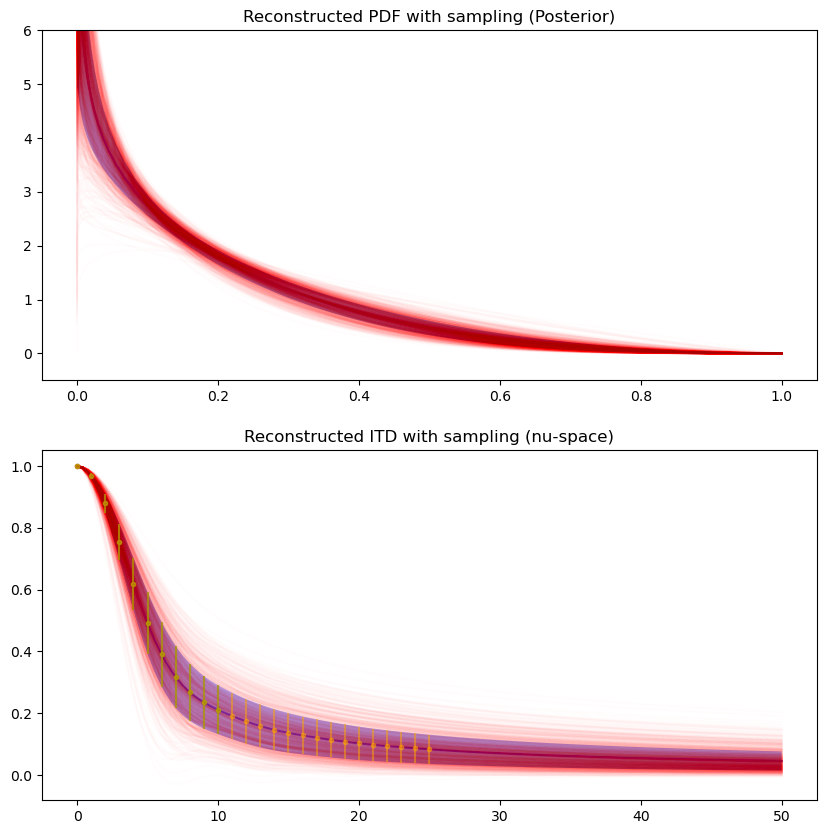

In [17]:
#plot pdf
Nx=2*128
xgrid= np.concatenate((np.logspace(-12,-1,np.int32(Nx/2)),np.linspace(0.1+1e-4,1,np.int32(Nx/2))))
pdf,sa,sb = mockpdf(xgrid,-0.2,2.5,0.1,0.5,1000)
fe = FE2_Integrator(x_gri0)
Nx=x_gri0.shape[0]
nn = np.linspace(0,50,128)
iB = np.zeros((nn.shape[0],Nx))
for k in range(nn.shape[0]):
    iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
itd=pdf.T@iB.T

numax=[4,10,25]
nu_grid1=np.linspace(0,numax[0],numax[0]+1)
nu_grid2=np.linspace(0,numax[1],numax[1]+1)
nu_grid3=np.linspace(0,numax[2],numax[2]+1)
B1= np.zeros((nu_grid1.shape[0],Nx))
B2= np.zeros((nu_grid2.shape[0],Nx))
B3= np.zeros((nu_grid3.shape[0],Nx))
for k in range(nu_grid1.shape[0]):
    B1[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nu_grid1[k]*x))
for k in range(nu_grid2.shape[0]):
    B2[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nu_grid2[k]*x))
for k in range(nu_grid3.shape[0]):
    B3[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nu_grid3[k]*x))
itd1=pdf.T@B1.T
itd2=pdf.T@B2.T
itd3=pdf.T@B3.T
m1=itd1.mean(axis=0)
s1=itd1.std(axis=0)
m2=itd2.mean(axis=0)
s2=itd2.std(axis=0)
m3=itd3.mean(axis=0)
s3=itd3.std(axis=0)

print(itd1.shape,itd2.shape,itd3.shape)

fig, ax= plt.subplots(2,figsize=(10, 10))
ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
ax[0].plot(xgrid,pdf.mean(axis=1),alpha=0.5,color='blue')
ax[0].plot(xgrid,pdf,alpha=0.01,color='red')
fci=1.
ax[0].fill_between(xgrid, pdf.mean(axis=1) - fci*np.std(pdf,axis=1), pdf.mean(axis=1) + fci*np.std(pdf,axis=1), facecolor='blue', alpha=0.3)
ax[0].set_ylim([-.5,6])
ax[1].fill_between(nn,itd.mean(axis=0) - fci*np.std(itd,axis=0), itd.mean(axis=0) + fci*np.std(itd,axis=0), facecolor='blue', alpha=0.3)
ax[1].plot(nn,itd.mean(axis=0),alpha=0.5,color='blue')
ax[1].plot(nn,itd.T,alpha=0.01,color='red')
plt.errorbar(nu_grid1,m1,s1,fmt='.',alpha=0.5,label=f'mock({numax[0]})',color='red')
plt.errorbar(nu_grid2,m2,s2,fmt='.',alpha=0.5,label=f'mock({numax[1]})',color='green')
plt.errorbar(nu_grid3,m3,s3,fmt='.',alpha=0.5,label=f'mock({numax[2]})',color='orange')


plt.show()

# Sampling

In [12]:
##sample all the parameters
#momentum=1*tr.tensor([1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0])
#sigma=tr.tensor([3.0,5.0,6.0,5.0,6.0,5.0,5.5,2.0])
momentum=tr.ones_like(mean)
samplers=[]
for i in range(0,number):
    #GPsampler=HMC_sampler(myGP0.nlogpost2levelpdf,grad=myGP0.gradlogpost2levelpdf,diagonal=momentum)
    #shift=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")-tr.ones(8)
    #shift=tr.tensor([0,0, 0.9851, 1.7835, 1.6409, 0.8482, 1.0654,0.0627])-tr.ones(8)
    #fits_comb[i].prior2ndlevel("kernel",1000,mean=shift,sigma=2*tr.ones(8),prior_mode=tr.tensor([2,2,2,2,2,2,2,2]))
    GPsampler=HMC_sampler(fits_comb[i].nlogpost2levelpdf,device="cpu",diagonal=1.0*momentum,grad=None)
    #rand=tr.rand(7)*5
    
    #GPsampler.q0=tr.tensor(fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")
    
    #GPsampler.q0=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args+ (fits_comb[i].sig,)).to("cpu")
    #print(GPsampler.q0)
    GPsampler.q0=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args).to("cpu")#+ (fits_comb[i].sig,))
    samplers.append(GPsampler)
    print(fits_comb[i].name,"sampler done")

z=1a sampler done
z=2a sampler done
z=3a sampler done
z=4a sampler done
z=5a sampler done
z=6a sampler done
z=7a sampler done
z=8a sampler done
z=9a sampler done
z=10a sampler done
z=11a sampler done
z=12a sampler done
z=mock(4) sampler done
z=mock(10) sampler done
z=mock(25) sampler done


The purpose of this nugget hyperparameter is to determine if the kernel with a extra hyperparameter has more or less uncertainty

### Model+ Kernel

In [ ]:
i=14
start=time.time()
traceq,tracep,traceH=samplers[i].sample(samplers[i].q0,100,1.0/2000,500)
end=time.time()
print("time",end-start)

  0%|                                                                                                         | 0/99 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████| 99/99 [01:39<00:00,  1.01s/it]
time 99.67121028900146


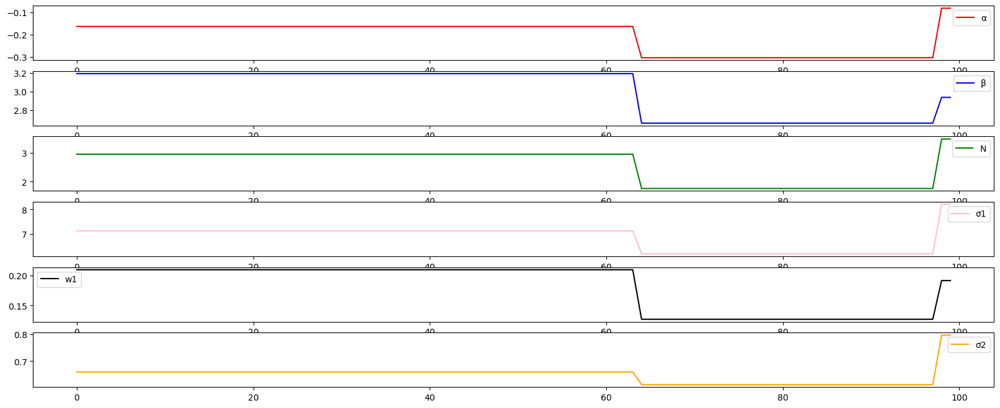

In [17]:
#traceq=tr.load("Krbf+log(z=12a).pt")
plotrace(traceq[0:1000].cpu(),0,kernel='splitrbf')

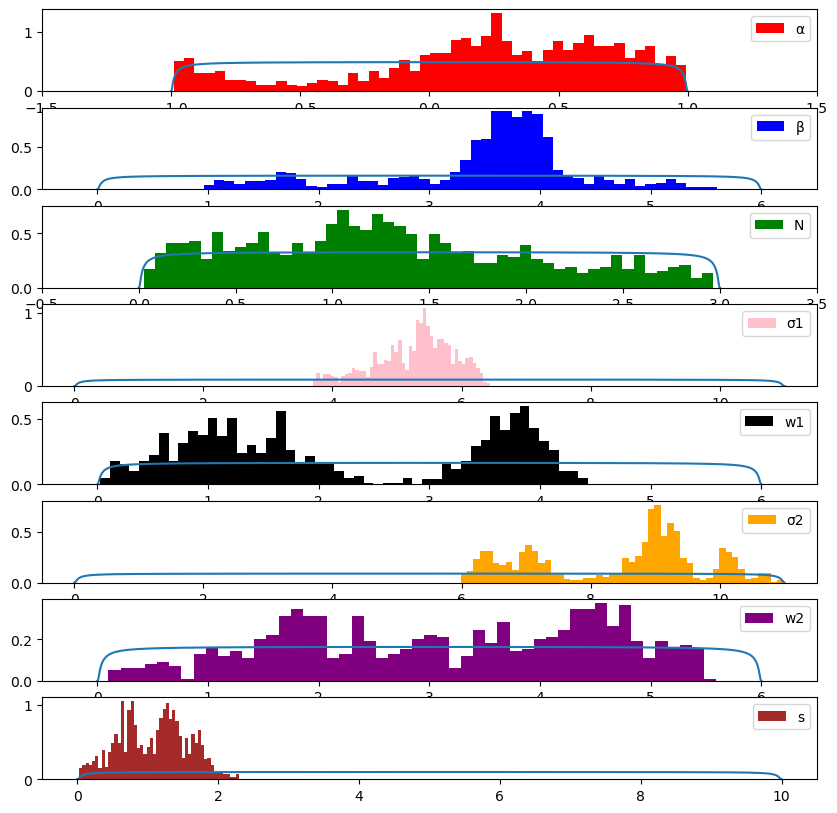

In [18]:
plothist(traceq[0:10000],fits_comb[i],50,prior=True,burn=0,kernel='combinedRBF')

# Load previous data saved

In [20]:
import os
import torch

# Specify the directory containing the tensors
tensor_dir = "./PDF_rbf_logrbf"

# Define the filename pattern
file_pattern = "KRe(z=mock(25))"

# List all files in the directory
tensor_files = [f for f in os.listdir(tensor_dir) if f.startswith(file_pattern) and f.endswith(".pt")]

# Load all tensors
traces = []
for file in tensor_files:
    file_path = os.path.join(tensor_dir, file)
    print(f"Loading tensor from: {file_path}")
    tensor = torch.load(file_path)
    traces.append(tensor)

Loading tensor from: ./PDF_rbf_logrbf/KRe(z=mock(25))14.pt


/local/scr/yacahuanamedra/TMPDIR/ipykernel_503204/4260214571.py:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  tensor = torch.load(file_path)


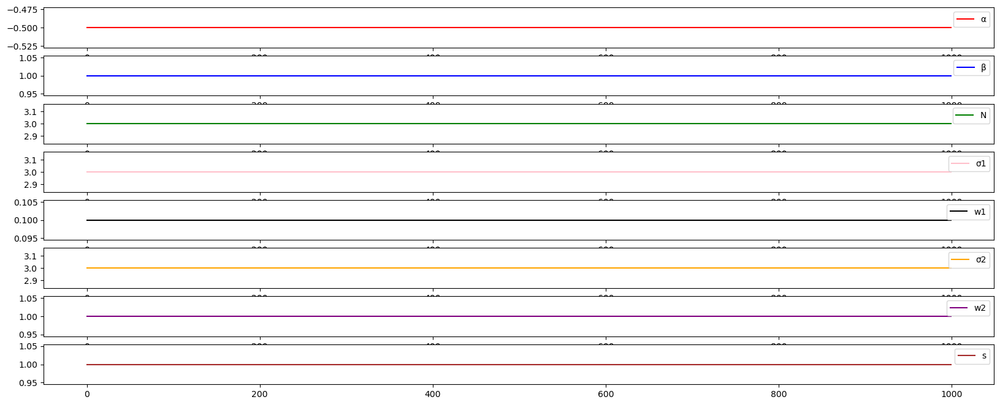

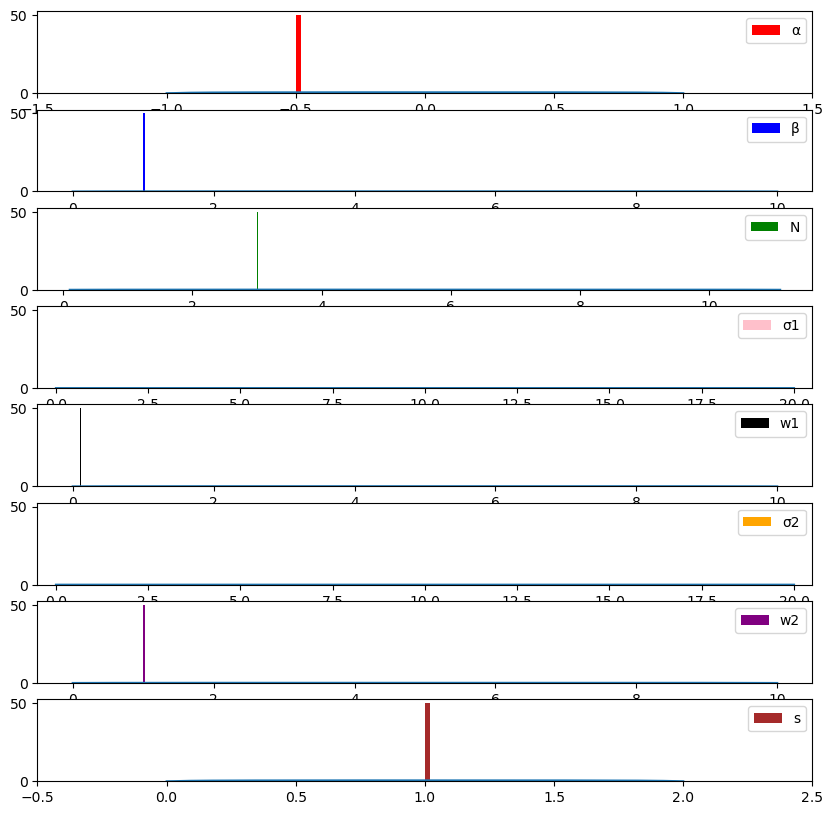

In [21]:
for i in range(0,1):
    plotrace(traces[i][0:100000].cpu(),0,kernel='combinedRBF')
    plothist(traces[i][0:100000].cpu(),fits_comb[i],50,prior=True,burn=0,kernel='combinedRBF')

# Stack different chains to 1 (do not run more than once per directory)


In [6]:
import os
import re
import torch as tr

# Ruta al directorio con los archivos
folder_path = "/sciclone/pscr/yacahuanamedra/ModelC_Krbflog"

# Función para extraer el valor de z y la familia
def extract_z_value_and_family(filename):
    """
    Extrae el valor de z y la familia (KRe o KIm) del nombre del archivo.
    """
    match = re.search(r'(KRe|KIm)\(z=(\d+a|NNPDF\(\d+\))', filename)
    if match:
        family = match.group(1)  # 'KRe' o 'KIm'
        z_value = match.group(2)  # '11a', 'NNPDF(4)', etc.
        return family, z_value
    return None, None

# Listar y filtrar archivos con extensión .pt
tensor_files = [f for f in os.listdir(folder_path) if f.endswith('.pt')]

# Agrupar archivos por familia y valor de z
grouped_files = {}
for file in tensor_files:
    family, z_value = extract_z_value_and_family(file)
    if family and z_value:
        grouped_files.setdefault((family, z_value), []).append(os.path.join(folder_path, file))

# Combinar los archivos en cada grupo y eliminar los originales
for (family, z_value), files in grouped_files.items():
    files.sort()  # Asegurarse de procesar los archivos en orden
    print(f"Procesando {family}(z={z_value}) con {len(files)} archivos.")
    
    try:
        # Cargar y combinar tensores
        tensors = [tr.load(file) for file in files]
        combined_tensor = tr.cat(tensors, dim=0)  # Ajustar el dim=0 si es necesario

        # Guardar el tensor combinado
        combined_file_name = os.path.join(folder_path, f"{family}(z={z_value}).pt")
        tr.save(combined_tensor, combined_file_name)
        print(f"Guardado tensor combinado para {family}(z={z_value}) en {combined_file_name}")

        # Eliminar los archivos originales
        for file in files:
            os.remove(file)
            print(f"Eliminado archivo: {file}")

    except Exception as e:
        print(f"Error procesando archivos para {family}(z={z_value}): {e}")

Procesando KIm(z=NNPDF(10)) con 1 archivos.
Guardado tensor combinado para KIm(z=NNPDF(10)) en /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=NNPDF(10)).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=NNPDF(10))1.pt
Procesando KRe(z=11a) con 9 archivos.
Guardado tensor combinado para KRe(z=11a) en /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)1.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)10.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)100.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)145.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)25.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)40.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=11a)55.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/Mod

/local/scr/yacahuanamedra/TMPDIR/ipykernel_592724/4293578821.py:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  tensors = [tr.load(file) for file in files]


Guardado tensor combinado para KRe(z=2a) en /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)1.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)136.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)16.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)31.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)46.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)61.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)76.pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a)91.pt
Procesando KRe(z=NNPDF(25)) con 9 archivos.
Guardado tensor combinado para KRe(z=NNPDF(25)) en /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=NNPDF(25)).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=NNPDF(25))1.pt
Eliminado archivo: /s

In [5]:
output_directory = f"/sciclone/pscr/yacahuanamedra/{modelname}_{kernelname}/"
for i, tensor in enumerate(traces):
    file_path = f"{output_directory}KIm({fits_comb[i].name}).pt"
    tr.save(tensor, file_path)
    print(f"Tensor {i} guardado en {file_path}")

NameError: name 'traces' is not defined

# Load sampled hyperparameters

In [6]:
def load_sampled_hyperparameters(fits_comb,ITD,modelname,kernelname,number):
    traces = []
    base_path = f"/sciclone/pscr/yacahuanamedra/{modelname}_{kernelname}"
    for i in range(0, number):
        file_name = f"K{ITD}({fits_comb[i].name}).pt"
        file_path = os.path.join(base_path, file_name)
        try:
            trace = tr.load(file_path)
            traces.append(trace)
            print(f"Traces loaded from: {file_path} - Shape: {trace.shape}")
        except Exception as e:
            print(f"Error loading {file_path}: {e}")
    return traces
ModelC_Krbflog_Re_traces=load_sampled_hyperparameters(ModelC_Krbflog_Re,"Re",'ModelC','Krbflog',number)
ModelC_Krbflog_Im_traces=load_sampled_hyperparameters(ModelC_Krbflog_Im,"Im",'ModelC','Krbflog',number)
PDF_Krbflog_Re_traces=load_sampled_hyperparameters(PDF_Krbflog_Re,"Re",'PDF','Krbflog',number)
PDF_Krbflog_Im_traces=load_sampled_hyperparameters(PDF_Krbflog_Im,"Im",'PDF','Krbflog',number)

ModelC_Kdebbioxa_Re_traces=load_sampled_hyperparameters(ModelC_Kdebbioxa_Re,"Re",'ModelC','Kdebbioxa',number)
ModelC_Kdebbioxa_Im_traces=load_sampled_hyperparameters(ModelC_Kdebbioxa_Im,"Im",'ModelC','Kdebbioxa',number)
PDF_Kdebbioxa_Re_traces=load_sampled_hyperparameters(PDF_Kdebbioxa_Re,"Re",'PDF','Kdebbioxa',number)
PDF_Kdebbioxa_Im_traces=load_sampled_hyperparameters(PDF_Kdebbioxa_Im,"Im",'PDF','Kdebbioxa',number)

ModelC_Krbflog_no_s_Re_traces=load_sampled_hyperparameters(ModelC_Krbflog_no_s_Re,"Re",'ModelC','Krbflog_no_s',number)
ModelC_Krbflog_no_s_Im_traces=load_sampled_hyperparameters(ModelC_Krbflog_no_s_Im,"Im",'ModelC','Krbflog_no_s',number)
PDF_Krbflog_no_s_Re_traces=load_sampled_hyperparameters(PDF_Krbflog_no_s_Re,"Re",'PDF','Krbflog_no_s',number)
PDF_Krbflog_no_s_Im_traces=load_sampled_hyperparameters(PDF_Krbflog_no_s_Im,"Im",'PDF','Krbflog_no_s',number)

ModelC_rbf_logrbf_Re_traces=load_sampled_hyperparameters(ModelC_rbf_logrbf_Re,"Re",'ModelC','rbf_logrbf',number)
ModelC_rbf_logrbf_Im_traces=load_sampled_hyperparameters(ModelC_rbf_logrbf_Im,"Im",'ModelC','rbf_logrbf',number)
PDF_rbf_logrbf_Re_traces=load_sampled_hyperparameters(PDF_rbf_logrbf_Re,"Re",'PDF','rbf_logrbf',number)
PDF_rbf_logrbf_Im_traces=load_sampled_hyperparameters(PDF_rbf_logrbf_Im,"Im",'PDF','rbf_logrbf',number)

/local/scr/yacahuanamedra/TMPDIR/ipykernel_182669/2927278475.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  trace = tr.load(file_path)


Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=1a).pt - Shape: torch.Size([70000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=2a).pt - Shape: torch.Size([40000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=3a).pt - Shape: torch.Size([90000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=4a).pt - Shape: torch.Size([90000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=5a).pt - Shape: torch.Size([90000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=6a).pt - Shape: torch.Size([40000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=7a).pt - Shape: torch.Size([65000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=8a).pt - Shape: torch.Size([90000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KRe(z=9a).pt - Shape: torch.Size([90000, 3])
Traces loa

In [ ]:
import os
import torch as tr

# Initialize the list to store the loaded tensors
traces = []

# Base path where the combined tensors are located
base_path = f"/sciclone/pscr/yacahuanamedra/{modelname}_{kernelname}"

# Debug: List files in the base directory
#print("Files in directory:", os.listdir(base_path))

# Load the combined tensors
for i in range(0, number):  # Iterates from 0 to `number - 1`
    file_name = f"K{ITD}({fits_comb[i].name}).pt"
    file_path = os.path.join(base_path, file_name)
    
    # Check if the file exists
    if not os.path.exists(file_path):
        print(f"File does not exist: {file_path}")
        continue

    # Try loading the tensor
    try:
        trace = tr.load(file_path)  # Load the tensor
        traces.append(trace)       # Append it to the list
        print(f"Traces loaded from: {file_path} - Shape: {trace.shape}")
    except Exception as e:
        print(f"Error loading {file_path}: {e}")

# Optional: Combine all traces into a single tensor
if traces:
    all_traces = tr.cat(traces, dim=0)  # Adjust dim as needed
    print(f"Combined tensor size: {all_traces.shape}")
else:
    print("No traces were loaded.")

Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=1a).pt - Shape: torch.Size([75000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=2a).pt - Shape: torch.Size([25000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=3a).pt - Shape: torch.Size([100000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=4a).pt - Shape: torch.Size([100000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=5a).pt - Shape: torch.Size([25000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=6a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=7a).pt - Shape: torch.Size([100000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=8a).pt - Shape: torch.Size([75000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/ModelC_Krbflog/KIm(z=9a).pt - Shape: torch.Size([75000, 3])
Traces 

/local/scr/yacahuanamedra/TMPDIR/ipykernel_584191/1178015262.py:25: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  trace = tr.load(file_path)  # Load the tensor


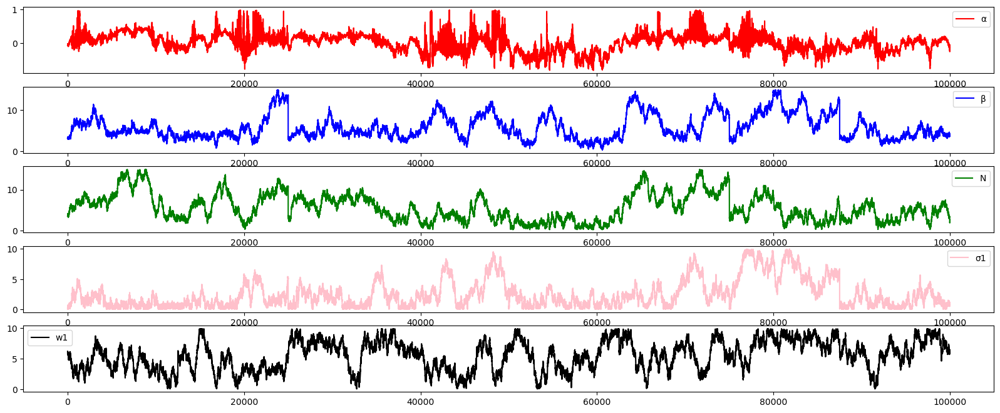

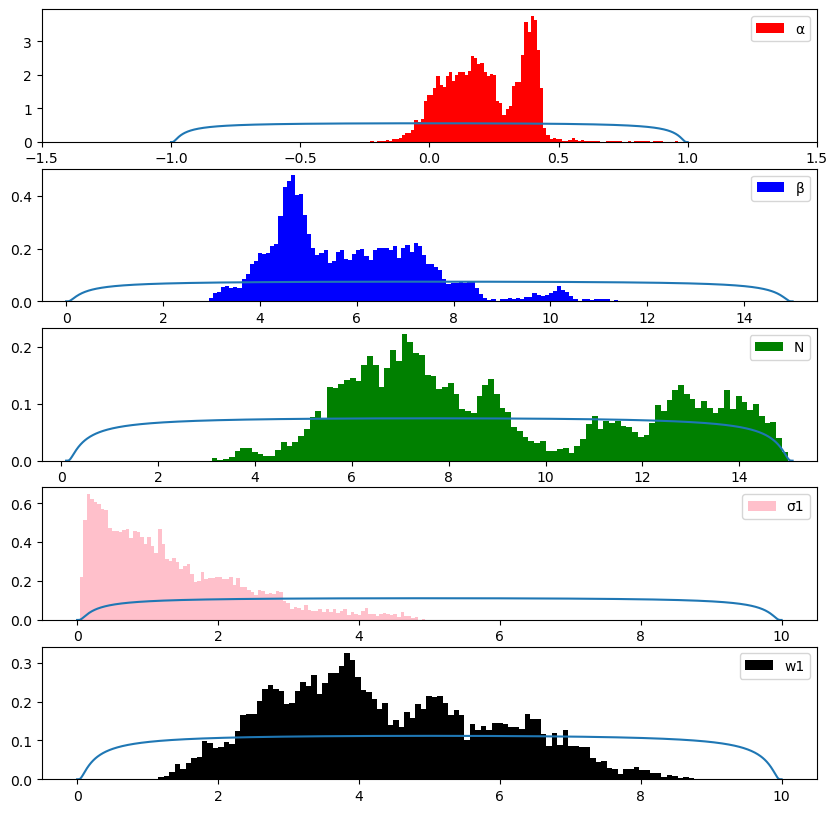

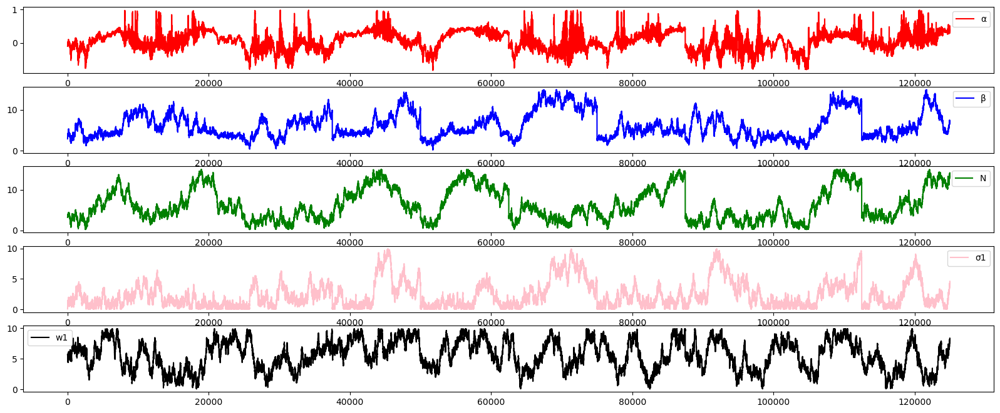

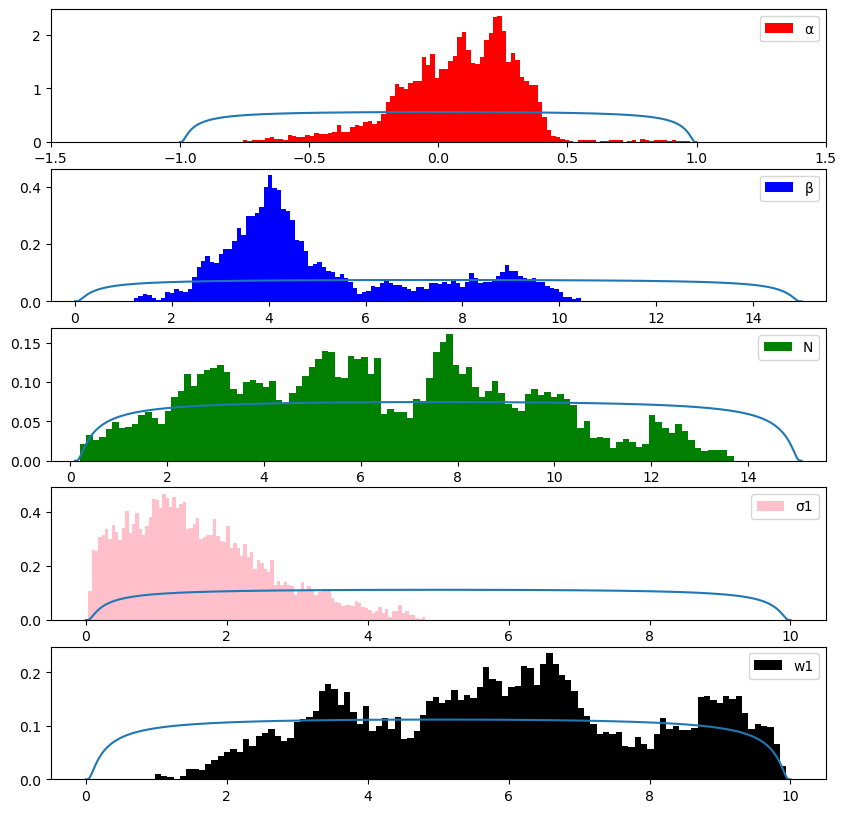

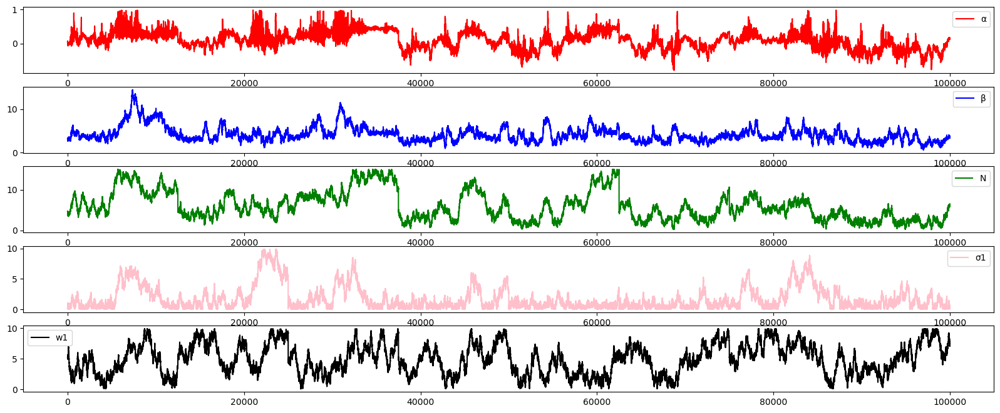

...

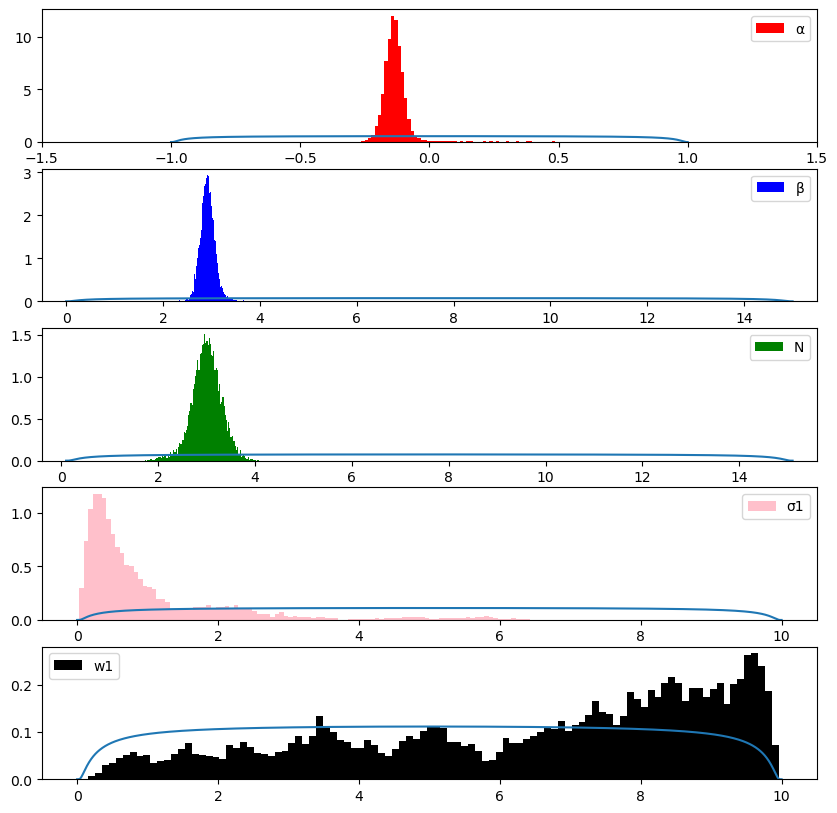

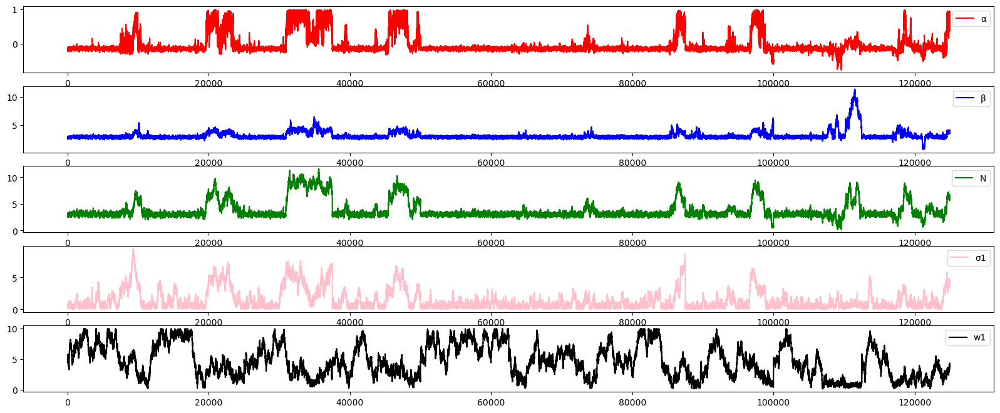

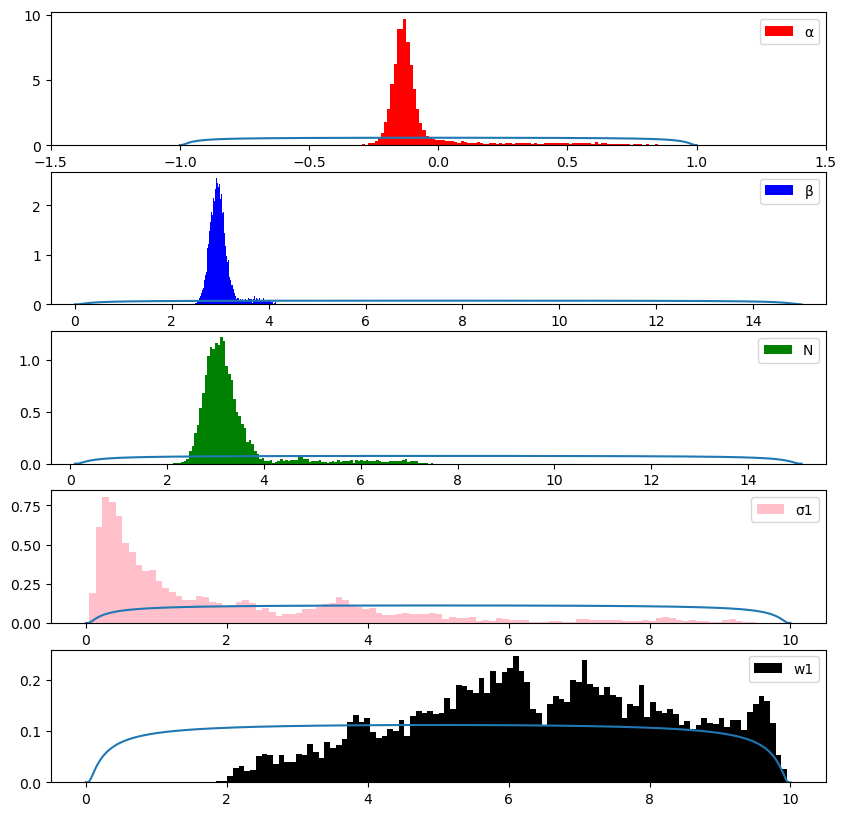

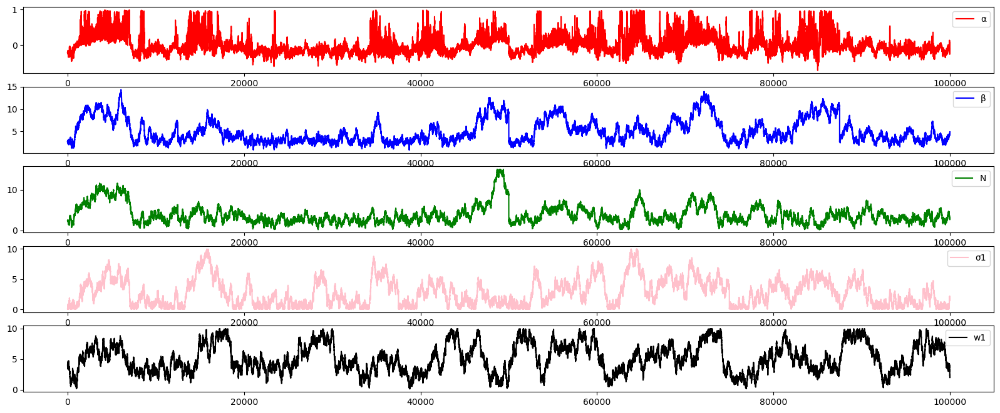

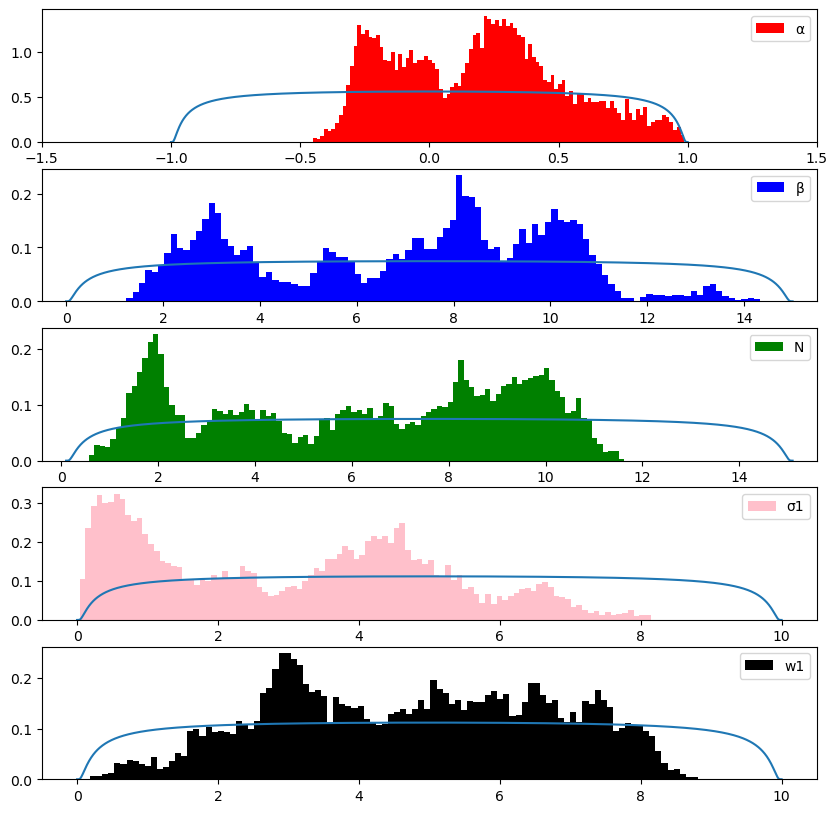

In [33]:
for i in range(0,number):
    plotrace(PDF_Krbflog_Re_traces[i][0:200000].cpu(),0,kernel='combinedRBF')
    plothist(PDF_Krbflog_Re_traces[i][0:200000].cpu(),PDF_Krbflog_Re[i],100,prior=True,burn=100,kernel='combinedRBF')

## Filter traces

In [8]:
#If there is no filtering process
filtered_traces = traces

In [18]:
def filter_constant_sections(tensor, threshold=0.00000001):
    """
    Filtra las secciones constantes de una cadena en el tensor eliminando tramos planos.

    Args:
        tensor (torch.Tensor): Tensor con una cadena (1D o varias columnas).
        threshold (float): Diferencia mínima para considerar un cambio significativo.

    Returns:
        torch.Tensor: Tensor filtrado con solo las fluctuaciones.
    """
    # Calcular diferencias entre elementos consecutivos para cada columna
    diffs = tr.abs(tensor[1:] - tensor[:-1])
    
    # Identificar los índices donde ocurre un cambio significativo
    significant_changes = tr.any(diffs > threshold, dim=1)
    
    # Añadir el primer valor para mantener el inicio de la cadena
    significant_changes = tr.cat([tr.tensor([True]), significant_changes])
    
    # Filtrar el tensor para conservar solo las fluctuaciones
    filtered_tensor = tensor[significant_changes]
    
    return filtered_tensor


# Filtrar las constantes en cada tensor de la lista
filtered_traces = [filter_constant_sections(tensor) for tensor in traces]

# Imprimir el tamaño original y el filtrado para cada tensor
for i, (original, filtered) in enumerate(zip(traces, filtered_traces)):
    print(f"Tensor {i}: Original size {original.size()}, Filtered size {filtered.size()}")

Tensor 0: Original size torch.Size([100000, 8]), Filtered size torch.Size([99603, 8])
Tensor 1: Original size torch.Size([100000, 8]), Filtered size torch.Size([99905, 8])
Tensor 2: Original size torch.Size([100000, 8]), Filtered size torch.Size([99962, 8])
Tensor 3: Original size torch.Size([100000, 8]), Filtered size torch.Size([712, 8])
Tensor 4: Original size torch.Size([100000, 8]), Filtered size torch.Size([21587, 8])
Tensor 5: Original size torch.Size([100000, 8]), Filtered size torch.Size([60538, 8])
Tensor 6: Original size torch.Size([100000, 8]), Filtered size torch.Size([97343, 8])
Tensor 7: Original size torch.Size([100000, 8]), Filtered size torch.Size([99350, 8])
Tensor 8: Original size torch.Size([100000, 8]), Filtered size torch.Size([99869, 8])
Tensor 9: Original size torch.Size([100000, 8]), Filtered size torch.Size([99909, 8])
Tensor 10: Original size torch.Size([100000, 8]), Filtered size torch.Size([99980, 8])
Tensor 11: Original size torch.Size([100000, 8]), Filte

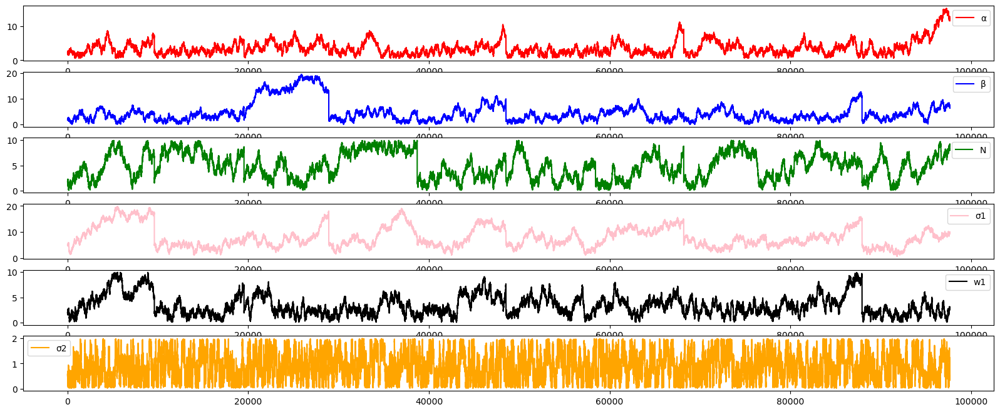

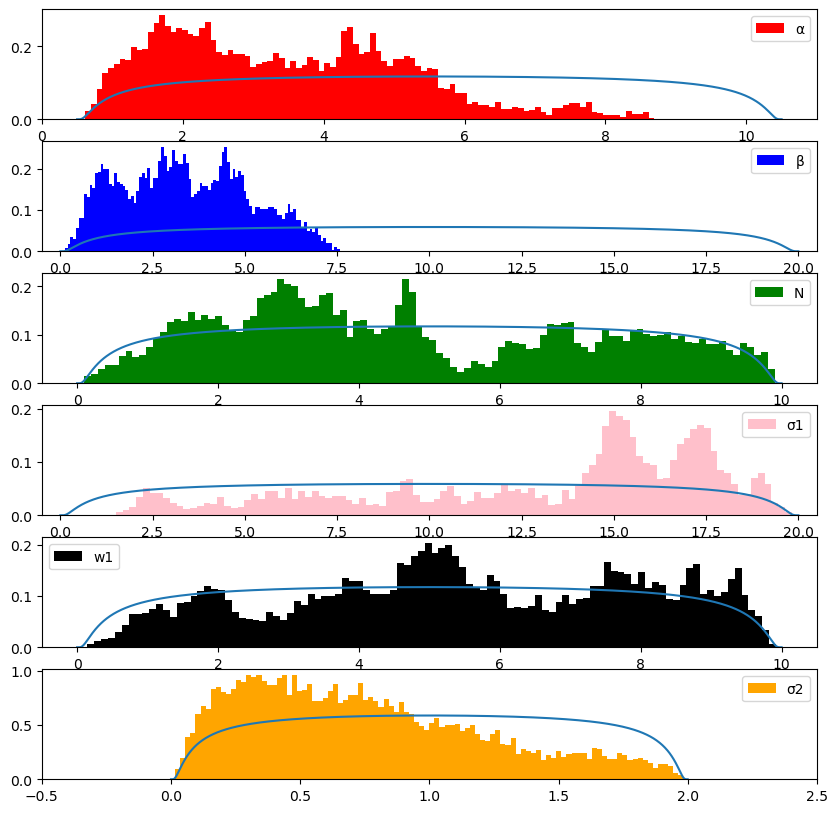

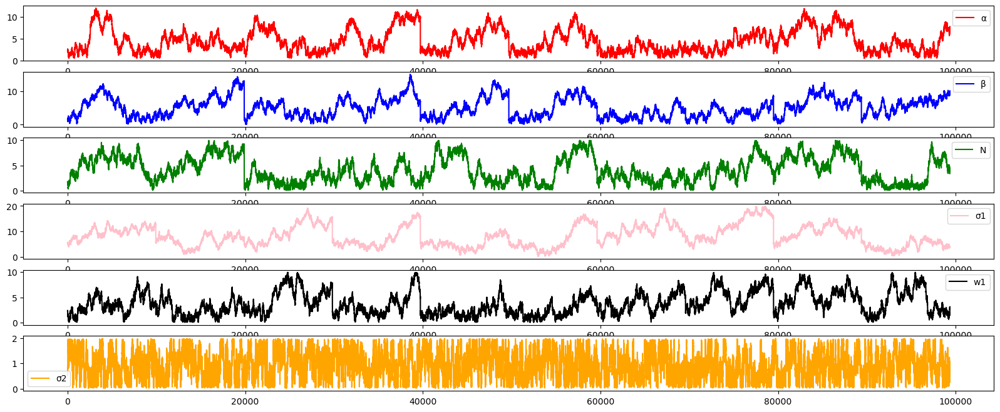

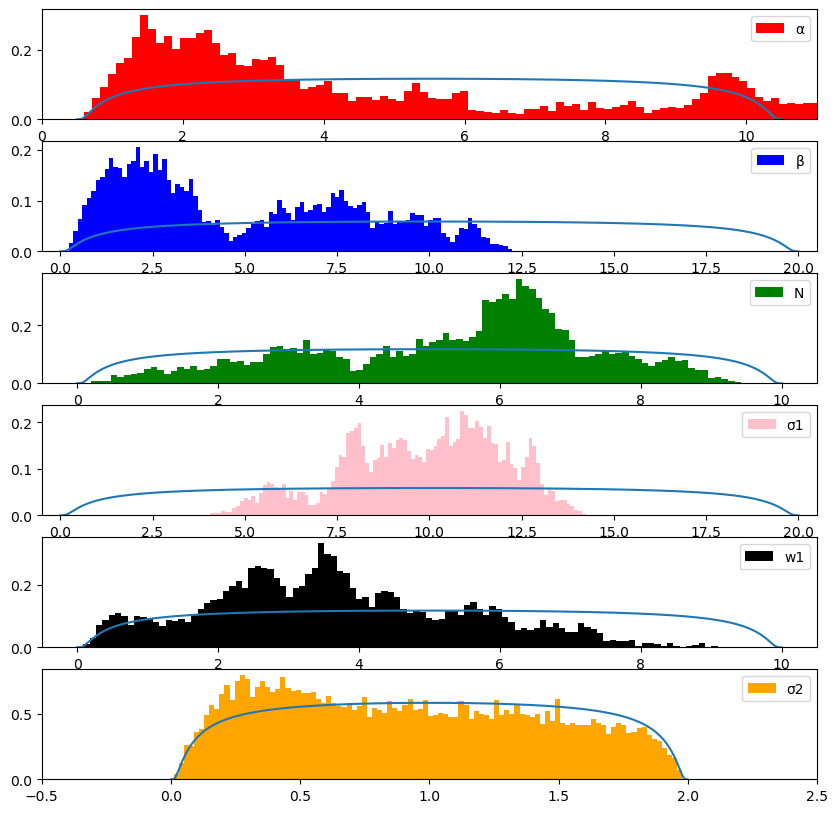

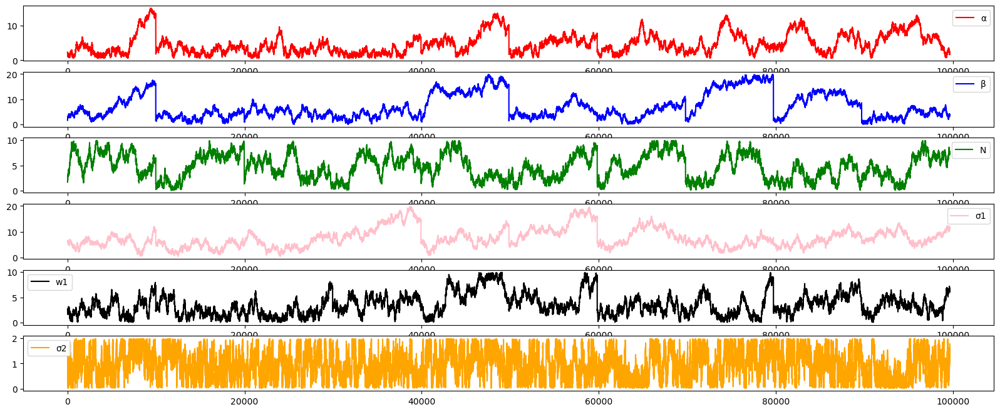

...

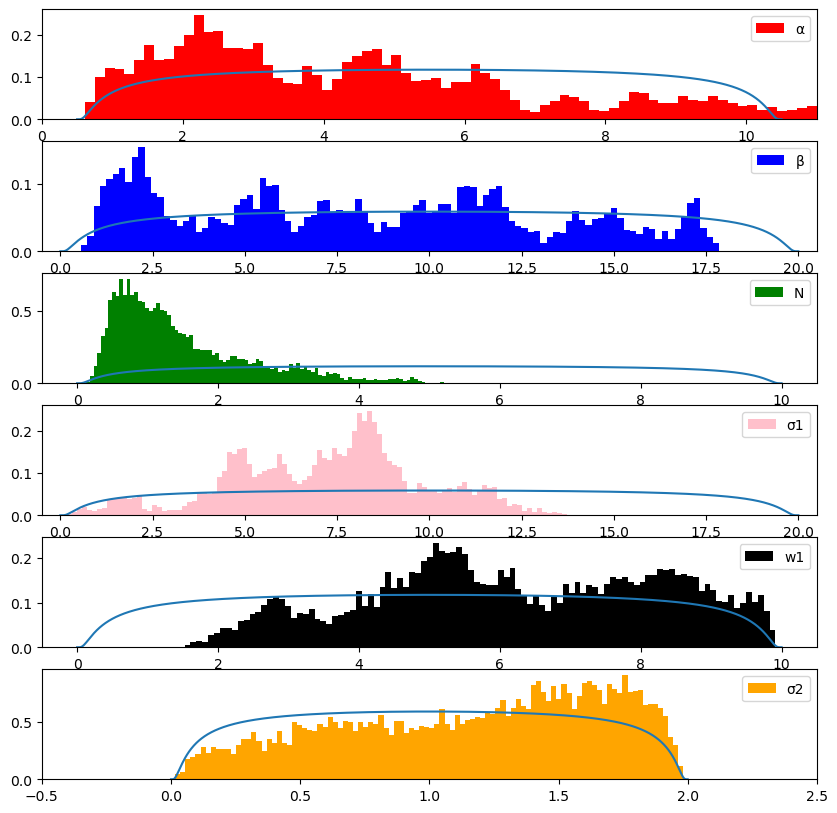

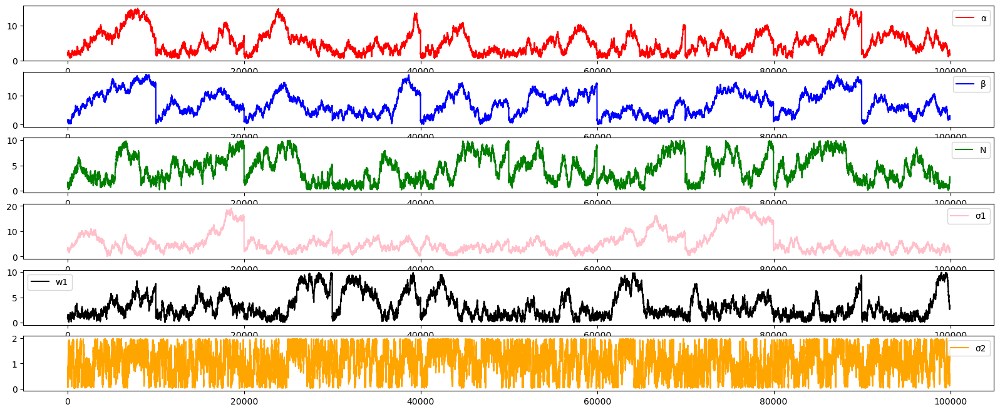

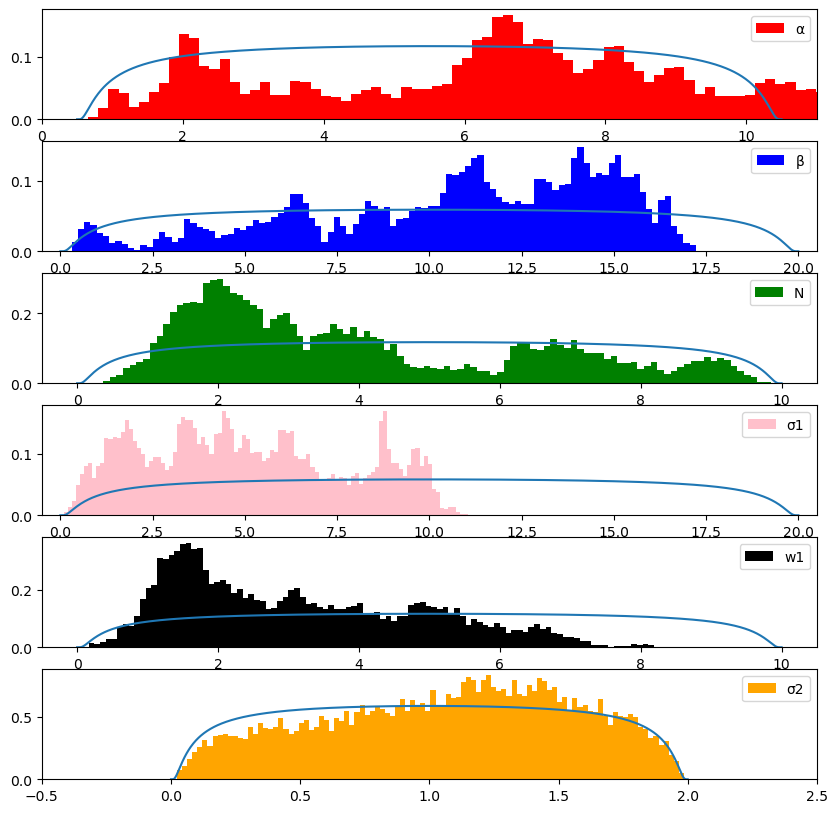

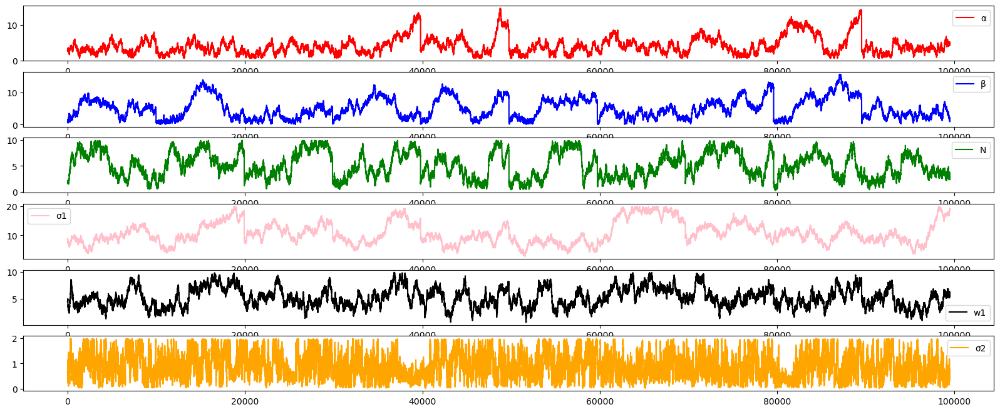

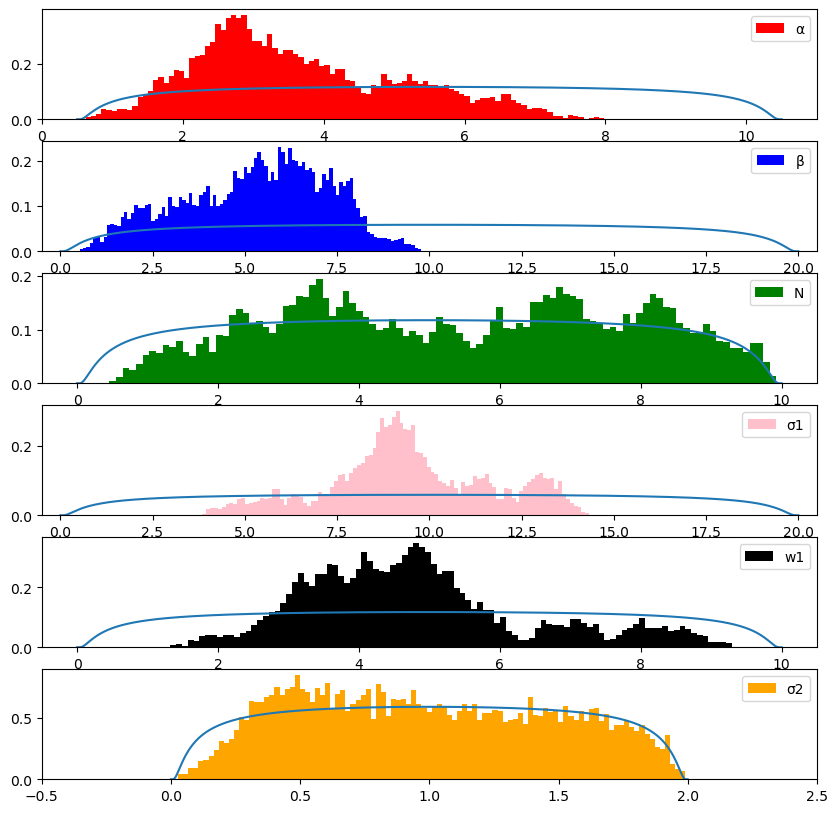

In [18]:
for i in range(0,number):
    plotrace(filtered_traces[i][0:200000].cpu(),0,kernel='combinedRBF')
    plothist(filtered_traces[i][0:200000].cpu(),fits_comb[i],100,prior=True,burn=100,kernel='combinedRBF')

# Uncertainty analysis

In this case the evidence definition includes a factor 1/2
\begin{equation}
    \langle q(x)\rangle= \frac{\sum_i e^{-E(\theta_i)}\bar{q}(x,\theta_i)}{\sum_i e^{-E(\theta_i)}}
\end{equation}
And the covariance matrix can be 
\begin{equation}
    \langle (q(x)-\langle q(x)\rangle)(q(x')-\langle q(x')\rangle)\rangle= \frac{\sum_i e^{-E(\theta_i)}[H^{-1}(\theta)+(\bar{q}(x,\theta)-\langle q(x)\rangle)(\bar{q}(x',\theta)-\langle q(x')\rangle)]}{\sum_i e^{-E(\theta_i)}}
\end{equation}
I add the denominator factor. I follow a similar procedure for the case of the Ioffe time distributions, with the same evidence factor.

In [7]:
def Modelaveraging(fits_comb,filtered_traces,number):
    samplesqx=[]
    samplesQv=[]
    qofxs=[]
    Qofvs=[]
    covs=[]
    covsnu=[]
    nnn=1500
    print('### INITIALIZE MODEL AVERAGING ###')
    #remember that for Im(M) the range goes to 12 because there is no mock data set
    for i in range(0,number):
        qofx,cov,pms,Qofv,covnu,Qvs=fits_comb[i].model_averaging(filtered_traces[i][::filtered_traces[i].shape[0]//nnn])
        pms=tr.stack(pms)
        Qvs=tr.stack(Qvs)
        samplesqx.append(pms)
        samplesQv.append(Qvs)
        qofxs.append(qofx)
        Qofvs.append(Qofv)
        covs.append(cov)
        covsnu.append(covnu)
        print("Model Averaging (2nd level)",fits_comb[i].name,"done")
    return samplesqx,samplesQv,qofxs,Qofvs,covs,covsnu

MC_Krbflog_Re_samplesqx,MC_Krbflog_Re_samplesQv,MC_Krbflog_Re_qofxs,MC_Krbflog_Re_Qofvs,MC_Krbflog_Re_covs,MC_Krbflog_Re_covsnu=Modelaveraging(ModelC_Krbflog_Re,ModelC_Krbflog_Re_traces,number)
MC_Krbflog_Im_samplesqx,MC_Krbflog_Im_samplesQv,MC_Krbflog_Im_qofxs,MC_Krbflog_Im_Qofvs,MC_Krbflog_Im_covs,MC_Krbflog_Im_covsnu=Modelaveraging(ModelC_Krbflog_Im,ModelC_Krbflog_Im_traces,number)
PDF_Krbflog_Re_samplesqx,PDF_Krbflog_Re_samplesQv,PDF_Krbflog_Re_qofxs,PDF_Krbflog_Re_Qofvs,PDF_Krbflog_Re_covs,PDF_Krbflog_Re_covsnu=Modelaveraging(PDF_Krbflog_Re,PDF_Krbflog_Re_traces,number)
PDF_Krbflog_Im_samplesqx,PDF_Krbflog_Im_samplesQv,PDF_Krbflog_Im_qofxs,PDF_Krbflog_Im_Qofvs,PDF_Krbflog_Im_covs,PDF_Krbflog_Im_covsnu=Modelaveraging(PDF_Krbflog_Im,PDF_Krbflog_Im_traces,number)

MC_Kdebbioxa_Re_samplesqx,MC_Kdebbioxa_Re_samplesQv,MC_Kdebbioxa_Re_qofxs,MC_Kdebbioxa_Re_Qofvs,MC_Kdebbioxa_Re_covs,MC_Kdebbioxa_Re_covsnu=Modelaveraging(ModelC_Kdebbioxa_Re,ModelC_Kdebbioxa_Re_traces,number)
MC_Kdebbioxa_Im_samplesqx,MC_Kdebbioxa_Im_samplesQv,MC_Kdebbioxa_Im_qofxs,MC_Kdebbioxa_Im_Qofvs,MC_Kdebbioxa_Im_covs,MC_Kdebbioxa_Im_covsnu=Modelaveraging(ModelC_Kdebbioxa_Im,ModelC_Kdebbioxa_Im_traces,number)
PDF_Kdebbioxa_Re_samplesqx,PDF_Kdebbioxa_Re_samplesQv,PDF_Kdebbioxa_Re_qofxs,PDF_Kdebbioxa_Re_Qofvs,PDF_Kdebbioxa_Re_covs,PDF_Kdebbioxa_Re_covsnu=Modelaveraging(PDF_Kdebbioxa_Re,PDF_Kdebbioxa_Re_traces,number)
PDF_Kdebbioxa_Im_samplesqx,PDF_Kdebbioxa_Im_samplesQv,PDF_Kdebbioxa_Im_qofxs,PDF_Kdebbioxa_Im_Qofvs,PDF_Kdebbioxa_Im_covs,PDF_Kdebbioxa_Im_covsnu=Modelaveraging(PDF_Kdebbioxa_Im,PDF_Kdebbioxa_Im_traces,number)

ModelC_Krbflog_no_s_Re_samplesqx,ModelC_Krbflog_no_s_Re_samplesQv,ModelC_Krbflog_no_s_Re_qofxs,ModelC_Krbflog_no_s_Re_Qofvs,ModelC_Krbflog_no_s_Re_covs,ModelC_Krbflog_no_s_Re_covsnu=Modelaveraging(ModelC_Krbflog_no_s_Re,ModelC_Krbflog_no_s_Re_traces,number)
ModelC_Krbflog_no_s_Im_samplesqx,ModelC_Krbflog_no_s_Im_samplesQv,ModelC_Krbflog_no_s_Im_qofxs,ModelC_Krbflog_no_s_Im_Qofvs,ModelC_Krbflog_no_s_Im_covs,ModelC_Krbflog_no_s_Im_covsnu=Modelaveraging(ModelC_Krbflog_no_s_Im,ModelC_Krbflog_no_s_Im_traces,number)
PDF_Krbflog_no_s_Re_samplesqx,PDF_Krbflog_no_s_Re_samplesQv,PDF_Krbflog_no_s_Re_qofxs,PDF_Krbflog_no_s_Re_Qofvs,PDF_Krbflog_no_s_Re_covs,PDF_Krbflog_no_s_Re_covsnu=Modelaveraging(PDF_Krbflog_no_s_Re,PDF_Krbflog_no_s_Re_traces,number)
PDF_Krbflog_no_s_Im_samplesqx,PDF_Krbflog_no_s_Im_samplesQv,PDF_Krbflog_no_s_Im_qofxs,PDF_Krbflog_no_s_Im_Qofvs,PDF_Krbflog_no_s_Im_covs,PDF_Krbflog_no_s_Im_covsnu=Modelaveraging(PDF_Krbflog_no_s_Im,PDF_Krbflog_no_s_Im_traces,number)


ModelC_rbf_logrbf_Re_samplesqx,ModelC_rbf_logrbf_Re_samplesQv,ModelC_rbf_logrbf_Re_qofxs,ModelC_rbf_logrbf_Re_Qofvs,ModelC_rbf_logrbf_Re_covs,ModelC_rbf_logrbf_Re_covsnu=Modelaveraging(ModelC_rbf_logrbf_Re,ModelC_rbf_logrbf_Re_traces,number)
ModelC_rbf_logrbf_Im_samplesqx,ModelC_rbf_logrbf_Im_samplesQv,ModelC_rbf_logrbf_Im_qofxs,ModelC_rbf_logrbf_Im_Qofvs,ModelC_rbf_logrbf_Im_covs,ModelC_rbf_logrbf_Im_covsnu=Modelaveraging(ModelC_rbf_logrbf_Im,ModelC_rbf_logrbf_Im_traces,number)
PDF_rbf_logrbf_Re_samplesqx,PDF_rbf_logrbf_Re_samplesQv,PDF_rbf_logrbf_Re_qofxs,PDF_rbf_logrbf_Re_Qofvs,PDF_rbf_logrbf_Re_covs,PDF_rbf_logrbf_Re_covsnu=Modelaveraging(PDF_rbf_logrbf_Re,PDF_rbf_logrbf_Re_traces,number)
PDF_rbf_logrbf_Im_samplesqx,PDF_rbf_logrbf_Im_samplesQv,PDF_rbf_logrbf_Im_qofxs,PDF_rbf_logrbf_Im_Qofvs,PDF_rbf_logrbf_Im_covs,PDF_rbf_logrbf_Im_covsnu=Modelaveraging(PDF_rbf_logrbf_Im,PDF_rbf_logrbf_Im_traces,number)

### INITIALIZE MODEL AVERAGING ###
Model Averaging (2nd level) z=1a done
Model Averaging (2nd level) z=2a done
Model Averaging (2nd level) z=3a done
Model Averaging (2nd level) z=4a done
Model Averaging (2nd level) z=5a done
Model Averaging (2nd level) z=6a done
Model Averaging (2nd level) z=7a done
Model Averaging (2nd level) z=8a done
Model Averaging (2nd level) z=9a done
Model Averaging (2nd level) z=10a done
Model Averaging (2nd level) z=11a done
Model Averaging (2nd level) z=12a done
Model Averaging (2nd level) z=NNPDF(4) done
Model Averaging (2nd level) z=NNPDF(10) done
Model Averaging (2nd level) z=NNPDF(25) done
### INITIALIZE MODEL AVERAGING ###
Model Averaging (2nd level) z=1a done
Model Averaging (2nd level) z=2a done
Model Averaging (2nd level) z=3a done
Model Averaging (2nd level) z=4a done
Model Averaging (2nd level) z=5a done
Model Averaging (2nd level) z=6a done
Model Averaging (2nd level) z=7a done
Model Averaging (2nd level) z=8a done
Model Averaging (2nd level) z=9a 

In [9]:
#ITD="Im"
nn = np.linspace(0,26,128)
Nx=x_gri0.shape[0]
iB_Re = np.zeros((nn.shape[0],Nx))
iB_Im = np.zeros((nn.shape[0],Nx))
fe=FE2_Integrator(x_gri0)
for k in range(nn.shape[0]):
    iB_Re[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    iB_Im[k,:] = fe.set_up_integration(Kernel= lambda x : np.sin(nn[k]*x))
    #iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))

# Plot each PDF, ITD for a particular z

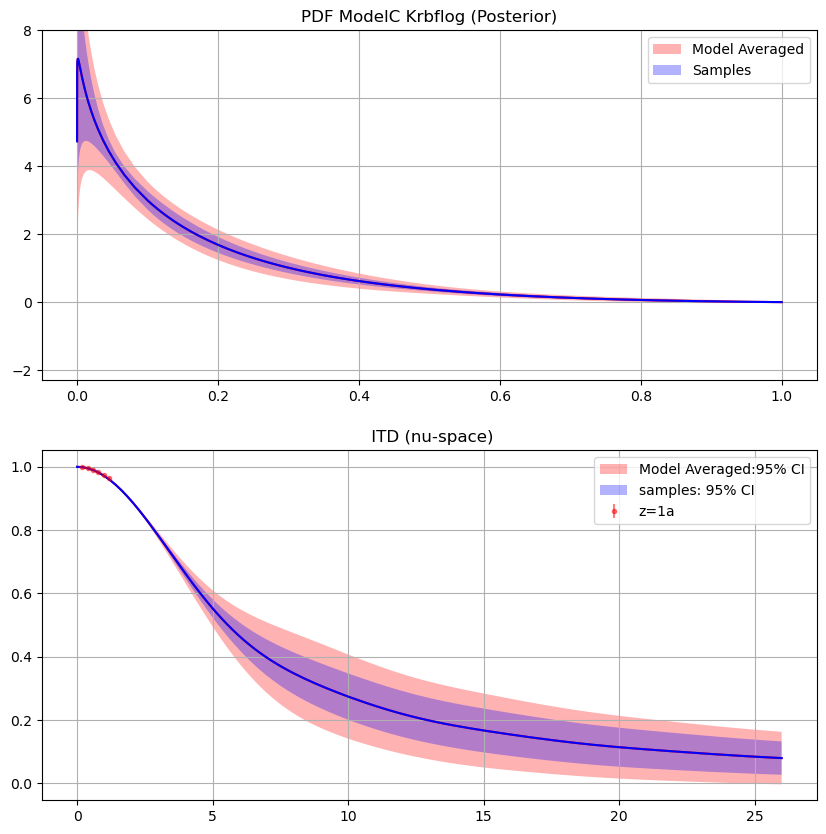

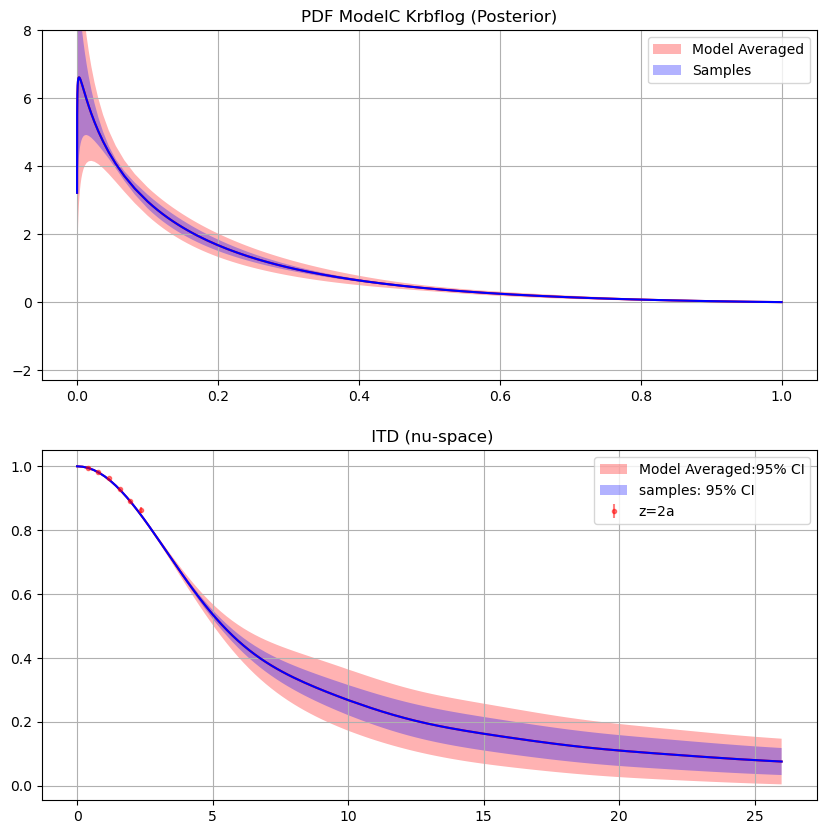

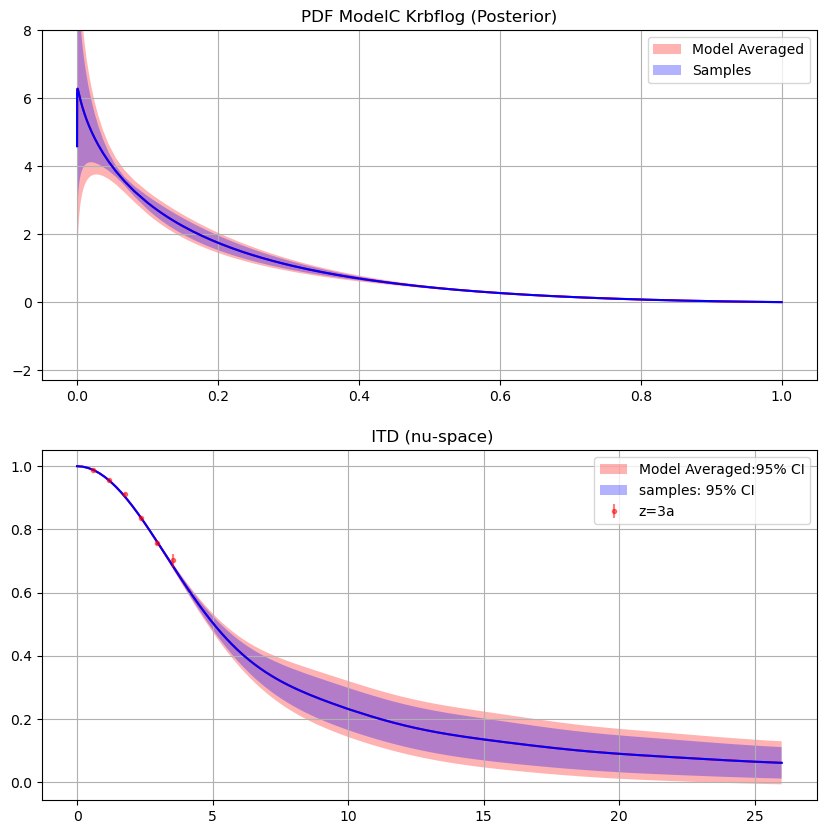

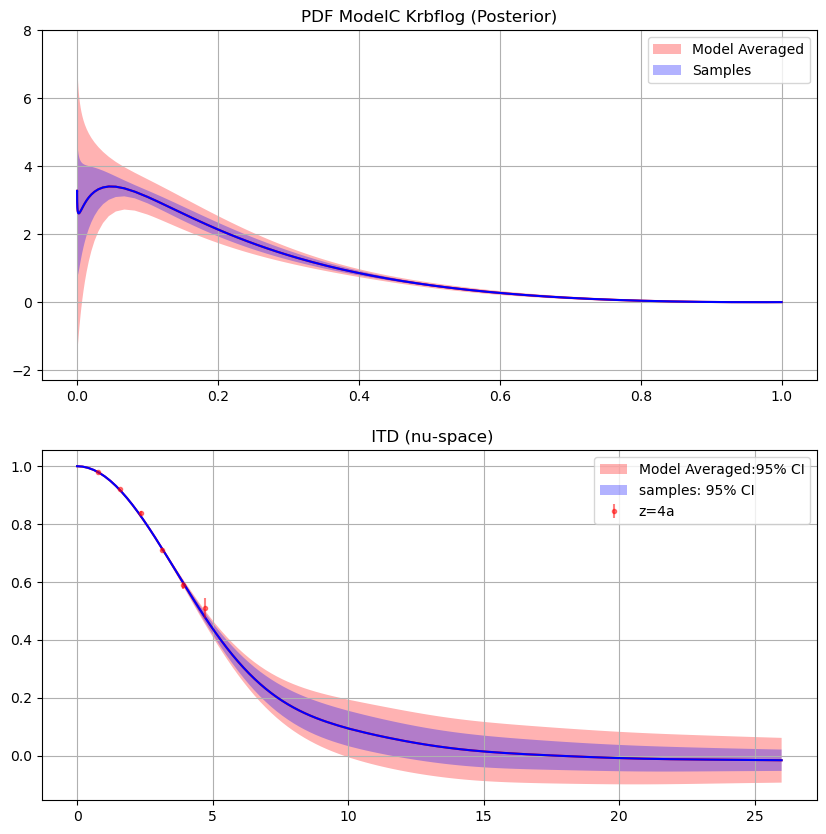

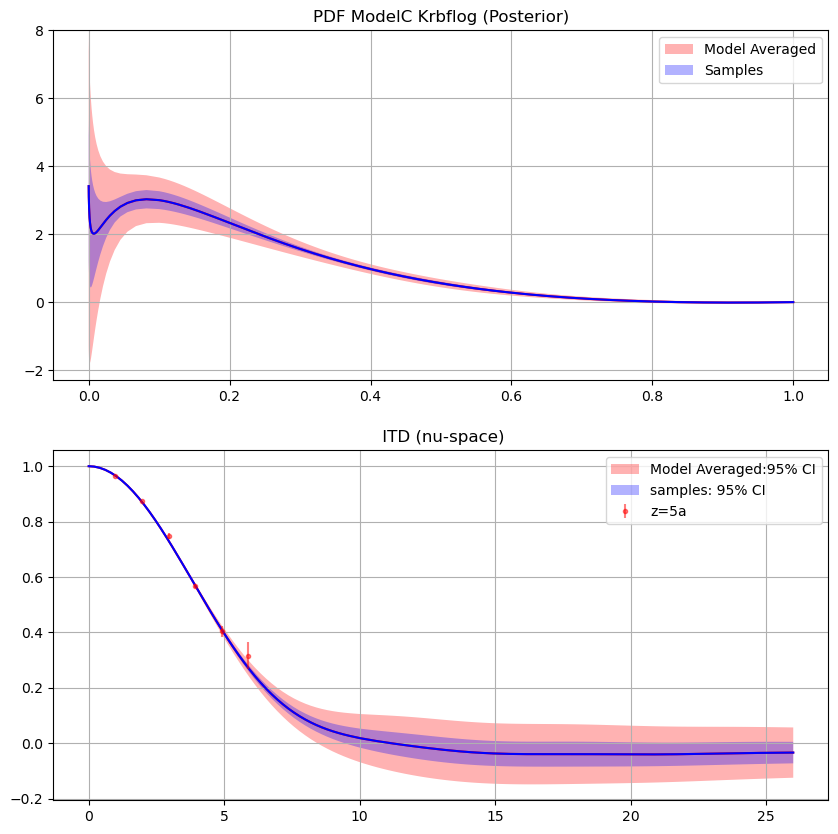

...

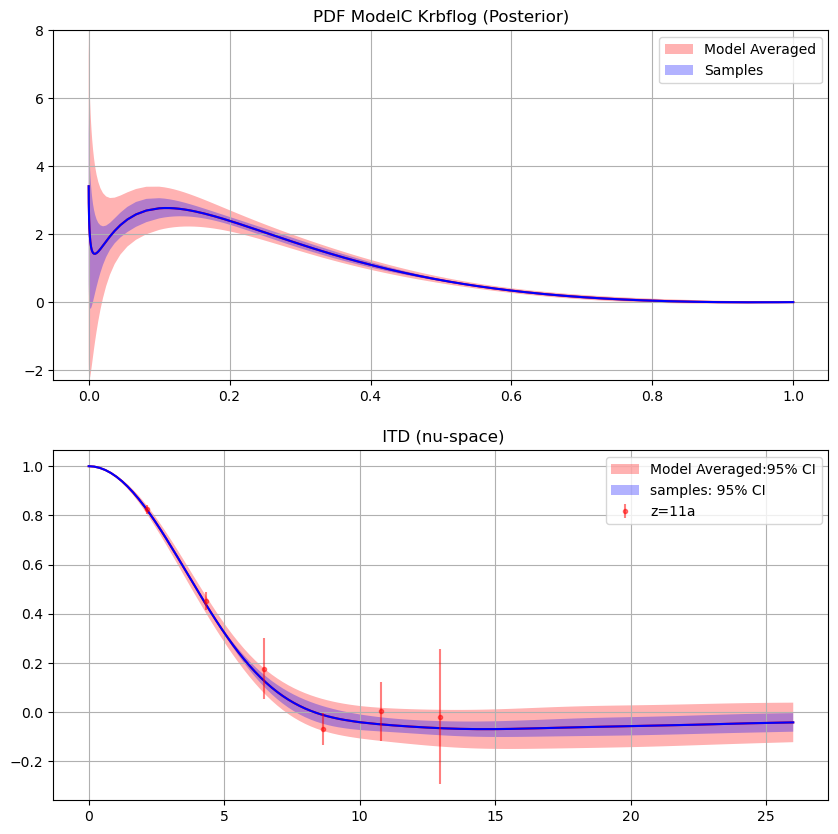

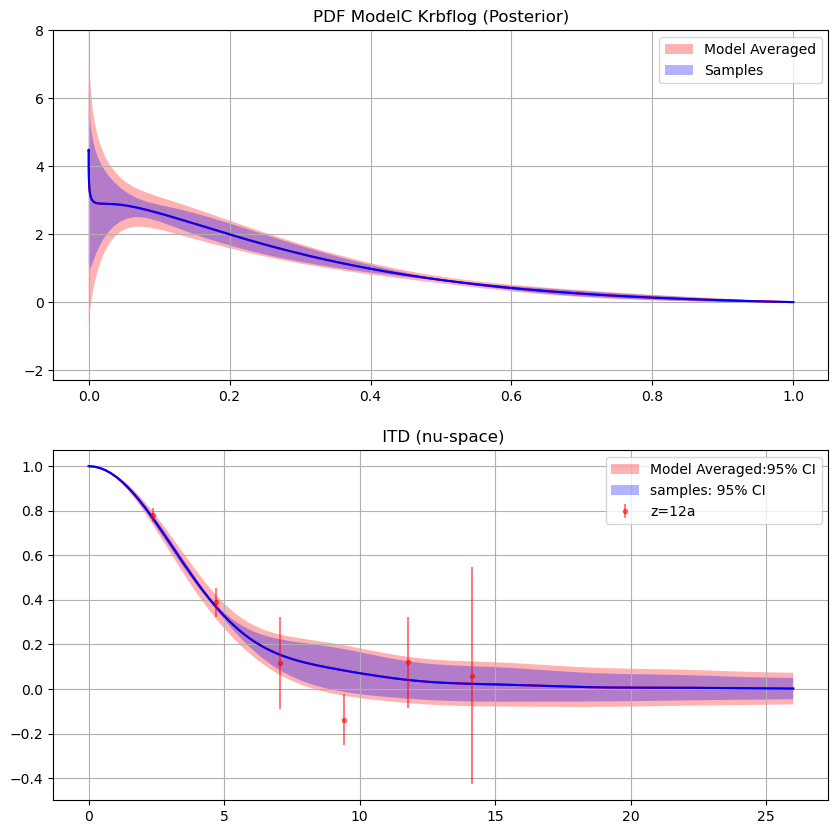

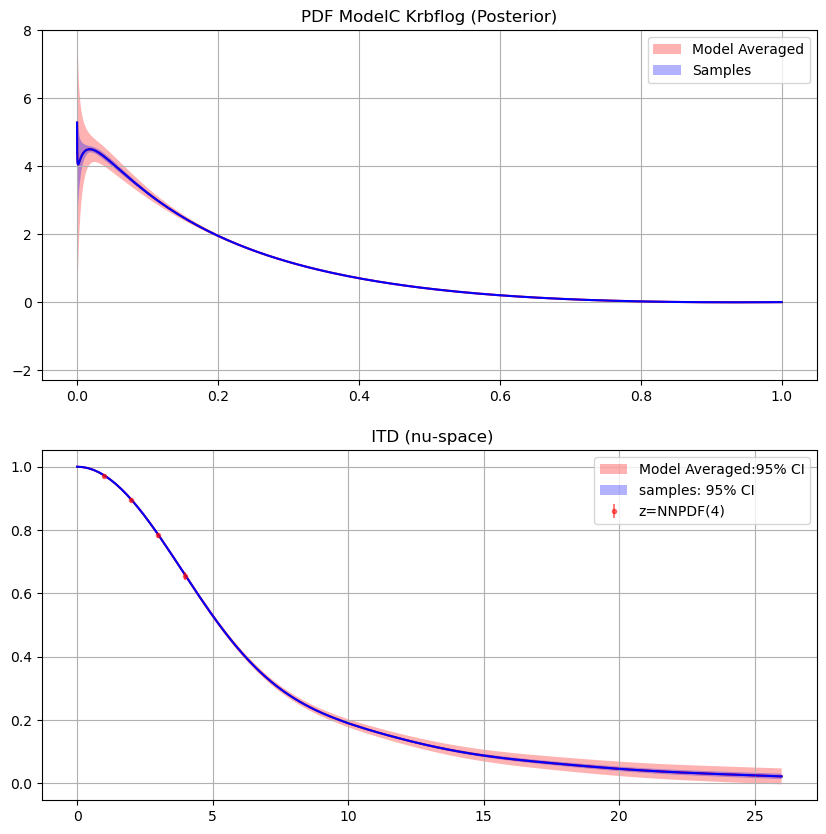

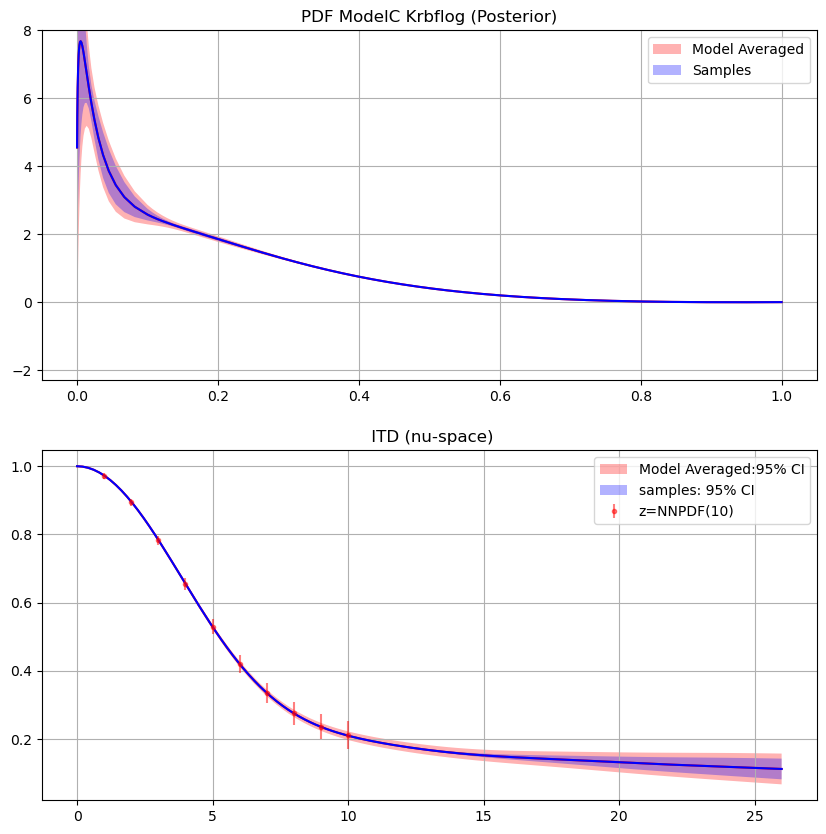

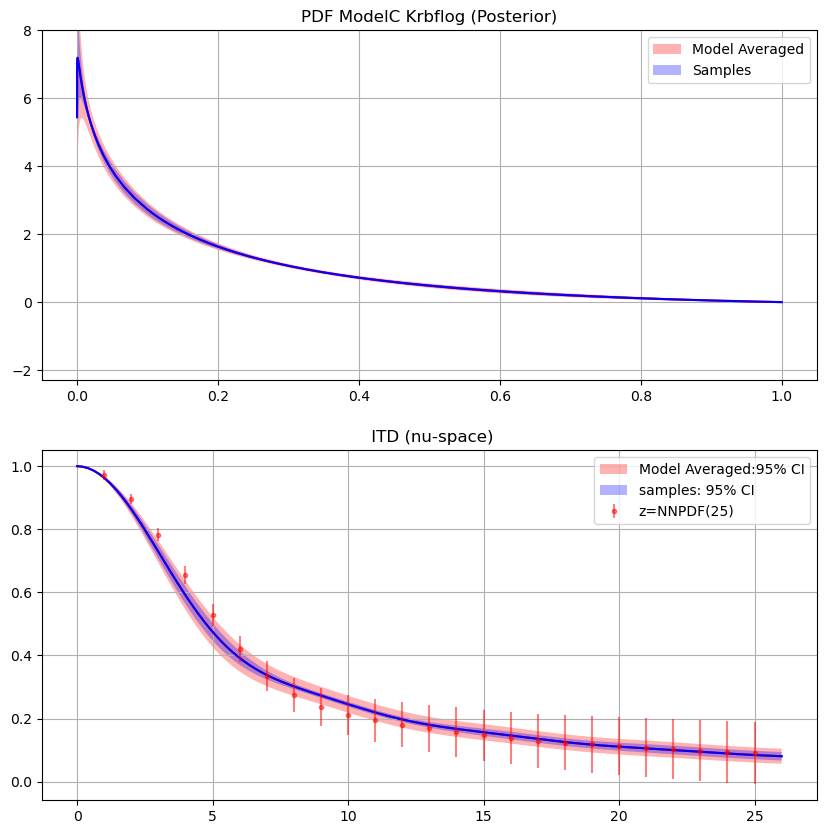

In [8]:
#plot Qnu[0]
def plot_individual_pdf(fits_comb,samplesqx,samplesQv,qofxs,Qofvs,covs,covsnu,number,modelname,kernelname,ITD,test,iB,fCI=1.00):
    Qnu=[]
    nu,rMj,rMe,rM = get_data(ITD)
    for i in range(0,number):
        ttQ = samplesqx[i]@iB.T
        Qnu.append(ttQ)
        #print("ITD",fits_comb[i].name,"done")
    for i in range(0,number):
        fig, ax= plt.subplots(2,figsize=(10, 10))
        ax[0].set_title(f'PDF {modelname} {kernelname} (Posterior)')
        ax[1].set_title(" ITD (nu-space)")

        col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
        meanx=samplesqx[i].mean(axis=0)
        qofx=qofxs[i]
        qsig=fCI*np.diag(np.cov(samplesqx[i].T))**(0.5)
        qerror=fCI*np.diag(tr.abs(covs[i]))**(0.5)
        ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='red', alpha=0.3,label='Model Averaged')
        ax[0].fill_between(x_gri0, meanx - qsig,  meanx+ qsig, facecolor='blue', alpha=0.3,label='Samples')
        ax[0].legend()
        ax[0].grid()

        #for j in range(len(samplesqx[i])):
        #    ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.03)
        #ax[0].plot(x_gri0,qofx,label=fits_comb[i].name,color='blue')
        ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name,color='red')
        ax[0].plot(x_gri0,meanx,color='blue')

        ax[0].set_ylim([-2.3,8])

        #plot ttQ with the mean
        #mttQ = Qnu[i].mean(axis=0)
        mttQ=Qofvs[i]
        meanv=samplesQv[i].mean(axis=0)
        Qsig=fCI* np.diag(np.cov(samplesQv[i].T))**0.5
        Qerror=fCI*np.diag(tr.abs(covsnu[i]))**0.5
        #ax[1].plot(nn,Qnu[i].T,color=col[i],alpha=0.05)
        #Qsig=np.diag(covQ)**(0.5)
        ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor="red", alpha=0.3,label='Model Averaged:95% CI')
        ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor="blue", alpha=0.3,label='samples: 95% CI')
        ax[1].plot(nn,mttQ,color='red')
        ax[1].plot(nn,meanv,color='blue')
        if i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            nu_d_grid = datanu.T[1]
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
            plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        elif i<12:
            plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        plt.legend()
        plt.grid()
        plt.show()

plot_individual_pdf(ModelC_Krbflog_Re,MC_Krbflog_Re_samplesqx,MC_Krbflog_Re_samplesQv,MC_Krbflog_Re_qofxs,MC_Krbflog_Re_Qofvs,MC_Krbflog_Re_covs,MC_Krbflog_Re_covsnu,number,"ModelC","Krbflog","Re","NNPDF",iB_Re)

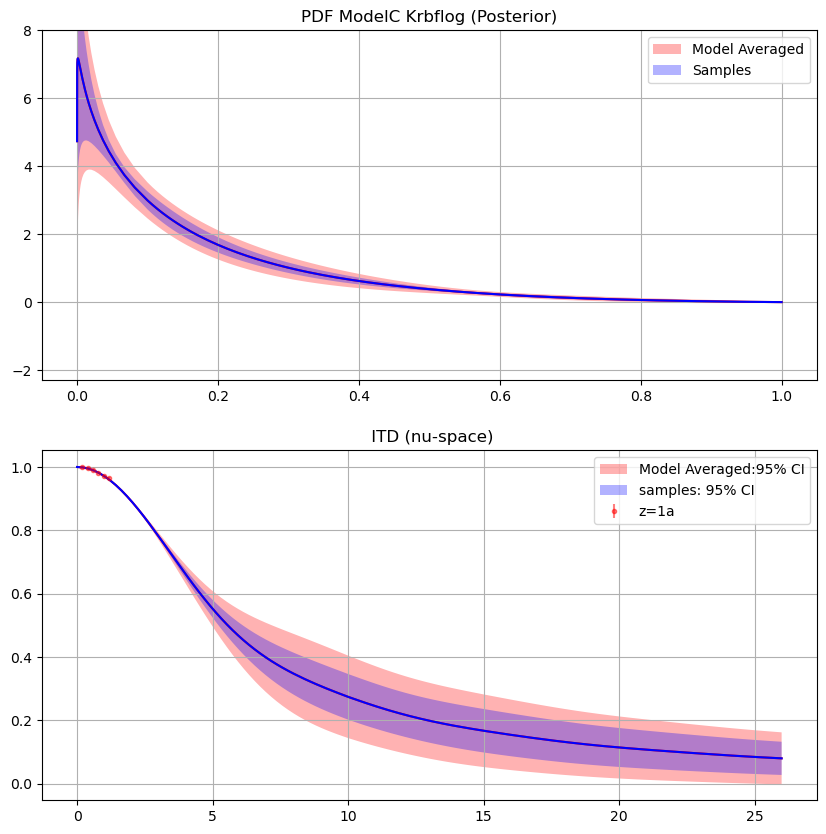

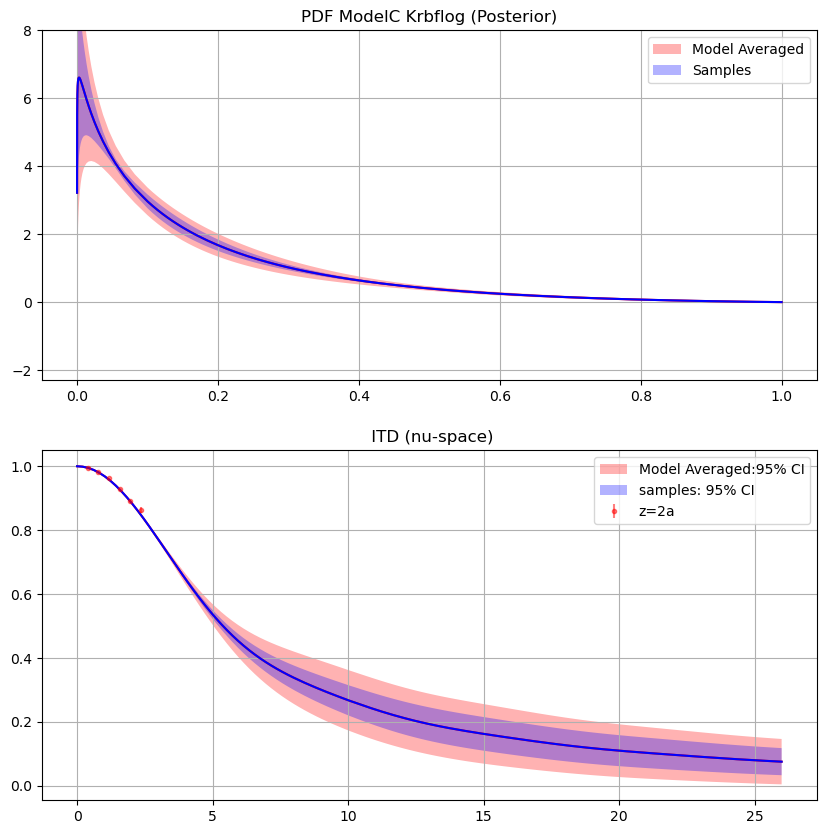

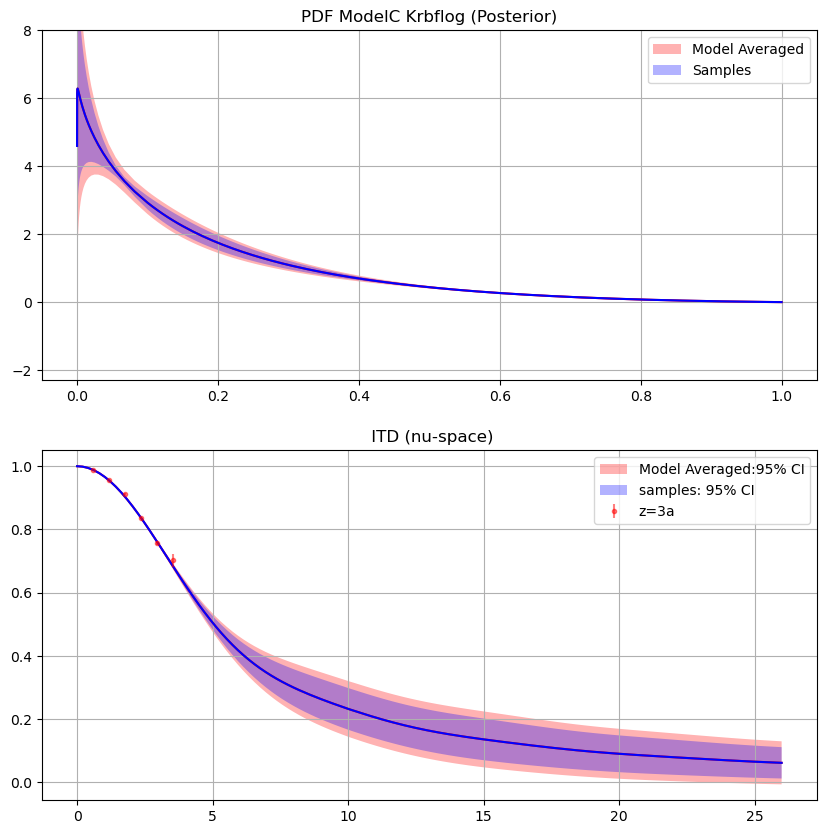

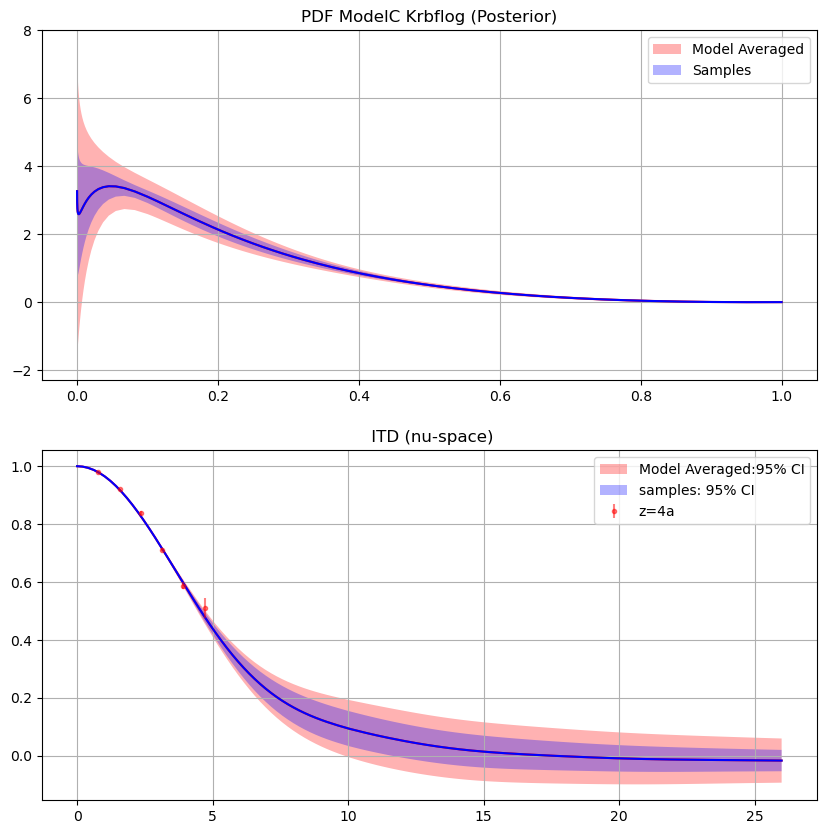

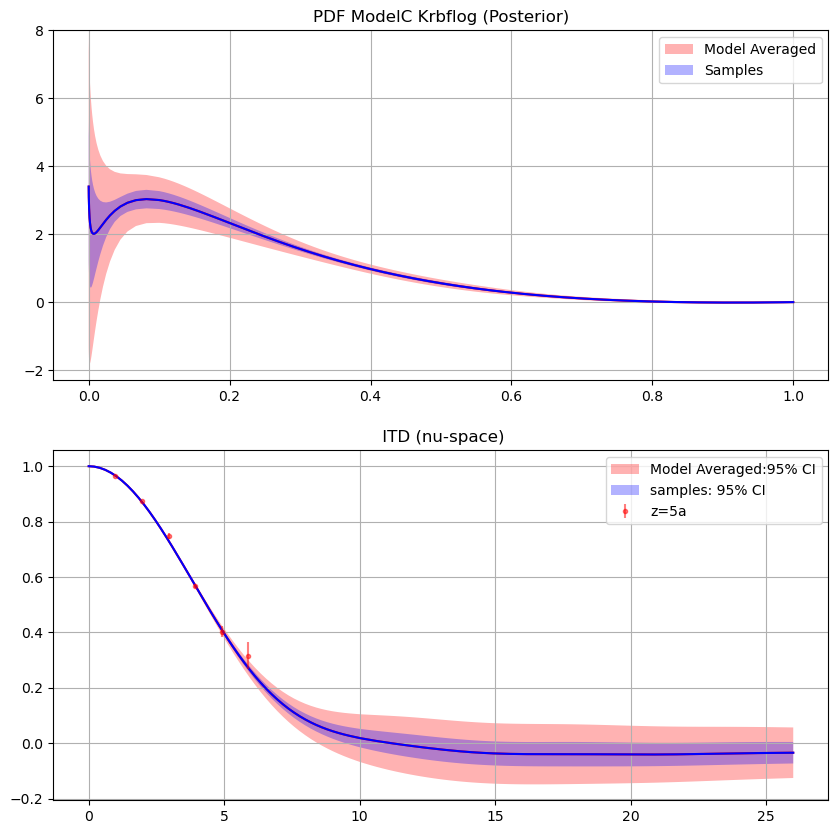

...

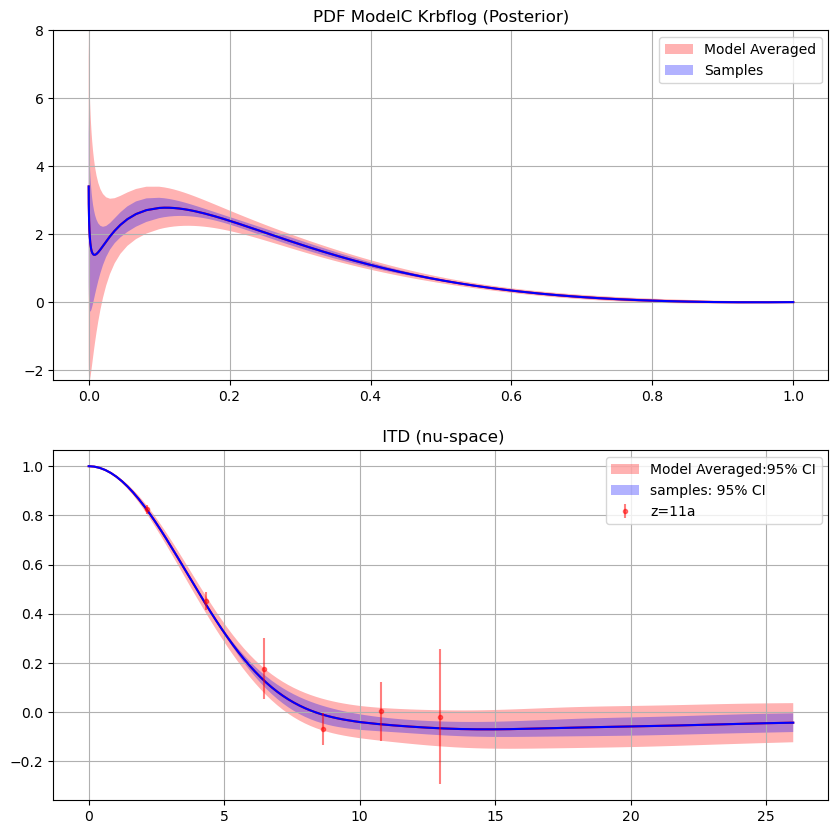

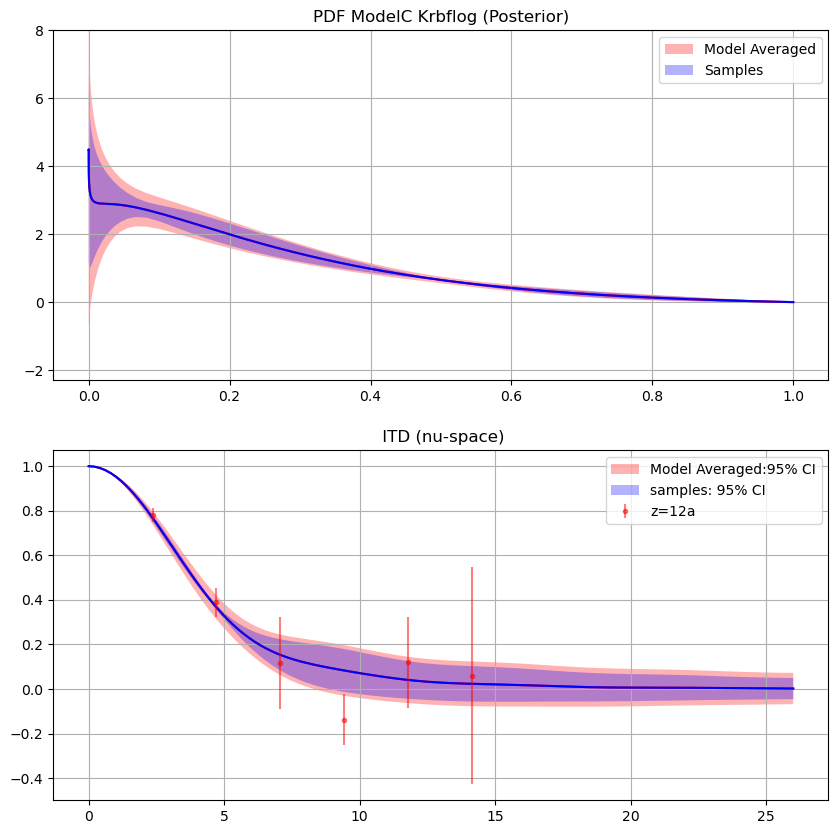

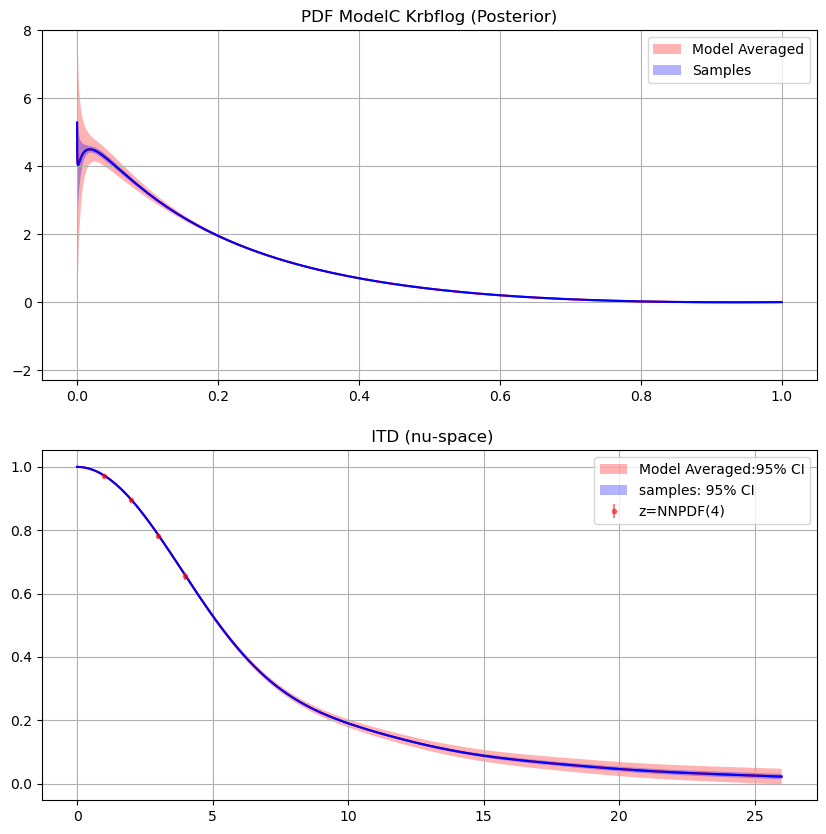

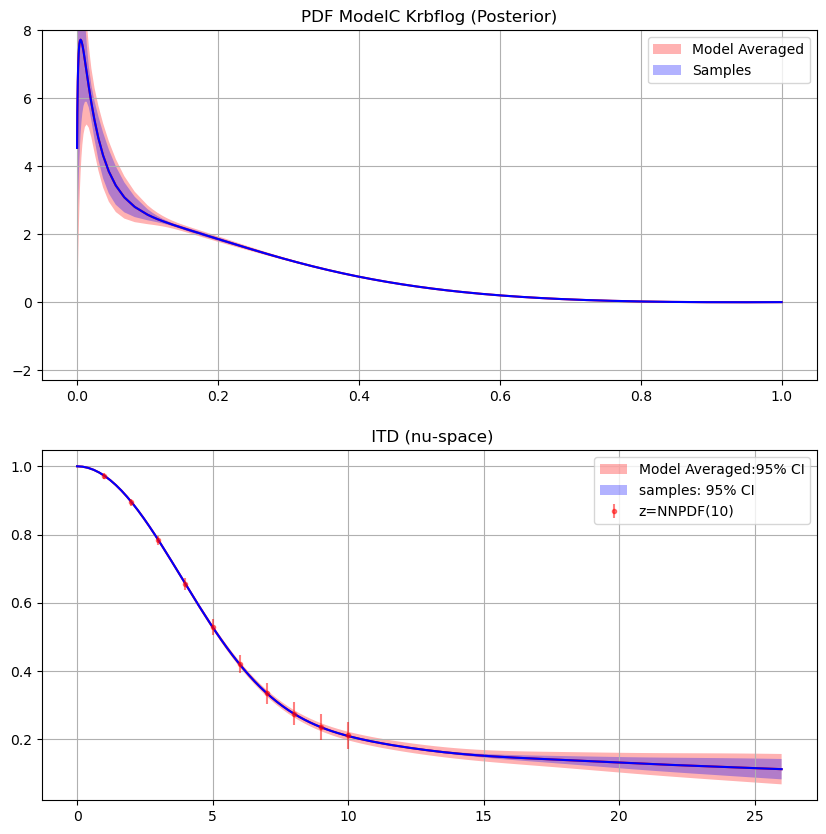

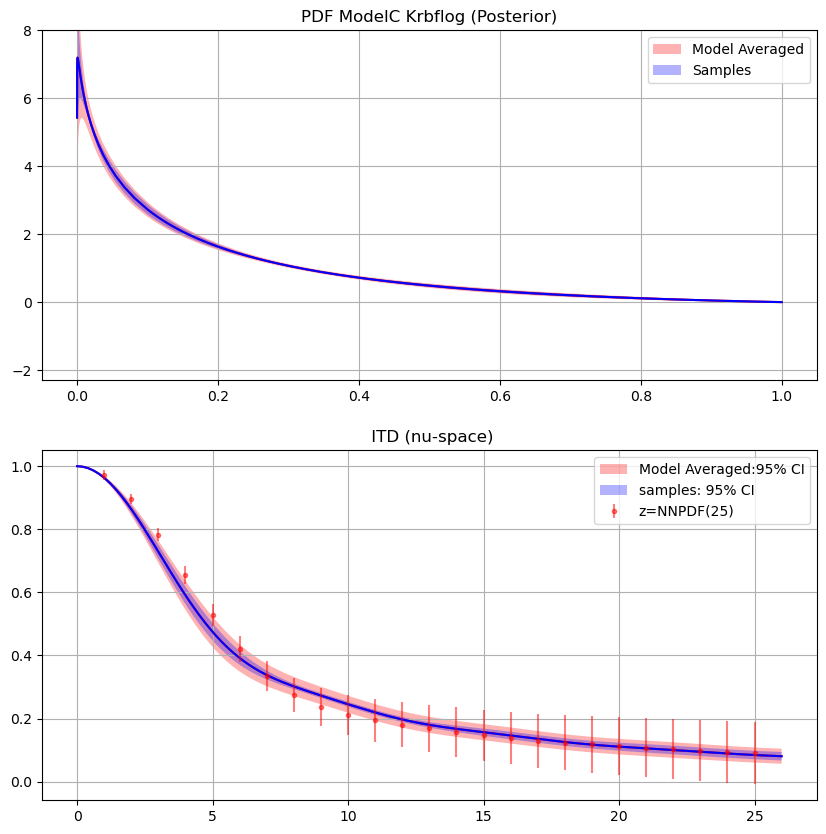

In [8]:
#plot Qnu[0]
def plot_individual_pdf(fits_comb,samplesqx,samplesQv,qofxs,Qofvs,covs,covsnu,number,modelname,kernelname,ITD,test,iB,fCI=1.00):
    Qnu=[]
    nu,rMj,rMe,rM = get_data(ITD)
    for i in range(0,number):
        ttQ = samplesqx[i]@iB.T
        Qnu.append(ttQ)
        #print("ITD",fits_comb[i].name,"done")
    for i in range(0,number):
        fig, ax= plt.subplots(2,figsize=(10, 10))
        ax[0].set_title(f'PDF {modelname} {kernelname} (Posterior)')
        ax[1].set_title(" ITD (nu-space)")

        col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
        meanx=samplesqx[i].mean(axis=0)
        qofx=qofxs[i]
        qsig=fCI*np.diag(np.cov(samplesqx[i].T))**(0.5)
        qerror=fCI*np.diag(tr.abs(covs[i]))**(0.5)
        ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='red', alpha=0.3,label='Model Averaged')
        ax[0].fill_between(x_gri0, meanx - qsig,  meanx+ qsig, facecolor='blue', alpha=0.3,label='Samples')
        ax[0].legend()
        ax[0].grid()

        #for j in range(len(samplesqx[i])):
        #    ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.03)
        #ax[0].plot(x_gri0,qofx,label=fits_comb[i].name,color='blue')
        ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name,color='red')
        ax[0].plot(x_gri0,meanx,color='blue')

        ax[0].set_ylim([-2.3,8])

        #plot ttQ with the mean
        #mttQ = Qnu[i].mean(axis=0)
        mttQ=Qofvs[i]
        meanv=samplesQv[i].mean(axis=0)
        Qsig=fCI* np.diag(np.cov(samplesQv[i].T))**0.5
        Qerror=fCI*np.diag(tr.abs(covsnu[i]))**0.5
        #ax[1].plot(nn,Qnu[i].T,color=col[i],alpha=0.05)
        #Qsig=np.diag(covQ)**(0.5)
        ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor="red", alpha=0.3,label='Model Averaged:95% CI')
        ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor="blue", alpha=0.3,label='samples: 95% CI')
        ax[1].plot(nn,mttQ,color='red')
        ax[1].plot(nn,meanv,color='blue')
        if i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            nu_d_grid = datanu.T[1]
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
            plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        elif i<12:
            plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        plt.legend()
        plt.grid()
        plt.show()

plot_individual_pdf(ModelC_Krbflog_Re,MC_Krbflog_Re_samplesqx,MC_Krbflog_Re_samplesQv,MC_Krbflog_Re_qofxs,MC_Krbflog_Re_Qofvs,MC_Krbflog_Re_covs,MC_Krbflog_Re_covsnu,number,"ModelC","Krbflog","Re","NNPDF",iB_Re)

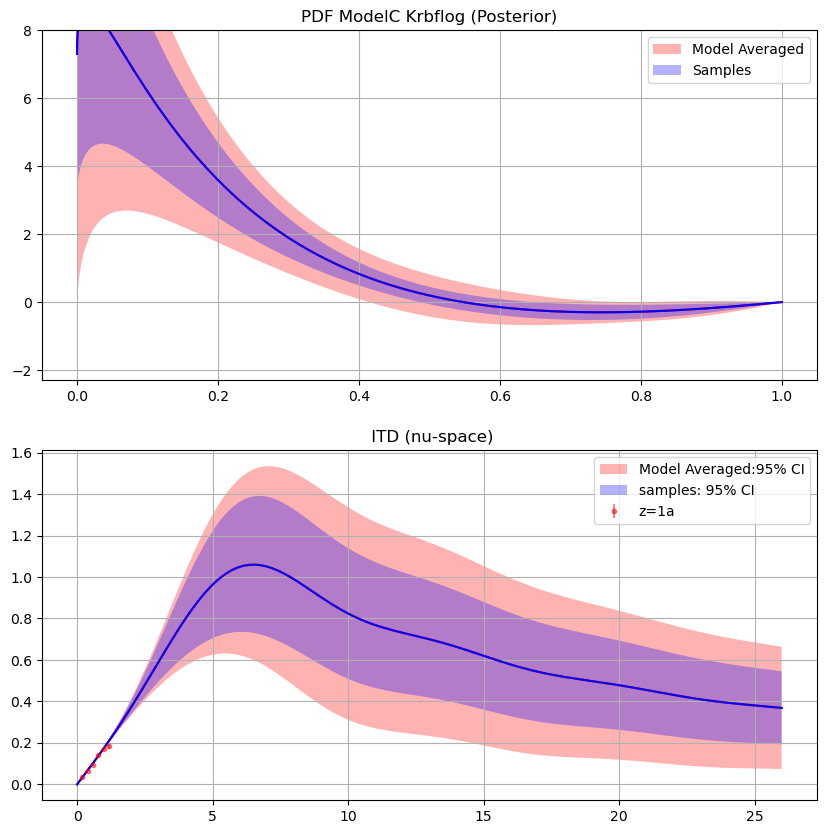

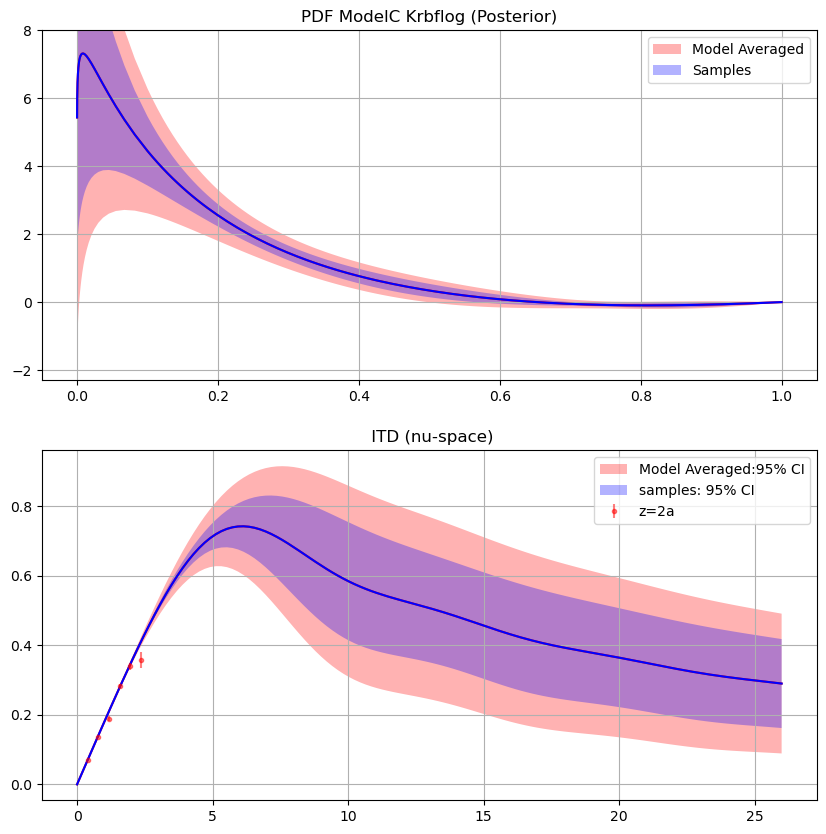

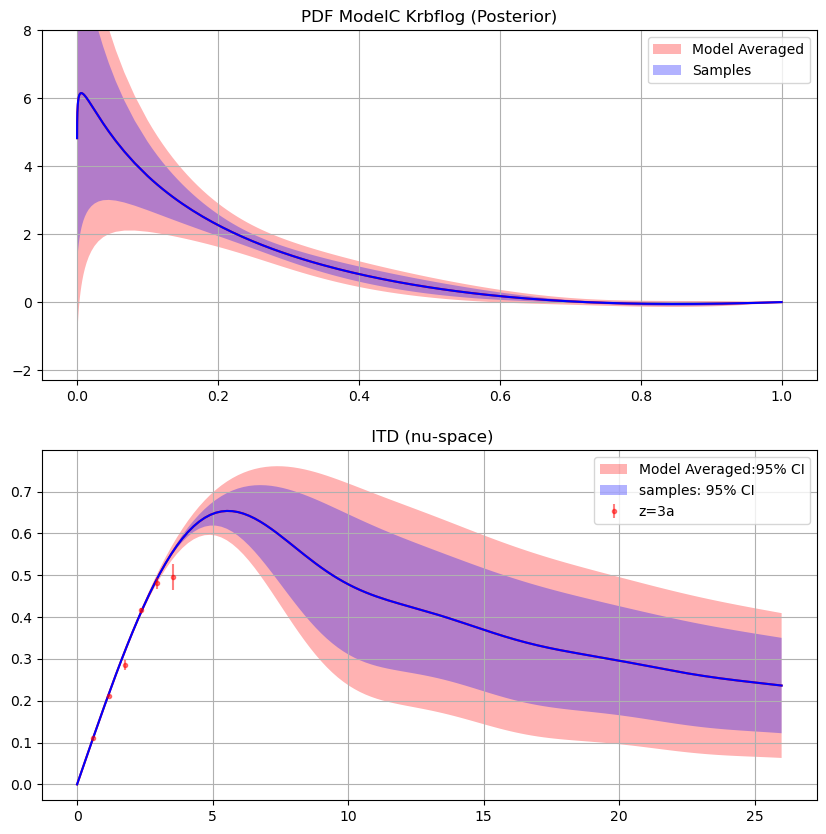

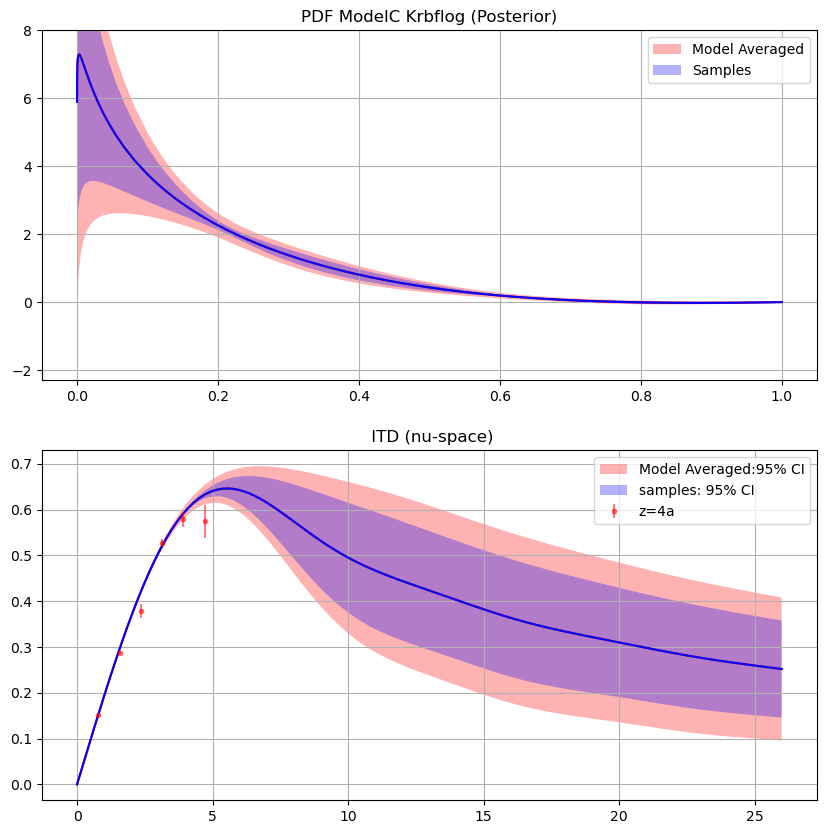

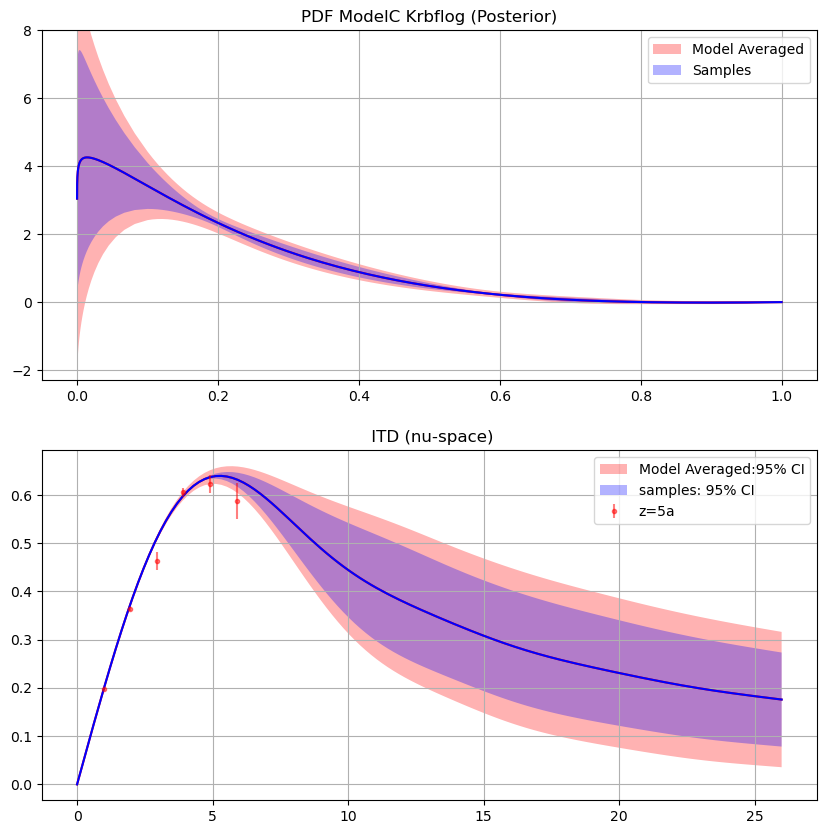

...

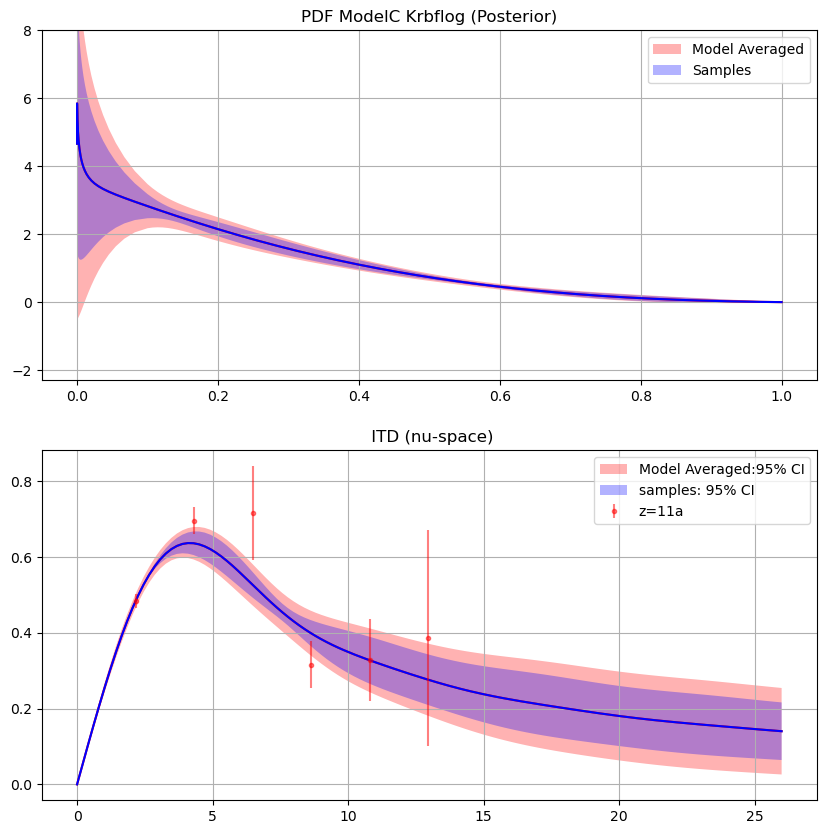

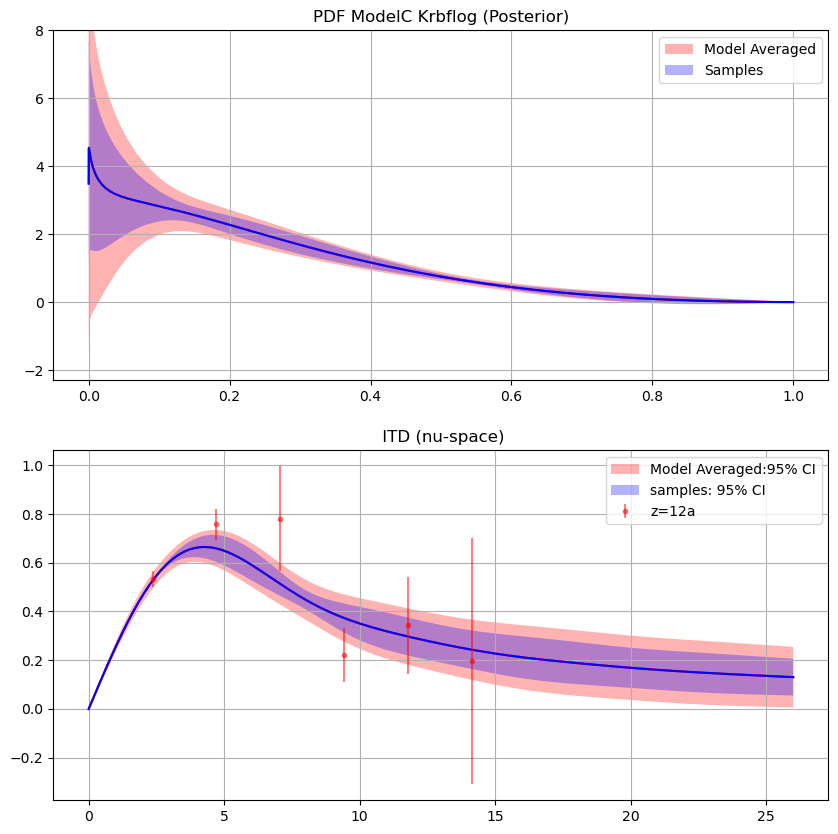

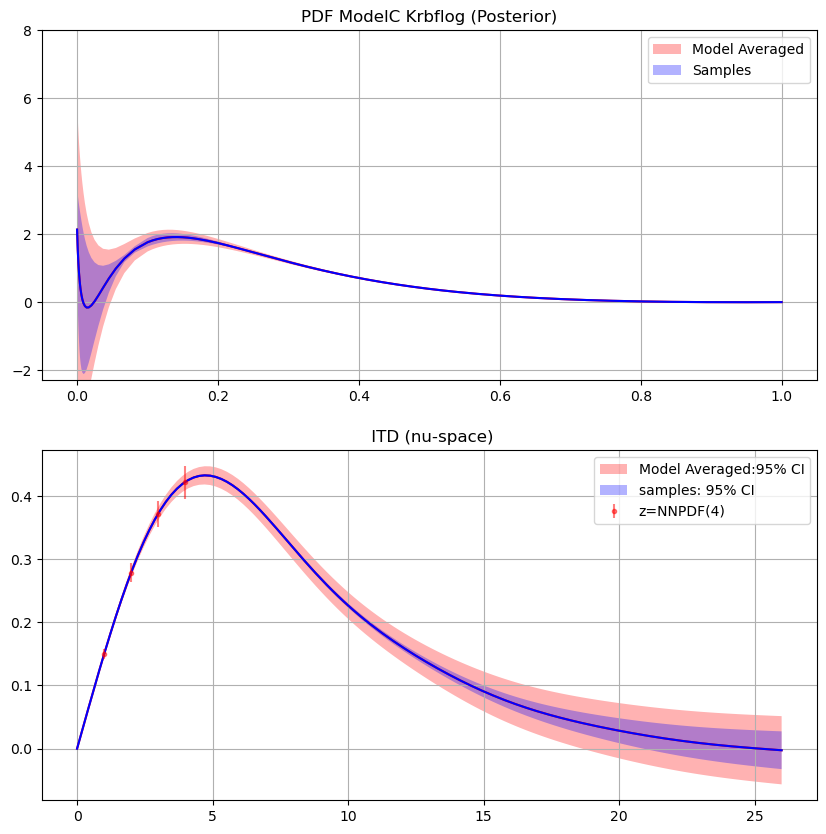

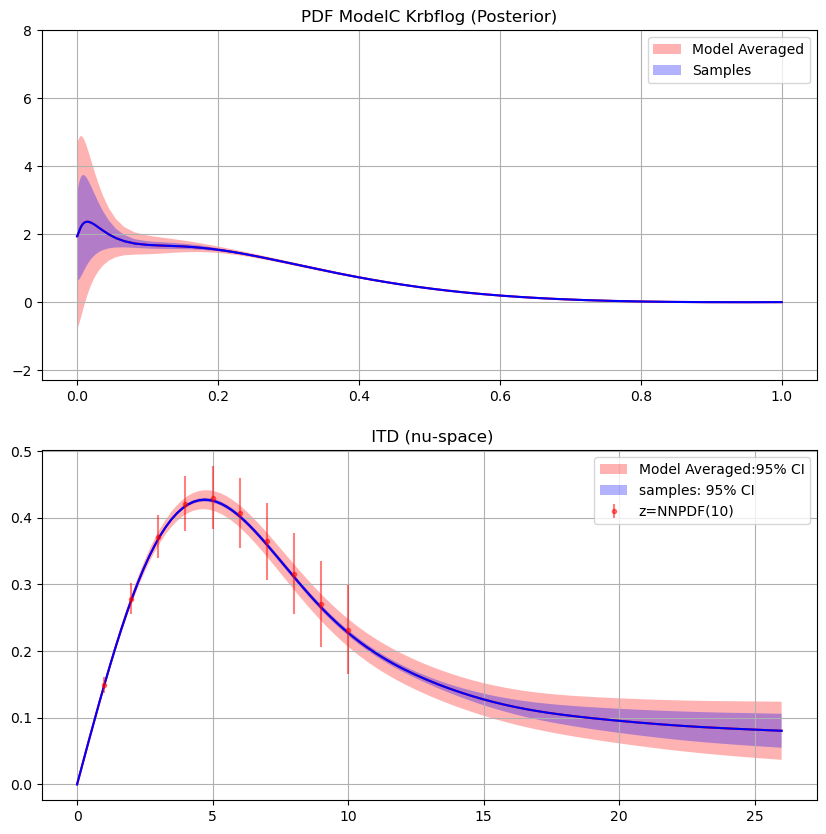

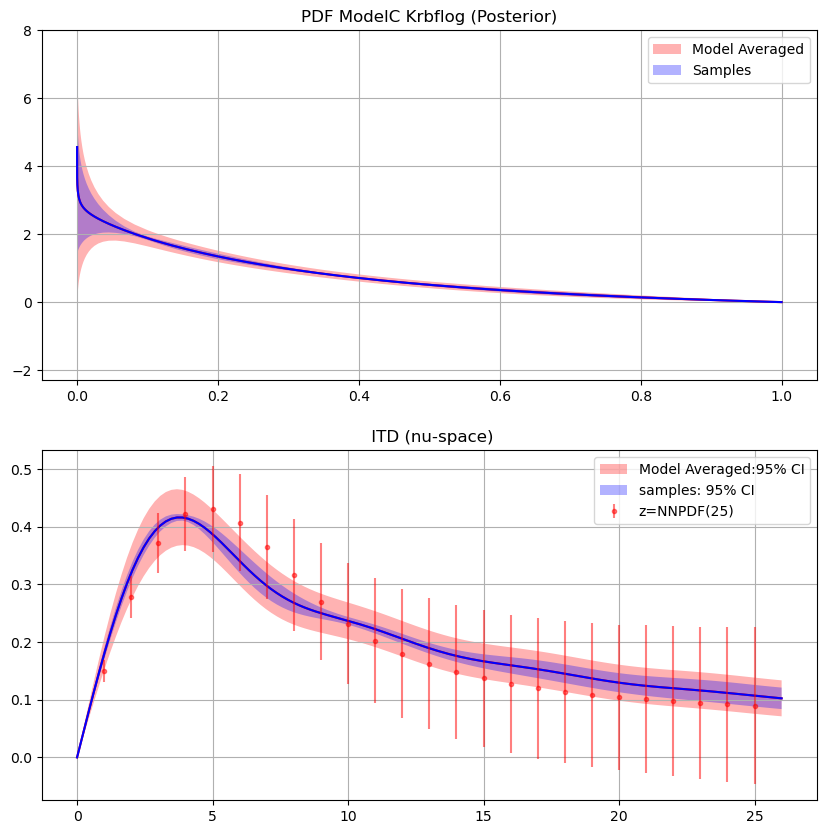

In [27]:
plot_individual_pdf(ModelC_Krbflog_Im,MC_Krbflog_Im_samplesqx,MC_Krbflog_Im_samplesQv,MC_Krbflog_Im_qofxs,MC_Krbflog_Im_Qofvs,MC_Krbflog_Im_covs,MC_Krbflog_Im_covsnu,number,"ModelC","Krbflog","Im","NNPDF",iB_Im)

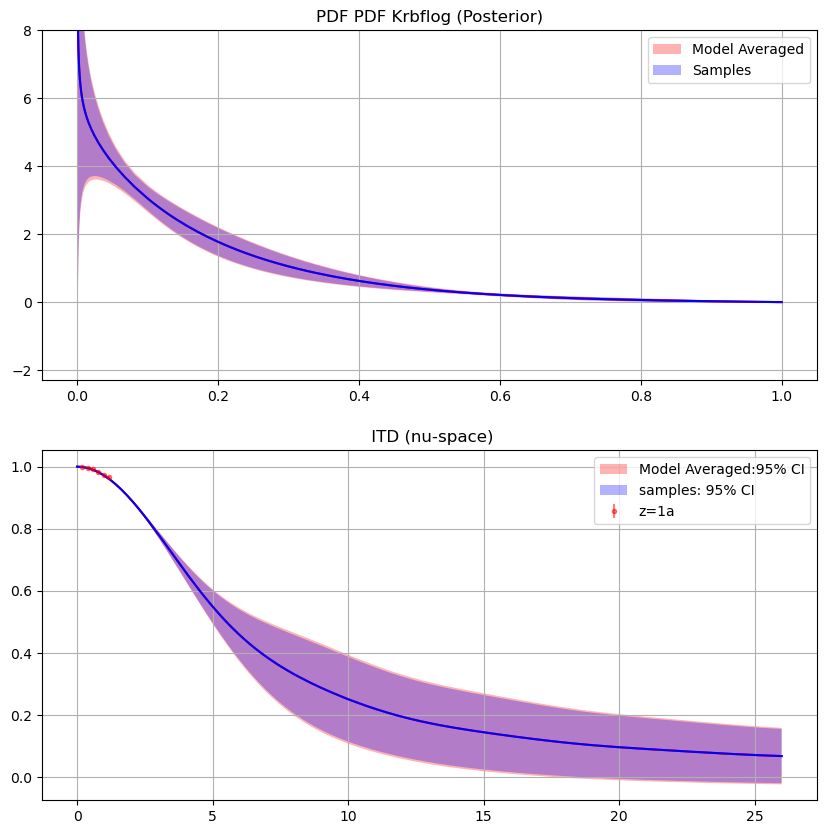

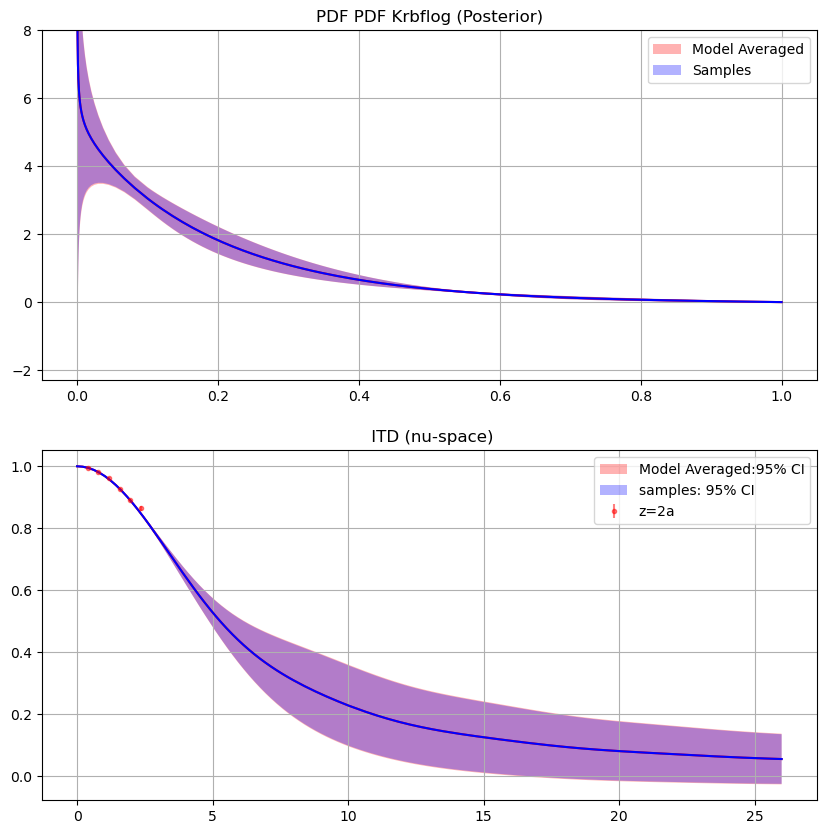

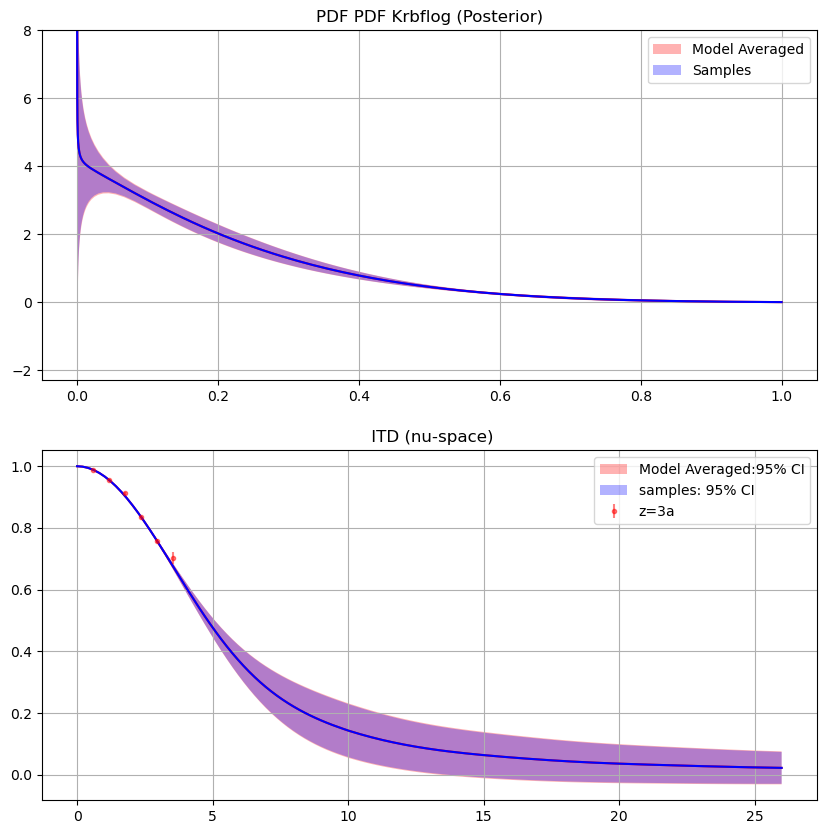

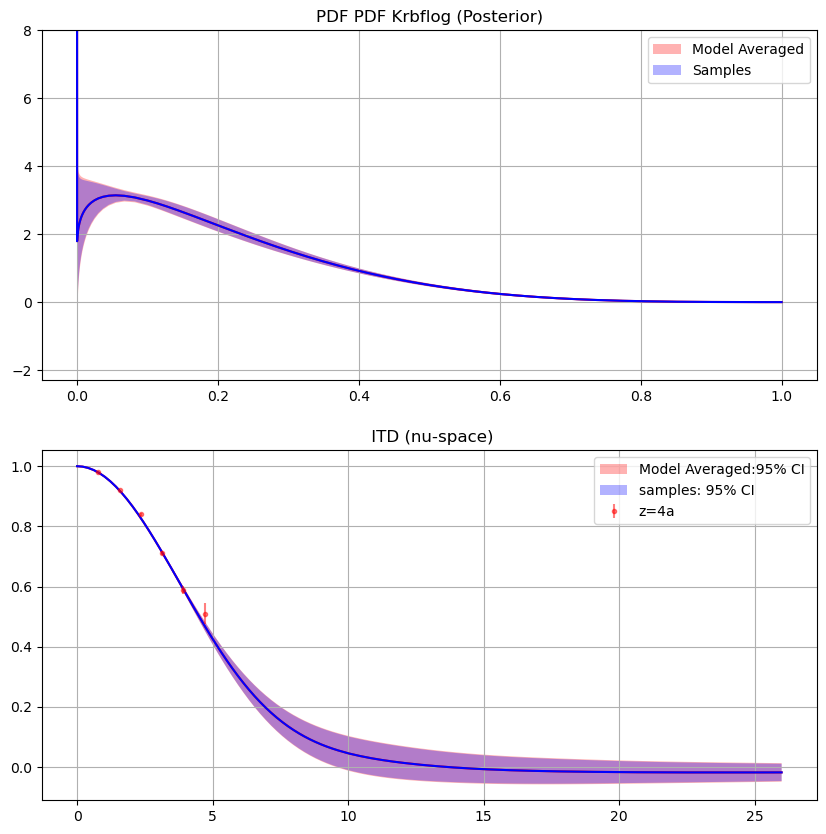

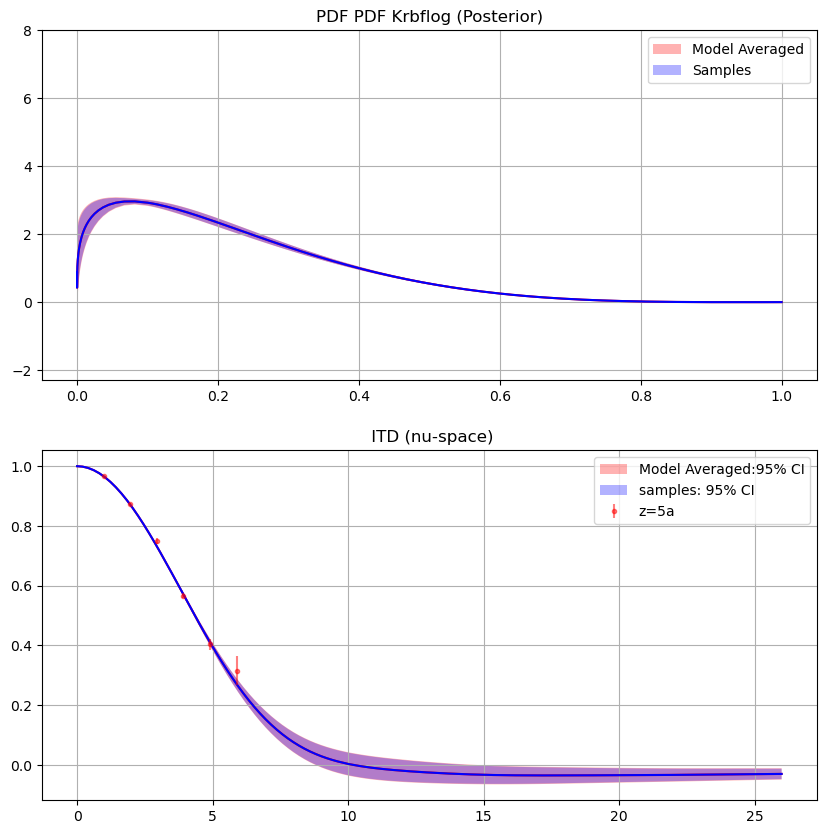

...

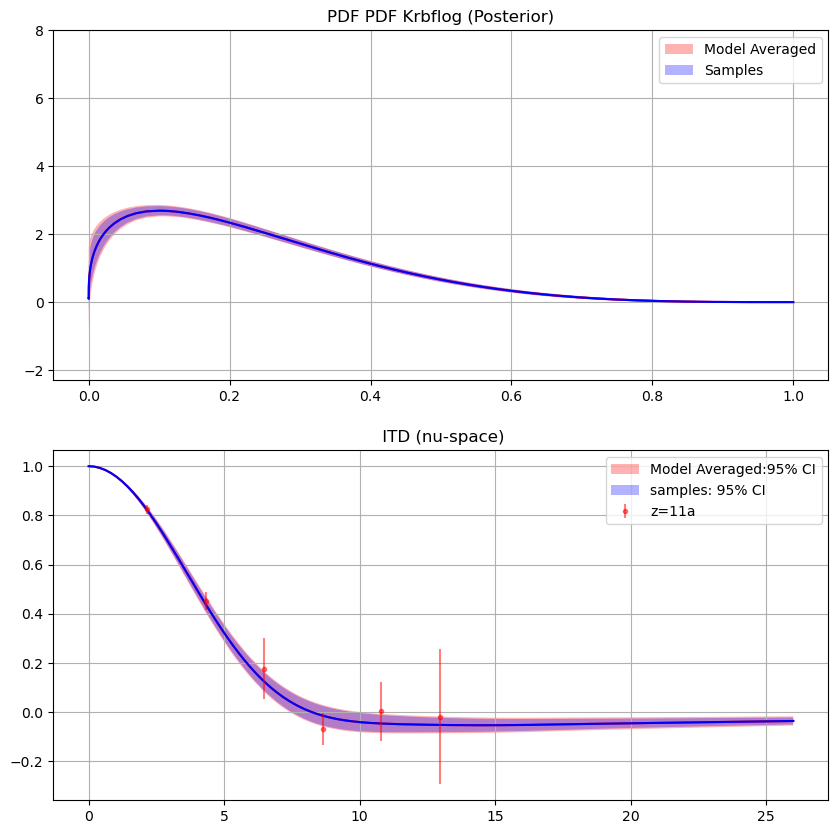

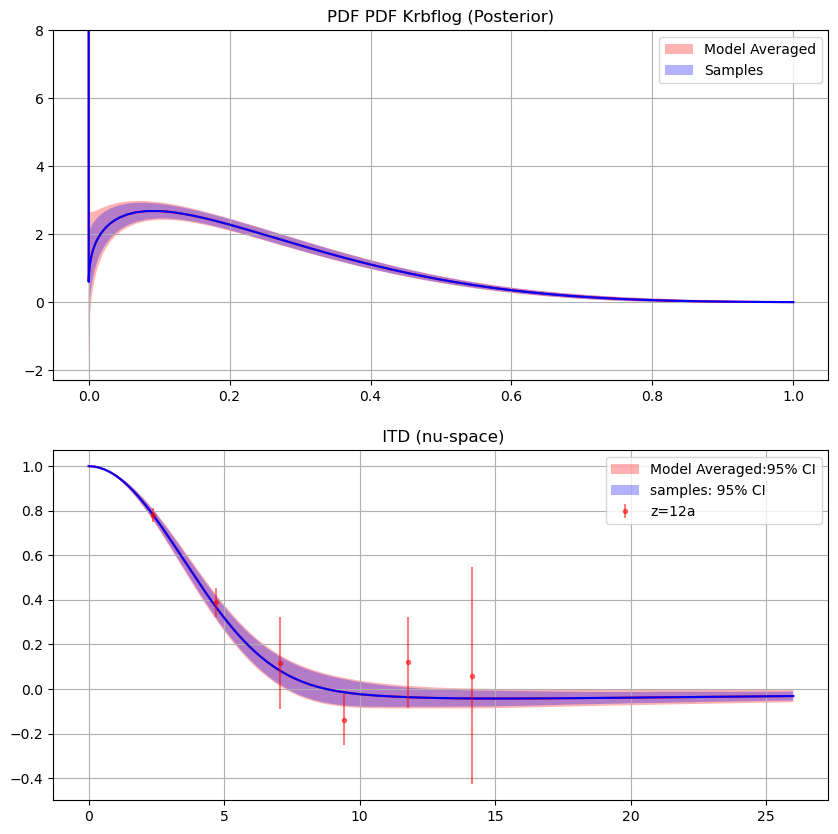

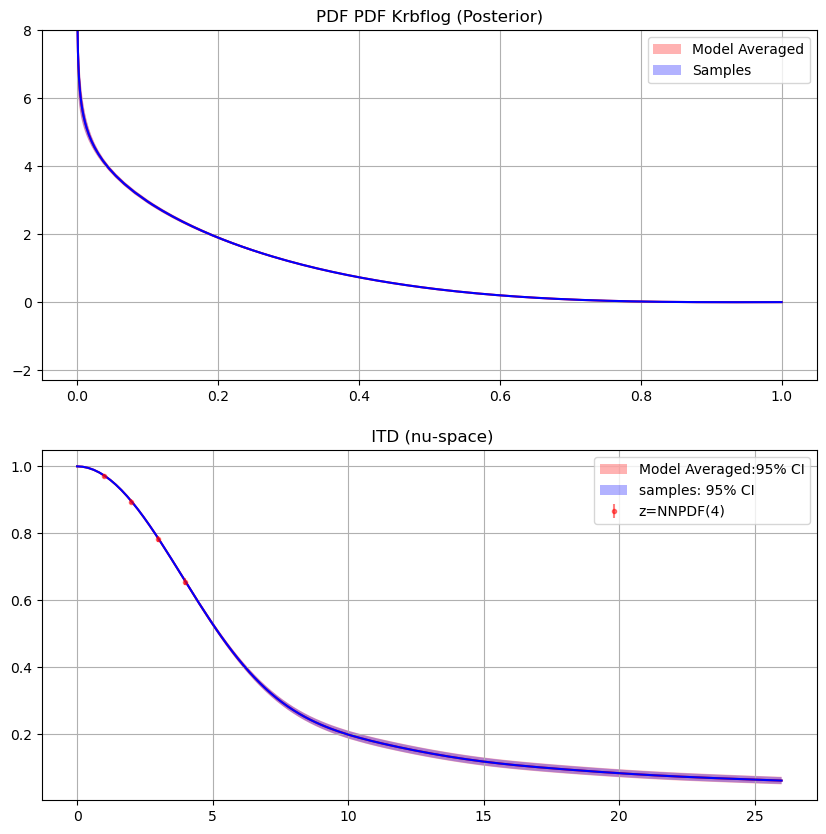

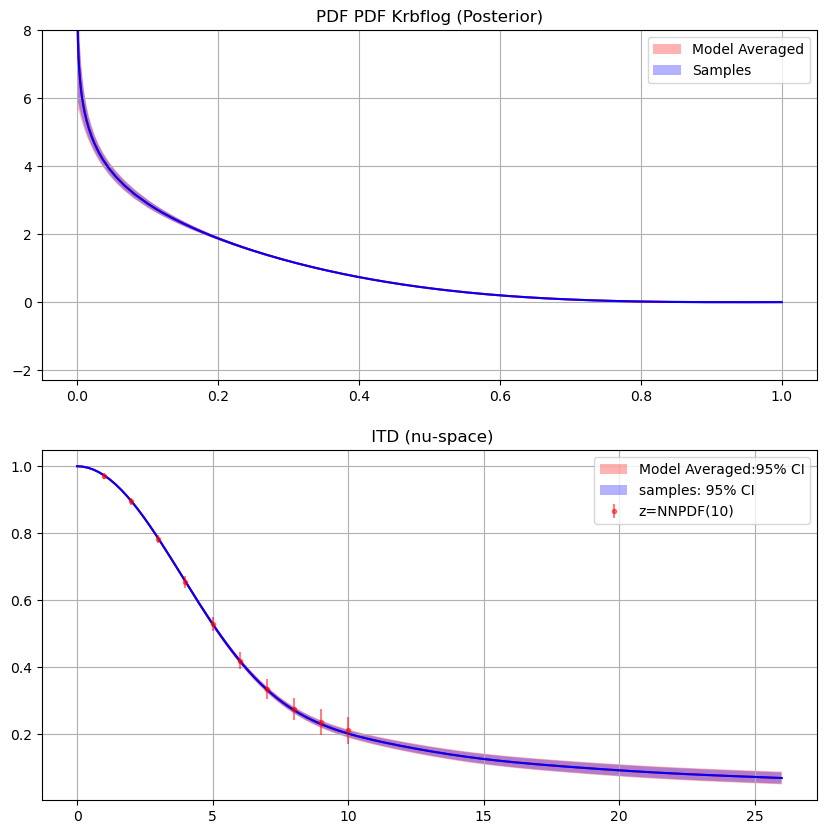

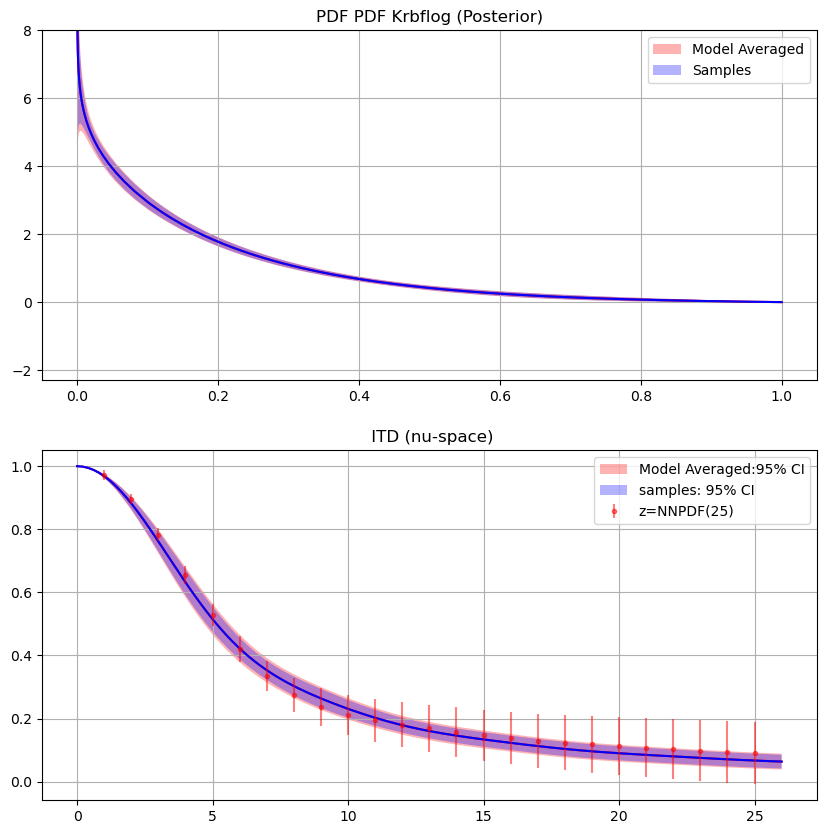

In [10]:
plot_individual_pdf(PDF_Krbflog_Re,PDF_Krbflog_Re_samplesqx,PDF_Krbflog_Re_samplesQv,PDF_Krbflog_Re_qofxs,PDF_Krbflog_Re_Qofvs,PDF_Krbflog_Re_covs,PDF_Krbflog_Re_covsnu,number,"PDF","Krbflog","Re","NNPDF",iB_Re)

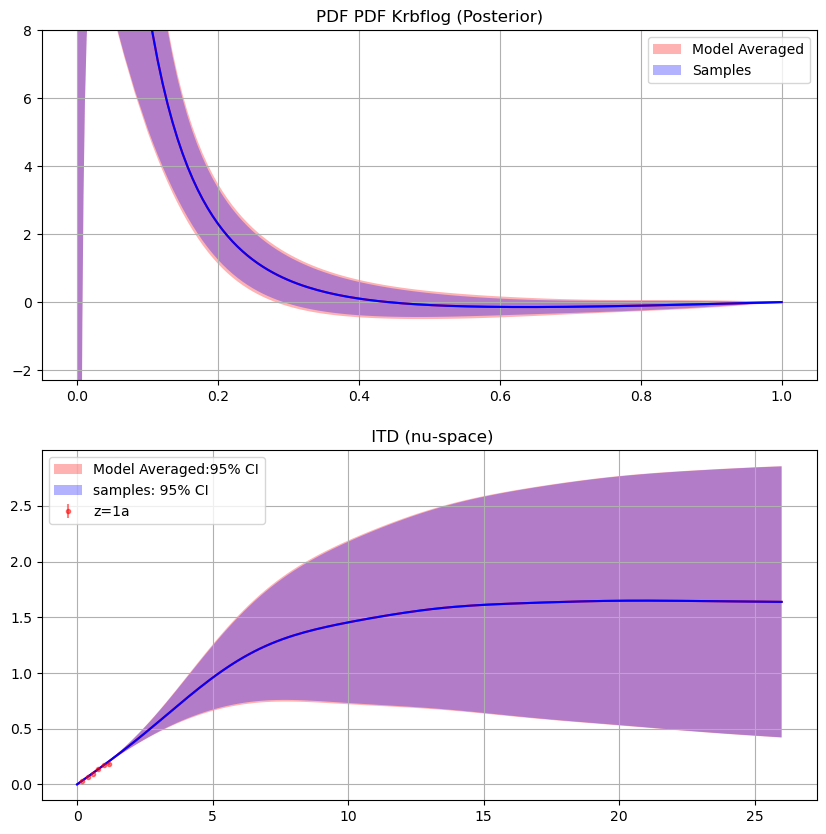

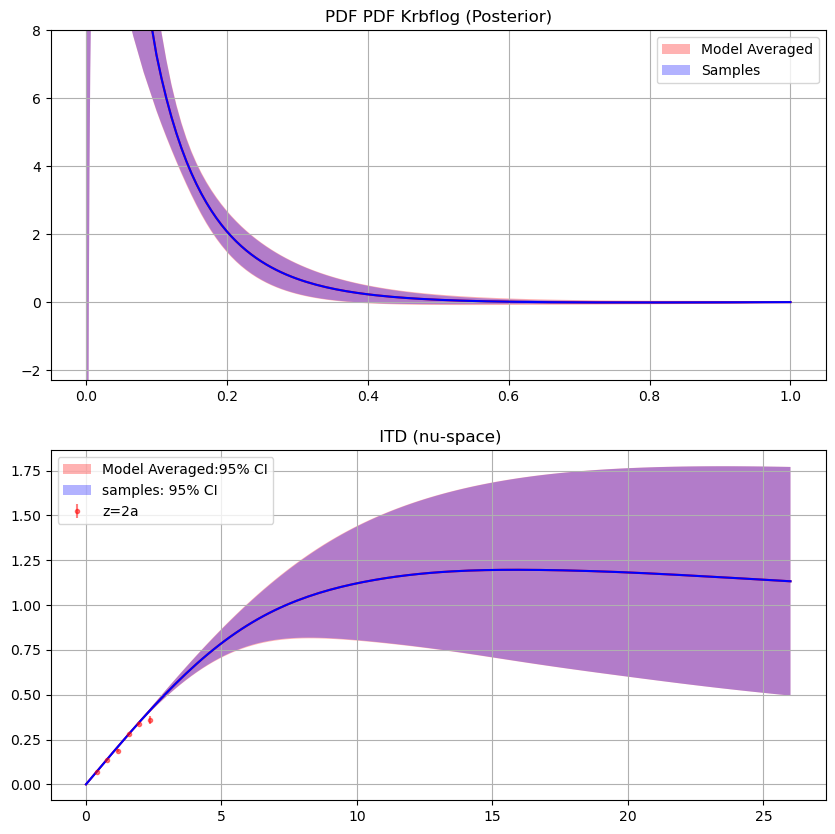

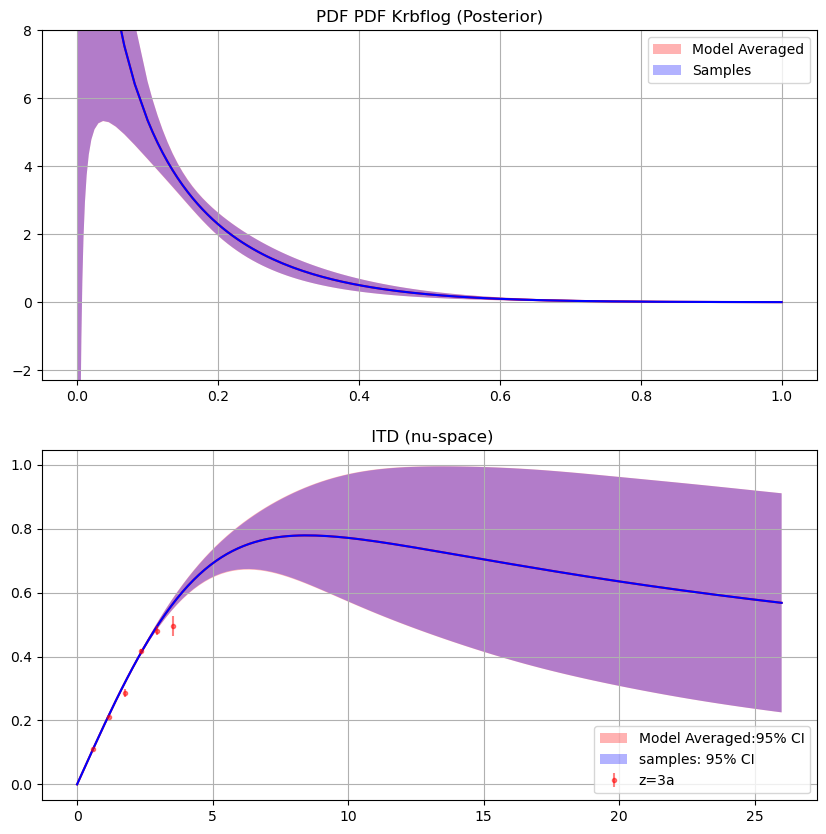

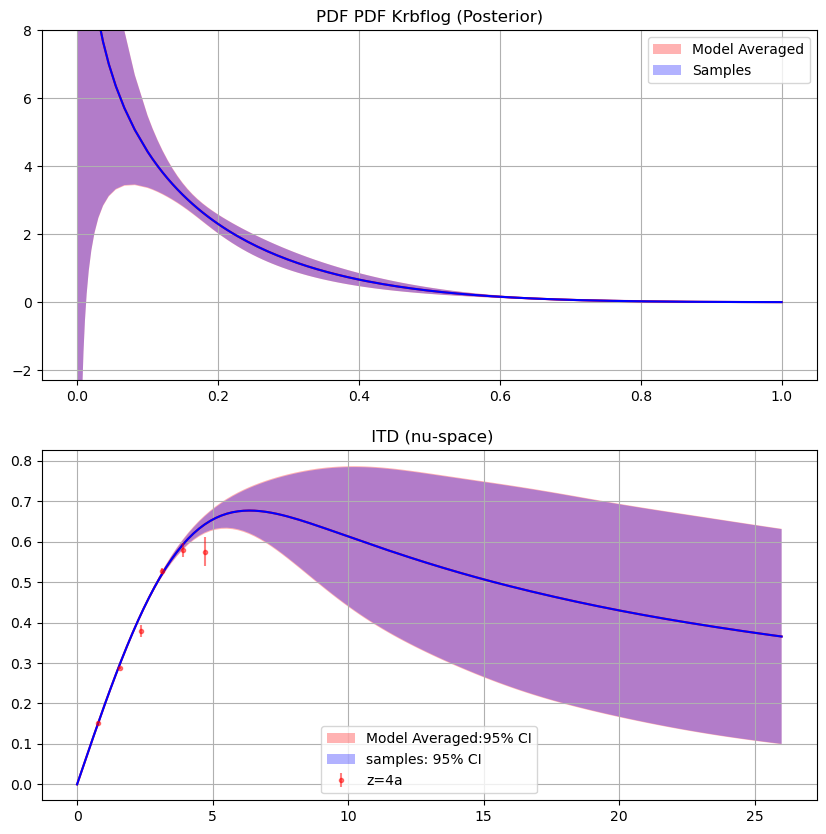

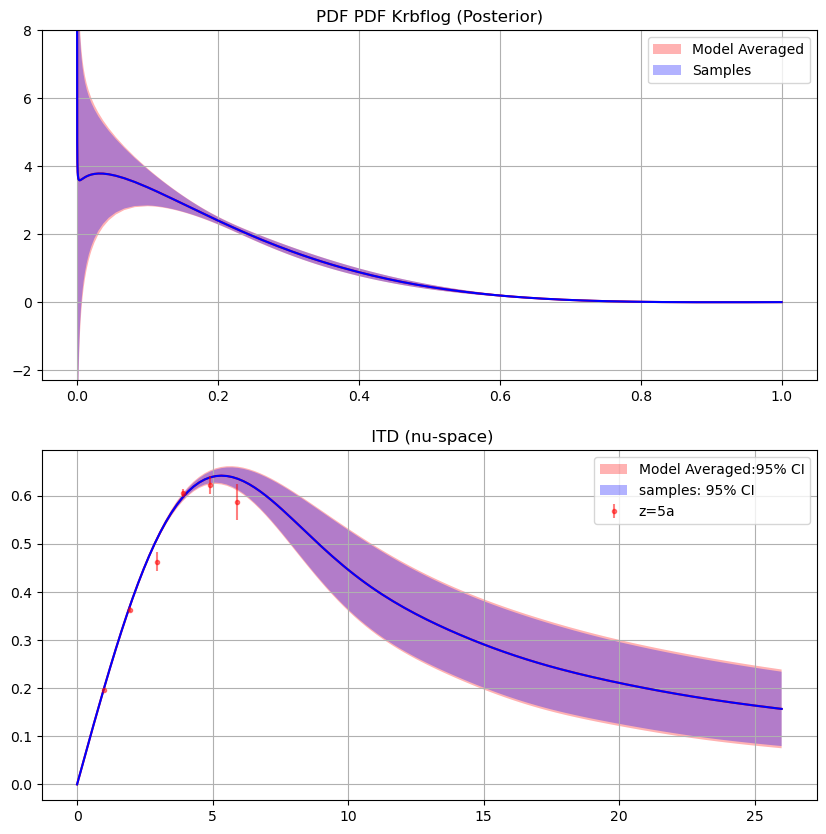

...

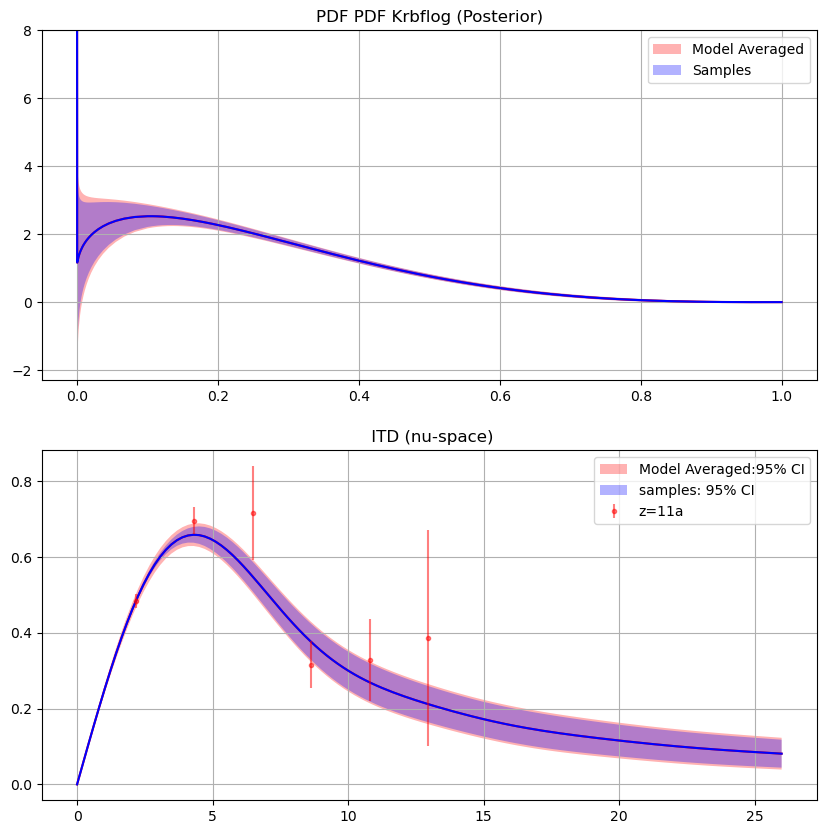

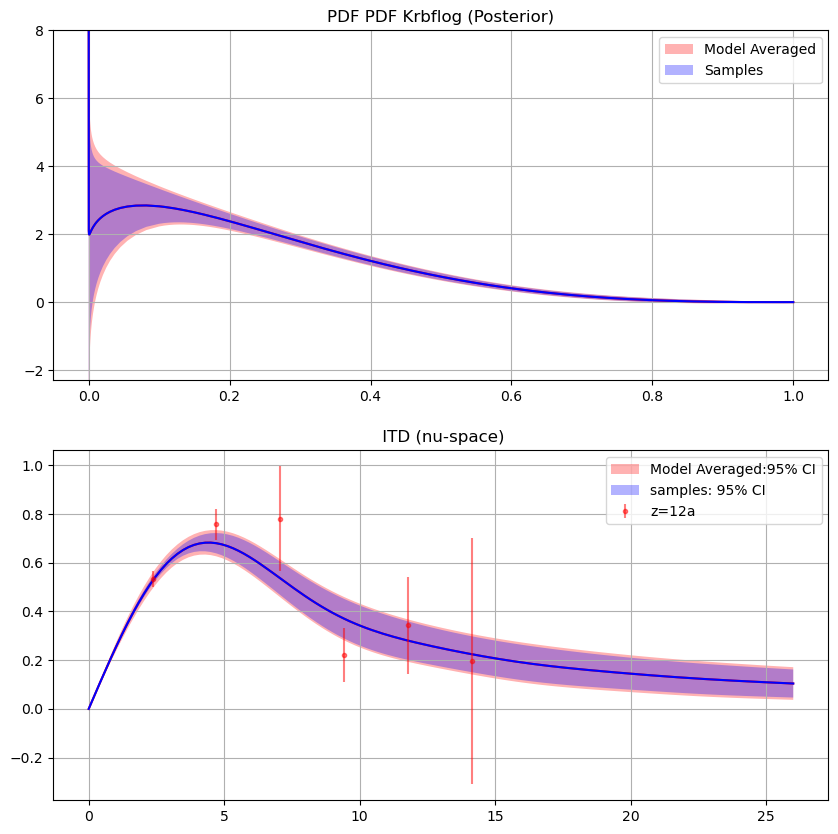

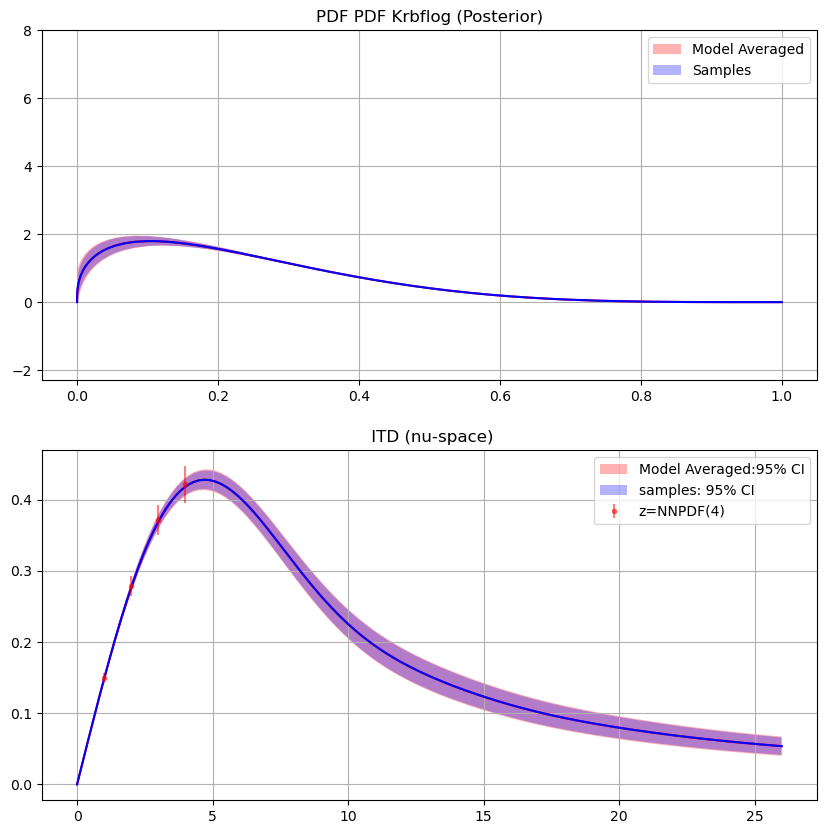

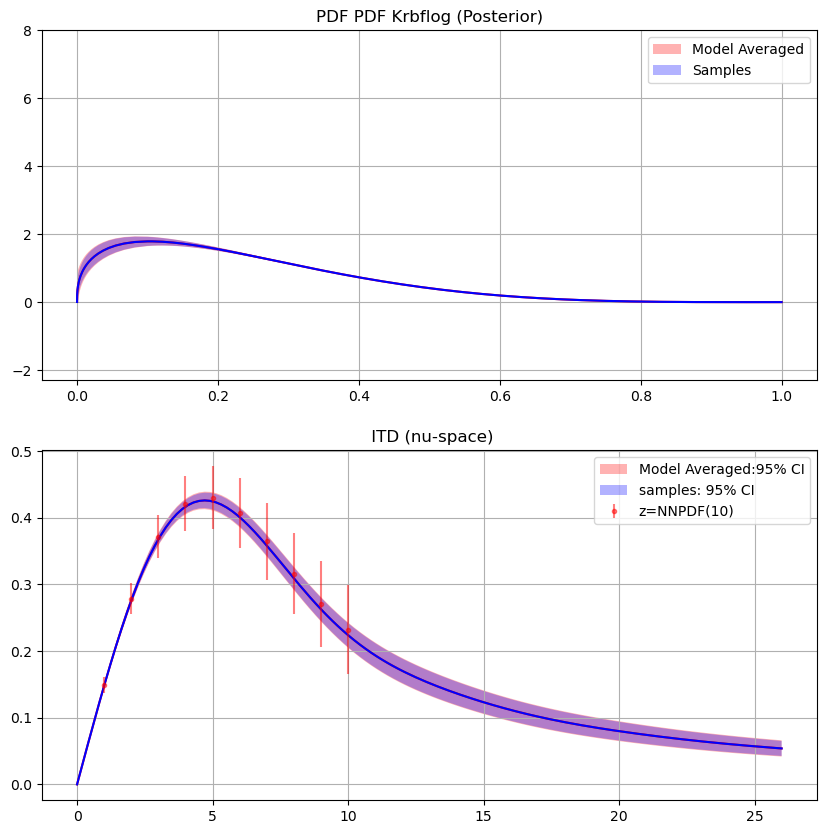

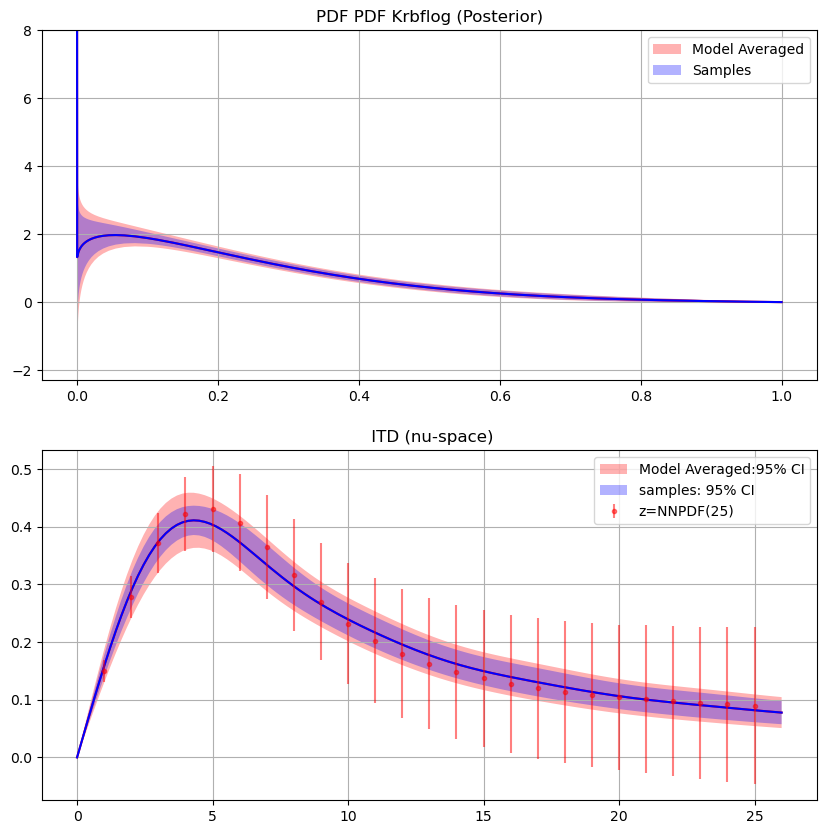

In [28]:
plot_individual_pdf(PDF_Krbflog_Im,PDF_Krbflog_Im_samplesqx,PDF_Krbflog_Im_samplesQv,PDF_Krbflog_Im_qofxs,PDF_Krbflog_Im_Qofvs,PDF_Krbflog_Im_covs,PDF_Krbflog_Im_covsnu,number,"PDF","Krbflog","Im","NNPDF",iB_Im)

# Plot all PDF

In [1]:
def plot_all_pdf(fits_comb,samplesqx,samplesQv,qofxs,Qofvs,covs,covsnu,number,modelname,kernelname,ITD,test,iB,whichplot,fCI=1.00):
    Qnu=[]
    nu,rMj,rMe,rM = get_data(ITD)
    for i in range(0,number):
        ttQ = samplesqx[i]@iB.T
        Qnu.append(ttQ)
        #print("ITD",fits_comb[i].name,"done")
    fig, ax= plt.subplots(2,figsize=(10, 10))
    ax[0].set_title(f'PDF {modelname} {kernelname} (Posterior)')
    ax[1].set_title("ITD (nu-space)")
    for i in range(0,number):

        col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
        meanx=samplesqx[i].mean(axis=0)
        qofx=qofxs[i]
        qsig=fCI*np.diag(np.cov(samplesqx[i].T))**(0.5)
        qerror=fCI*np.diag(tr.abs(covs[i]))**(0.5)
        if whichplot=="samples":
            ax[0].fill_between(x_gri0, meanx - qsig,  meanx+ qsig, facecolor=col[i], alpha=0.3,label='Samples')
            ax[0].legend()
            ax[0].grid()

            #for j in range(len(samplesqx[i])):
            #    ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.03)
            #ax[0].plot(x_gri0,qofx,label=fits_comb[i].name,color='blue')
            ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name,color='red')
            ax[0].plot(x_gri0,meanx,color='blue')

            ax[0].set_ylim([-2.3,8])
        else:
            ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor=col[i], alpha=0.3,label='Model Averaged')
            ax[0].legend()
            ax[0].grid()

            ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name,color='red')
            ax[0].plot(x_gri0,meanx,color='blue')

            ax[0].set_ylim([-2.3,8])

        #plot ttQ with the mean
        #mttQ = Qnu[i].mean(axis=0)
        mttQ=Qofvs[i]
        meanv=samplesQv[i].mean(axis=0)
        Qsig=fCI* np.diag(np.cov(samplesQv[i].T))**0.5
        Qerror=fCI*np.diag(tr.abs(covsnu[i]))**0.5
        #ax[1].plot(nn,Qnu[i].T,color=col[i],alpha=0.05)
        #Qsig=np.diag(covQ)**(0.5)
        if whichplot=="samples":
            ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor=col[i], alpha=0.3,label='samples: 95% CI')
            ax[1].plot(nn,mttQ,color='red')
            ax[1].plot(nn,meanv,color='blue')
        else:
            ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor=col[i], alpha=0.3,label='Model Averaged:95% CI')
            ax[1].plot(nn,mttQ,color='red')
            ax[1].plot(nn,meanv,color='blue')

        if i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            nu_d_grid = datanu.T[1]
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
            ax[1].errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        elif i<12:
            ax[1].errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
            ax[1].legend()
            ax[1].grid()
        plt.show()

In [2]:
def plot_all_pdf(spects, test, iB, whichplot,list, fCI=1.00):
    fits_comb, samplesqx, samplesQv, qofxs, Qofvs, covs, covsnu, modelname, kernelname, ITD= spects
    Qnu = []
    alpha = 0.6
    nu, rMj, rMe, rM = get_data(ITD)  # Asegúrate de que esta función esté definida
    col = ['red', 'blue', 'green', 'pink', 'black', 'orange', 'purple', 'brown', 'cyan', 'magenta', 'yellow', 'grey', 'lime', 'lightblue', 'teal']
    
    # Configurar figura
    fig, ax = plt.subplots(2, figsize=(10, 10))
    ax[0].set_title(f'PDF ({modelname}+{kernelname}) (Posterior)')
    ax[1].set_title("ITD (nu-space)")

    # Iterar sobre los modelos
    for i in list:
        color = col[i % len(col)]  # Evitar errores si number > len(col)

        # Calcular ttQ
        ttQ = samplesqx[i] @ iB.T
        Qnu.append(ttQ)

        # Calcular estadísticos
        meanx = samplesqx[i].mean(axis=0)
        qofx = qofxs[i]
        qsig = fCI * np.diag(np.cov(samplesqx[i].T))**0.5
        qerror = fCI * np.diag(tr.abs(covs[i]))**0.5

        # Graficar PDF
        if whichplot == "samples":
            ax[0].fill_between(x_gri0, meanx - qsig, meanx + qsig, facecolor=color, alpha=alpha/2, label=fits_comb[i].name)
            ax[0].plot(x_gri0, meanx, color=col[i], alpha=alpha)
        else:
            ax[0].fill_between(x_gri0, qofx - qerror, qofx + qerror, facecolor=color, alpha=alpha/2, label=fits_comb[i].name)
            ax[0].plot(x_gri0, qofx, color=col[i],alpha=alpha)
            ax[0].set_ylim([-2.3,8])


        ax[0].grid()
        ax[0].legend()

        # Graficar ITD (nu-space)
        meanv = samplesQv[i].mean(axis=0)
        Qsig = fCI * np.diag(np.cov(samplesQv[i].T))**0.5
        Qerror = fCI * np.diag(tr.abs(covsnu[i]))**0.5
        mttQ = Qofvs[i]

        if whichplot == "samples":
            ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor=color, alpha=0.3, label=fits_comb[i].name)
            ax[1].plot(nn, meanv, color=col[i],alpha=alpha)
        else:
            ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor=color, alpha=0.3, label=fits_comb[i].name)
            ax[1].plot(nn, mttQ, color=col[i],alpha=alpha)

        ax[1].grid()
        ax[1].legend()

        if i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            nu_d_grid = datanu.T[1]
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
            ax[1].errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.8,color=col[i])
        elif i<12:
            ax[1].errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.8,color=col[i])

    # Mostrar la figura al final
    plt.tight_layout()
    plt.show()

In [3]:
ModelC_Krbflog_Re_spects=[ModelC_Krbflog_Re,MC_Krbflog_Re_samplesqx,MC_Krbflog_Re_samplesQv,MC_Krbflog_Re_qofxs,MC_Krbflog_Re_Qofvs,MC_Krbflog_Re_covs,MC_Krbflog_Re_covsnu,"ModelC","Krbflog","Re"]
ModelC_Krbflog_Im_spects=[ModelC_Krbflog_Im,MC_Krbflog_Im_samplesqx,MC_Krbflog_Im_samplesQv,MC_Krbflog_Im_qofxs,MC_Krbflog_Im_Qofvs,MC_Krbflog_Im_covs,MC_Krbflog_Im_covsnu,"ModelC","Krbflog","Im"]
PDF_Krbflog_Re_spects=[PDF_Krbflog_Re,PDF_Krbflog_Re_samplesqx,PDF_Krbflog_Re_samplesQv,PDF_Krbflog_Re_qofxs,PDF_Krbflog_Re_Qofvs,PDF_Krbflog_Re_covs,PDF_Krbflog_Re_covsnu,"PDF","Krbflog","Re"]
PDF_Krbflog_Im_spects=[PDF_Krbflog_Im,PDF_Krbflog_Im_samplesqx,PDF_Krbflog_Im_samplesQv,PDF_Krbflog_Im_qofxs,PDF_Krbflog_Im_Qofvs,PDF_Krbflog_Im_covs,PDF_Krbflog_Im_covsnu,"PDF","Krbflog","Im"]

ModelC_Kdebbioxa_Re_spects=[ModelC_Kdebbioxa_Re,MC_Kdebbioxa_Re_samplesqx,MC_Kdebbioxa_Re_samplesQv,MC_Kdebbioxa_Re_qofxs,MC_Kdebbioxa_Re_Qofvs,MC_Kdebbioxa_Re_covs,MC_Kdebbioxa_Re_covsnu,"ModelC","Kdebbioxa","Re"]
ModelC_Kdebbioxa_Im_spects=[ModelC_Kdebbioxa_Im,MC_Kdebbioxa_Im_samplesqx,MC_Kdebbioxa_Im_samplesQv,MC_Kdebbioxa_Im_qofxs,MC_Kdebbioxa_Im_Qofvs,MC_Kdebbioxa_Im_covs,MC_Kdebbioxa_Im_covsnu,"ModelC","Kdebbioxa","Im"]
PDF_Kdebbioxa_Re_spects=[PDF_Kdebbioxa_Re,PDF_Kdebbioxa_Re_samplesqx,PDF_Kdebbioxa_Re_samplesQv,PDF_Kdebbioxa_Re_qofxs,PDF_Kdebbioxa_Re_Qofvs,PDF_Kdebbioxa_Re_covs,PDF_Kdebbioxa_Re_covsnu,"PDF","Kdebbioxa","Re"]
PDF_Kdebbioxa_Im_spects=[PDF_Kdebbioxa_Im,PDF_Kdebbioxa_Im_samplesqx,PDF_Kdebbioxa_Im_samplesQv,PDF_Kdebbioxa_Im_qofxs,PDF_Kdebbioxa_Im_Qofvs,PDF_Kdebbioxa_Im_covs,PDF_Kdebbioxa_Im_covsnu,"PDF","Kdebbioxa","Im"]

ModelC_Krbflog_no_s_Re_spects=[ModelC_Krbflog_no_s_Re,ModelC_Krbflog_no_s_Re_samplesqx,ModelC_Krbflog_no_s_Re_samplesQv,ModelC_Krbflog_no_s_Re_qofxs,ModelC_Krbflog_no_s_Re_Qofvs,ModelC_Krbflog_no_s_Re_covs,ModelC_Krbflog_no_s_Re_covsnu,"ModelC","Krbflog_no_s","Re"]
ModelC_Krbflog_no_s_Im_spects=[ModelC_Krbflog_no_s_Im,ModelC_Krbflog_no_s_Im_samplesqx,ModelC_Krbflog_no_s_Im_samplesQv,ModelC_Krbflog_no_s_Im_qofxs,ModelC_Krbflog_no_s_Im_Qofvs,ModelC_Krbflog_no_s_Im_covs,ModelC_Krbflog_no_s_Im_covsnu,"ModelC","Krbflog_no_s","Im"]
PDF_Krbflog_no_s_Re_spects=[PDF_Krbflog_no_s_Re,PDF_Krbflog_no_s_Re_samplesqx,PDF_Krbflog_no_s_Re_samplesQv,PDF_Krbflog_no_s_Re_qofxs,PDF_Krbflog_no_s_Re_Qofvs,PDF_Krbflog_no_s_Re_covs,PDF_Krbflog_no_s_Re_covsnu,"PDF","Krbflog_no_s","Re"]
PDF_Krbflog_no_s_Im_spects=[PDF_Krbflog_no_s_Im,PDF_Krbflog_no_s_Im_samplesqx,PDF_Krbflog_no_s_Im_samplesQv,PDF_Krbflog_no_s_Im_qofxs,PDF_Krbflog_no_s_Im_Qofvs,PDF_Krbflog_no_s_Im_covs,PDF_Krbflog_no_s_Im_covsnu,"PDF","Krbflog_no_s","Im"]

ModelC_rbf_logrbf_Re_spects=[ModelC_rbf_logrbf_Re,ModelC_rbf_logrbf_Re_samplesqx,ModelC_rbf_logrbf_Re_samplesQv,ModelC_rbf_logrbf_Re_qofxs,ModelC_rbf_logrbf_Re_Qofvs,ModelC_rbf_logrbf_Re_covs,ModelC_rbf_logrbf_Re_covsnu,"ModelC","rbf_logrbf","Re"]
ModelC_rbf_logrbf_Im_spects=[ModelC_rbf_logrbf_Im,ModelC_rbf_logrbf_Im_samplesqx,ModelC_rbf_logrbf_Im_samplesQv,ModelC_rbf_logrbf_Im_qofxs,ModelC_rbf_logrbf_Im_Qofvs,ModelC_rbf_logrbf_Im_covs,ModelC_rbf_logrbf_Im_covsnu,"ModelC","rbf_logrbf","Im"]
PDF_rbf_logrbf_Re_spects=[PDF_rbf_logrbf_Re,PDF_rbf_logrbf_Re_samplesqx,PDF_rbf_logrbf_Re_samplesQv,PDF_rbf_logrbf_Re_qofxs,PDF_rbf_logrbf_Re_Qofvs,PDF_rbf_logrbf_Re_covs,PDF_rbf_logrbf_Re_covsnu,"PDF","rbf_logrbf","Re"]
PDF_rbf_logrbf_Im_spects=[PDF_rbf_logrbf_Im,PDF_rbf_logrbf_Im_samplesqx,PDF_rbf_logrbf_Im_samplesQv,PDF_rbf_logrbf_Im_qofxs,PDF_rbf_logrbf_Im_Qofvs,PDF_rbf_logrbf_Im_covs,PDF_rbf_logrbf_Im_covsnu,"PDF","rbf_logrbf","Im"]

NameError: name 'ModelC_Krbflog_Re' is not defined

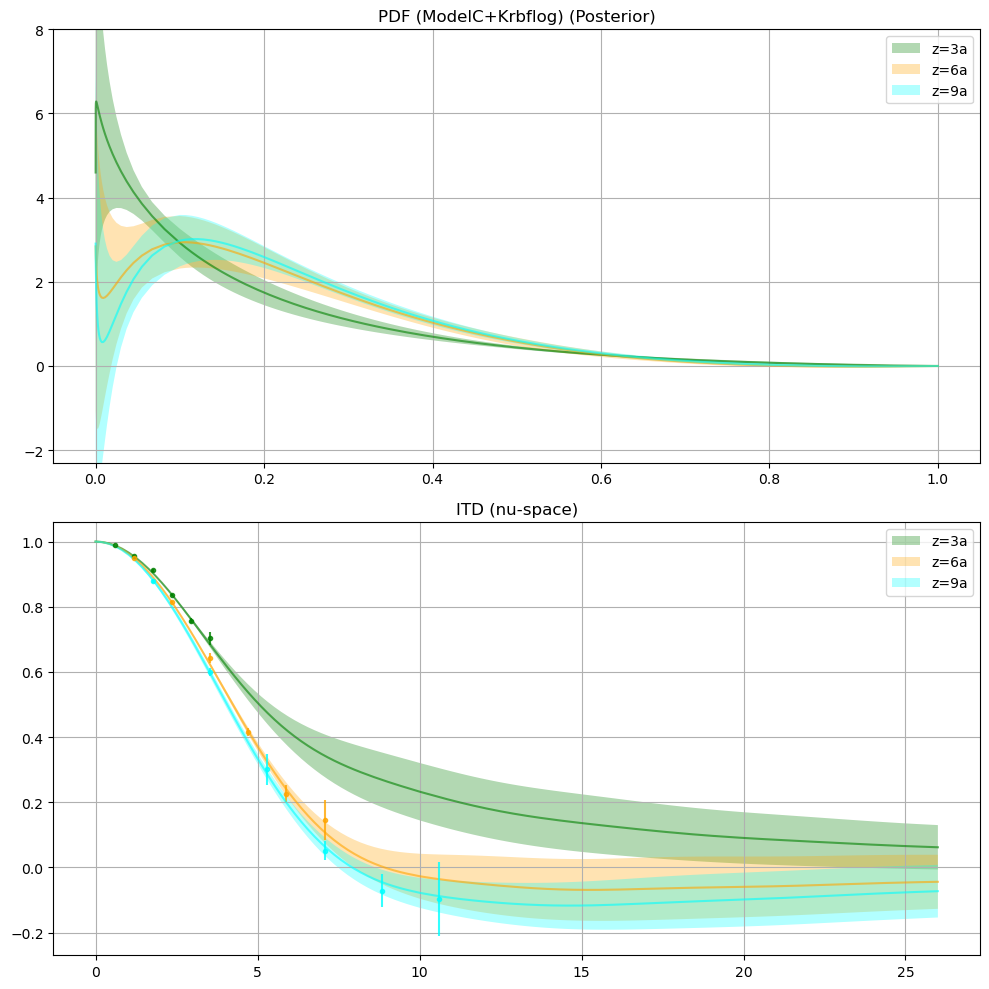

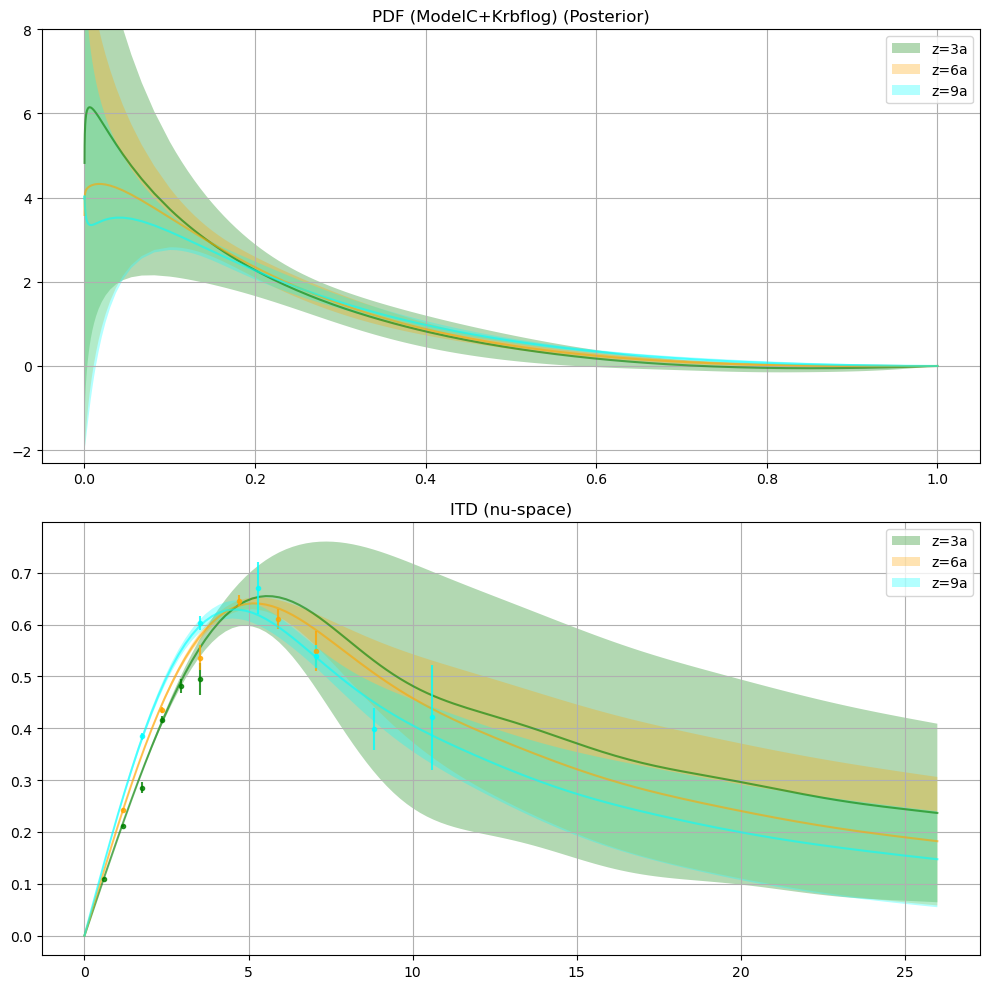

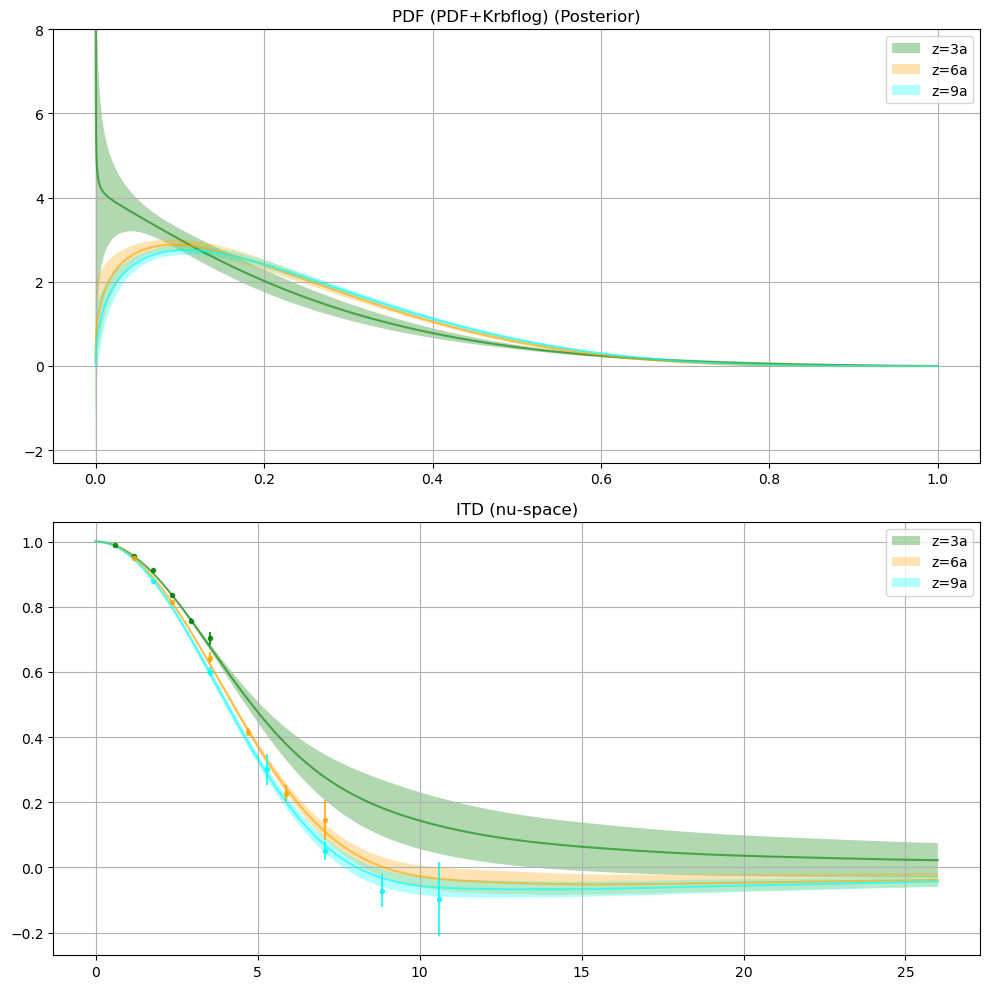

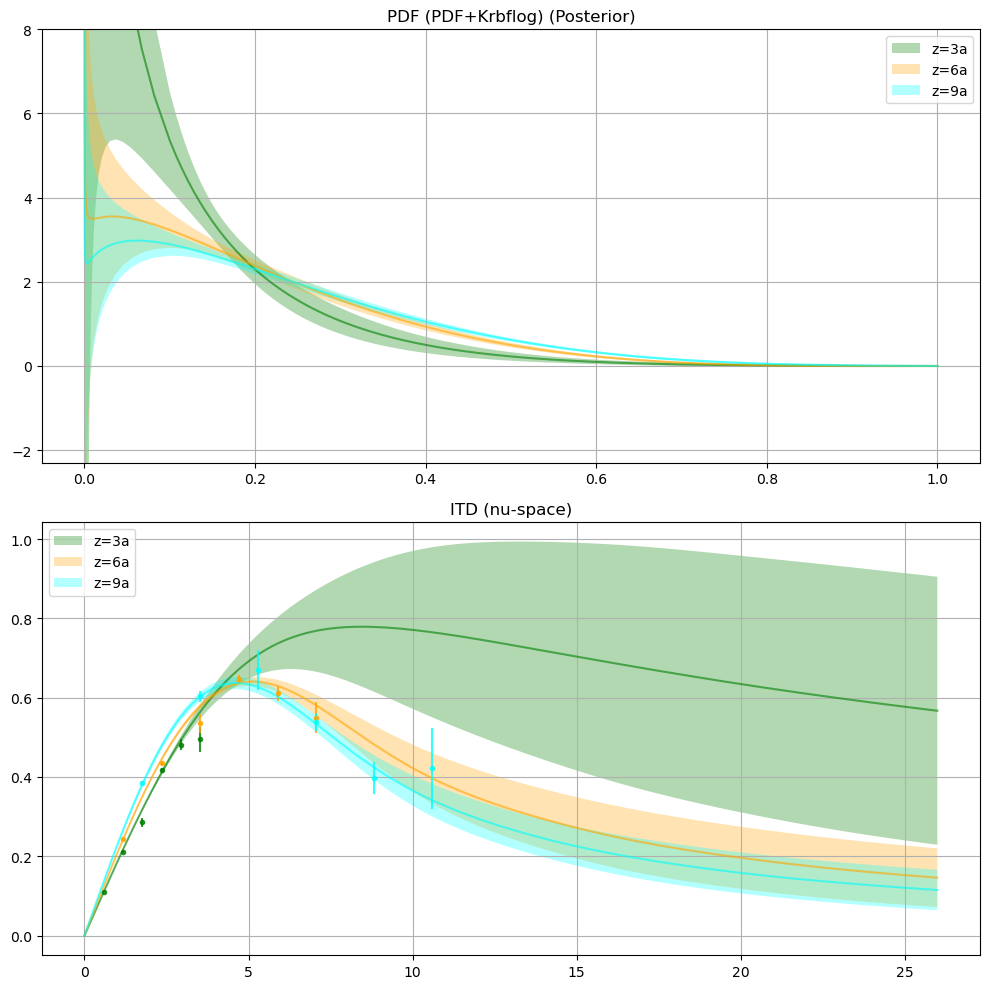

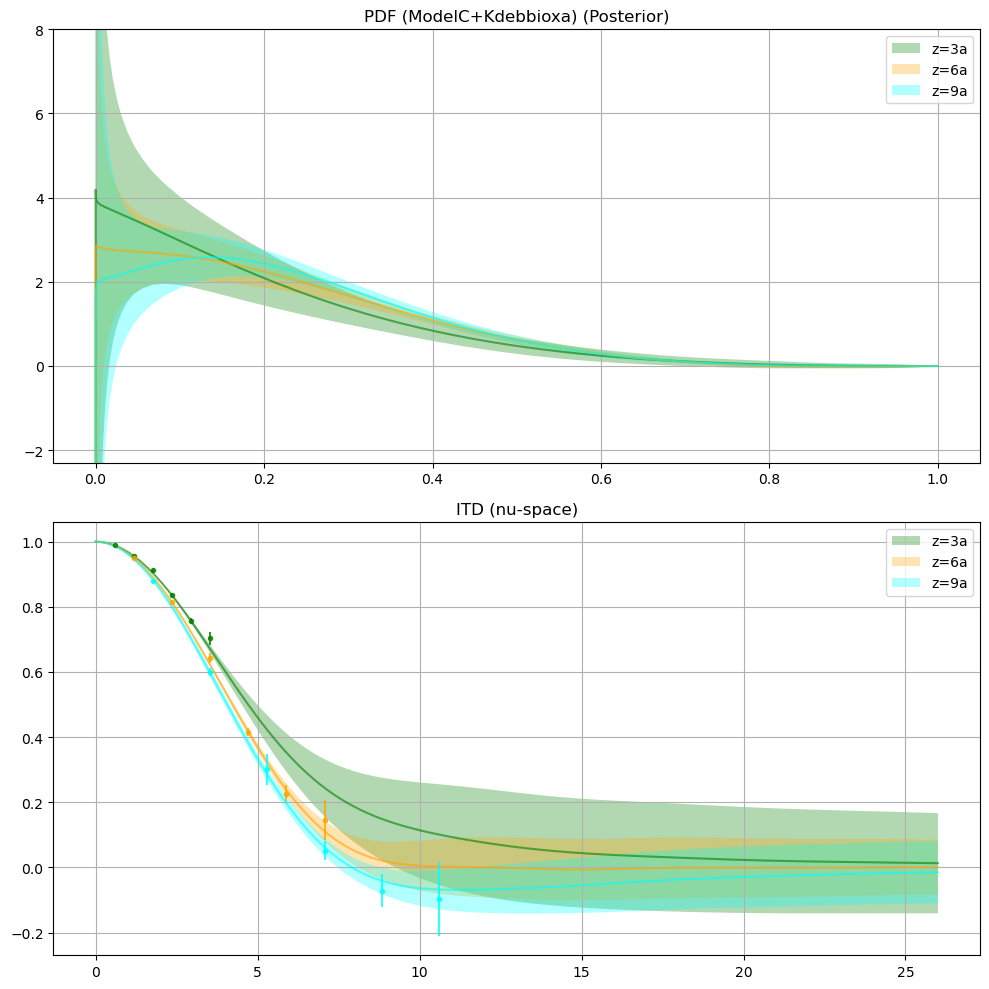

...

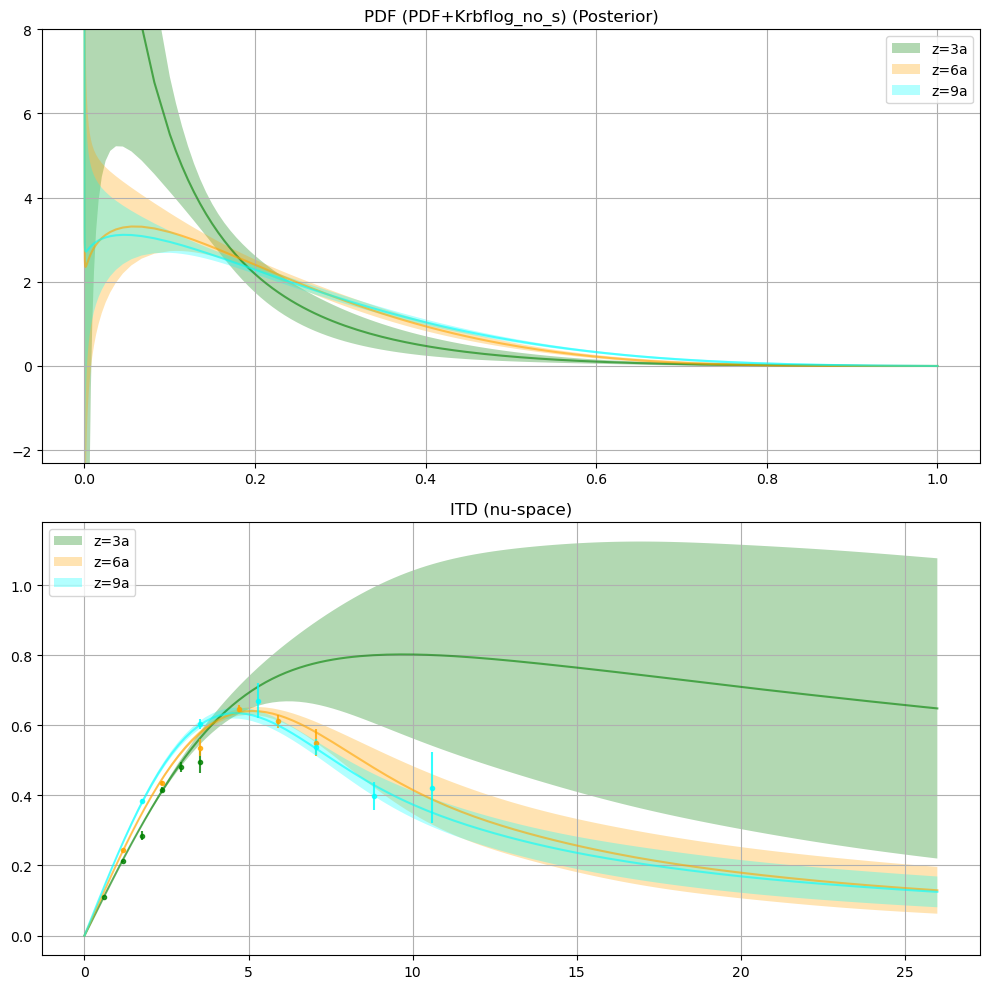

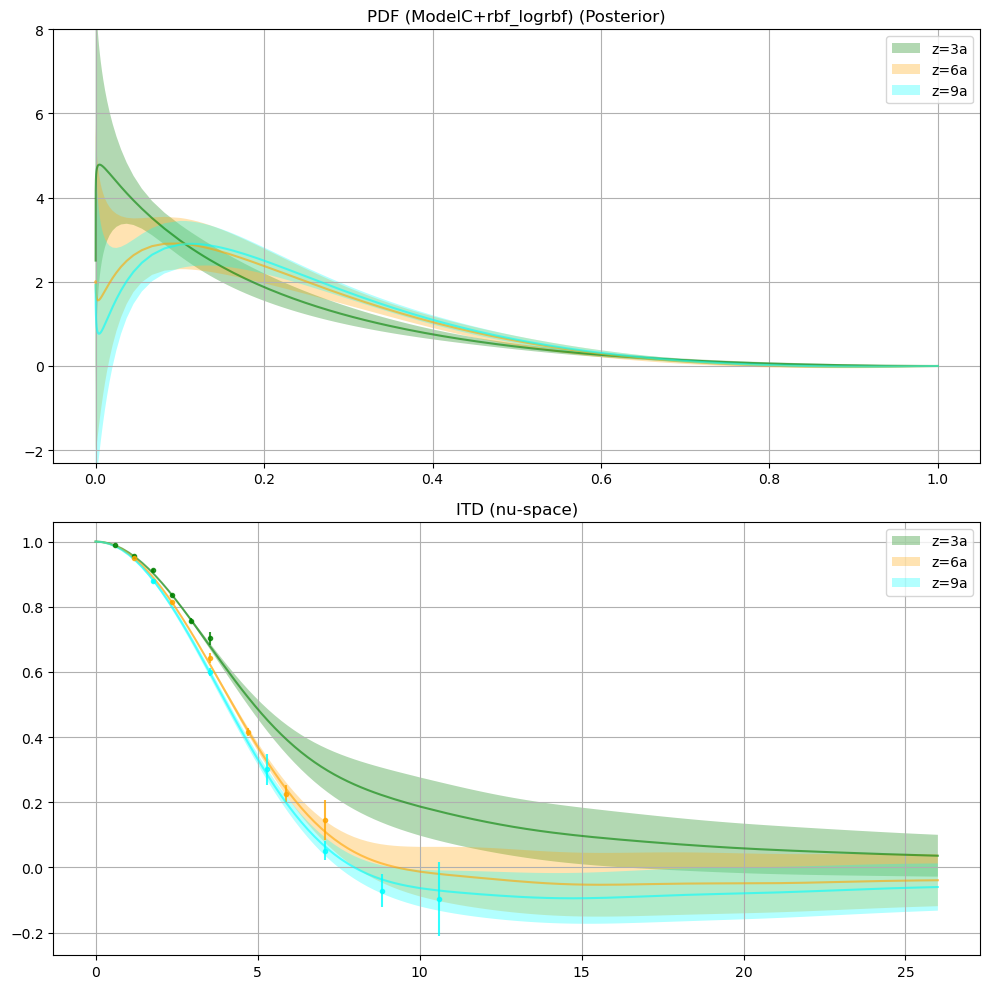

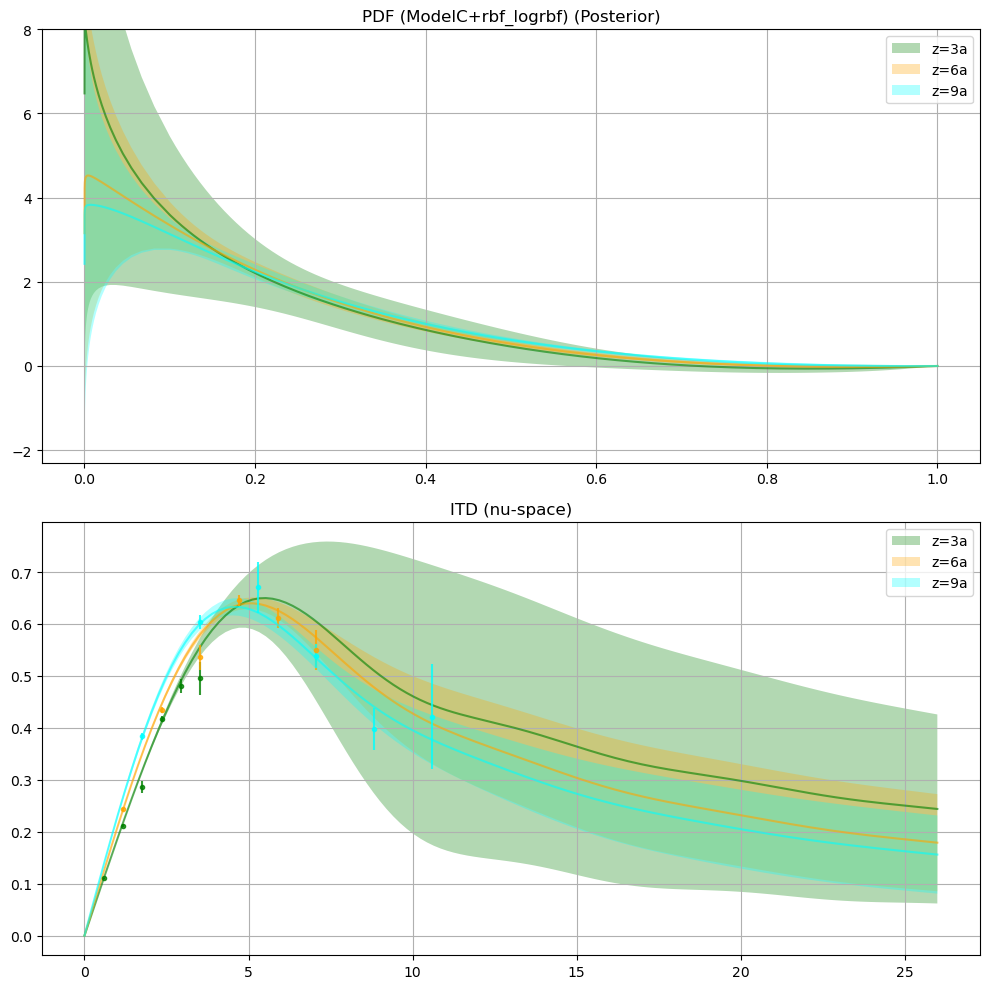

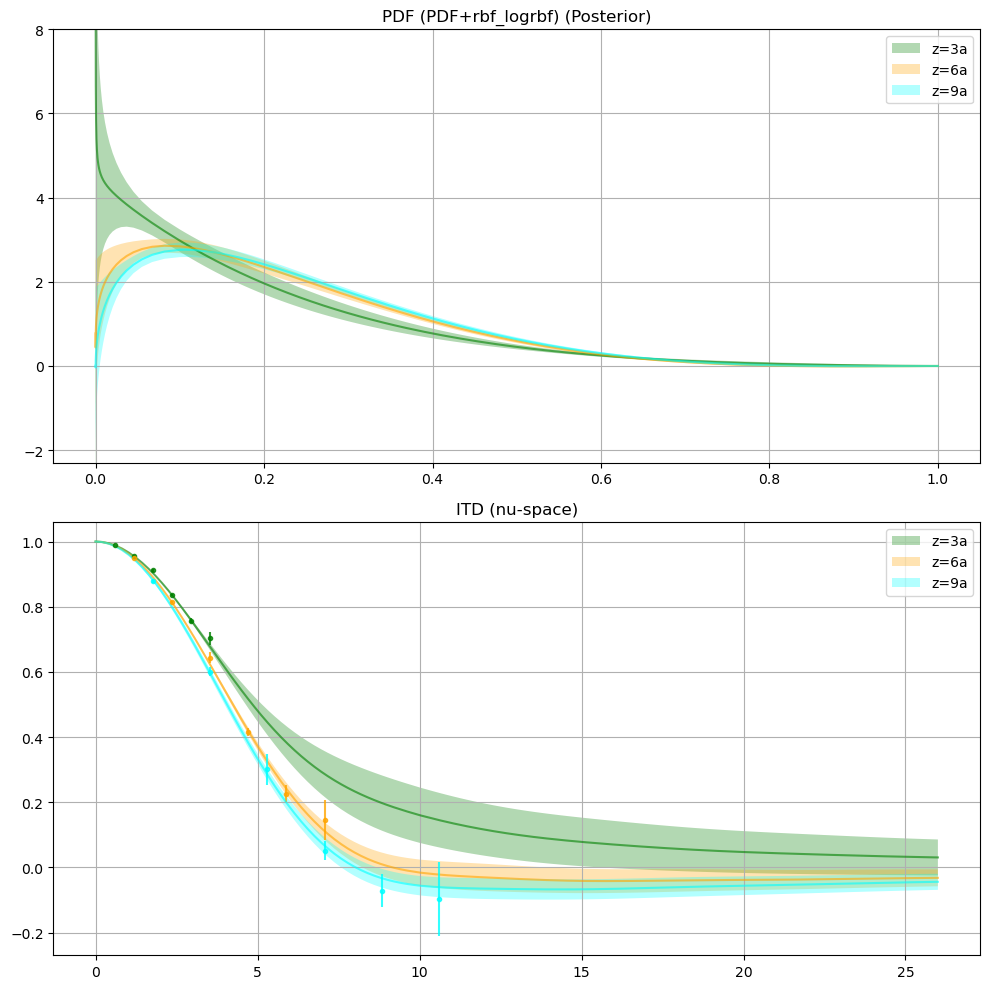

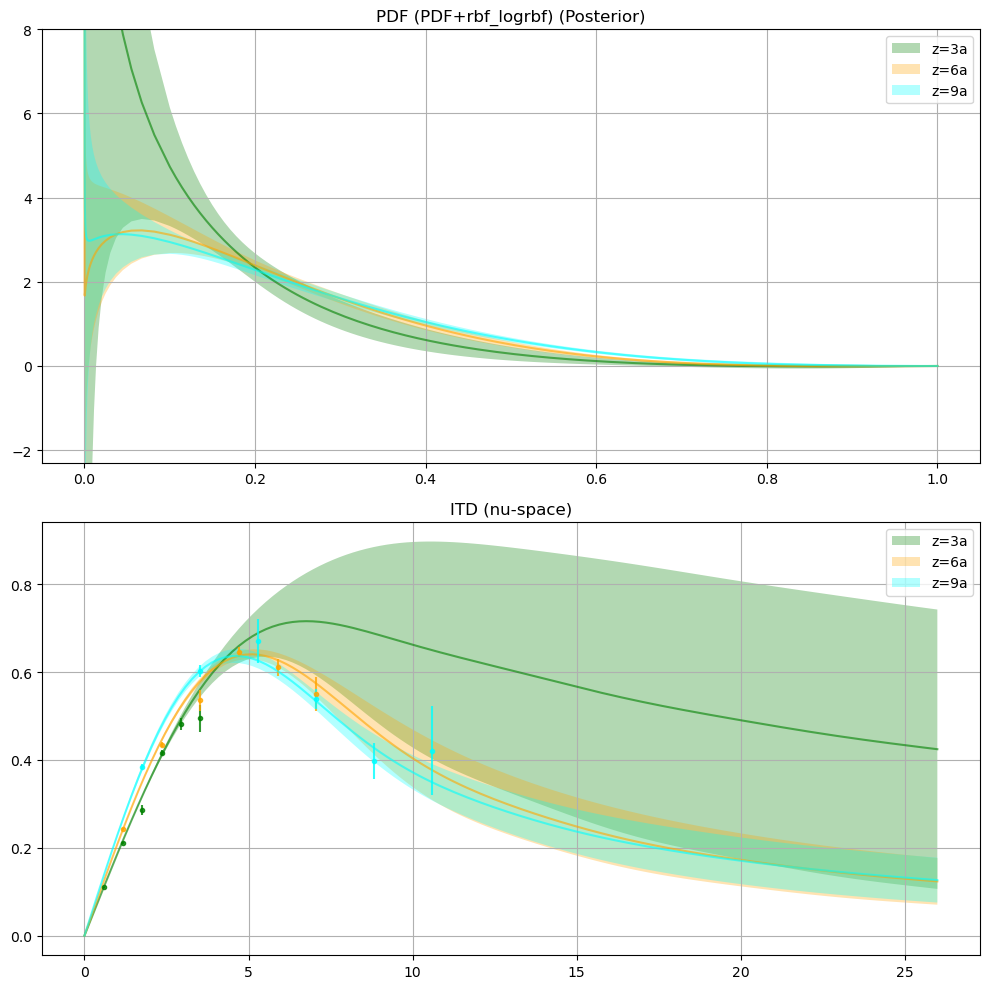

In [12]:
whichz=[2,5,8]
plot_all_pdf(ModelC_Krbflog_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(ModelC_Krbflog_Im_spects,"NNPDF",iB_Im,"MA",whichz)
plot_all_pdf(PDF_Krbflog_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(PDF_Krbflog_Im_spects,"NNPDF",iB_Im,"MA",whichz)

plot_all_pdf(ModelC_Kdebbioxa_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(ModelC_Kdebbioxa_Im_spects,"NNPDF",iB_Im,"MA",whichz)
plot_all_pdf(PDF_Kdebbioxa_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(PDF_Kdebbioxa_Im_spects,"NNPDF",iB_Im,"MA",whichz)

plot_all_pdf(ModelC_Krbflog_no_s_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(ModelC_Krbflog_no_s_Im_spects,"NNPDF",iB_Im,"MA",whichz)
plot_all_pdf(PDF_Krbflog_no_s_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(PDF_Krbflog_no_s_Im_spects,"NNPDF",iB_Im,"MA",whichz)

plot_all_pdf(ModelC_rbf_logrbf_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(ModelC_rbf_logrbf_Im_spects,"NNPDF",iB_Im,"MA",whichz)
plot_all_pdf(PDF_rbf_logrbf_Re_spects,"NNPDF",iB_Re,"MA",whichz)
plot_all_pdf(PDF_rbf_logrbf_Im_spects,"NNPDF",iB_Im,"MA",whichz)

In [40]:
#plot all from different models
def plot_all_pdf_kernel(Modelsspects, test, iB, whichplot,list, fCI=1.00):
    alpha=0.6
        # Configurar figura
    fig, ax = plt.subplots(2, figsize=(10, 10))
    ax[0].set_title(f'PDF (Posterior)')
    ax[1].set_title("ITD (nu-space)")
    j=6
    for spects in Modelsspects:
        fits_comb, samplesqx, samplesQv, qofxs, Qofvs, covs, covsnu, modelname, kernelname, ITD= spects

        Qnu = []
        nu, rMj, rMe, rM = get_data(ITD)  # Asegúrate de que esta función esté definida
        col = ['red', 'blue', 'green', 'pink', 'black', 'orange', 'purple', 'brown', 'cyan', 'magenta', 'yellow', 'grey', 'lime', 'lightblue', 'teal']
        

        # Iterar sobre los modelos
        for i in list:
            color = col[i % len(col)]  # Evitar errores si number > len(col)

            # Calcular ttQ
            ttQ = samplesqx[i] @ iB.T
            Qnu.append(ttQ)

            # Calcular estadísticos
            meanx = samplesqx[i].mean(axis=0)
            qofx = qofxs[i]
            qsig = fCI * np.diag(np.cov(samplesqx[i].T))**0.5
            qerror = fCI * np.diag(tr.abs(covs[i]))**0.5

            # Graficar PDF
            if whichplot == "samples":
                ax[0].fill_between(x_gri0, meanx - qsig, meanx + qsig, facecolor=col[j], alpha=alpha/2, label=f"{modelname}+{kernelname}")
                ax[0].plot(x_gri0, meanx, color=col[j], alpha=alpha)
            else:
                ax[0].fill_between(x_gri0, qofx - qerror, qofx + qerror, facecolor=col[j], alpha=alpha/2, label=f"{modelname}+{kernelname}")
                ax[0].plot(x_gri0, qofx, color=col[j],alpha=alpha)
                ax[0].set_ylim([-2.3,8])


            ax[0].grid()
            ax[0].legend()

            # Graficar ITD (nu-space)
            meanv = samplesQv[i].mean(axis=0)
            Qsig = fCI * np.diag(np.cov(samplesQv[i].T))**0.5
            Qerror = fCI * np.diag(tr.abs(covsnu[i]))**0.5
            mttQ = Qofvs[i]

            if whichplot == "samples":
                ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor=col[j], alpha=alpha/2, label=f"{modelname}+{kernelname}")
                ax[1].plot(nn, meanv, color=col[j],alpha=alpha)
            else:
                ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor=col[j], alpha=alpha/2, label=f"{modelname}+{kernelname}")
                ax[1].plot(nn, mttQ, color=col[j],alpha=alpha)

            ax[1].grid()
            ax[1].legend()
            j=j+1
    if i >=12 and test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        if i==12:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
        elif i==13:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
        elif i==14:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
        nu_d_grid = datanu.T[1]
        M=datanu.T[2:].mean(axis=0)
        eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
        ax[1].errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,color="red",label=fits_comb[i].name)
        ax[1].legend()
    elif i<12:
        ax[1].errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,color="red",label=fits_comb[i].name)
        ax[1].legend()

    # Mostrar la figura al final
    plt.tight_layout()
    plt.show()

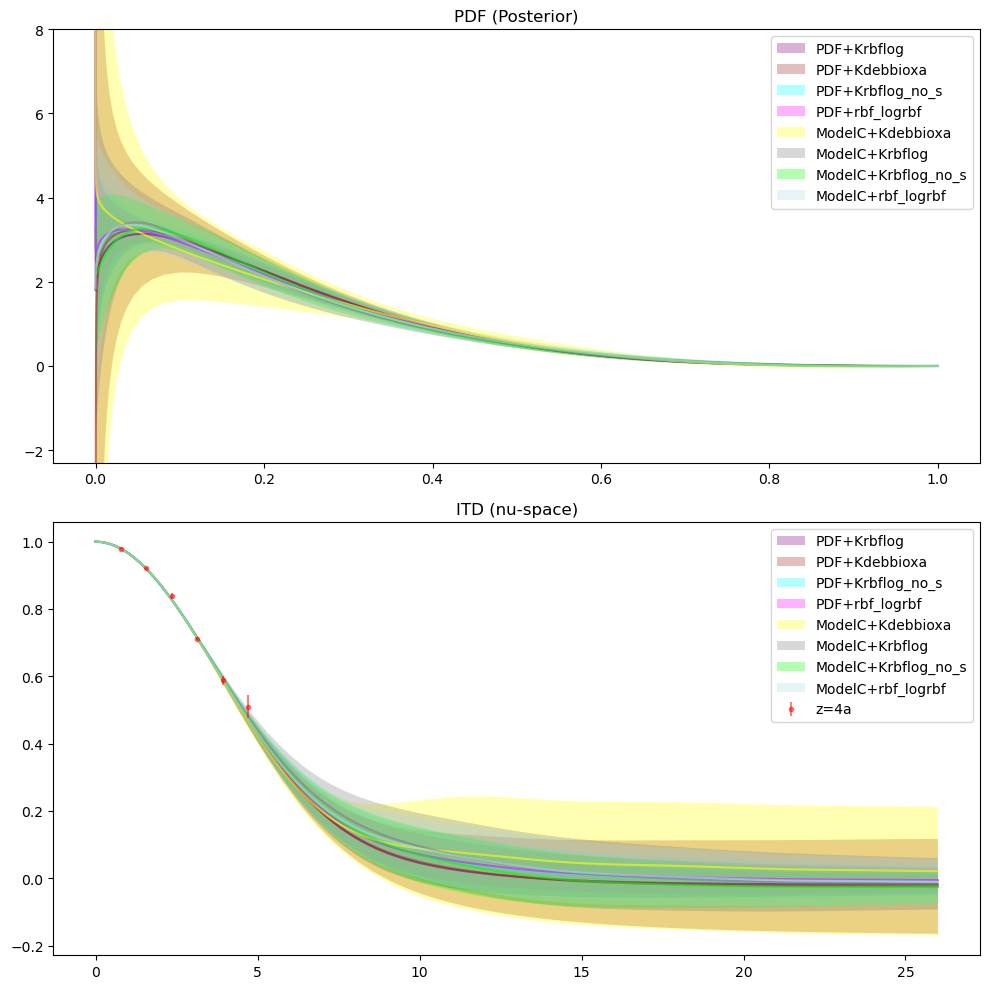

In [53]:
Models=[PDF_Krbflog_Re_spects,PDF_Kdebbioxa_Re_spects,PDF_Krbflog_no_s_Re_spects,PDF_rbf_logrbf_Re_spects,ModelC_Kdebbioxa_Re_spects,ModelC_Krbflog_Re_spects,ModelC_Krbflog_no_s_Re_spects,ModelC_rbf_logrbf_Re_spects]
#ModelC_Krbflog_Re_spects,PDF_Krbflog_Re_spects,,ModelC_Kdebbioxa_Re_spects,PDF_Kdebbioxa_Re_spects,ModelC_Krbflog_no_s_Re_spects,PDF_Krbflog_no_s_Re_spects,ModelC_rbf_logrbf_Re_spects,PDF_rbf_logrbf_Re_spects
plot_all_pdf_kernel(Models,"NNPDF",iB_Re,"MA",[3])

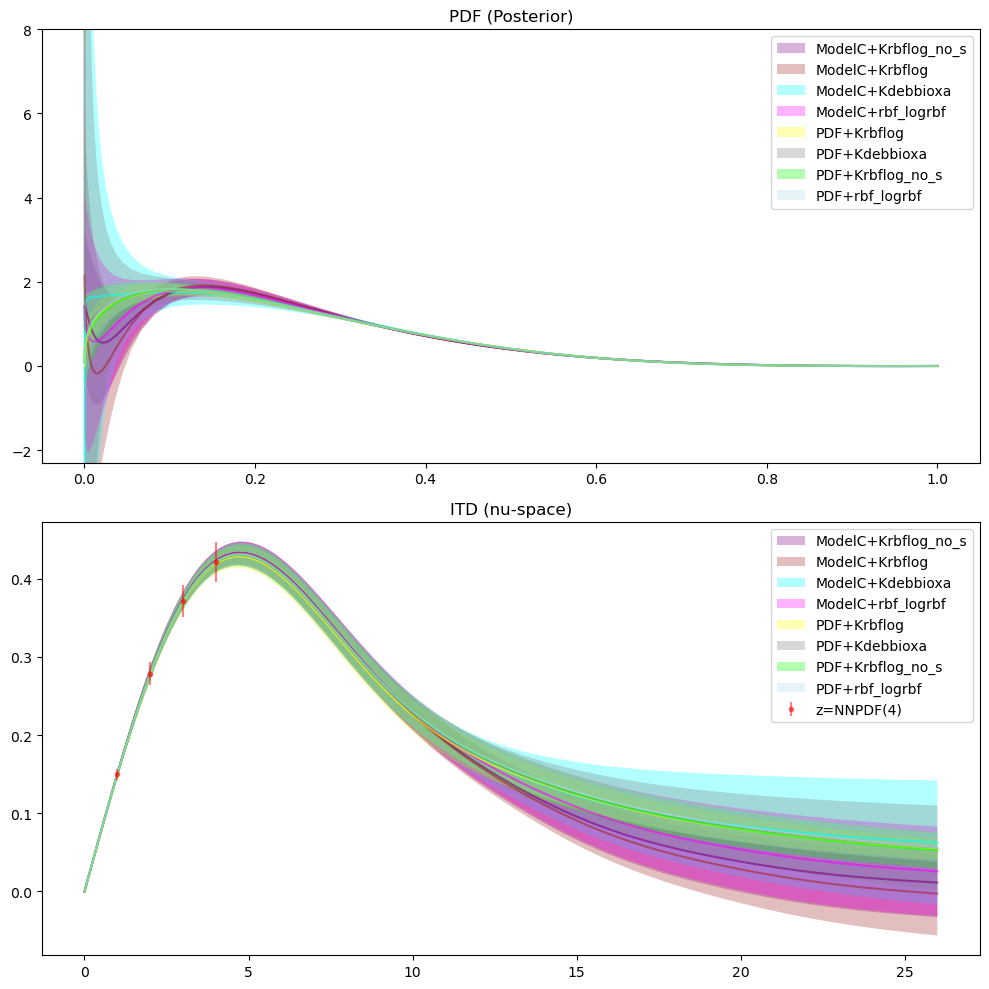

In [50]:
Models_Im=[ModelC_Krbflog_no_s_Im_spects,ModelC_Krbflog_Im_spects,ModelC_Kdebbioxa_Im_spects,ModelC_rbf_logrbf_Im_spects,PDF_Krbflog_Im_spects,PDF_Kdebbioxa_Im_spects,PDF_Krbflog_no_s_Im_spects,PDF_rbf_logrbf_Im_spects]
#ModelC_Krbflog_Im_spects,PDF_Krbflog_Im_spects,ModelC_Kdebbioxa_Im_spects,PDF_Kdebbioxa_Im_spects,ModelC_Krbflog_no_s_Im_spects,PDF_Krbflog_no_s_Im_spects,ModelC_rbf_logrbf_Im_spects,PDF_rbf_logrbf_Im_spects
plot_all_pdf_kernel(Models_Im,"NNPDF",iB_Im,"MA",[12])

In [ ]:
#Model Averaging 3rd level of inference for the PDF

/sciclone/home/yacahuanamedra/.conda/envs/gptorch/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/sciclone/home/yacahuanamedra/.conda/envs/gptorch/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


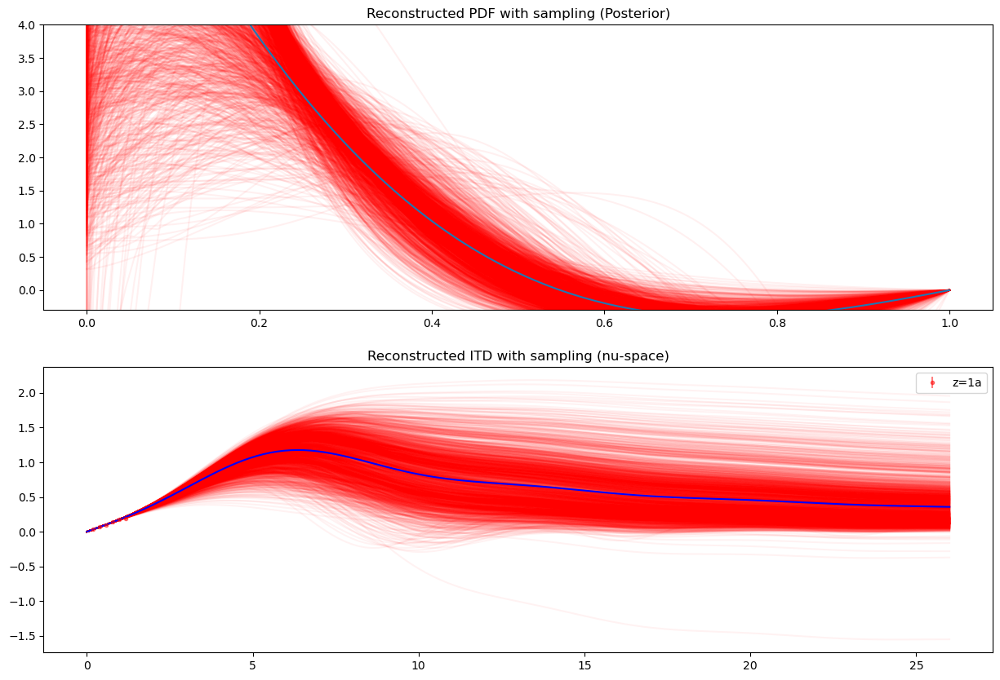

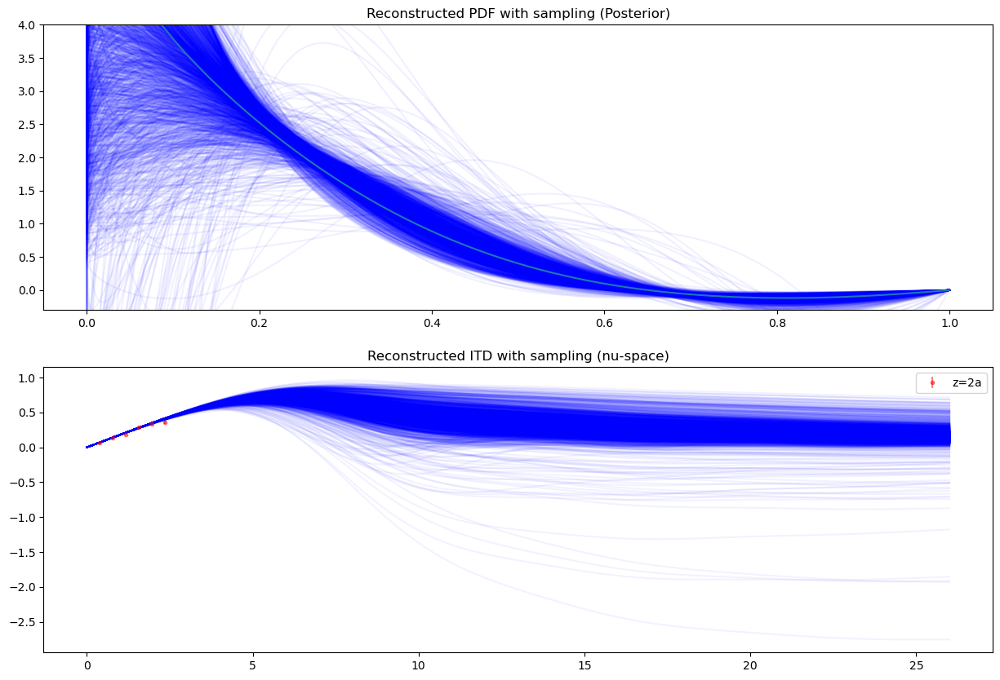

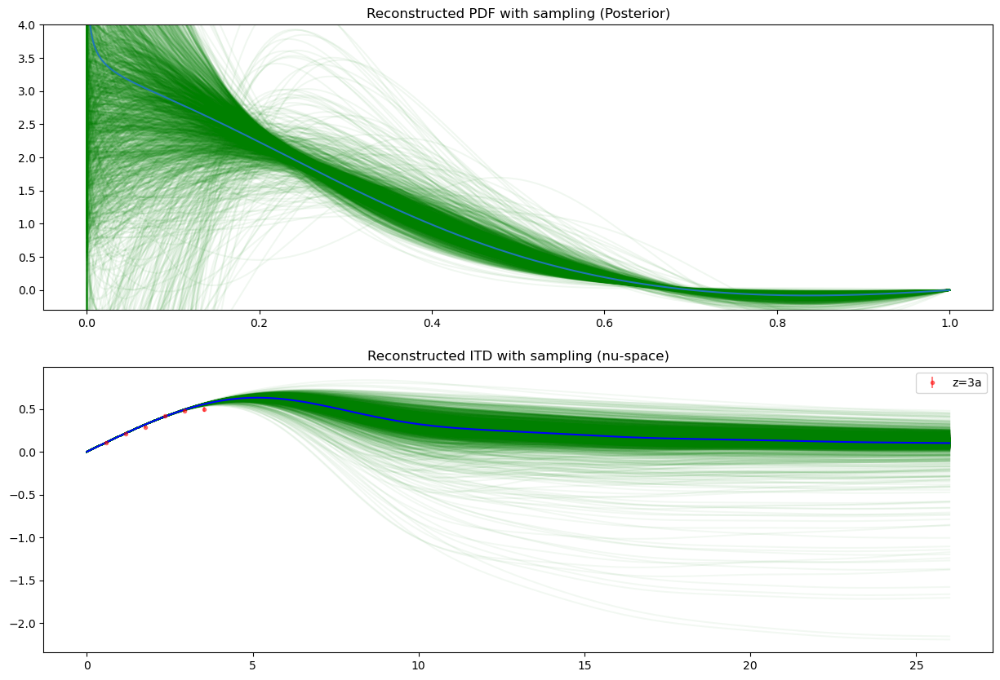

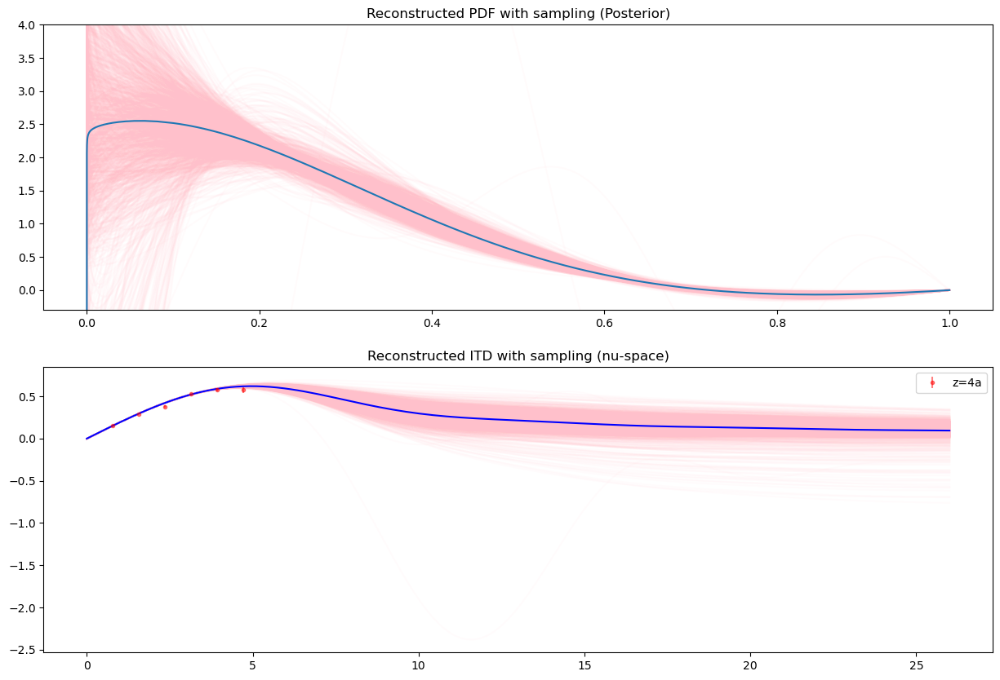

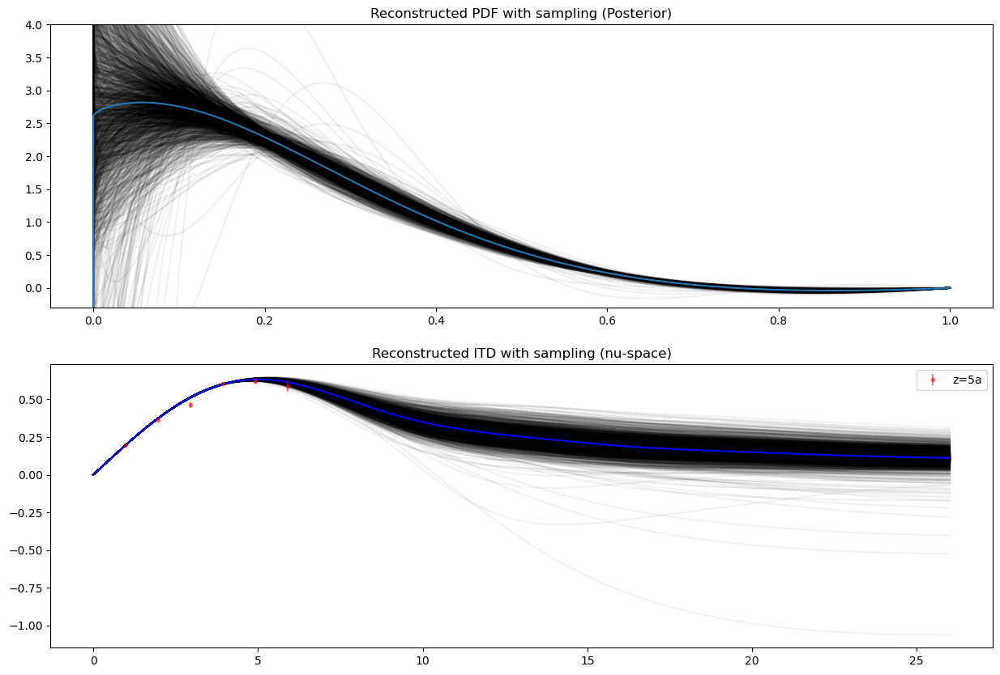

...

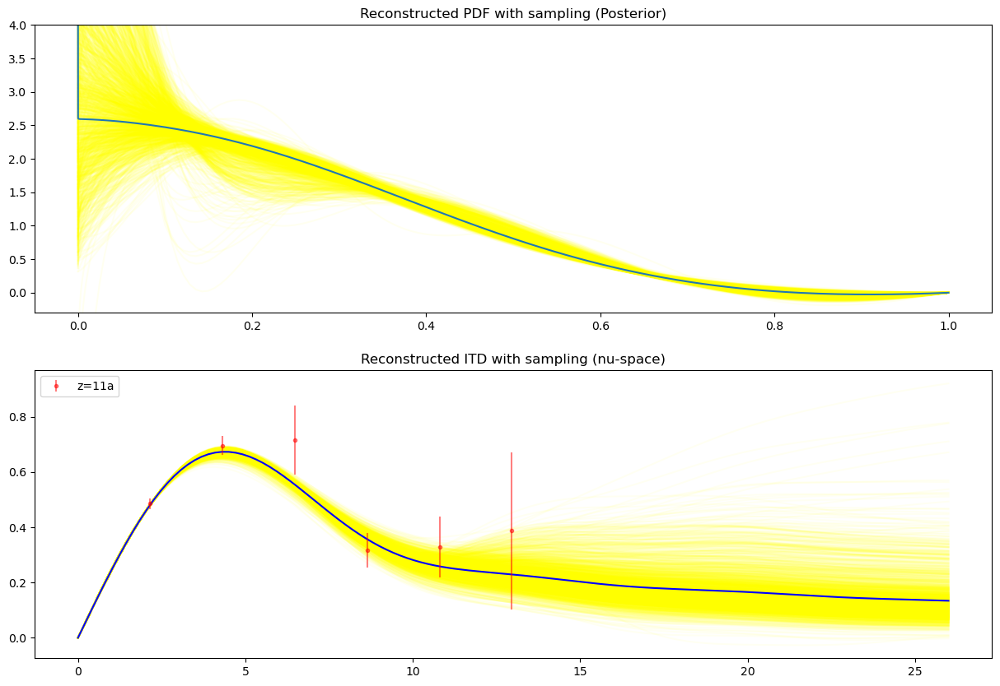

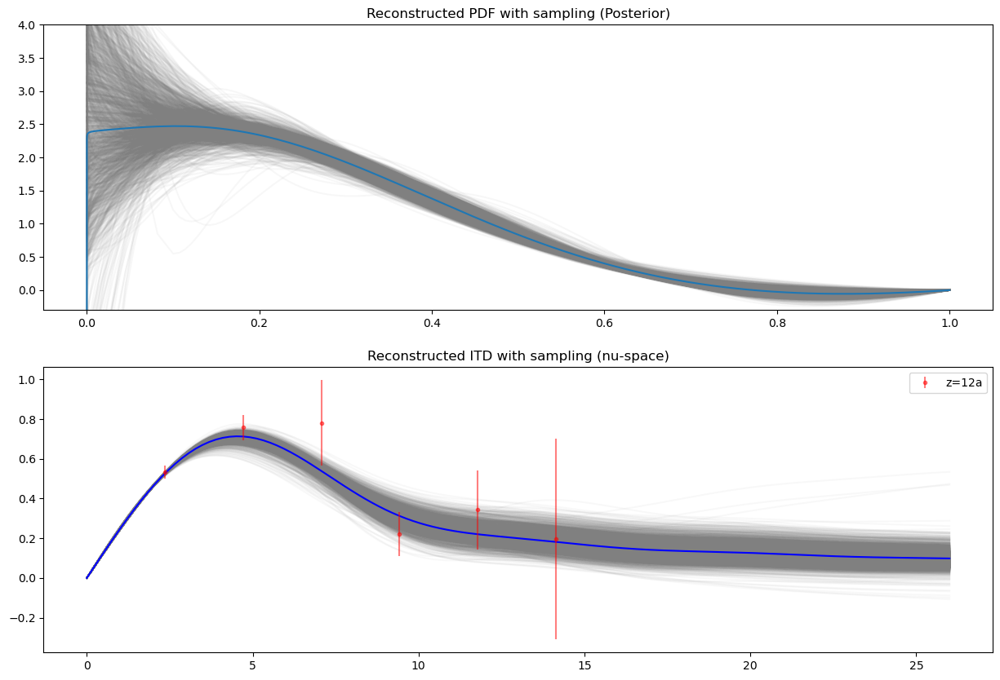

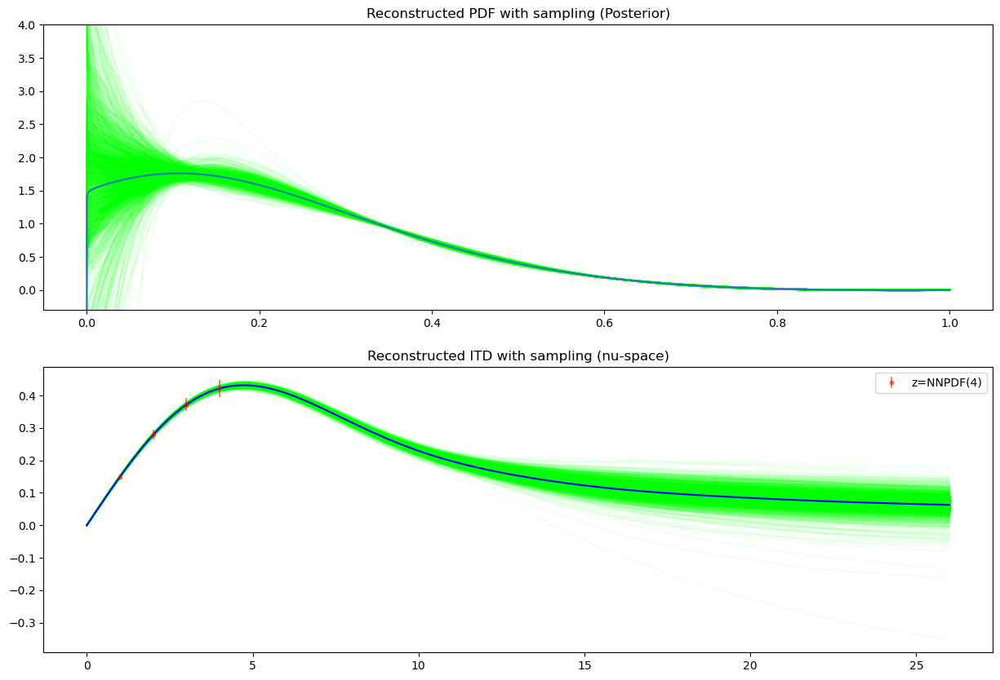

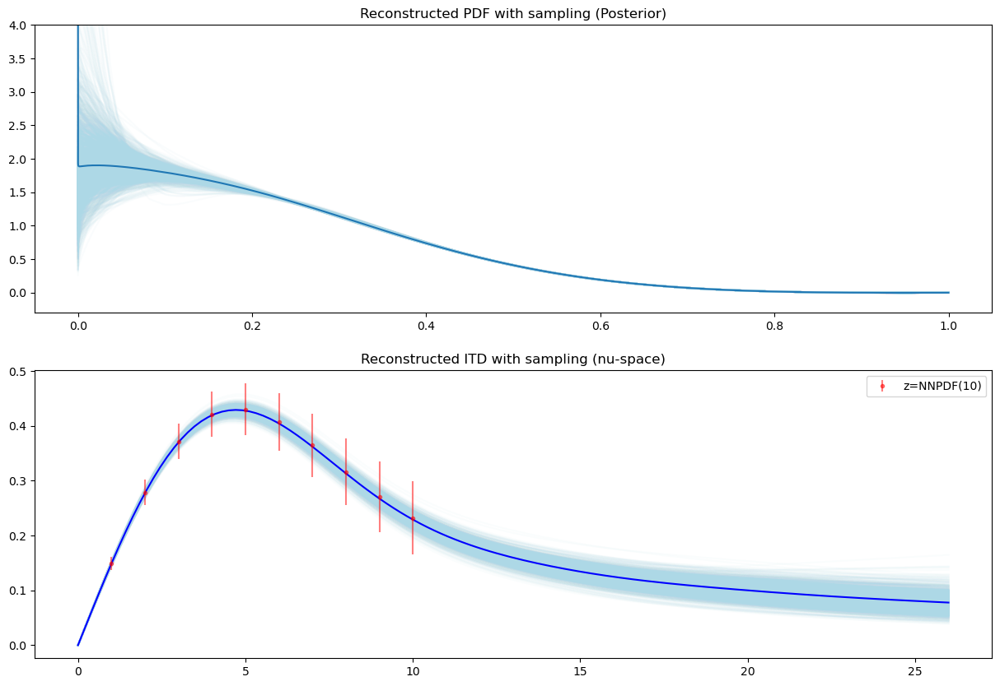

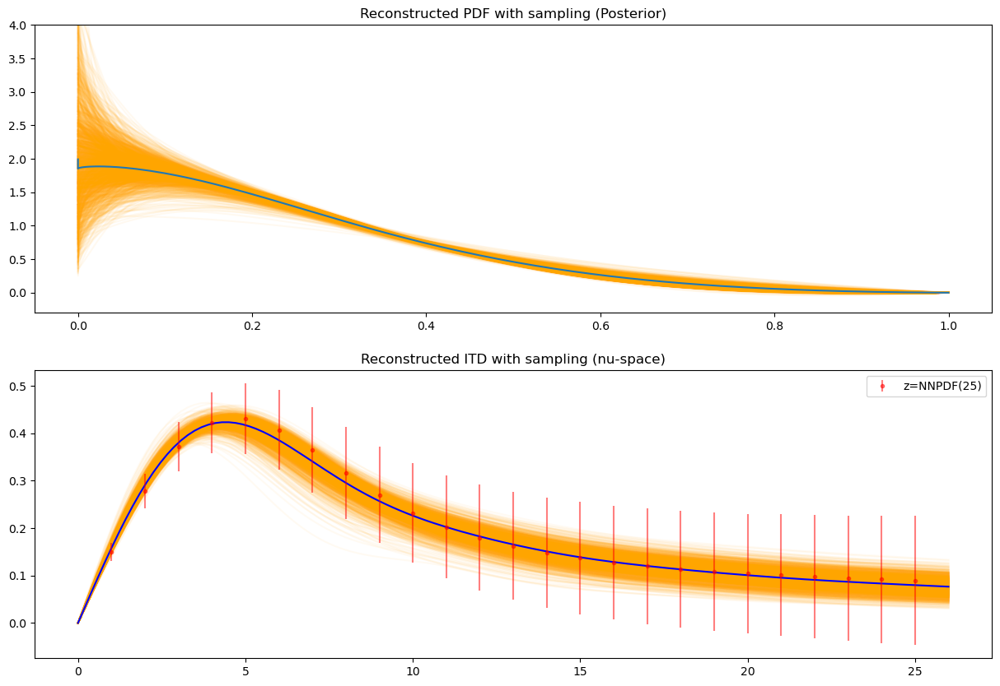

In [11]:
for i in range(0,number):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    #qofx,cov,pms,Qofv,covnu,Qvs=fits_comb[i].Uncertaintyanalysis(traceq[0:10000])
    #=fits_comb[i].Uncertaintyanalysis(traceq[0:10000])
    covs[i] = 0.5*(covs[i]+covs[i].T) #+1e-5*tr.eye(cov.shape[0])
    #pms=tr.stack(pms)
    ttQ = samplesqx[i]@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
    for j in range(len(samplesqx[i])):
        ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])


    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i >=12 and test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        if i==12:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
        elif i==13:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
        elif i==14:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
        nu_d_grid = datanu.T[1]
        M=datanu.T[2:].mean(axis=0)
        eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
        plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    if i<12:
        plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    plt.legend()
    plt.show()

### Save data files

In [138]:
#save xgrid values, qofx, qsig, qerror, Qnu, Qsig
i=6
qofx=samplesqx[i].mean(axis=0)
qsig=1.96*np.diag(np.cov(samplesqx[i].T))**(0.5)
qerror=1.96*np.diag(covs[i])**(0.5)
mttQ = Qnu[i].mean(axis=0)
Qsig= 1.97*np.diag(np.cov(Qnu[i].T))**0.5
#stack everything with numpy
qofx=qofx.numpy()
mttQ=mttQ.numpy()

allarrays= np.row_stack([x_gri0,qofx,qsig,qerror])

np.savetxt("pdf(z=7).txt",allarrays.T,fmt='%.16f')


In [142]:
i=6
mttQ = Qnu[i].mean(axis=0)
Qsig= 1.97*np.diag(np.cov(Qnu[i].T))**0.5
allarrays= np.row_stack([nn,mttQ,Qsig])

np.savetxt("itd(z=7).txt",allarrays.T,fmt='%.16f')

Correlation Coefficients z=1a done


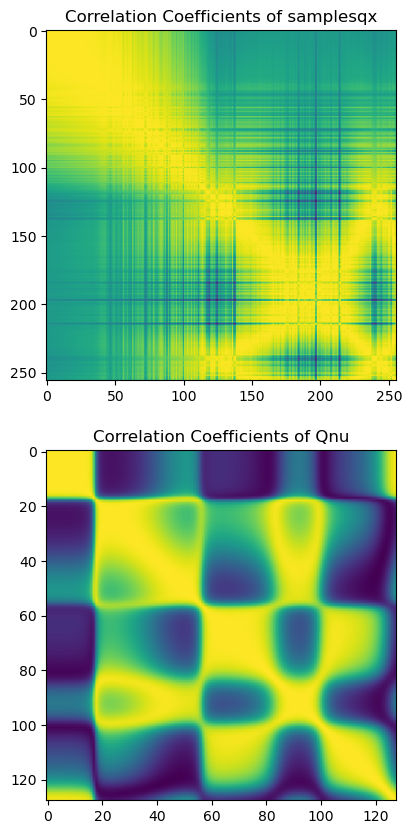

Correlation Coefficients z=2a done


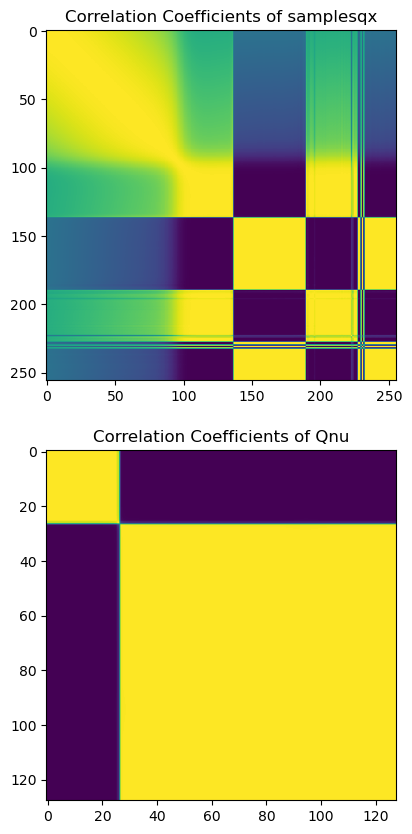

Correlation Coefficients z=3a done


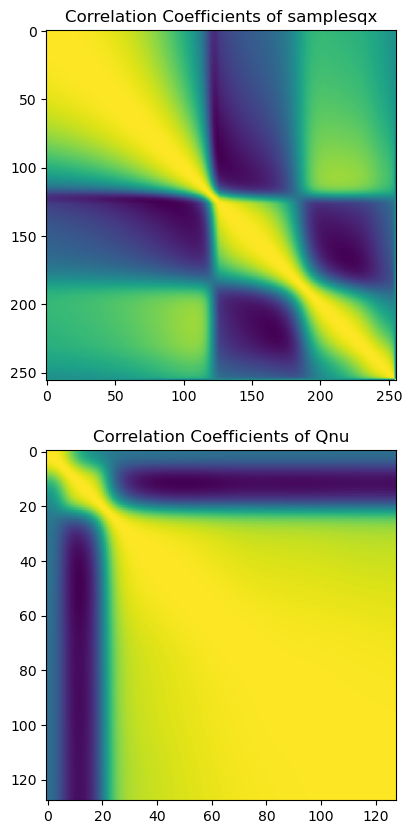

Correlation Coefficients z=4a done


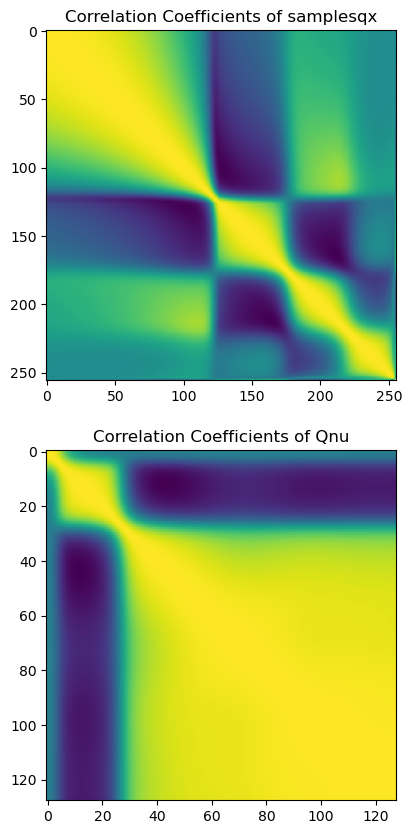

Correlation Coefficients z=5a done


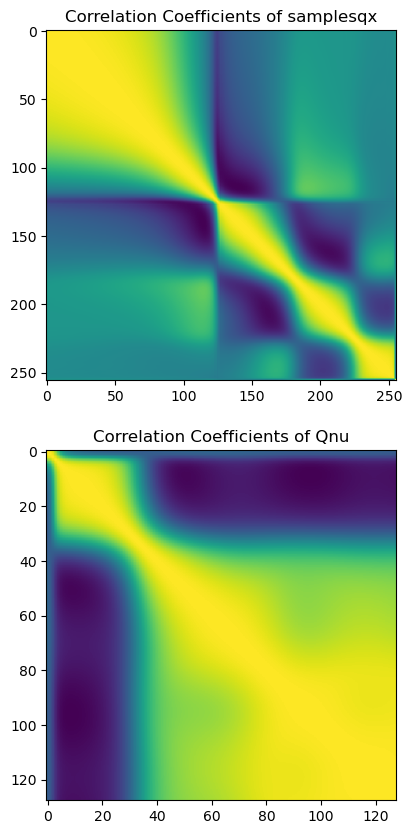

Correlation Coefficients z=6a done


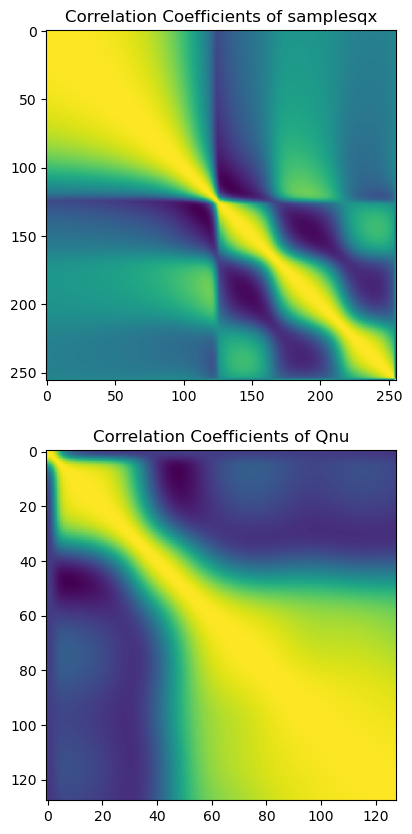

Correlation Coefficients z=7a done


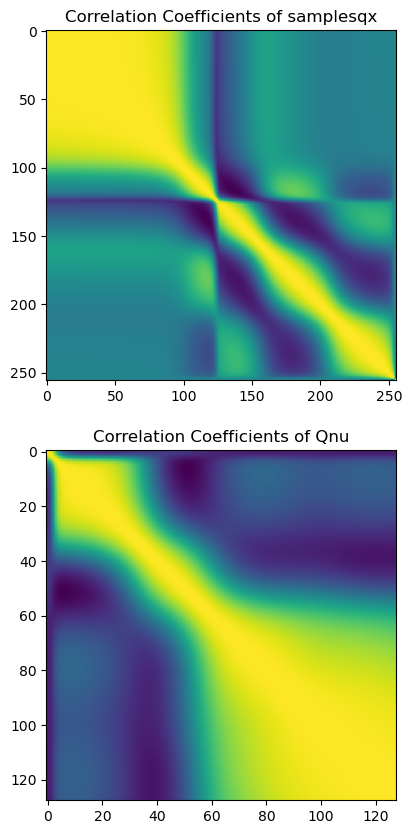

Correlation Coefficients z=8a done


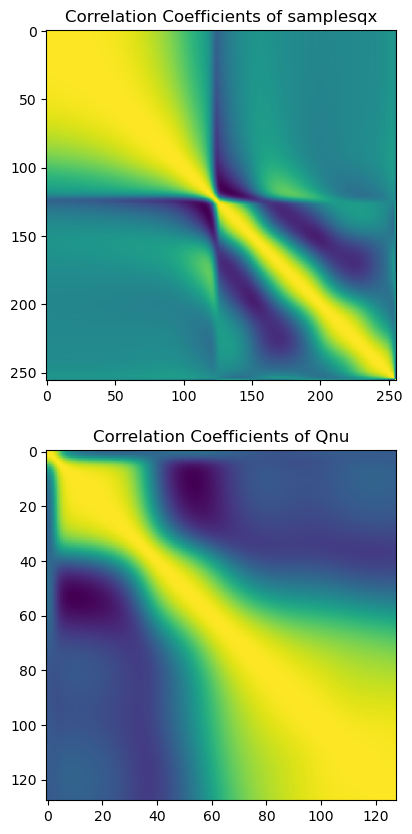

Correlation Coefficients z=9a done


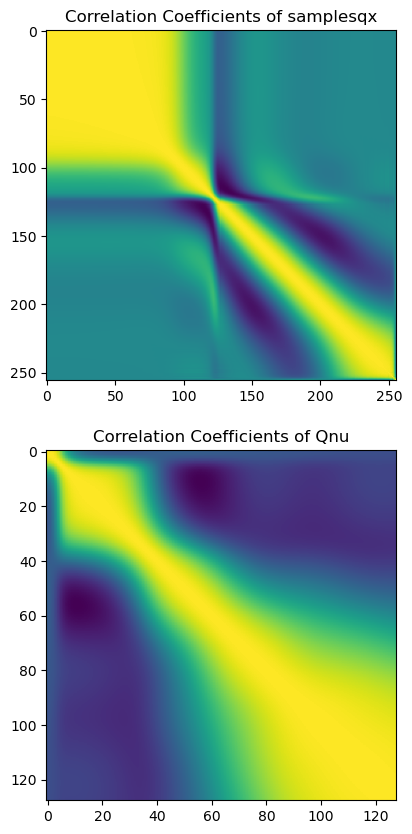

Correlation Coefficients z=10a done


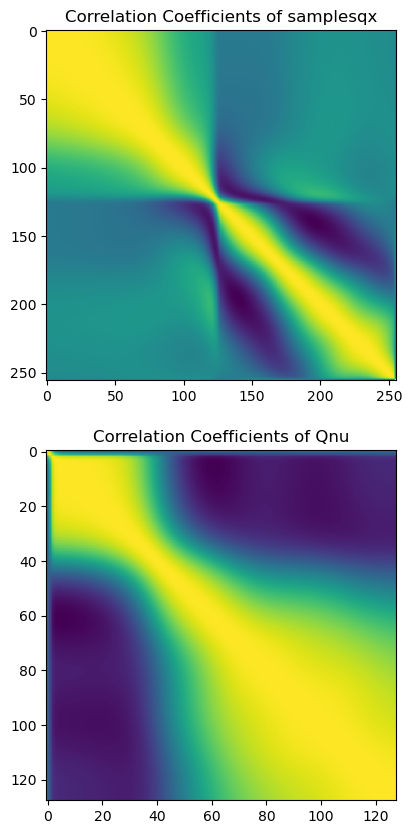

Correlation Coefficients z=11a done


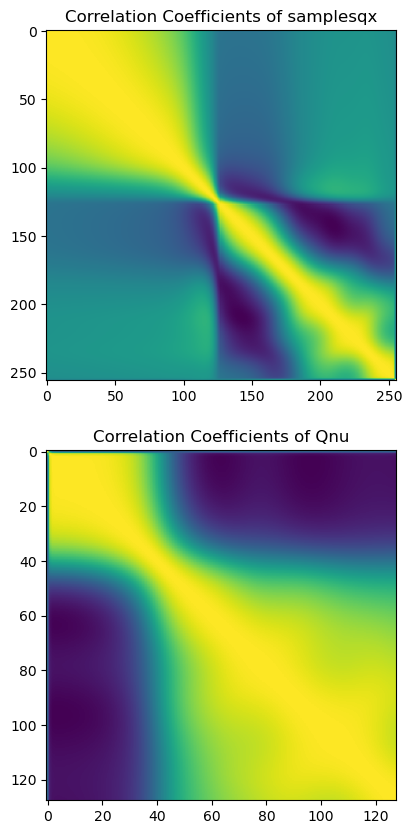

Correlation Coefficients z=12a done


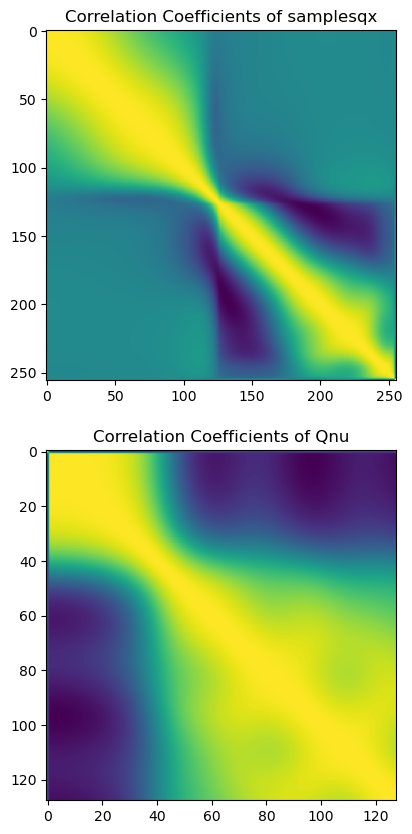

Correlation Coefficients z=mock done


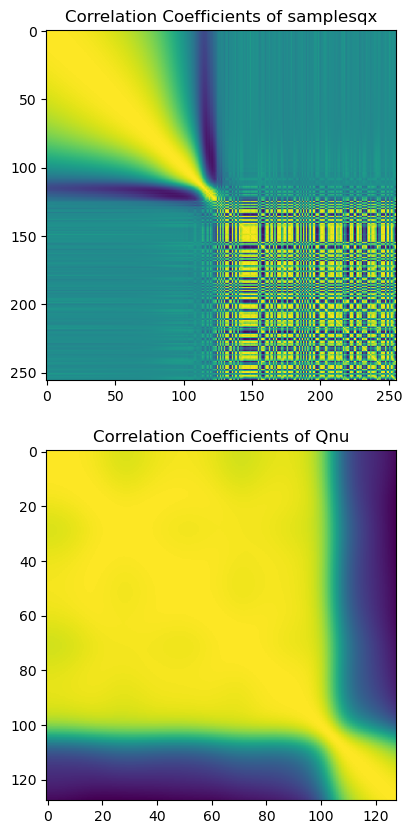

In [ ]:
#correlation coefficients of samplesqx and Qnus
covsqx=[]
covsnu=[]
for i in range(0,13):
    covsqx.append(np.corrcoef(samplesqx[i].T))
    covsnu.append(np.corrcoef(Qnu[i].T))
    print("Correlation Coefficients",fits_comb[i].name,"done")
    #plot correlation coefficients
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Correlation Coefficients of samplesqx")
    ax[1].set_title("Correlation Coefficients of Qnu")
    ax[0].imshow(covsqx[i])
    ax[1].imshow(covsnu[i])
    #bar plot
    plt.show()

In [36]:
#identify position of inf and nan in cov
def find_inf_nan(cov):

    nanidx = tr.isnan(cov)
    infidx = tr.isinf(cov)
    nanidx = nanidx.nonzero()
    infidx = infidx.nonzero()
    print("nanidx",nanidx)
    print("infidx",infidx)
    return nanidx,infidx

for i in range(0,13):
    find_inf_nan(tr.tensor(covsnu[i]))
    find_inf_nan(tr.tensor(covsqx[i]))
    find_inf_nan(tr.tensor(covs[i]))
    print("Identify inf and nan",fits_comb[i].name,"done")

nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
Identify inf and nan z=1a done
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([[  0,  90],
        [  0,  91],
        [  0,  92],
        ...,
        [255,  87],
        [255,  88],
        [255,  89]])
infidx tensor([[  0,   0],
        [  0,   1],
        [  0,   2],
        ...,
        [254,  87],
        [254,  88],
        [254,  89]])
Identify inf and nan z=2a done
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx

/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1191714627.py:15: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  find_inf_nan(tr.tensor(covs[i]))


/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:10: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  pdfMc= np.random.multivariate_normal(p,Cp,(100,))
/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:15: RuntimeWarning: invalid value encountered in sqrt
  perror=1.96*np.diag(Cp)**(0.5)


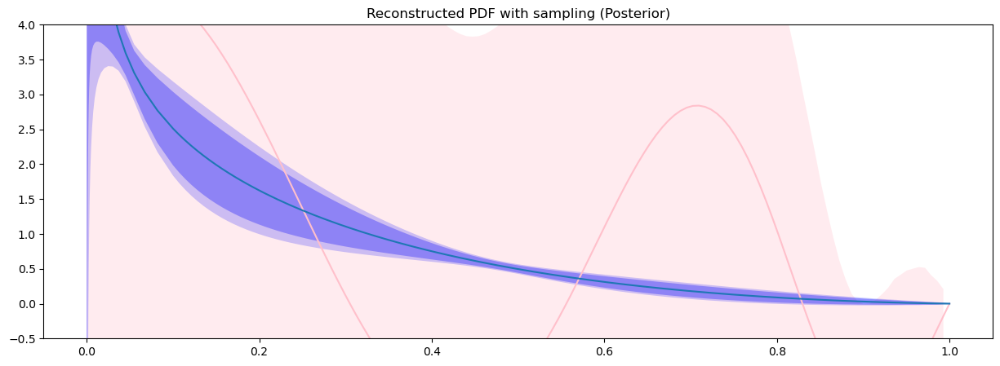

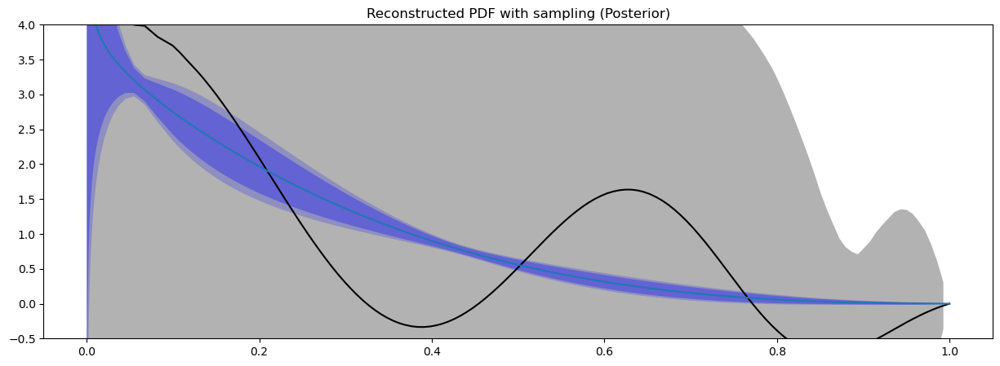

/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:18: RuntimeWarning: invalid value encountered in sqrt
  qerror=1.96*np.diag(cov)**(0.5)
/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:21: RuntimeWarning: invalid value encountered in sqrt
  qerror=2.51*np.diag(cov)**(0.5)


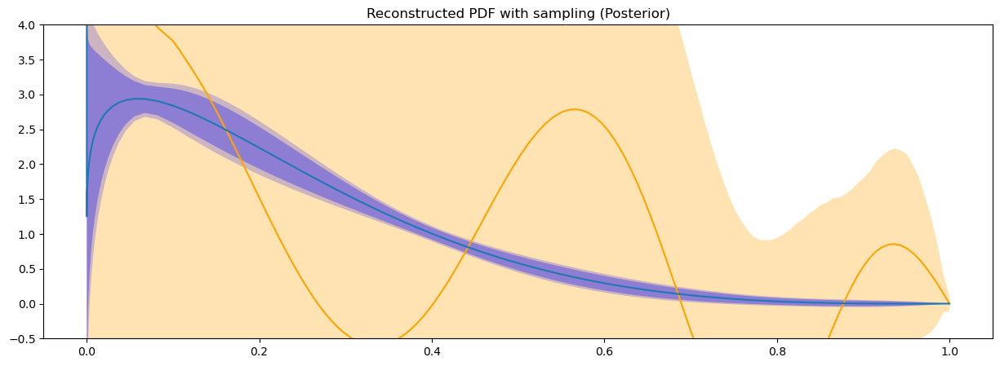

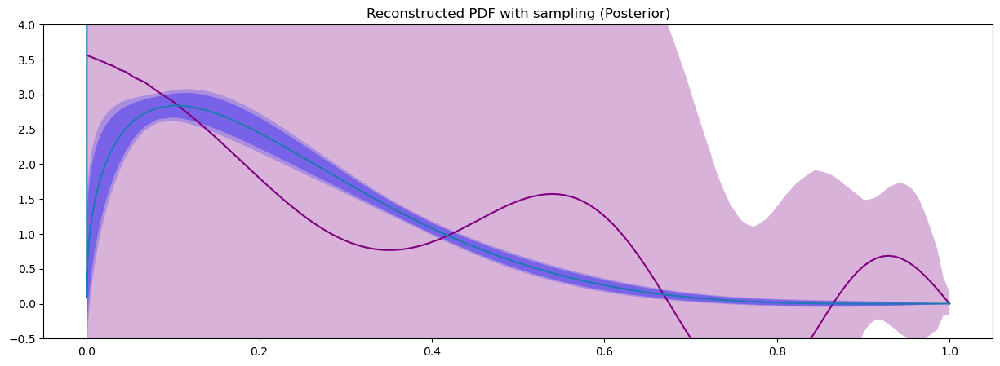

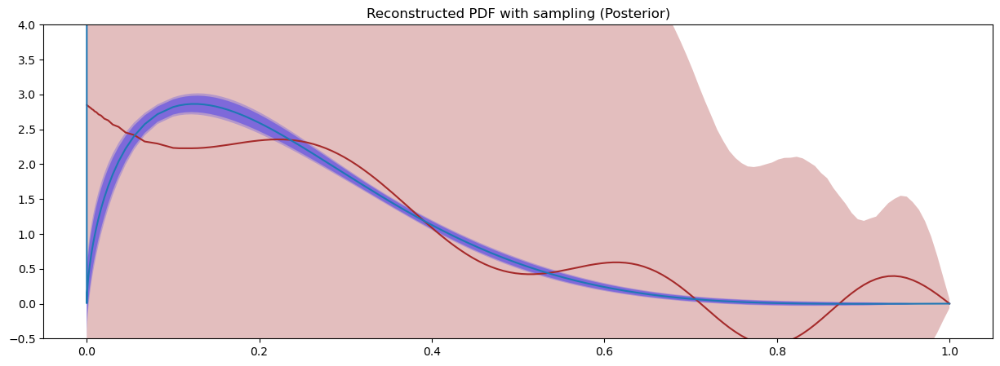

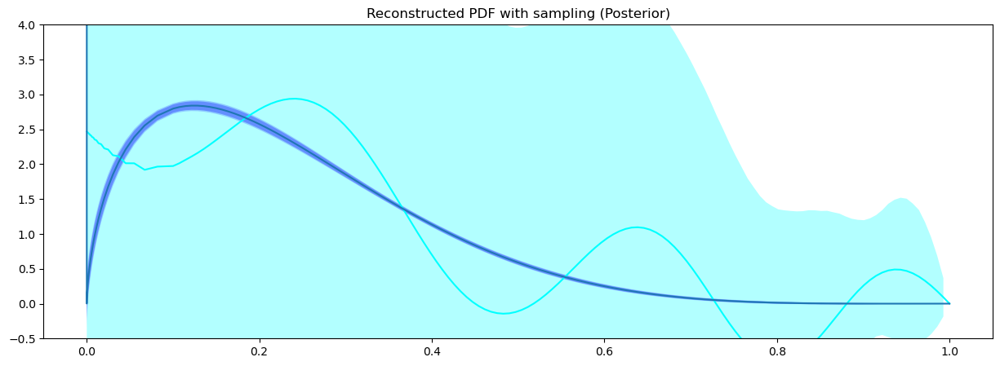

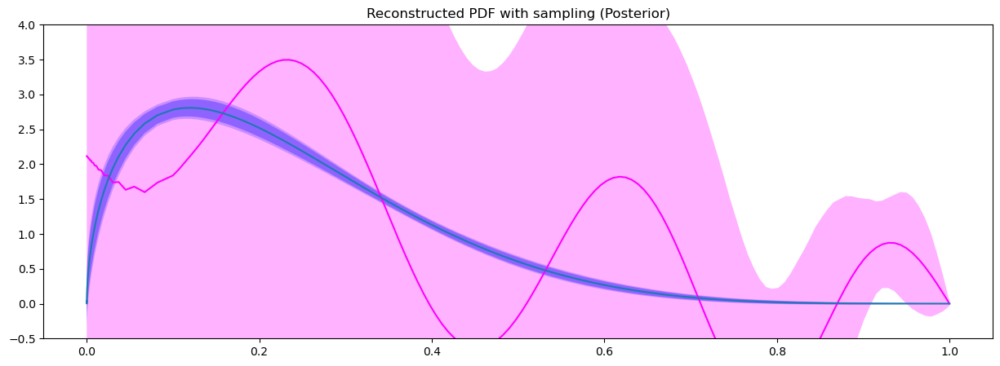

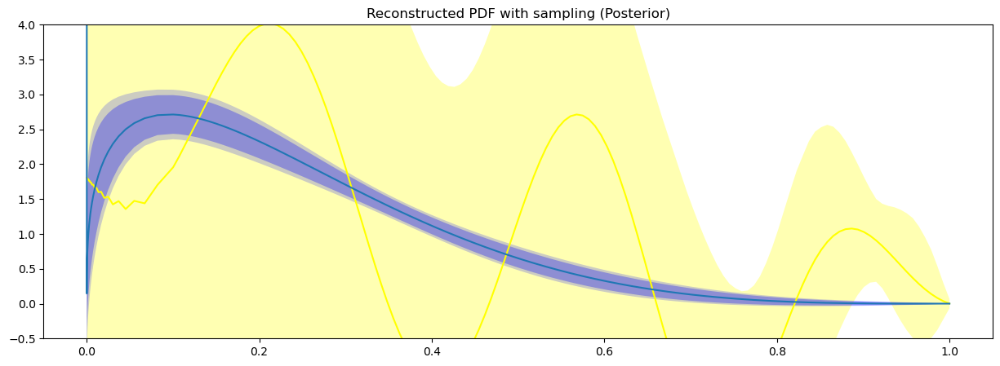

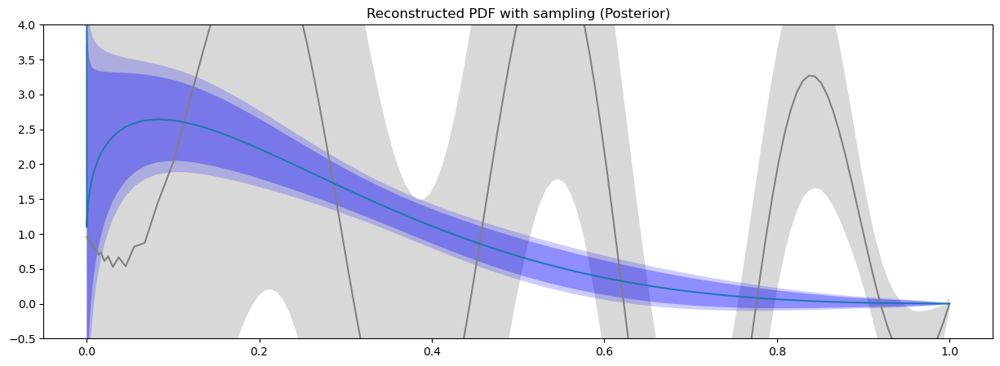

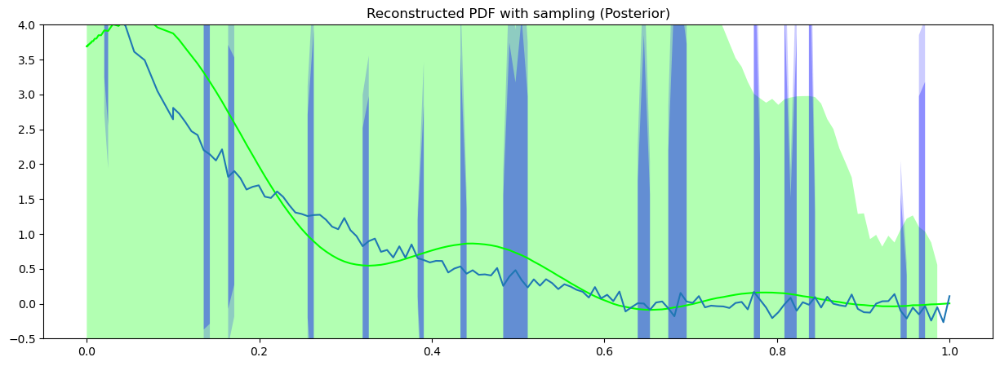

In [13]:
for i in range(3,13):
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    fig, ax= plt.subplots(1,figsize=(15, 5))
    ax.set_title("Reconstructed PDF with sampling (Posterior)")
    #ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    p,Cp = fits_comb[i].ComputePosterior()
    p,Cp = p.to("cpu"),Cp.to("cpu")
    Cp = 0.5*(Cp+Cp.T) #+1e-8*tr.eye(Cp.shape[0])
    #Mc=tr.distributions.MultivariateNormal(p,covariance_matrix=Cp)
    #pdfMc= np.random.multivariate_normal(p,Cp,(100,))
    #plot the data
    #pdfMc = Mc.sample((100,))
    #ax[0].plot(x_grid,pdfMc.T,alpha=0.1,color=col[i])
    #ax.plot(x_grid,p,label='z='+str(i+1),color=col[i])
    #perror=1.96*np.diag(Cp)**(0.5)
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::10])
    plt.plot(myGP0.x_grid.cpu(),qofx.cpu())
    qerror=1.96*np.diag(cov)**(0.5)
    ax.fill_between(x_grid, p - perror, p + perror, facecolor=col[i], alpha=0.3)
    ax.fill_between(x_grid, qofx - qerror, qofx + qerror, facecolor='blue', alpha=0.3)
    qerror=2.51*np.diag(cov)**(0.5)
    ax.fill_between(x_grid, qofx - qerror, qofx + qerror, facecolor='blue', alpha=0.2)
    plt.ylim([-0.5,4])
    plt.show()
    #p=fits_comb[i].Pd(fits_comb[i].x_grid.cpu(),*fits_comb[i].pd_args).numpy()

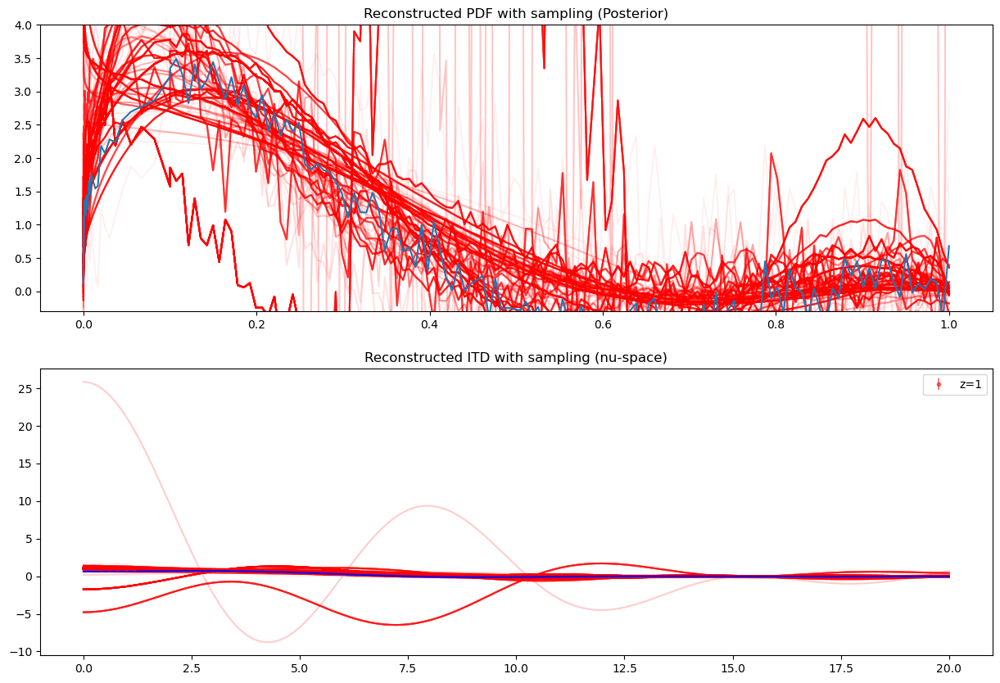

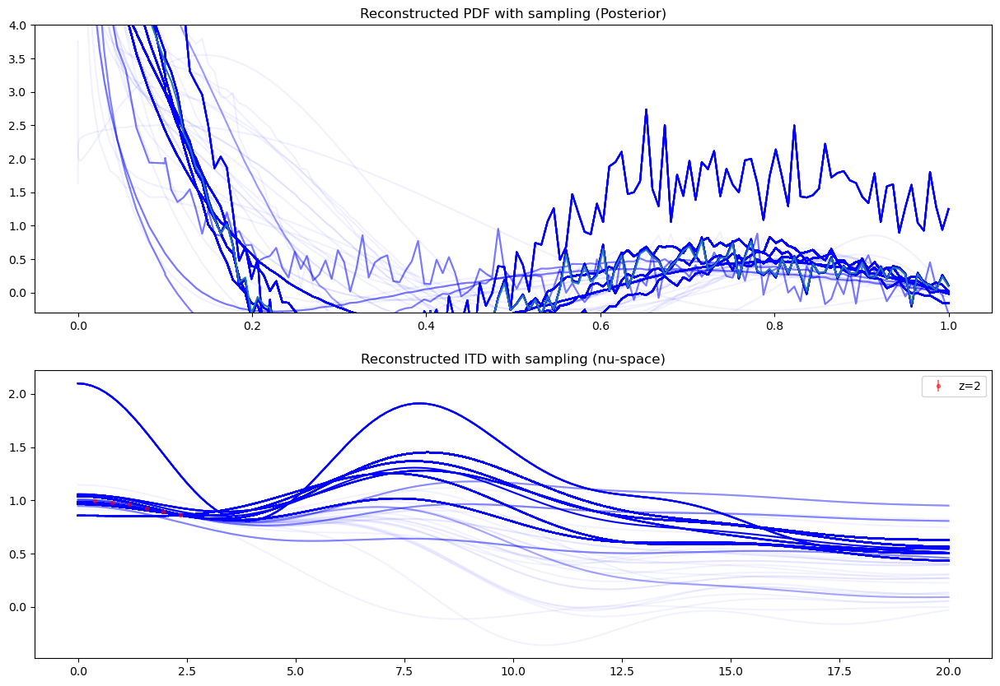

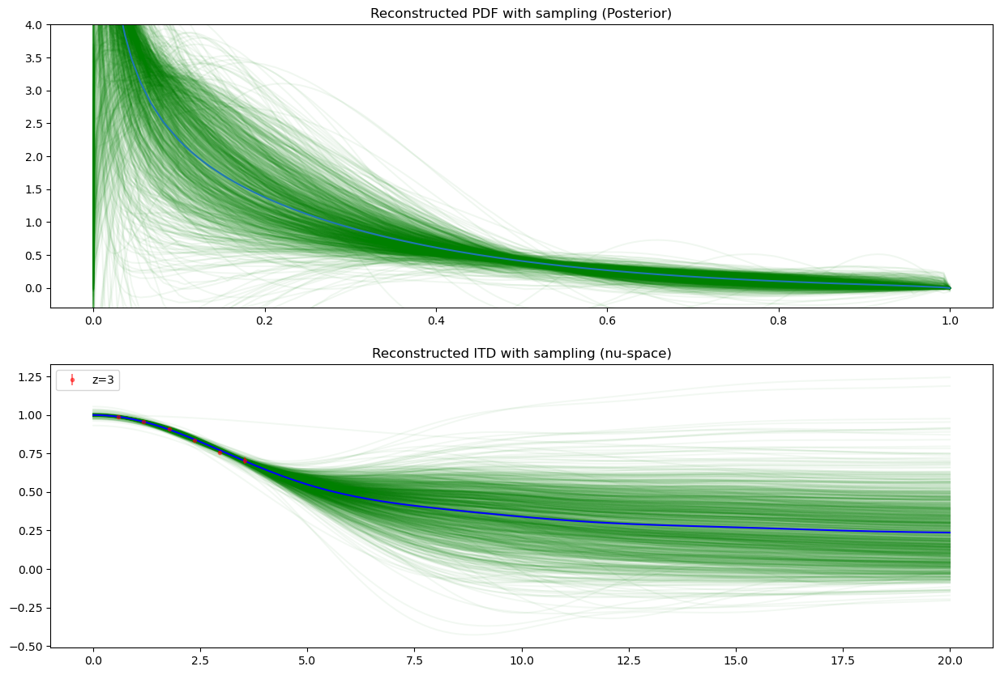

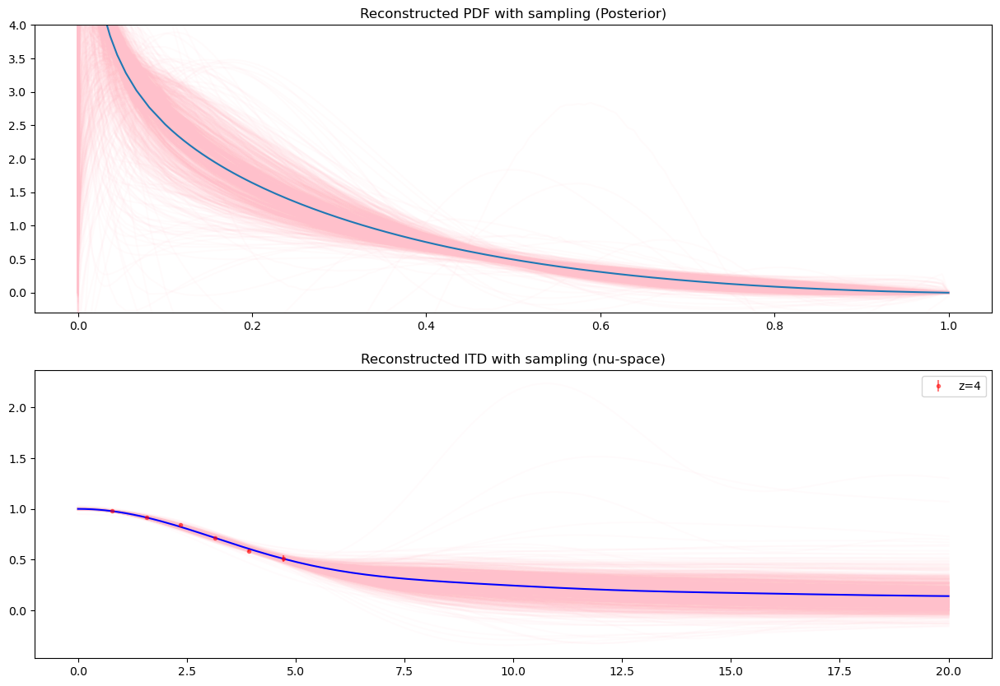

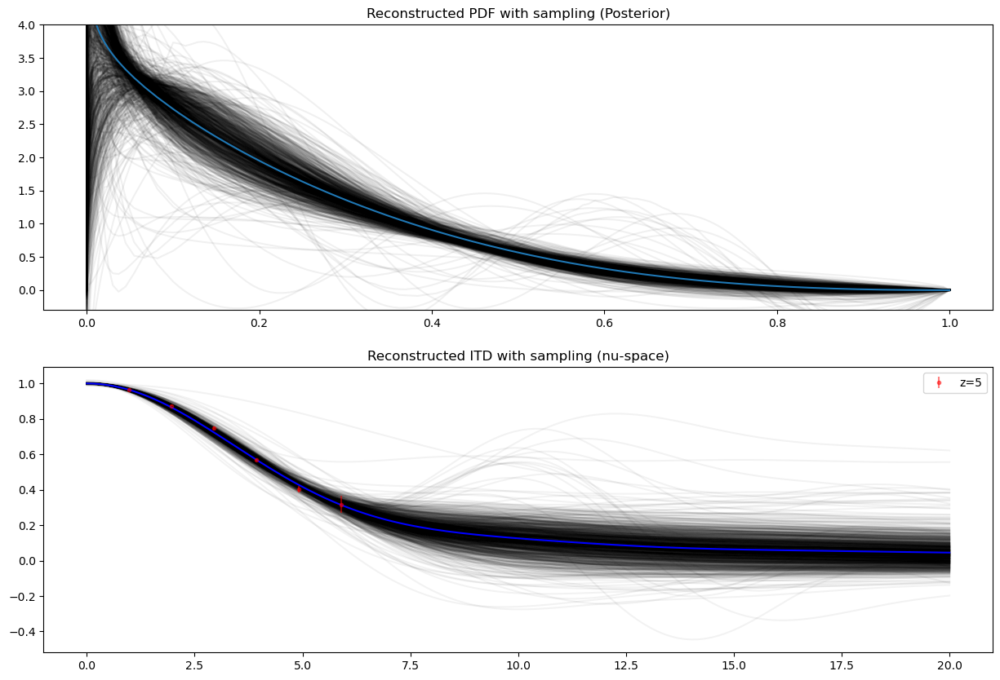

...

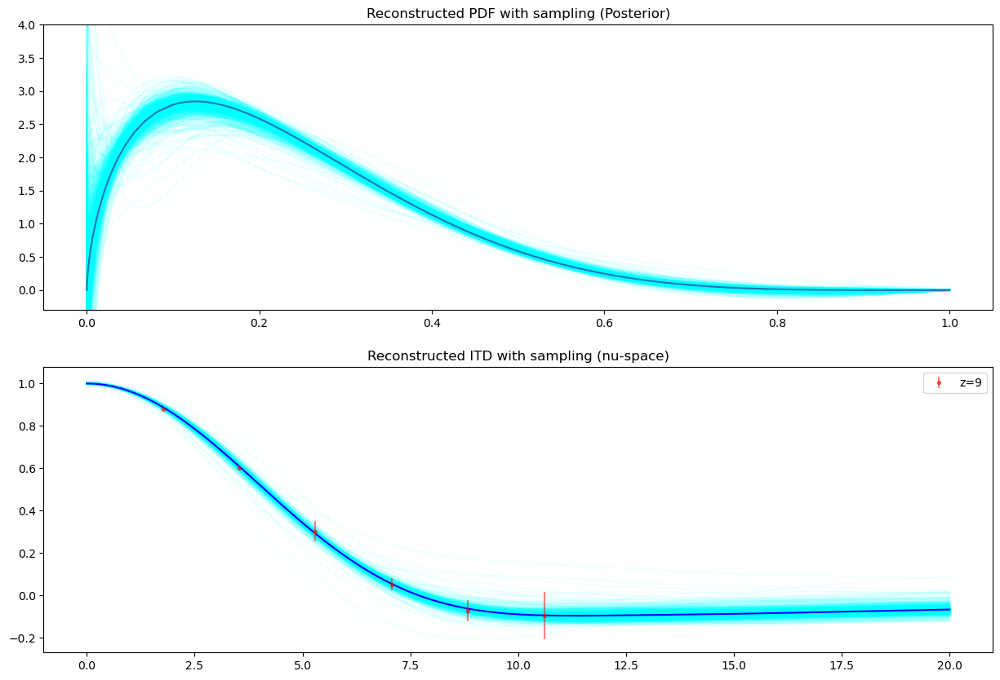

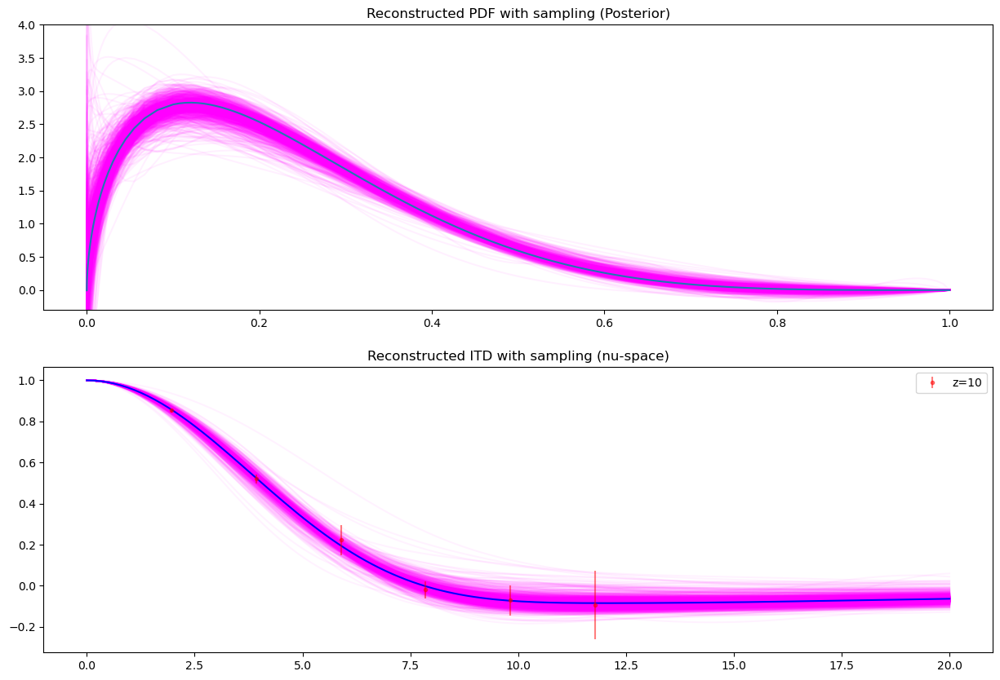

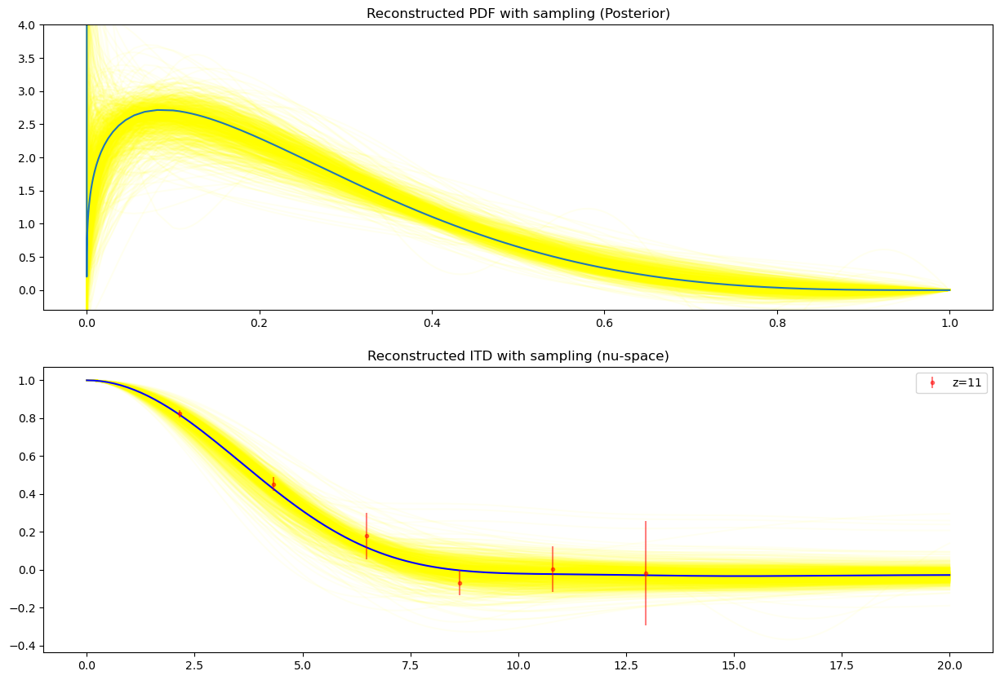

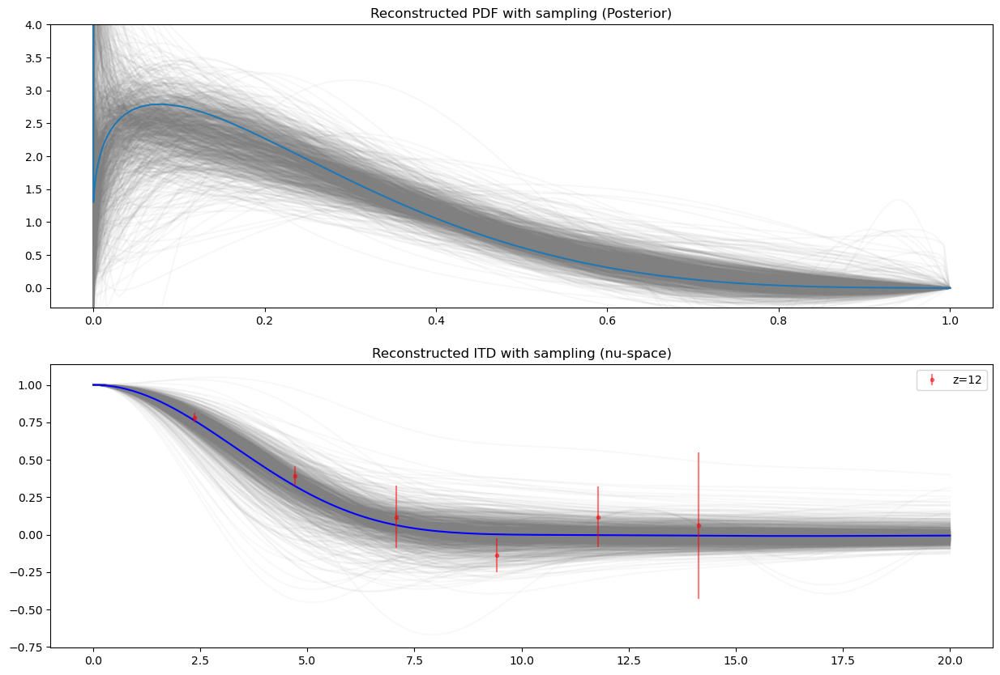

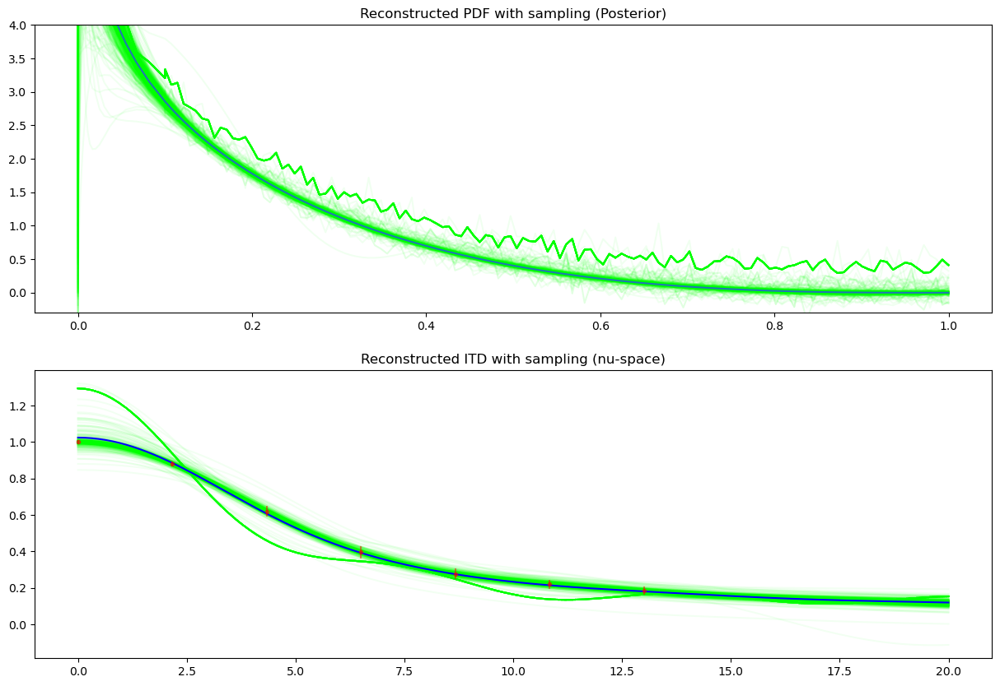

In [6]:
for i in range(0,13):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::100])
    cov = 0.5*(cov+cov.T) +1e-5*tr.eye(cov.shape[0])
    pms=tr.stack(pms)
    nn = np.linspace(0,20,128)
    iB = np.zeros((nn.shape[0],Nx))
    fe=FE2_Integrator(x_grid)
    for k in range(nn.shape[0]):
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    ttQ = pms@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    for j in range(len(pms)):
        ax[0].plot(x_gri0,pms[j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofx,label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])

    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i==12:
        numock = np.linspace(0,13,7)
        jM = pseudo_data(numock,-0.3,2.9,1.0,0.02,.2,0.2,1000)
        M = np.mean(jM,axis=0)
        eM = np.std(jM,axis=0)
        
        plt.errorbar(numock,M,eM,fmt='.',alpha=0.5,label='mock data',color='red')
        break
    plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color='red')
    plt.legend()
    plt.show()

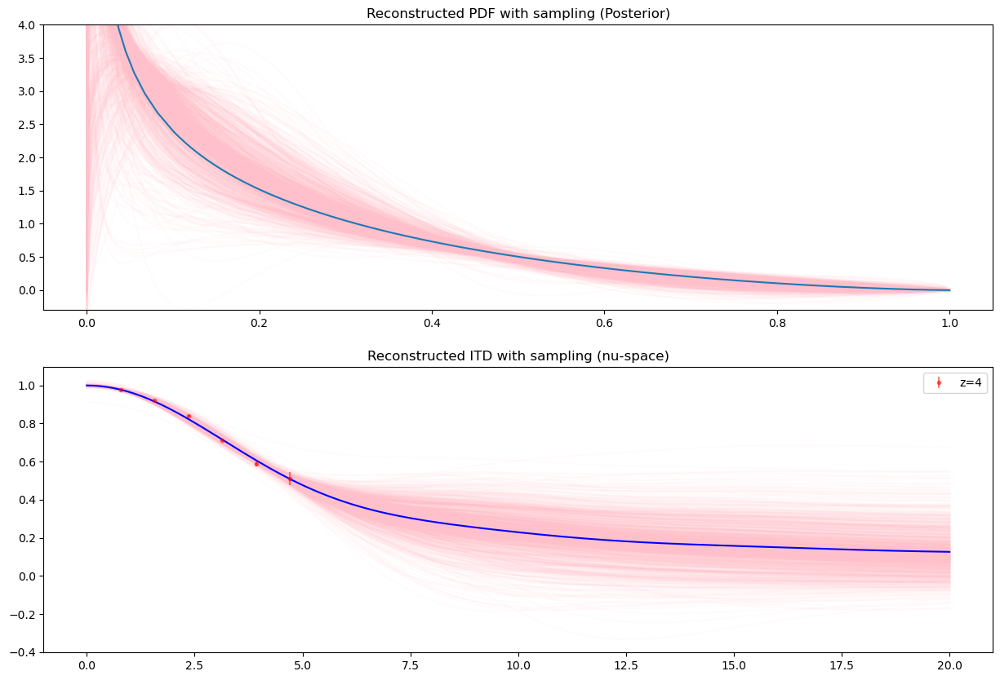

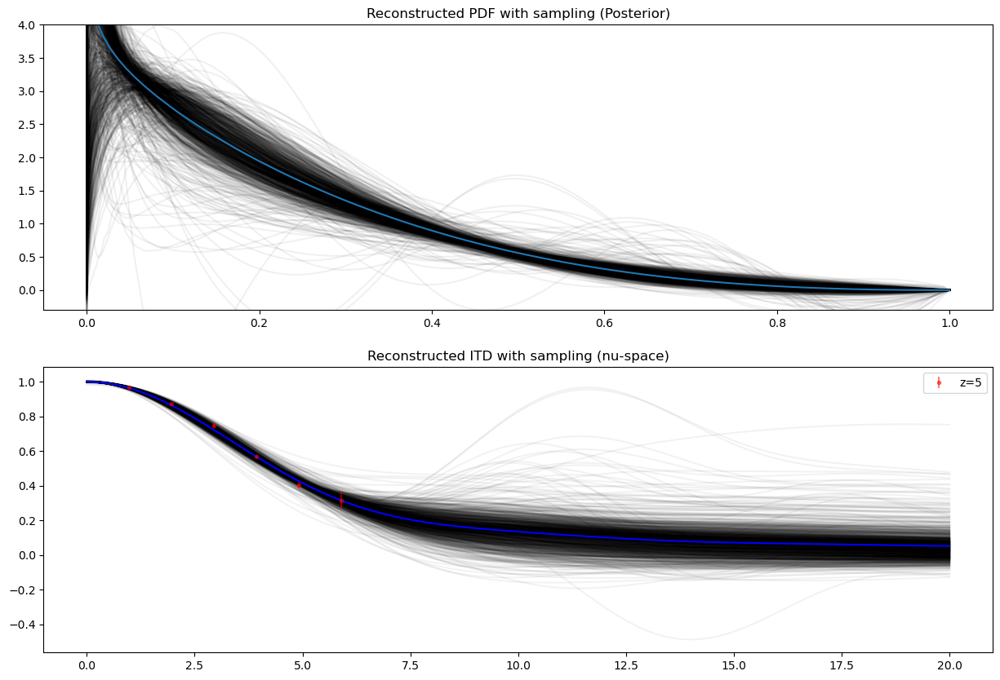

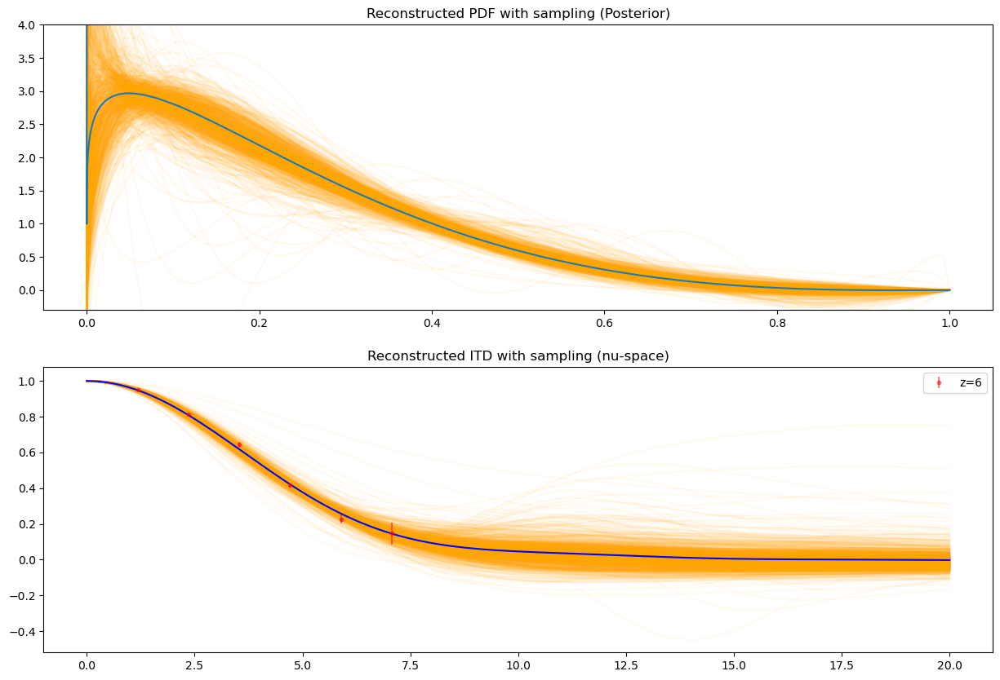

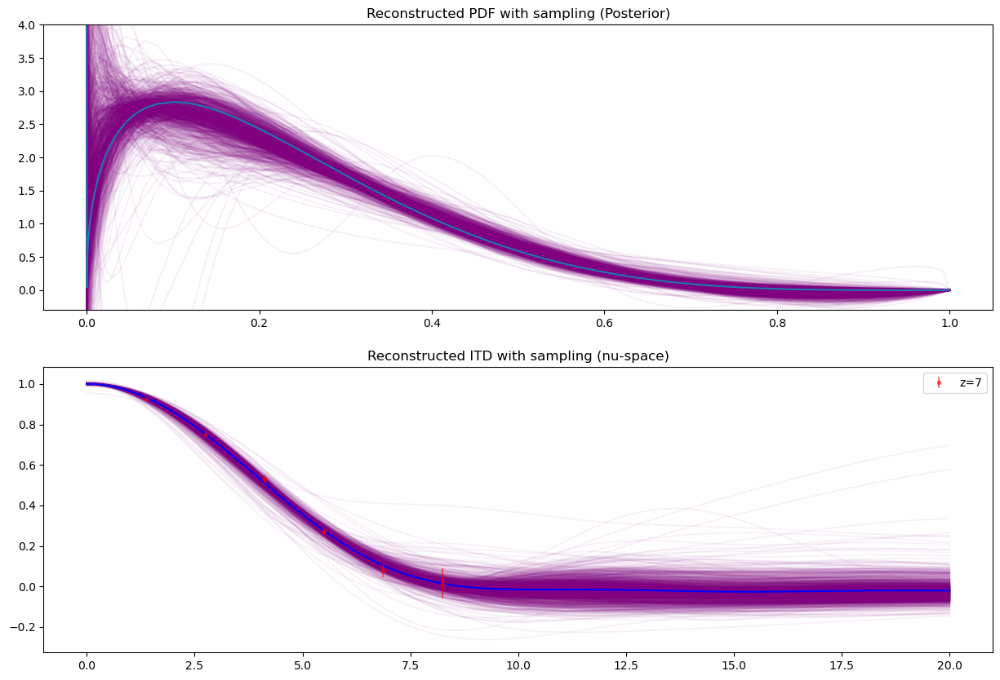

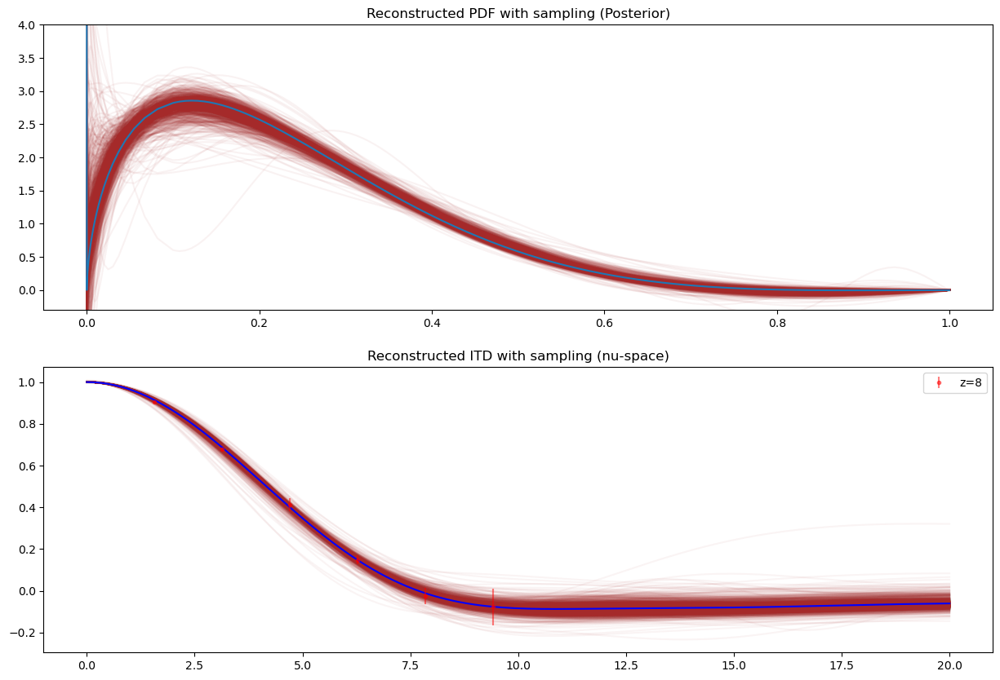

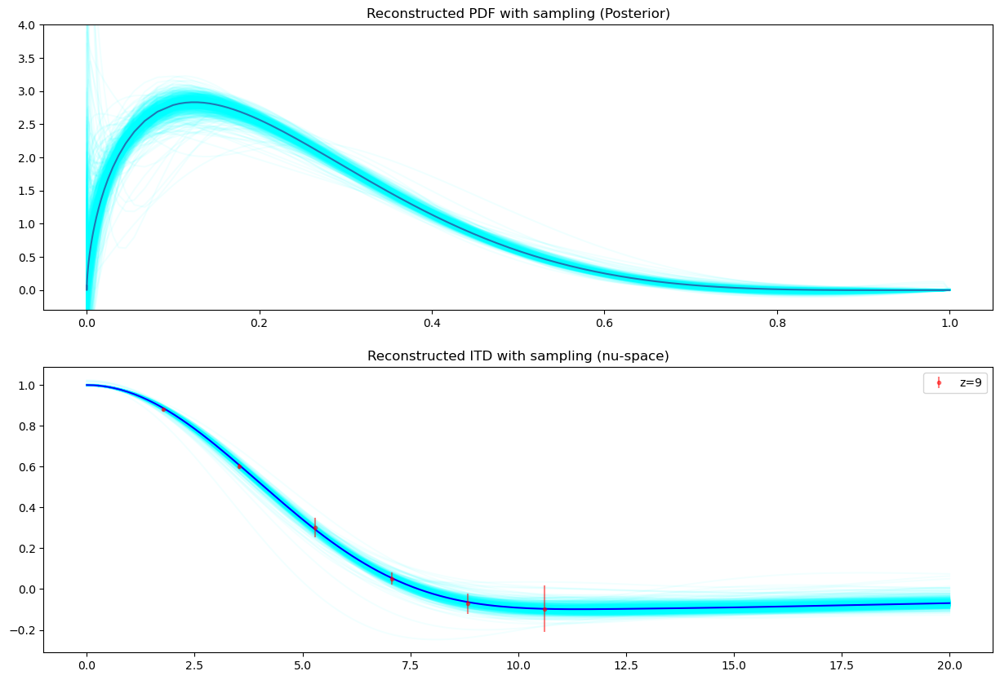

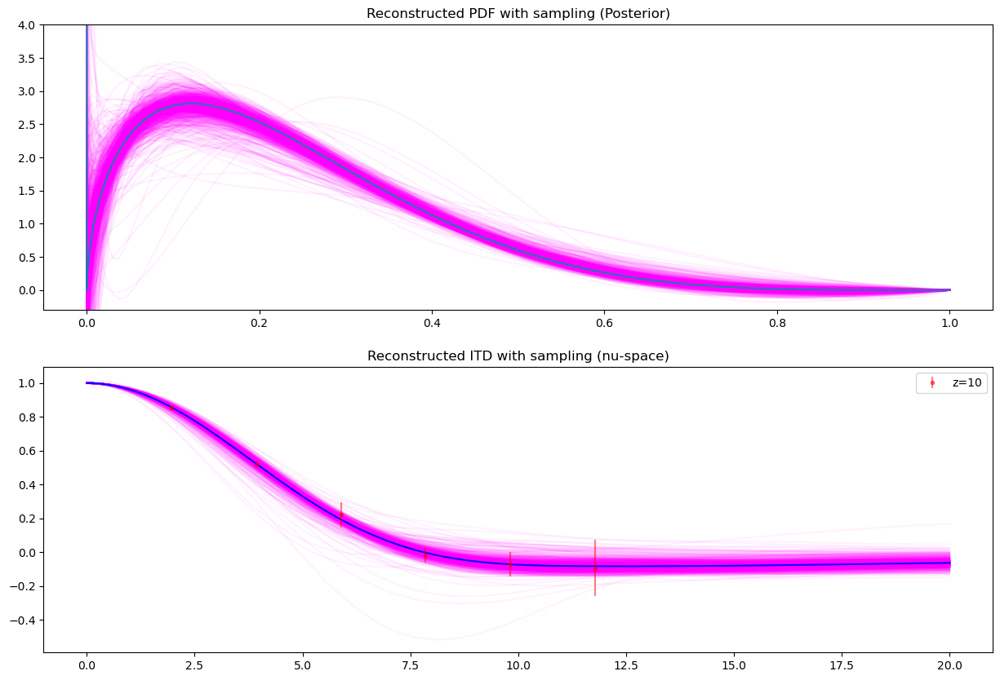

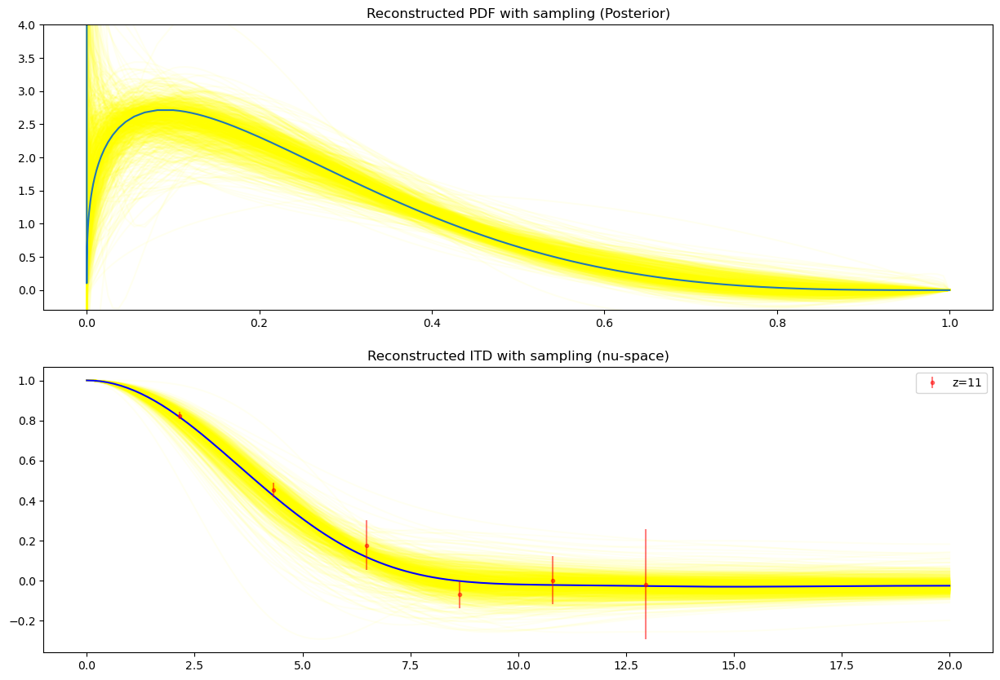

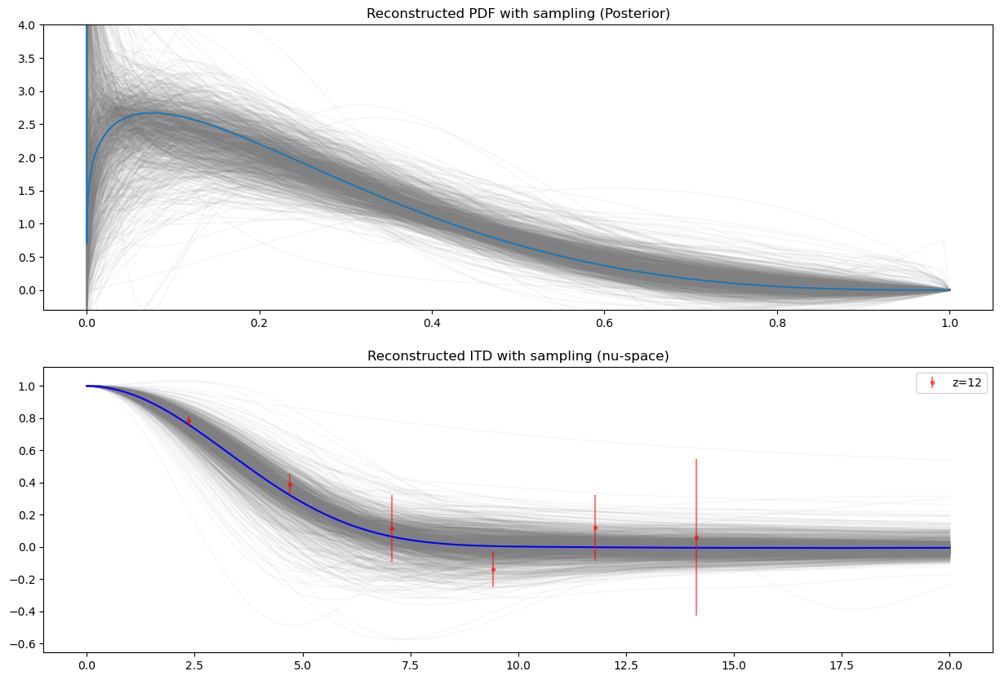

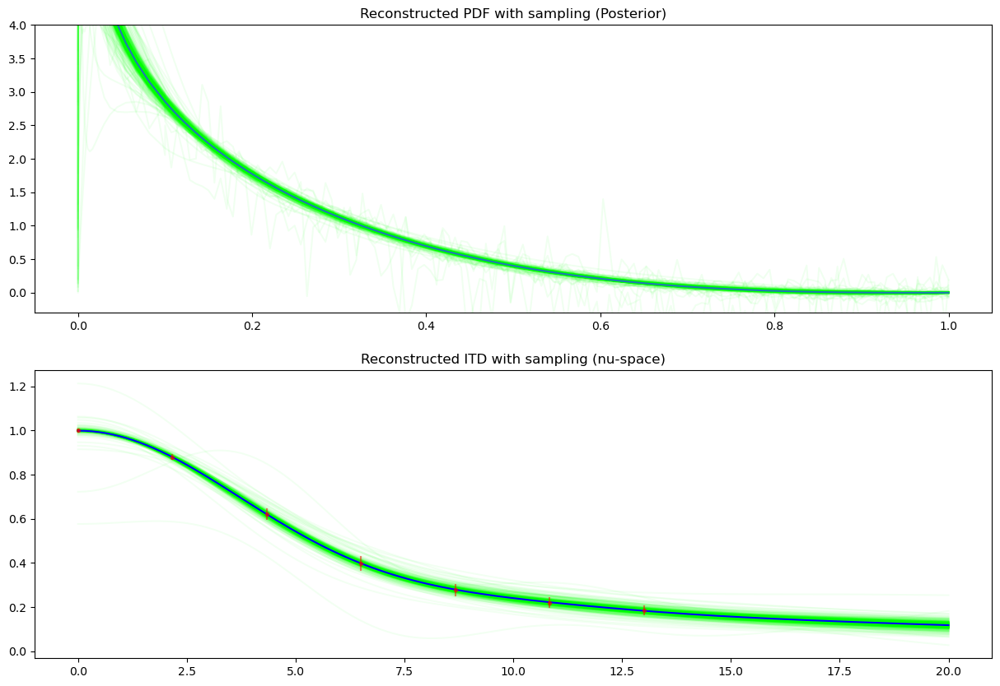

In [104]:
for i in range(3,13):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::100])
    cov = 0.5*(cov+cov.T) +1e-5*tr.eye(cov.shape[0])
    pms=tr.stack(pms)
    nn = np.linspace(0,20,128)
    iB = np.zeros((nn.shape[0],Nx))
    fe=FE2_Integrator(x_grid)
    for k in range(nn.shape[0]):
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    ttQ = pms@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    for j in range(len(pms)):
        ax[0].plot(x_gri0,pms[j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofx,label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])

    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i==12:
        numock = np.linspace(0,13,7)
        jM = pseudo_data(numock,-0.3,2.9,1.0,0.02,.2,0.2,1000)
        M = np.mean(jM,axis=0)
        eM = np.std(jM,axis=0)
        
        plt.errorbar(numock,M,eM,fmt='.',alpha=0.5,label='mock data',color='red')
        break
    plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color='red')
    plt.legend()
    plt.show()

This plots were generated with a nugget term. 

# Compare results 

In [10]:
# Función para procesar un archivo .dat y convertirlo a tensor
def dat_to_tensor(file_path):
    try:
        # Leer el archivo .dat en un arreglo de numpy
        data_array = np.loadtxt(file_path)
        # Convertir a tensor de PyTorch
        data_tensor = tr.tensor(data_array, dtype=tr.float32)
        return data_tensor
    except Exception as e:
        print(f"Error al procesar el archivo {file_path}: {e}")
        return None

# Función para agrupar archivos según patrones (por ejemplo, 'real', 'imag', 'z3', etc.)
def group_files_by_pattern(files, patterns):
    grouped_files = {pattern: [] for pattern in patterns}
    for file in files:
        for pattern in patterns:
            if re.search(pattern, file):
                grouped_files[pattern].append(file)
    return grouped_files

In [ ]:
import os
import re

# Ruta de la carpeta que contiene los archivos .dat
folder_path = "/sciclone/pscr/yacahuanamedra/results_z369"  # Cambia esto a tu carpeta

# Listar todos los archivos .dat en la carpeta
all_files = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Definir patrones para agrupar archivos (por ejemplo, 'real', 'imag', 'z3', 'z6', etc.)
patterns = ['real', 'imag', 'z3', 'z6', 'z9']

# Agrupar archivos por patrones
grouped_files = group_files_by_pattern(all_files, patterns)

# Procesar cada grupo de archivos y convertirlos a tensores
for pattern, files in grouped_files.items():
    print(f"Procesando archivos para el patrón: {pattern}")
    for file in files:
        file_path = os.path.join(folder_path, file)
        tensor = dat_to_tensor(file_path)
        if tensor is not None:
            # Imprimir la forma del tensor y su nombre
            print(f"Archivo: {file} -> Tensor shape: {tensor.shape}")
            # Opcional: Guardar el tensor si es necesario
            tensor_save_path = os.path.join(folder_path, f"{file}.pt")
            tr.save(tensor, tensor_save_path)
            print(f"Tensor guardado en: {tensor_save_path}")

Procesando archivos para el patrón: real
Archivo: grid_mean_M_real_z3.dat -> Tensor shape: torch.Size([50])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z3.dat.pt
Archivo: grid_mean_q_real_z3.dat -> Tensor shape: torch.Size([251])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z3.dat.pt
Archivo: hd_mean_q_real_z6.dat -> Tensor shape: torch.Size([100])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z6.dat.pt
Archivo: grid_error_q_real_z3.dat -> Tensor shape: torch.Size([251])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z3.dat.pt
Archivo: hd_mean_M_real_z6.dat -> Tensor shape: torch.Size([52])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z6.dat.pt
Archivo: grid_error_M_real_z3.dat -> Tensor shape: torch.Size([50])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z3.dat.pt
Archivo: hd_error_

In [11]:
jk_x_grid=dat_to_tensor("/sciclone/pscr/yacahuanamedra/results_z369/jk_x_grid.dat")
grid_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z6.dat.pt",weights_only=False)
grid_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z3.dat.pt",weights_only=False)
grid_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z6.dat.pt",weights_only=False)
grid_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z3.dat.pt",weights_only=False)
grid_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z3.dat.pt",weights_only=False)
grid_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z6.dat.pt",weights_only=False)
grid_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z3.dat.pt",weights_only=False)
grid_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z6.dat.pt",weights_only=False)
print("jk_x_grid",jk_x_grid.shape,"\ngrid_error_M_real_z6",grid_error_M_real_z6.shape,"\ngrid_error_M_real_z3",grid_error_M_real_z3.shape,"\ngrid_error_q_real_z6",grid_error_q_real_z6.shape,"\ngrid_error_q_real_z3",grid_error_q_real_z3.shape,"\ngrid_mean_q_real_z3",grid_mean_q_real_z3.shape,"\ngrid_mean_q_real_z6",grid_mean_q_real_z6.shape,"\ngrid_mean_M_real_z3",grid_mean_M_real_z3.shape,"\ngrid_mean_M_real_z6",grid_mean_M_real_z6.shape)
hd_error_M_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z3.dat.pt",weights_only=False)
hd_error_M_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z6.dat.pt",weights_only=False)
hd_error_M_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z9.dat.pt",weights_only=False)
print("hd_error_M_imag_z3",hd_error_M_imag_z3.shape,"\nhd_error_M_imag_z6",hd_error_M_imag_z6.shape,"\nhd_error_M_imag_z9",hd_error_M_imag_z9.shape)
hd_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z3.dat.pt",weights_only=False)
hd_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z6.dat.pt",weights_only=False)
hd_error_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z9.dat.pt",weights_only=False)
print("hd_error_M_real_z3",hd_error_M_real_z3.shape,"\nhd_error_M_real_z6",hd_error_M_real_z6.shape,"\nhd_error_M_real_z9",hd_error_M_real_z9.shape)
hd_error_q_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z3.dat.pt",weights_only=False)
hd_error_q_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z6.dat.pt",weights_only=False)
hd_error_q_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z9.dat.pt",weights_only=False)
print("hd_error_q_imag_z3",hd_error_q_imag_z3.shape,"\nhd_error_q_imag_z6",hd_error_q_imag_z6.shape,"\nhd_error_q_imag_z9",hd_error_q_imag_z9.shape)
hd_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z3.dat.pt",weights_only=False)
hd_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z6.dat.pt",weights_only=False)
hd_error_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z9.dat.pt",weights_only=False)
print("hd_error_q_real_z3",hd_error_q_real_z3.shape,"\nhd_error_q_real_z6",hd_error_q_real_z6.shape,"\nhd_error_q_real_z9",hd_error_q_real_z9.shape)
hd_mean_M_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z3.dat.pt",weights_only=False)
hd_mean_M_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z6.dat.pt",weights_only=False)
hd_mean_M_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z9.dat.pt",weights_only=False)
print("hd_mean_M_imag_z3",hd_mean_M_imag_z3.shape,"\nhd_mean_M_imag_z6",hd_mean_M_imag_z6.shape,"\nhd_mean_M_imag_z9",hd_mean_M_imag_z9.shape)
hd_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z3.dat.pt",weights_only=False)
hd_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z6.dat.pt",weights_only=False)
hd_mean_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z9.dat.pt",weights_only=False)
print("hd_mean_M_real_z3",hd_mean_M_real_z3.shape,"\nhd_mean_M_real_z6",hd_mean_M_real_z6.shape,"\nhd_mean_M_real_z9",hd_mean_M_real_z9.shape)
hd_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z3.dat.pt",weights_only=False)
hd_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z6.dat.pt",weights_only=False)
hd_mean_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z9.dat.pt",weights_only=False)
print("hd_mean_q_real_z3",hd_mean_q_real_z3.shape,"\nhd_mean_q_real_z6",hd_mean_q_real_z6.shape,"\nhd_mean_q_real_z9",hd_mean_q_real_z9.shape)
hd_mean_q_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z3.dat.pt",weights_only=False)
hd_mean_q_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z6.dat.pt",weights_only=False)
hd_mean_q_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z9.dat.pt",weights_only=False)
print("hd_mean_q_imag_z3",hd_mean_q_imag_z3.shape,"\nhd_mean_q_imag_z6",hd_mean_q_imag_z6.shape,"\nhd_mean_q_imag_z9",hd_mean_q_imag_z9.shape)
hd_nu_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z3.dat.pt",weights_only=False)
hd_nu_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z6.dat.pt",weights_only=False)
hd_nu_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z9.dat.pt",weights_only=False)
print("hd_nu_grid_z3",hd_nu_grid_z3.shape,"\nhd_nu_grid_z6",hd_nu_grid_z6.shape,"\nhd_nu_grid_z9",hd_nu_grid_z9.shape)
hd_x_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z3.dat.pt",weights_only=False)
hd_x_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z6.dat.pt",weights_only=False)
hd_x_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z9.dat.pt",weights_only=False)
print("hd_x_grid_z3",hd_x_grid_z3.shape,"\nhd_x_grid_z6",hd_x_grid_z6.shape,"\nhd_x_grid_z9",hd_x_grid_z9.shape)
hmc_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z3.dat.pt",weights_only=False)
hmc_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z6.dat.pt",weights_only=False)
#hmc_mean_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z9.dat.pt",weights_only=False)
print("hmc_mean_q_real_z3",hmc_mean_q_real_z3.shape,"\nhmc_mean_q_real_z6",hmc_mean_q_real_z6.shape)
hmc_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z3.dat.pt",weights_only=False)
hmc_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z6.dat.pt",weights_only=False)
#hmc_mean_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z9.dat.pt",weights_only=False)
print("hmc_mean_M_real_z3",hmc_mean_M_real_z3.shape,"\nhmc_mean_M_real_z6",hmc_mean_M_real_z6.shape)
hmc_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z3.dat.pt",weights_only=False)
hmc_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z6.dat.pt",weights_only=False)
#hmc_error_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z9.dat.pt",weights_only=False)
print("hmc_error_q_real_z3",hmc_error_q_real_z3.shape,"\nhmc_error_q_real_z6",hmc_error_q_real_z6.shape)
hmc_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z3.dat.pt",weights_only=False)
hmc_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z6.dat.pt",weights_only=False)
#hmc_error_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z9.dat.pt",weights_only=False)
print("hmc_error_M_real_z3",hmc_error_M_real_z3.shape,"\nhmc_error_M_real_z6",hmc_error_M_real_z6.shape)
jk_nu_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z3.dat.pt",weights_only=False)
jk_nu_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z6.dat.pt",weights_only=False)
jk_nu_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z9.dat.pt",weights_only=False)


jk_x_grid torch.Size([251]) 
grid_error_M_real_z6 torch.Size([50]) 
grid_error_M_real_z3 torch.Size([50]) 
grid_error_q_real_z6 torch.Size([251]) 
grid_error_q_real_z3 torch.Size([251]) 
grid_mean_q_real_z3 torch.Size([251]) 
grid_mean_q_real_z6 torch.Size([251]) 
grid_mean_M_real_z3 torch.Size([50]) 
grid_mean_M_real_z6 torch.Size([50])
hd_error_M_imag_z3 torch.Size([52]) 
hd_error_M_imag_z6 torch.Size([52]) 
hd_error_M_imag_z9 torch.Size([52])
hd_error_M_real_z3 torch.Size([52]) 
hd_error_M_real_z6 torch.Size([52]) 
hd_error_M_real_z9 torch.Size([52])
hd_error_q_imag_z3 torch.Size([100]) 
hd_error_q_imag_z6 torch.Size([100]) 
hd_error_q_imag_z9 torch.Size([100])
hd_error_q_real_z3 torch.Size([100]) 
hd_error_q_real_z6 torch.Size([100]) 
hd_error_q_real_z9 torch.Size([100])
hd_mean_M_imag_z3 torch.Size([52]) 
hd_mean_M_imag_z6 torch.Size([52]) 
hd_mean_M_imag_z9 torch.Size([52])
hd_mean_M_real_z3 torch.Size([52]) 
hd_mean_M_real_z6 torch.Size([52]) 
hd_mean_M_real_z9 torch.Size([52])


/local/scr/yacahuanamedra/TMPDIR/ipykernel_1311891/3719416691.py:67: RuntimeWarning: invalid value encountered in sqrt
  Qerror=fCI*np.diag(covsnu[i])**0.5


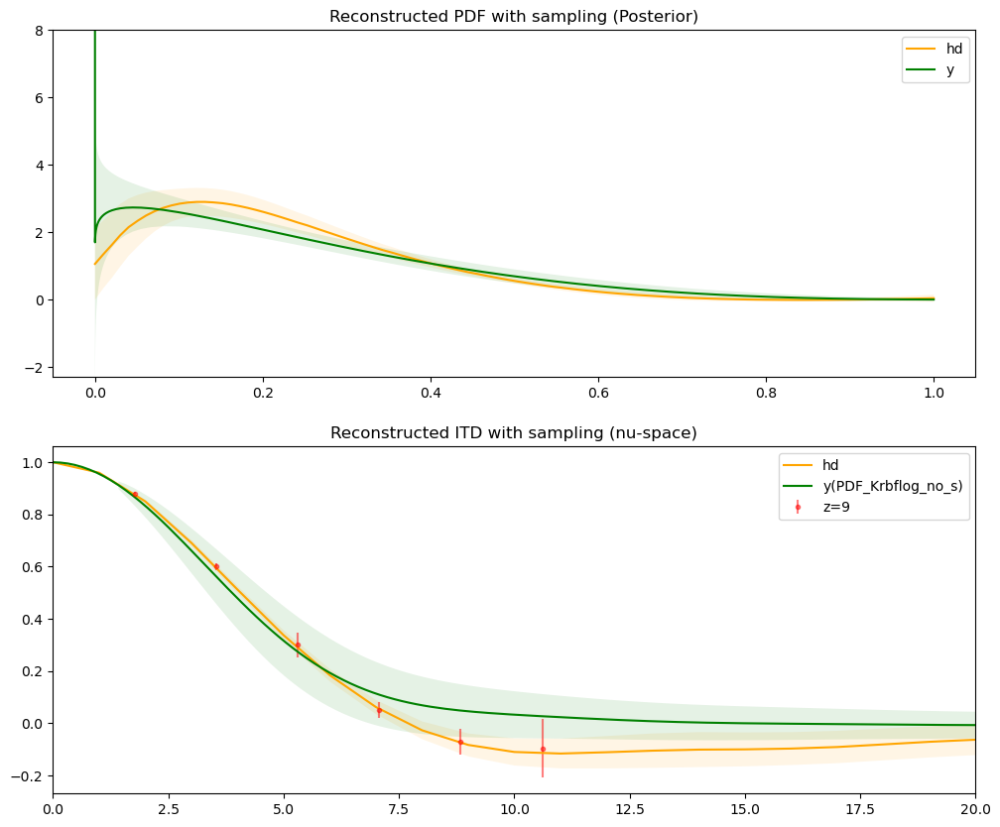

In [ ]:
#plot z3 and z6 and z9
fCI=1.
fig, ax= plt.subplots(2,figsize=(12, 10))
ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
ax[1].set_title("Reconstructed ITD with sampling (nu-space)")

col1=['l','green','blue','pink','black','red','purple','brown','orange','magenta','yellow','grey','lime']

#plot the data
#l=[2,5,8]
i=8
plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color="red")
if i==2:

    #####z=3
    #Herve
    ax[0].plot(hd_x_grid_z3,hd_mean_q_real_z3,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z3, hd_mean_q_real_z3 - hd_error_q_real_z3, hd_mean_q_real_z3 + hd_error_q_real_z3, facecolor='orange', alpha=0.1)
    #Joe
    ax[0].plot(jk_x_grid,hmc_mean_q_real_z3,label='jk',color='blue')
    ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z3 - hmc_error_q_real_z3, hmc_mean_q_real_z3 + hmc_error_q_real_z3, facecolor='blue', alpha=0.1)

    ######### z=3
    #Herve
    ax[1].plot(hd_nu_grid_z3,hd_mean_M_real_z3,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z3, hd_mean_M_real_z3 - hd_error_M_real_z3, hd_mean_M_real_z3 + hd_error_M_real_z3, facecolor='orange', alpha=0.1)
    #Joe
    ax[1].plot(jk_nu_grid_z3,hmc_mean_M_real_z3,label='jk',color='blue')
    ax[1].fill_between(jk_nu_grid_z3, hmc_mean_M_real_z3 - hmc_error_M_real_z3, hmc_mean_M_real_z3 + hmc_error_M_real_z3, facecolor='blue', alpha=0.1)

elif i==5:
    ##### z=6
    #Herve
    ax[0].plot(hd_x_grid_z6,hd_mean_q_real_z6,label='z=6',color='orange')
    ax[0].fill_between(hd_x_grid_z6, hd_mean_q_real_z6 - hd_error_q_real_z6, hd_mean_q_real_z6 + hd_error_q_real_z6, facecolor='orange', alpha=0.1)
    #Joe
    ax[0].plot(jk_x_grid,hmc_mean_q_real_z6,label='jk',color='blue')
    ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z6 - hmc_error_q_real_z6, hmc_mean_q_real_z6 + hmc_error_q_real_z6, facecolor='blue', alpha=0.1)
    
    ####### z=6
    #Herve
    ax[1].plot(hd_nu_grid_z6,hd_mean_M_real_z6,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z6, hd_mean_M_real_z6 - hd_error_M_real_z6, hd_mean_M_real_z6 + hd_error_M_real_z6, facecolor='orange', alpha=0.1)
    #Joe
    ax[1].plot(jk_nu_grid_z6,hmc_mean_M_real_z6,label='jk',color='blue')
    ax[1].fill_between(jk_nu_grid_z6, hmc_mean_M_real_z6 - hmc_error_M_real_z6, hmc_mean_M_real_z6 + hmc_error_M_real_z6, facecolor='blue', alpha=0.1)
elif i==8:

    #z=9
    ax[0].plot(hd_x_grid_z9,hd_mean_q_real_z9,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z9, hd_mean_q_real_z9 - hd_error_q_real_z9, hd_mean_q_real_z9 + hd_error_q_real_z9, facecolor='orange', alpha=0.1)
    #Joe
    #ax[0].plot(jk_x_grid,hmc_mean_q_real_z9,label='jk',color='blue')
    #ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z9 - hmc_error_q_real_z9, hmc_mean_q_real_z9 + hmc_error_q_real_z9, facecolor='blue', alpha=0.1)
    #mine

    ###z=9
    ax[1].plot(hd_nu_grid_z9,hd_mean_M_real_z9,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z9, hd_mean_M_real_z9 - hd_error_M_real_z9, hd_mean_M_real_z9 + hd_error_M_real_z9, facecolor='orange', alpha=0.1)

#mine
ax[0].plot(x_gri0,qofxs[i],label='y',color='green')
qerror=fCI*np.diag(np.abs(covs[i]))**(0.5)
ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='green', alpha=0.1)
#mine
mttQ=Qofvs[i]
Qerror=fCI*np.diag(covsnu[i])**0.5
ax[1].plot(nn,mttQ,label='y('+modelname+'_'+kernelname+')',color='green')
ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor='green', alpha=0.1)

#legends
ax[0].legend()

#ylimit
ax[0].set_ylim([-2.3,8])
#limit the x axis
plt.xlim([0,20])

ax[1].legend()

#save plot as pdf
plt.savefig('z='+str(i+1)+'a('+modelname+'_'+kernelname+')'+'CI='+str(fCI)+'.pdf')
plt.show()

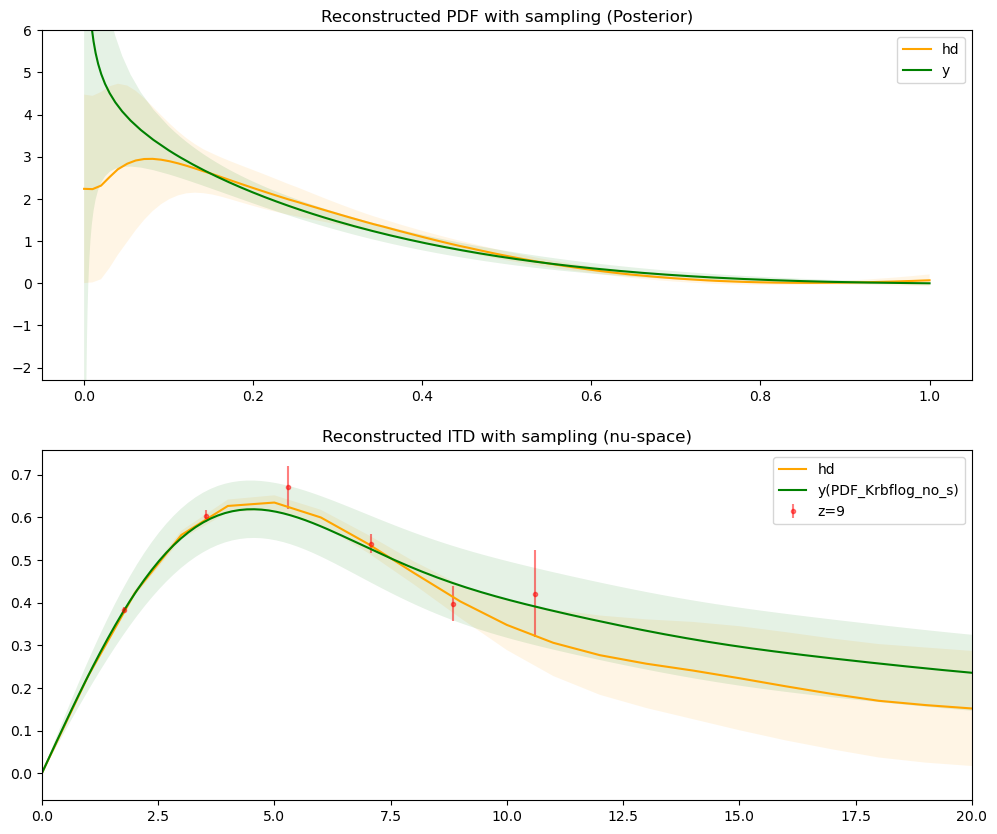

In [14]:
#plot imaginary part
fCI=1.
fig, ax= plt.subplots(2,figsize=(12, 10))
ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
ax[1].set_title("Reconstructed ITD with sampling (nu-space)")

col1=['l','green','blue','pink','black','red','purple','brown','orange','magenta','yellow','grey','lime']

i=8
plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color="red")

if i==2:
    
    #####z=3
    #Herve
    ax[0].plot(hd_x_grid_z3,hd_mean_q_imag_z3,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z3, hd_mean_q_imag_z3 - hd_error_q_imag_z3, hd_mean_q_imag_z3 + hd_error_q_imag_z3, facecolor='orange', alpha=0.1)


    ######### z=3
    #Herve
    ax[1].plot(hd_nu_grid_z3,hd_mean_M_imag_z3,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z3, hd_mean_M_imag_z3 - hd_error_M_imag_z3, hd_mean_M_imag_z3 + hd_error_M_imag_z3, facecolor='orange', alpha=0.1)

elif i==5:

    ##### z=6
    #Herve
    ax[0].plot(hd_x_grid_z6,hd_mean_q_imag_z6,label='z=6',color='orange')
    ax[0].fill_between(hd_x_grid_z6, hd_mean_q_imag_z6 - hd_error_q_imag_z6, hd_mean_q_imag_z6 + hd_error_q_imag_z6, facecolor='orange', alpha=0.1)
    
    ####### z=6
    #Herve
    ax[1].plot(hd_nu_grid_z6,hd_mean_M_imag_z6,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z6, hd_mean_M_imag_z6 - hd_error_M_imag_z6, hd_mean_M_imag_z6 + hd_error_M_imag_z6, facecolor='orange', alpha=0.1)

elif i==8:

    #z=9
    ax[0].plot(hd_x_grid_z9,hd_mean_q_imag_z9,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z9, hd_mean_q_imag_z9 - hd_error_q_imag_z9, hd_mean_q_imag_z9 + hd_error_q_imag_z9, facecolor='orange', alpha=0.1)
    #mine

    ###z=9
    ax[1].plot(hd_nu_grid_z9,hd_mean_M_imag_z9,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z9, hd_mean_M_imag_z9 - hd_error_M_imag_z9, hd_mean_M_imag_z9 + hd_error_M_imag_z9, facecolor='orange', alpha=0.1)

#mine
ax[0].plot(x_gri0,qofxs[i],label='y',color='green')
qerror=fCI*np.diag(np.abs(covs[i]))**(0.5)
ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='green', alpha=0.1)
#mine
mttQ=Qofvs[i]
Qerror=fCI*np.diag(covsnu[i])**0.5
ax[1].plot(nn,mttQ,label='y('+modelname+'_'+kernelname+')',color='green')
ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor='green', alpha=0.1)

#legends
ax[0].legend()

#ylimit
ax[0].set_ylim([-2.3,6])
#limit the x axis
plt.xlim([0,20])

ax[1].legend()

#save plot as pdf
plt.savefig(ITD+'z='+str(i+1)+'a('+modelname+'_'+kernelname+')'+'CI='+str(fCI)+'.pdf')
plt.show()